In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from arch import arch_model

In [2]:
returns = pd.read_csv("../data/weekly_returns.csv")

returns.Date = pd.DatetimeIndex(returns.Date)
returns.set_index("Date",inplace=True)
returns.head()

,ABEV3.SA,BBAS3.SA,BBDC4.SA,CPLE6.SA,CSAN3.SA,CSNA3.SA,ELET3.SA,ENBR3.SA,GGBR4.SA,ITUB4.SA,JBSS3.SA,PETR4.SA,SANB11.SA,SULA11.SA,TIMS3.SA,USIM5.SA,VALE3.SA,VIVT3.SA,WEGE3.SA
Date,,,,,,,,,,,,,,,,,,,
2010-01-04,0.038579,0.029609,0.018518,0.032145,-0.054668,0.039757,0.054168,0.056991,0.019789,0.008492,0.048339,0.007062,-0.019008,-0.010050,0.027588,0.042368,0.080260,-0.027216,0.054612
2010-01-11,0.019564,-0.019300,-0.026413,-0.014483,-0.010191,0.005033,-0.067417,0.047165,-0.023635,-0.045885,0.016924,-0.033015,-0.023733,-0.030363,-0.013699,-0.010875,-0.006713,-0.012511,-0.029853
2010-01-18,0.000125,-0.024574,-0.126901,-0.010667,-0.022880,-0.074748,0.154428,-0.023305,-0.102092,-0.027750,-0.055824,-0.028371,-0.053825,0.039236,-0.006921,-0.078553,-0.056576,-0.006652,-0.044017
2010-01-25,-0.058269,-0.015537,-0.014262,0.032704,-0.072430,0.025784,-0.047791,-0.019608,-0.027634,-0.003315,-0.025371,-0.016831,0.037092,-0.038828,-0.028171,0.064539,-0.032189,0.025804,0.002774
2010-02-01,-0.030459,-0.007142,-0.041713,-0.034313,0.094029,-0.012809,-0.507667,-0.044838,-0.026797,-0.037506,-0.035971,-0.080726,-0.106249,-0.044016,-0.049791,-0.039060,-0.036436,-0.030543,-0.048236


In [11]:
returns.shape

(626, 19)

In [33]:
p_values = [1]
q_values = [1]
window_values = [14]

df_volatility_all_assets = pd.DataFrame()

for asset in returns:
    print("----------------------------%s---------------------------"%asset)
    
    asset_return = returns.loc[:,asset]
    
    df_volatility_all_assets.index = asset_return.index
    
    for p in p_values:
        for q in q_values:
            for window in window_values:
                
                days = asset_return.index
                df_volatility = pd.DataFrame(index=days)
                volatilities_predicted = [np.nan]*window
                
                for i in range(window,len(days)):
                    window_returns = asset_return[i-window:i]
                    
                    garch_model = arch_model(window_returns.values,p=p,q=q,vol="GARCH").fit()
                    vol_prediction = np.sqrt(garch_model.forecast(horizon=1).variance)
                    print("#######################################################")
                    vol = vol_prediction.dropna().values
                    # print(vol)
                    if len(vol) == 0:
                        # print("nan")
                        vol = volatilities_predicted[-1]
                    else:
                        # print("not nan")
                        vol = vol[0][0]
                    # print(vol)
                    volatilities_predicted.append(vol)
        
        
                df_volatility_all_assets[asset[:-3]] = volatilities_predicted
                nome_arquivo = "../data/volatility_garch_"+str(p)+"_"+str(q)+"_"+str(window)+".csv"
                df_volatility_all_assets.to_csv(nome_arquivo)
     
                  

----------------------------ABEV3.SA---------------------------
Iteration:      1,   Func. Count:      6,   Neg. LLF: 97922126503.81027
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9580.83230546342
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.67461485317271
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.83117749545637
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.80206795126346
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.886329095486637
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.886048414563525
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.886445067777395
Iteration:      9,   Func. Count:     55,   Neg. LLF: 2292.3559545153844
Iteration:     10,   Func. Count:     65,   Neg. LLF: -29.777728857271732
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.886450133758
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008428. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      3,   Func. Count:     24,   Neg. LLF: -32.76432854854996
Iteration:      4,   Func. Count:     29,   Neg. LLF: -32.76433181828981
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.76433358425212
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.76433358426205
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.76433358425212
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1158.6284719224097
Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.913110183747754
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.06806668249983
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.070767229305304
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.07084426487102
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.07087184253641
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005197. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 222.30248951519476
Iteration:      2,   Func. Count:     14,   Neg. LLF: 309.91359786097513
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.984200571322155
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.998551816029075
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.002340069888813
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.002427030582535
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.002427828247555
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.002427828247555
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 355.2297113103272
Iteration:      2,   Func. Count:     14,   Neg. LLF: 265.04217054248954
Iteration:      3,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001086. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.04012093494424
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1305.2366395113445
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.046242220993612
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.07769463809574
Iteration:      5,   Func. Count:     36,   Neg. LLF: -26.145579067762824
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.14589392395367
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.145976346227826
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.145976342147495
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.145976346227826
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 86.89479822774867
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18.369527074076785
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001437. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     53,   Neg. LLF: -9.47696024691797
Iteration:      9,   Func. Count:     61,   Neg. LLF: -30.098249208856256
Iteration:     10,   Func. Count:     66,   Neg. LLF: -30.100119212721783
Iteration:     11,   Func. Count:     73,   Neg. LLF: -30.29015086827116
Iteration:     12,   Func. Count:     78,   Neg. LLF: -30.29537264512874
Iteration:     13,   Func. Count:     83,   Neg. LLF: -30.297440255722933
Iteration:     14,   Func. Count:     88,   Neg. LLF: -30.29884593821351
Iteration:     15,   Func. Count:     93,   Neg. LLF: -30.29895683695907
Iteration:     16,   Func. Count:     98,   Neg. LLF: -30.298959334441335
Iteration:     17,   Func. Count:    102,   Neg. LLF: -30.298959294054512
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.298959334441335
            Iterations: 18
            Function evaluations: 102
            Gradient evaluations: 17
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008413. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 770.9870121001469
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.8899536025912598
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.58153955406449
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.705499730547473
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.703034643091716
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.705487919445893
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.71327381811835
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.71327381811835
            Iterations: 7
            Function evaluations: 47
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 365.9346643896426
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8.938742368239138
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.177956263951497
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001401. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     77,   Neg. LLF: -34.34179390033213
Iteration:     12,   Func. Count:     83,   Neg. LLF: -34.34681511066171
Iteration:     13,   Func. Count:     89,   Neg. LLF: -34.377983675596525
Iteration:     14,   Func. Count:     95,   Neg. LLF: -34.390245352245074
Iteration:     15,   Func. Count:    101,   Neg. LLF: -34.39782593347479
Iteration:     16,   Func. Count:    107,   Neg. LLF: -34.398583660352195
Iteration:     17,   Func. Count:    113,   Neg. LLF: -34.39857441336599
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.39859766615083
            Iterations: 18
            Function evaluations: 123
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8458.638498646593
Iteration:      2,   Func. Count:     16,   Neg. LLF: -21.35129198847135
Iteration:      3,   Func. Count:     25,   Neg. LLF: -35.29772140749096
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003781. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.982212250372453
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1589.5782674498844
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.88276203251331
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.996929685695314
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.060036909770478
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.03417710027525
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.060660165246983
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.060757293928155
Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.06076168577279
Iteration:     10,   Func. Count:     60,   Neg. LLF: -29.060761685748975
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.06076168577279
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000981. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1414771617.801419
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3541287.7679491946
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.07462150118527
Iteration:      4,   Func. Count:     27,   Neg. LLF: -31.075786330821785
Iteration:      5,   Func. Count:     32,   Neg. LLF: -31.076410391112784
Iteration:      6,   Func. Count:     37,   Neg. LLF: -31.076411418708528
Iteration:      7,   Func. Count:     41,   Neg. LLF: -31.076411418301237
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.076411418708528
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 395.6539505626987
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.493429083713113
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.56243423699415
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005649. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.18660206421782
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.075063076310204
Iteration:      4,   Func. Count:     30,   Neg. LLF: -31.562685431537883
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.56853183302556
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.56882088977729
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.56886513721101
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.568917566022776
Iteration:      9,   Func. Count:     55,   Neg. LLF: -31.568927099377706
Iteration:     10,   Func. Count:     60,   Neg. LLF: -31.56892797368057
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.56892797368057
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1000.8848088516609


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006983. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     16,   Func. Count:    116,   Neg. LLF: -27.659428258898437
Iteration:     17,   Func. Count:    121,   Neg. LLF: -27.660676965346187
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.660676967154604
            Iterations: 21
            Function evaluations: 121
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 328292.89586722676
Iteration:      2,   Func. Count:     14,   Neg. LLF: 35069.604725646466
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.995185939255997
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.403584792859508
Iteration:      5,   Func. Count:     33,   Neg. LLF: 155937.42266630518
Iteration:      6,   Func. Count:     42,   Neg. LLF: -26.554002255203347
Iteration:      7,   Func. Count:     48,   Neg. LLF: -27.27927172014301
Iteration:      8,   Func. Count:     53,   Neg. LLF: 1933.12424319796

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001304. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1251.9036630127619
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.046161059861131
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.81062432098489
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.937481190992223
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.922868419840203
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.905767575517917
Iteration:      7,   Func. Count:     47,   Neg. LLF: -30.9539006795094
Iteration:      8,   Func. Count:     52,   Neg. LLF: -30.953957724981365
Iteration:      9,   Func. Count:     56,   Neg. LLF: -30.953957724972284
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.953957724981365
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 827.5246996332488
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001029. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.491733650704585
Iteration:     13,   Func. Count:     75,   Neg. LLF: -27.49173365082249
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.491733650704585
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1499624970.433783
Iteration:      2,   Func. Count:     15,   Neg. LLF: 544379.7648661364
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.53092129049615
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.871040292393364
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.592523437847518
Iteration:      6,   Func. Count:     39,   Neg. LLF: 11014.405320446107
Iteration:      7,   Func. Count:     47,   Neg. LLF: 13272.27401941603
Iteration:      8,   Func. Count:     56,   Neg. LLF: -27.59363316744171
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001156. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 42834154.81017527
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7878444.533341816
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.10691770484135
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.36110799961145
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.11811907486702
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.12008588341879
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.12520650826169
Iteration:      8,   Func. Count:     50,   Neg. LLF: -33.12638347322829
Iteration:      9,   Func. Count:     55,   Neg. LLF: -33.12716559521426
Iteration:     10,   Func. Count:     60,   Neg. LLF: -33.127396754929
Iteration:     11,   Func. Count:     65,   Neg. LLF: -33.12744731149142
Iteration:     12,   Func. Count:     70,   Neg. LLF: -33.127450313510444
Iteration:     13,   Func. Count:     74,   Neg. LLF: -33.12745031246558
Optimization terminated successfully    (Exit mode 0)


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005521. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     15,   Func. Count:     99,   Neg. LLF: -33.91738894048025
Iteration:     16,   Func. Count:    104,   Neg. LLF: -14.130474784276325
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.917388953971546
            Iterations: 19
            Function evaluations: 109
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -22.172352247385437
Iteration:      2,   Func. Count:     12,   Neg. LLF: 388770.7023738132
Iteration:      3,   Func. Count:     19,   Neg. LLF: -28.66161890949164
Iteration:      4,   Func. Count:     26,   Neg. LLF: -34.861711284039465
Iteration:      5,   Func. Count:     31,   Neg. LLF: -34.28687130205812
Iteration:      6,   Func. Count:     37,   Neg. LLF: -34.86965860540593
Iteration:      7,   Func. Count:     42,   Neg. LLF: -34.86995645444872
Iteration:      8,   Func. Count:     47,   Neg. LLF: -34.86997021479278


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004193. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 542.33389698884
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.970508550379539
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.949903114815676
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.963077678795475
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.970897848030535
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.13144255123027
Iteration:      7,   Func. Count:     47,   Neg. LLF: -18.707898673726696
Iteration:      8,   Func. Count:     55,   Neg. LLF: -30.16999358948059
Iteration:      9,   Func. Count:     60,   Neg. LLF: -30.171396004793493
Iteration:     10,   Func. Count:     65,   Neg. LLF: -30.172348135970108
Iteration:     11,   Func. Count:     70,   Neg. LLF: -30.172429625108006
Iteration:     12,   Func. Count:     75,   Neg. LLF: -30.172434697551065
Iteration:     13,   Func. Count:     79,   Neg. LLF: -30.172434697562075
Optimization terminated successfully    (Exit

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008069. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2381116660.6480293
Iteration:      2,   Func. Count:     15,   Neg. LLF: 289377.20981775934
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.52289335811573
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.569325543146416
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.639816392958053
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.686775473193418
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.698913913963562
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.73624237807869
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.687931421481945
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.73628645802352
Iteration:     11,   Func. Count:     68,   Neg. LLF: -26.736286458028513
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.73628645802352
            Iterations: 11
            Function evaluations: 68
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001248. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.2574713576223218
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.721005992540096
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.767963475637785
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.83220266425245
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.909682297958227
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.958508177550605
Iteration:      8,   Func. Count:     53,   Neg. LLF: -26.967248740803463
Iteration:      9,   Func. Count:     58,   Neg. LLF: -26.972167478370046
Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.973691208252582
Iteration:     11,   Func. Count:     68,   Neg. LLF: -26.973833854398112
Iteration:     12,   Func. Count:     73,   Neg. LLF: -26.973856640861676
Iteration:     13,   Func. Count:     77,   Neg. LLF: -26.97385664079717
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.973856640861676
    

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001328. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8951163.471614335
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3903.2477775894376
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.49884724725452
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.66044481240411
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.21979707728858
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.32210247290716
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.83637433287906
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.840115903551048
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.840505594629082
Iteration:     10,   Func. Count:     61,   Neg. LLF: -0.59433728572915
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.84050565779434
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
#######################################################
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006562. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.555537361559468
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.76867490499648
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.62317446927101
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.900510936586052
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.904160168397496
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.9042088337374
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.904208824717067
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.9042088337374
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1236.1168697611076
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.563800979026071
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.599141018171196
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006414. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7373793.012358854
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6873661.489292256
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.829492779954496
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.90553457668469
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.58944486226082
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.584956712925
Iteration:      7,   Func. Count:     46,   Neg. LLF: 255093721311.76428
Iteration:      8,   Func. Count:     56,   Neg. LLF: 1686.2820496967481
Iteration:      9,   Func. Count:     63,   Neg. LLF: -32.64584498309907
Iteration:     10,   Func. Count:     69,   Neg. LLF: -32.71918232008869
Iteration:     11,   Func. Count:     74,   Neg. LLF: 74.62233334640574
Iteration:     12,   Func. Count:     83,   Neg. LLF: 921.1041880660681
Iteration:     13,   Func. Count:     93,   Neg. LLF: -32.52664030162156
Iteration:     14,   Func. Count:    101,   Neg. LLF: -3

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005585. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     55,   Neg. LLF: -28.05864250758515
Iteration:      9,   Func. Count:     61,   Neg. LLF: -28.12435764952676
Iteration:     10,   Func. Count:     66,   Neg. LLF: -27.42982172734017
Iteration:     11,   Func. Count:     72,   Neg. LLF: 35070176223.14144
Iteration:     12,   Func. Count:     81,   Neg. LLF: 6320546.916247193
Iteration:     13,   Func. Count:     89,   Neg. LLF: -28.13213011776902
Iteration:     14,   Func. Count:     94,   Neg. LLF: -27.66390851491596
Iteration:     15,   Func. Count:    101,   Neg. LLF: -26.322037827353107
Iteration:     16,   Func. Count:    109,   Neg. LLF: -28.12921836241922
Iteration:     17,   Func. Count:    115,   Neg. LLF: 715390.7738363644
Iteration:     18,   Func. Count:    124,   Neg. LLF: 1323.7041754108564
Iteration:     19,   Func. Count:    132,   Neg. LLF: -28.138427588055382
Iteration:     20,   Func. Count:    137,   Neg. LLF: -28.139078189103344
Iteration:     21,   Func. Count:    142,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001016. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 21.037332487811028
Iteration:      2,   Func. Count:     14,   Neg. LLF: 185.2129875854841
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.93186837746232
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.951257024636035
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.972554728864267
Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.973224706744823
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.973235689012547
Iteration:      8,   Func. Count:     46,   Neg. LLF: -26.97323567909908
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.973235689012547
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.352329667241114
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1857.6834729785296
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00136. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4449785514475.065
Iteration:      2,   Func. Count:     16,   Neg. LLF: 4617.9044626013265
Iteration:      3,   Func. Count:     22,   Neg. LLF: 22.608549575386256
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.67092335264234
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.111039985307926
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.680133124088563
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.694557085668002
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.62297462781659
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.68140140214253
Iteration:     10,   Func. Count:     62,   Neg. LLF: -29.681406556089993
Iteration:     11,   Func. Count:     67,   Neg. LLF: -29.68141153917681
Iteration:     12,   Func. Count:     71,   Neg. LLF: -29.68141153915459
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.68141153917681
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009163. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.306464523594116
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1200.5908795503806
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.54641059091345
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.516724423440984
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.54912661888491
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.54568343057216
Iteration:      7,   Func. Count:     46,   Neg. LLF: -32.54821682929521
Iteration:      8,   Func. Count:     52,   Neg. LLF: -32.55903648823262
Iteration:      9,   Func. Count:     58,   Neg. LLF: -32.564349474537
Iteration:     10,   Func. Count:     64,   Neg. LLF: -32.56582459312833
Iteration:     11,   Func. Count:     69,   Neg. LLF: -32.565937813815474
Iteration:     12,   Func. Count:     74,   Neg. LLF: -32.565936075091074
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.5659378142047
            Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005626. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.249404525300548
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.260908210318583
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.363399209767266
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.368033553189644
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.38690909574432
Iteration:      9,   Func. Count:     55,   Neg. LLF: -31.40236996766331
Iteration:     10,   Func. Count:     60,   Neg. LLF: -31.405035818844553
Iteration:     11,   Func. Count:     65,   Neg. LLF: -31.405263314022548
Iteration:     12,   Func. Count:     70,   Neg. LLF: -9.176768608403492
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.40526368182471
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 266.9387783850741

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006692. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.535988853156123
Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.84383382784155
Iteration:      4,   Func. Count:     30,   Neg. LLF: -34.861845877809166
Iteration:      5,   Func. Count:     36,   Neg. LLF: -34.87685685526225
Iteration:      6,   Func. Count:     41,   Neg. LLF: -34.86858650571333
Iteration:      7,   Func. Count:     48,   Neg. LLF: -34.88666477099647
Iteration:      8,   Func. Count:     53,   Neg. LLF: -34.88513817769052
Iteration:      9,   Func. Count:     59,   Neg. LLF: -34.88798530303625
Iteration:     10,   Func. Count:     65,   Neg. LLF: -34.88907741600679
Iteration:     11,   Func. Count:     70,   Neg. LLF: -34.8890390214741
Iteration:     12,   Func. Count:     77,   Neg. LLF: -34.88904152709185
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.889080519647564
            Iterations: 12
            Function evaluations: 87
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000438. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.708347116532817
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.708542532270563
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.708544343866407
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.708544343855905
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.708544343866407
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 113689.21187703921
Iteration:      2,   Func. Count:     16,   Neg. LLF: 7.6858894866902014
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.611314454597487
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.67223366530722
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.388153562967933
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.12383188765530

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007473. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 281859.1264540363
Iteration:      2,   Func. Count:     16,   Neg. LLF: -19.70013965396498
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.168061446852192
Iteration:      4,   Func. Count:     30,   Neg. LLF: -32.084035067580274
Iteration:      5,   Func. Count:     35,   Neg. LLF: -32.12312387517287
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.177174630397076
Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.1910810331941
Iteration:      8,   Func. Count:     50,   Neg. LLF: -32.19297831731877
Iteration:      9,   Func. Count:     55,   Neg. LLF: -32.193156090490625
Iteration:     10,   Func. Count:     60,   Neg. LLF: -32.193212795341715
Iteration:     11,   Func. Count:     64,   Neg. LLF: -32.193212817893674
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.193212795341715
            Iterations: 11
            Function evaluations: 64
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006693. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     21,   Func. Count:    125,   Neg. LLF: -34.725697676728544
Iteration:     22,   Func. Count:    130,   Neg. LLF: -34.72570726643463
Iteration:     23,   Func. Count:    134,   Neg. LLF: -34.72570726668976
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.72570726643463
            Iterations: 23
            Function evaluations: 134
            Gradient evaluations: 23
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4807324731131.827
Iteration:      2,   Func. Count:     16,   Neg. LLF: 9144534.475187797
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.28510425827488
Iteration:      4,   Func. Count:     29,   Neg. LLF: -35.093780449773604
Iteration:      5,   Func. Count:     35,   Neg. LLF: -35.781658880848376
Iteration:      6,   Func. Count:     41,   Neg. LLF: -35.97045464335069
Iteration:      7,   Func. Count:     47,   Neg. LLF: -36.121060891849226
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003443. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 711.9526692998396
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.871546103254921
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.84389629842995
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.85192498464875
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.8558783496777
Iteration:      6,   Func. Count:     41,   Neg. LLF: -34.02533089256502
Iteration:      7,   Func. Count:     47,   Neg. LLF: -23.749577289416056
Iteration:      8,   Func. Count:     54,   Neg. LLF: -34.07264387244407
Iteration:      9,   Func. Count:     59,   Neg. LLF: -34.0837949611819
Iteration:     10,   Func. Count:     64,   Neg. LLF: -34.07881378283438
Iteration:     11,   Func. Count:     70,   Neg. LLF: -34.08694257300539
Iteration:     12,   Func. Count:     75,   Neg. LLF: -34.08699048476919
Iteration:     13,   Func. Count:     80,   Neg. LLF: -34.08699327776446
Iteration:     14,   Func. Count:     84,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004461. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.955233531403037
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.15618936935492
Iteration:      4,   Func. Count:     28,   Neg. LLF: -8.157764851200014
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.17736869527988
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.17799123445979
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.17802200612688
Iteration:      8,   Func. Count:     49,   Neg. LLF: -33.17802200072676
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.17802200612688
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19860.697987594704
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.115398536296798
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.28831700395045
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007986. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.059337785617895
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.17255475867209
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.182915680215473
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.169875671757634
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.18753190954982
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.18760806497196
Iteration:     11,   Func. Count:     66,   Neg. LLF: -31.18760979537287
Iteration:     12,   Func. Count:     71,   Neg. LLF: -31.187611234748967
Iteration:     13,   Func. Count:     76,   Neg. LLF: -11.659378662507422
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.1876112518787
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1504086417.346256
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001257. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.8956142773096
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.898220304538693
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.90026196957141
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.90068670578372
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.901484412304768
Iteration:      9,   Func. Count:     55,   Neg. LLF: -23.90148441189679
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.901484412304768
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 473.4883392690624
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.662203404890297
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.00175299158522
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.605407463401807
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001644. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.66776562250477
Iteration:     10,   Func. Count:     57,   Neg. LLF: -26.66776582121454
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.66776582121454
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 214061359.10787052
Iteration:      2,   Func. Count:     15,   Neg. LLF: 321168.52154534066
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.22239889034564
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.22412280747047
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.51329009587696
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.529592048395585
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.576482389515398
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.1609420324993
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001382. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.473838215178198
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.993037211742195
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.36555454090234
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.06940648669132
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.069426922280513
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.069432912573447
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.06944499104818
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.069444991091892
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.06944499104818
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 64.25611544781117
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.251843407310036
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001654. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 25633676295.482105
Iteration:      2,   Func. Count:     15,   Neg. LLF: 551.2053406550298
Iteration:      3,   Func. Count:     21,   Neg. LLF: -31.316286641193095
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.787257928521537
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.553846190584515
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.32581938125184
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.570244850690727
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.570289331375815
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.570289331381648
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.570289331375815
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 374.64655987714093


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006236. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.280863660627993
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.280863674754016
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.280863660627993
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 68622206985.55702
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4049647.130078204
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.123680686325272
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.14046871470009
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.214008831725863
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.202649065453315
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.204352141873244
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.204404655658582


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009131. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     31,   Neg. LLF: -17.918002221012543
Iteration:      6,   Func. Count:     36,   Neg. LLF: -17.91804613156194
Iteration:      7,   Func. Count:     41,   Neg. LLF: -17.91804802205913
Iteration:      8,   Func. Count:     45,   Neg. LLF: -17.91804802205734
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.91804802205913
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7995231372.041852
Iteration:      2,   Func. Count:     15,   Neg. LLF: 857285.109467822
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.02075017317462
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.133343147016596
Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.507868810855253
Iteration:      6,   Func. Count:     40,   Neg. LLF: -15.632056027742555
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005293. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     68,   Neg. LLF: -22.16855805080406
Iteration:     13,   Func. Count:     73,   Neg. LLF: -22.175661830281726
Iteration:     14,   Func. Count:     78,   Neg. LLF: -22.182221567015215
Iteration:     15,   Func. Count:     83,   Neg. LLF: -22.225338700621244
Iteration:     16,   Func. Count:     88,   Neg. LLF: -22.2475395269001
Iteration:     17,   Func. Count:     93,   Neg. LLF: -22.364998495230036
Iteration:     18,   Func. Count:     98,   Neg. LLF: 37.763664083616476
Iteration:     19,   Func. Count:    106,   Neg. LLF: -5.877949224577304
Iteration:     20,   Func. Count:    114,   Neg. LLF: -19.77959441406902
Iteration:     21,   Func. Count:    120,   Neg. LLF: -22.142520400509415
Iteration:     22,   Func. Count:    126,   Neg. LLF: -22.37642289393858
Iteration:     23,   Func. Count:    132,   Neg. LLF: -22.469088754432576
Iteration:     24,   Func. Count:    137,   Neg. LLF: -22.469122289523803
Iteration:     25,   Func. Count:    142,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002416. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 143.03471898573054
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.963010960913387
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.1133131614658
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.124516955865026
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.12650617920557
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.126539518456894
Iteration:      8,   Func. Count:     47,   Neg. LLF: -22.126539486917466
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.126539518456894
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14833.683141015019
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.4103496068736066
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.08550784792671
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00302. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2458910050.6862597
Iteration:      2,   Func. Count:     14,   Neg. LLF: 46612.313520105396
Iteration:      3,   Func. Count:     20,   Neg. LLF: 162.78866359810905
Iteration:      4,   Func. Count:     26,   Neg. LLF: -1.9064020112888085
Iteration:      5,   Func. Count:     32,   Neg. LLF: -7.0568349451536845
Iteration:      6,   Func. Count:     38,   Neg. LLF: -9.127163690304483
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.572588322078833
Iteration:      8,   Func. Count:     49,   Neg. LLF: -4.266797035204894
Iteration:      9,   Func. Count:     55,   Neg. LLF: -13.37817235913732
Iteration:     10,   Func. Count:     62,   Neg. LLF: -21.519497857264916
Iteration:     11,   Func. Count:     68,   Neg. LLF: -18.27146793061847
Iteration:     12,   Func. Count:     74,   Neg. LLF: -21.801171498292327
Iteration:     13,   Func. Count:     79,   Neg. LLF: -21.81483981593648
Iteration:     14,   Func. Count:     84,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002323. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10025.418927214883
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.709057870513451
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.830303407819912
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.65104573271633
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.840002217615645
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.84017559057066
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.840189819779464
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.840189818255105
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.840189819779464
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 520071676.48354495
Iteration:      2,   Func. Count:     15,   Neg. LLF: 306364.9617445852
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001762. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.686190639480255
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.38299802156291
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.216442736769306
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.91746160123001
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.942748499275964
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.917862107448
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.91786262115837
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.91786262115837
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 387096642.7662977
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7091530.471915956
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.955970925781745
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001251. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     22,   Func. Count:    132,   Neg. LLF: -24.287086640228537
Iteration:     23,   Func. Count:    138,   Neg. LLF: -24.409524798144545
Iteration:     24,   Func. Count:    144,   Neg. LLF: -24.41370928704233
Iteration:     25,   Func. Count:    149,   Neg. LLF: -24.41416423422241
Iteration:     26,   Func. Count:    154,   Neg. LLF: -24.414167709675425
Iteration:     27,   Func. Count:    158,   Neg. LLF: -24.414167651283883
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.414167709675425
            Iterations: 28
            Function evaluations: 158
            Gradient evaluations: 27
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.090660065620842
Iteration:      2,   Func. Count:     14,   Neg. LLF: 141.27474067880667
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.121909994365335
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.143656686223

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001866. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.381439592925087
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.237454717002173
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.4601854908823
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.23389826794156
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.220885211949224
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.214807359438993
Iteration:      8,   Func. Count:     52,   Neg. LLF: -28.459548983065467
Iteration:      9,   Func. Count:     58,   Neg. LLF: -23.69682167685058
Iteration:     10,   Func. Count:     66,   Neg. LLF: 148161.0438668
Iteration:     11,   Func. Count:     75,   Neg. LLF: 2801.738884432004
Iteration:     12,   Func. Count:     83,   Neg. LLF: -28.38149989156099
Iteration:     13,   Func. Count:     89,   Neg. LLF: -28.383208182681706
Iteration:     14,   Func. Count:     95,   Neg. LLF: -28.423487728116516
Iteration:     15,   Func. Count:    101,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 934.8850629863332
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.373704218693206
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.36368662194819
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.379669979209613
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.379669968695204
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.379669979209613
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 856.9983113436301
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.1123519241768949
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.94599079261455
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.931404993538674
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.980568333671744
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001092. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6542445.413415456
Iteration:      2,   Func. Count:     15,   Neg. LLF: 487.37905133043483
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.897487931800775
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.919861102377475
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.925354700974722
Iteration:      6,   Func. Count:     37,   Neg. LLF: -29.925509548535018
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.218579434947166
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.925509596895402
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 305026536.1950076
Iteration:      2,   Func. Count:     13,   Neg. LLF: 198835.01934842867
Iteration:      3,   Func. Count:     20,   Neg. LLF: -30.38391682827308
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 226563223.1138387
Iteration:      2,   Func. Count:     14,   Neg. LLF: 200345.48101510142
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.27182056421521
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.374781073937967
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.315598490217937
Iteration:      6,   Func. Count:     39,   Neg. LLF: 18025948619.18325
Iteration:      7,   Func. Count:     48,   Neg. LLF: 68999.78528542425
Iteration:      8,   Func. Count:     55,   Neg. LLF: -24.608000880955135
Iteration:      9,   Func. Count:     60,   Neg. LLF: -24.6116379180912
Iteration:     10,   Func. Count:     65,   Neg. LLF: -24.613680437394798
Iteration:     11,   Func. Count:     70,   Neg. LLF: 50737.4901943476
Iteration:     12,   Func. Count:     78,   Neg. LLF: 229158620.65861043
Iteration:     13,   Func. Count:     87,   Neg. LLF: -22.408011883566

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001806. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:     11,   Func. Count:     62,   Neg. LLF: -26.853035042066487
Iteration:     12,   Func. Count:     66,   Neg. LLF: -26.853035028224543
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.853035042066487
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 242.93395283996486
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.082974182104552
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.53484355306874
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.55504497218772
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.57103472247554
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.58271232801341
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.58321238367104
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.58322575733903
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001329. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.46246682315653
Iteration:      8,   Func. Count:     51,   Neg. LLF: -21.476669282646295
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.47696712078999
Iteration:     10,   Func. Count:     61,   Neg. LLF: -21.47699537390808
Iteration:     11,   Func. Count:     66,   Neg. LLF: -21.476997433452222
Iteration:     12,   Func. Count:     70,   Neg. LLF: -21.47699743350831
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.476997433452222
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.551999619878838
Iteration:      2,   Func. Count:     14,   Neg. LLF: 127.89863628008055
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.459277188912992
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.46028434759354


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002729. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     72,   Neg. LLF: -23.309096532106153
Iteration:     13,   Func. Count:     77,   Neg. LLF: -23.309098110864813
Iteration:     14,   Func. Count:     81,   Neg. LLF: -23.309098110858233
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.309098110864813
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 85186288.54635447
Iteration:      2,   Func. Count:     13,   Neg. LLF: 6057048.340462172
Iteration:      3,   Func. Count:     20,   Neg. LLF: -23.461029500512996
Iteration:      4,   Func. Count:     26,   Neg. LLF: -23.525905738363804
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.582849332066456
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.664532935218496
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.6870993338137

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001999. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4145516996.5946817
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7073287.7874498395
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.579526174651065
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.261481483327422
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.869074379324083
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.078601401221853
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.10282142710613
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.597942982161882
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.10739152724388
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.107415577212635
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.107508159649782
Iteration:     12,   Func. Count:     73,   Neg. LLF: -25.10751040937875
Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.10751040937703
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001248. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 546793301.4294081
Iteration:      2,   Func. Count:     15,   Neg. LLF: 144813.13474857892
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.215475360693382
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.22173220888918
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.944090864956998
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.389818042250344
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.18283914039203
Iteration:      8,   Func. Count:     52,   Neg. LLF: -25.249899634483914
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.715864167503184
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.251679772511743
Iteration:     11,   Func. Count:     69,   Neg. LLF: -25.252007547624597
Iteration:     12,   Func. Count:     74,   Neg. LLF: -25.252013926032415
Iteration:     13,   Func. Count:     78,   Neg. LLF: -25.252013926039734
Optimization terminated successfully    (Ex

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003161. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 103891878.39871034
Iteration:      2,   Func. Count:     13,   Neg. LLF: 429222.65298099536
Iteration:      3,   Func. Count:     20,   Neg. LLF: -24.71803884604911
Iteration:      4,   Func. Count:     25,   Neg. LLF: -23.88835083493491
Iteration:      5,   Func. Count:     31,   Neg. LLF: -24.935831153269366
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.147822284914007
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.149508925095596
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.14951868147095
Iteration:      9,   Func. Count:     51,   Neg. LLF: -25.149518681445844
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.14951868147095
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1562266751.4287965
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001808. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.344644862023127
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.344648329568024
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.344648317758477
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.344648329568024
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 793.7333073607571
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.5521509162646709
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.78379040670474
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.82342692755609
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.824690434763543
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.824781749086306
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.82478174532242
O

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001485. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 205.3479302863922
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11.905996325495352
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.6795218510137
            Iterations: 2
            Function evaluations: 20
            Gradient evaluations: 2
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1600204173.0787287
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7318082.245836355
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.43480316341099
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.508383649863887
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.56504492330996
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.64139474591601
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.810264220328826
Iteration:      8,   Func. Count:     52,   Neg. LLF: -22.91791791578104
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002259. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.273824165958544
Iteration:      2,   Func. Count:     14,   Neg. LLF: 21.044641952681314
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.8844429487414
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.89699144076829
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.95086819069327
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.933992395275702
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.951533110927855
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.951564085275873
Iteration:      9,   Func. Count:     53,   Neg. LLF: -3.8915283119414803
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.951575331012062
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 262.7012312361579
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001595. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     73,   Neg. LLF: -20.50969310750677
Iteration:     12,   Func. Count:     80,   Neg. LLF: -26.471861079536072
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.47186107954232
            Iterations: 16
            Function evaluations: 80
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 68013145454.867836
Iteration:      2,   Func. Count:     15,   Neg. LLF: 87915.49621747588
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.936579081313187
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.990436023420678
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.116407983478155
Iteration:      6,   Func. Count:     40,   Neg. LLF: 118238883.85970525
Iteration:      7,   Func. Count:     49,   Neg. LLF: 9625805.481380647
Iteration:      8,   Func. Count:     56,   Neg. LLF: -26.259488077966548
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001398. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 121081.6962997627
Iteration:      2,   Func. Count:     15,   Neg. LLF: 16.899050287024497
Iteration:      3,   Func. Count:     21,   Neg. LLF: -9.357075934011622
Iteration:      4,   Func. Count:     27,   Neg. LLF: -14.403986930298744
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.730338266605557
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.071283725618883
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.23429419868971
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.287570483026343
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.211147110193593
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.32299410238011
Iteration:     11,   Func. Count:     65,   Neg. LLF: -25.323634831949438
Iteration:     12,   Func. Count:     70,   Neg. LLF: -25.323703350452313
Iteration:     13,   Func. Count:     75,   Neg. LLF: -6.083005534989848
Iteration:     14,   Func. Count:     85,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002292. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.97146075697378
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.971460756949757
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.97146075697378
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 187.44286236975464
Iteration:      2,   Func. Count:     14,   Neg. LLF: 26.450422369779766
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.858007156573713
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.864485981182582
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.88401061466885
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.884962020359993
Iteration:      7,   Func. Count:     42,   Neg. LLF: -22.885007880282767
Iteration:      8,   Func. Count:     46,   Neg. LLF: -22.88500787408932

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002278. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -12.116899075602536
Iteration:      8,   Func. Count:     49,   Neg. LLF: -12.116899832795385
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.116899832795385
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.68861266428619
Iteration:      2,   Func. Count:     14,   Neg. LLF: 48.24088606234516
Iteration:      3,   Func. Count:     22,   Neg. LLF: -11.802250757094061
Iteration:      4,   Func. Count:     27,   Neg. LLF: -11.773592060812952
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.811724190816665
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.717335422904236
Iteration:      7,   Func. Count:     44,   Neg. LLF: -11.8025198764666
Iteration:      8,   Func. Count:     50,   Neg. LLF: -11.818803725742647
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01087. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     10,   Func. Count:     62,   Neg. LLF: -14.12802206558831
Iteration:     11,   Func. Count:     67,   Neg. LLF: -14.13620792595654
Iteration:     12,   Func. Count:     72,   Neg. LLF: -14.137199946643458
Iteration:     13,   Func. Count:     77,   Neg. LLF: -14.137280544697937
Iteration:     14,   Func. Count:     82,   Neg. LLF: -14.137280980181751
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.137280980181751
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1212735016.4448462
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5984721.943035886
Iteration:      3,   Func. Count:     20,   Neg. LLF: -10.784949360428548
Iteration:      4,   Func. Count:     26,   Neg. LLF: -13.957333764951043
Iteration:      5,   Func. Count:     32,   Neg. LLF: -13.90886997322729

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007852. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.0588862039292617
Iteration:      2,   Func. Count:     14,   Neg. LLF: 235.50740348949378
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.752443002615916
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.752472146316226
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.752505203813786
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.752514946382732
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.752519046760206
Iteration:      8,   Func. Count:     47,   Neg. LLF: -16.752519046773124
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.752519046760206
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 847411917.0712698
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6724534.349897388
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005433. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.49092881740879
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.491416439733097
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.49249349077398
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.52707943968151
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.992901045827313
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.538031415352098
Iteration:     10,   Func. Count:     61,   Neg. LLF: -20.53799973696642
Iteration:     11,   Func. Count:     67,   Neg. LLF: -20.5385509881831
Iteration:     12,   Func. Count:     72,   Neg. LLF: 1.9188424929535124
Iteration:     13,   Func. Count:     82,   Neg. LLF: 1587.9983071119482
Iteration:     14,   Func. Count:     92,   Neg. LLF: -20.538611197919714
Iteration:     15,   Func. Count:     96,   Neg. LLF: -20.5386111927675
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.538611197919714
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003387. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 137.2087345632034
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.749021542125035
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.668716101672604
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.771094413193467
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.771131300473122
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.771131280597356
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.771131300473122
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 39.46889705574533
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6.398345891105135
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.089462788619127
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.664163242389005
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005609. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 120.37136524690986
Iteration:      3,   Func. Count:     23,   Neg. LLF: -15.915641495533448
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.920569561171153
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.922043135433519
Iteration:      6,   Func. Count:     38,   Neg. LLF: -15.926367678791337
Iteration:      7,   Func. Count:     43,   Neg. LLF: -15.927383790045303
Iteration:      8,   Func. Count:     48,   Neg. LLF: -15.927469417881843
Iteration:      9,   Func. Count:     53,   Neg. LLF: -15.92754622244316
Iteration:     10,   Func. Count:     58,   Neg. LLF: -15.927550564200402
Iteration:     11,   Func. Count:     62,   Neg. LLF: -15.927550562880763
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.927550564200402
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
###################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006163. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -11.034333091973247
Iteration:      8,   Func. Count:     49,   Neg. LLF: -11.034339664638452
Iteration:      9,   Func. Count:     53,   Neg. LLF: -11.034339662033588
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.034339664638452
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 176.28218747593
Iteration:      2,   Func. Count:     14,   Neg. LLF: 50.498470367507664
Iteration:      3,   Func. Count:     21,   Neg. LLF: -7.831509015091467
Iteration:      4,   Func. Count:     28,   Neg. LLF: -10.423224524479101
Iteration:      5,   Func. Count:     33,   Neg. LLF: -10.438412217259724
Iteration:      6,   Func. Count:     38,   Neg. LLF: -10.449092109664953
Iteration:      7,   Func. Count:     43,   Neg. LLF: -10.451246226349348
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01412. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 892320583.0734373
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6929616.116503921
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.109523900808234
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.12622497304393
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.167383429648613
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.1692573798079
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.169972989799383
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.1700275681354
Iteration:      9,   Func. Count:     52,   Neg. LLF: -18.170029944148013
Iteration:     10,   Func. Count:     56,   Neg. LLF: -18.170029944092587
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.170029944148013
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003811. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.594378437961517
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.616308868920033
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.629699508788885
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.63401143619797
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.63942938267186
Iteration:     11,   Func. Count:     65,   Neg. LLF: 622.4321494661061
Iteration:     12,   Func. Count:     74,   Neg. LLF: -21.896743955846585
Iteration:     13,   Func. Count:     82,   Neg. LLF: -22.641749949681248
Iteration:     14,   Func. Count:     86,   Neg. LLF: -22.64174994949467
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.641749949681248
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 54501450.9785411
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001904. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.060727801450104424
Iteration:      2,   Func. Count:     14,   Neg. LLF: 155.1775263679128
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.95700748357978
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.886783405758646
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.89449305544164
Iteration:      6,   Func. Count:     40,   Neg. LLF: -18.909049742445898
Iteration:      7,   Func. Count:     46,   Neg. LLF: -18.963352250679275
Iteration:      8,   Func. Count:     52,   Neg. LLF: -18.946070650310464
Iteration:      9,   Func. Count:     58,   Neg. LLF: -18.977322136734912
Iteration:     10,   Func. Count:     64,   Neg. LLF: -18.97813870795103
Iteration:     11,   Func. Count:     69,   Neg. LLF: -18.97814143454605
Iteration:     12,   Func. Count:     73,   Neg. LLF: -18.978141434564048
Optimization terminated successfully    (Exit mode 0)
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003826. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     55,   Neg. LLF: -27.135606139817433
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.13560684716598
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.13560684716598
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 378181673.7782861
Iteration:      2,   Func. Count:     15,   Neg. LLF: 180792.74067283198
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.735363684268687
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.735818044066555
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.734110963565463
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.736009648399367
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.735953363769454
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.73616667978326

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000837. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.570341382636208
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.575870612010494
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.57615207402807
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.576180209033744
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.57618337543061
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.576183375390496
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.57618337543061
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26.067145991827246
Iteration:      2,   Func. Count:     14,   Neg. LLF: 159.9794826831269
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.39818687861604
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.39646533917758
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00136. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5020026521.33518
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6791617.758474002
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.520489683445785
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.624184535708437
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.638745137733498
Iteration:      6,   Func. Count:     37,   Neg. LLF: -16.639622788159905
Iteration:      7,   Func. Count:     42,   Neg. LLF: -16.63962342301029
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.63962342301029
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 150361944.32434735
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8448781.625377381
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.098615417957907
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006129. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     17,   Func. Count:    101,   Neg. LLF: -27.551455780596655
Iteration:     18,   Func. Count:    106,   Neg. LLF: -27.552665001275393
Iteration:     19,   Func. Count:    111,   Neg. LLF: -27.552742673649583
Iteration:     20,   Func. Count:    116,   Neg. LLF: -27.55274366962081
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.55274366962081
            Iterations: 20
            Function evaluations: 116
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 63099480.05103341
Iteration:      2,   Func. Count:     16,   Neg. LLF: 1151.8236395791105
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.503222828411644
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.312907917452137
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.90296378043596
Iteration:      6,   Func. Count:     42,   Neg. LLF: -29.32805271543520

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000904. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 67712540.4963532
Iteration:      2,   Func. Count:     15,   Neg. LLF: 185581.32952223602
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.74826474223414
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.752486725592917
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.758349427591376
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.758927085099103
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.75911536145012
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.759155558204004
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.759160429038616
Iteration:     10,   Func. Count:     56,   Neg. LLF: -24.759160427758818
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.759160429038616
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001605. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 40.28548998360961
Iteration:      2,   Func. Count:     14,   Neg. LLF: 109.13709004247701
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.64206132262133
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.51274591892199
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.692348927977772
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.63465323891975
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.692976740488884
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.6929779339871
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.692977934058824
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.6929779339871
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 644.4755333395975
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001602. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.445956203082492
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.641160193616514
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.672074631304262
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.67418513795821
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.674508046171137
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.674510672947342
Iteration:     12,   Func. Count:     70,   Neg. LLF: -23.674510611404724
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.674510672947342
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 38865.040173022506
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.966203018957923
Iteration:      3,   Func. Count:     23,   Neg. LLF: -10.58868332838

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002101. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 299621275401.4412
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5804587.389860833
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.38836363076376
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.020284969788165
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.77315164663937
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.17904914412736
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.1639945845431
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.36600958490186
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.36653957046691
Iteration:     10,   Func. Count:     61,   Neg. LLF: -20.368314730281508
Iteration:     11,   Func. Count:     66,   Neg. LLF: -20.368401760596292
Iteration:     12,   Func. Count:     71,   Neg. LLF: -20.368402355191495
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.368402355191495
            I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00281. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.627623830743456
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.583420688453646
Iteration:      7,   Func. Count:     45,   Neg. LLF: -17.58187295614312
Iteration:      8,   Func. Count:     51,   Neg. LLF: -18.72552495247742
Iteration:      9,   Func. Count:     56,   Neg. LLF: -18.74568454877518
Iteration:     10,   Func. Count:     61,   Neg. LLF: -18.74764471059271
Iteration:     11,   Func. Count:     66,   Neg. LLF: -18.748030850564668
Iteration:     12,   Func. Count:     71,   Neg. LLF: -18.748041646131345
Iteration:     13,   Func. Count:     75,   Neg. LLF: -18.74804164817462
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.748041646131345
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 292468306277.0473


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004149. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     63,   Neg. LLF: -29.903427646154366
Iteration:     11,   Func. Count:     69,   Neg. LLF: -29.966125925710017
Iteration:     12,   Func. Count:     74,   Neg. LLF: -29.966325114338588
Iteration:     13,   Func. Count:     79,   Neg. LLF: -29.966364683553632
Iteration:     14,   Func. Count:     84,   Neg. LLF: -29.966366636563674
Iteration:     15,   Func. Count:     88,   Neg. LLF: -29.966366636618353
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.966366636563674
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 32783267.068237536
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6803478.736815554
Iteration:      3,   Func. Count:     21,   Neg. LLF: -28.531485462166494
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.215137266906

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000842. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 441.01638181464665
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.4514230978024987
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.422802387296578
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.42281803444055
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.42283081609196
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.422830815873628
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.42283081609196
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 166.90035537223685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12.76088084542217
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.075255547659662
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.075808220063703
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002884. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.41868715080089
Iteration:     11,   Func. Count:     64,   Neg. LLF: -22.41868714263678
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.41868715080089
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1796.6303121866893
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.791062505581664
Iteration:      3,   Func. Count:     23,   Neg. LLF: 4.125732755325499
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.430598935473565
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.438672891626652
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.440675031758
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.44186885890489
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.441878910042416
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002498. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     59,   Neg. LLF: -27.52413936252855
Iteration:     11,   Func. Count:     64,   Neg. LLF: -27.524141347365106
Iteration:     12,   Func. Count:     68,   Neg. LLF: -27.52414134494802
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.524141347365106
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.80064696283072
Iteration:      2,   Func. Count:     15,   Neg. LLF: 29.56369182577535
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.758111567373277
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.75934969294593
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.759796538066507
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.760168165801964
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.76022644469343
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00128. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 89.54887443652277
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.026098830108618
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.93107851718872
Iteration:      4,   Func. Count:     29,   Neg. LLF: -34.96188349447971
Iteration:      5,   Func. Count:     35,   Neg. LLF: -34.97921253620689
Iteration:      6,   Func. Count:     41,   Neg. LLF: -35.02164737282741
Iteration:      7,   Func. Count:     46,   Neg. LLF: -35.0241348244189
Iteration:      8,   Func. Count:     52,   Neg. LLF: -35.04338105609626
Iteration:      9,   Func. Count:     57,   Neg. LLF: -35.045285022615566
Iteration:     10,   Func. Count:     62,   Neg. LLF: -35.04528848355427
Iteration:     11,   Func. Count:     66,   Neg. LLF: -35.04528848138279
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.04528848355427
            Iterations: 11
            Function evaluations: 66
            Gradient eval

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009043. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1114.4906270767117
Iteration:      2,   Func. Count:     14,   Neg. LLF: -2.2338730216750564
Iteration:      3,   Func. Count:     20,   Neg. LLF: -1.1537102832389192
Iteration:      4,   Func. Count:     26,   Neg. LLF: -0.50470779511593
Iteration:      5,   Func. Count:     32,   Neg. LLF: 19.446181227295796
Iteration:      6,   Func. Count:     38,   Neg. LLF: 6460.567223773841
Iteration:      7,   Func. Count:     44,   Neg. LLF: 129.08340381666164
Iteration:      8,   Func. Count:     50,   Neg. LLF: 33.947201189865325
Iteration:      9,   Func. Count:     56,   Neg. LLF: 4.570686783164344
Iteration:     10,   Func. Count:     62,   Neg. LLF: 8.976786541697585
Iteration:     11,   Func. Count:     68,   Neg. LLF: 17.617971021863926
Iteration:     12,   Func. Count:     74,   Neg. LLF: 195.8639835876398
Iteration:     13,   Func. Count:     80,   Neg. LLF: -5.9132809472917325
Iteration:     14,   Func. Count:     86,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01579. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     18,   Func. Count:    103,   Neg. LLF: -9.010206130071122
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.010206130049358
            Iterations: 18
            Function evaluations: 103
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 163531157.0868081
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9249161.46551251
Iteration:      3,   Func. Count:     21,   Neg. LLF: -11.87387217786733
Iteration:      4,   Func. Count:     26,   Neg. LLF: -11.82391515978889
Iteration:      5,   Func. Count:     32,   Neg. LLF: -12.028112325884297
Iteration:      6,   Func. Count:     37,   Neg. LLF: -12.058861427094104
Iteration:      7,   Func. Count:     42,   Neg. LLF: -12.06689387319103
Iteration:      8,   Func. Count:     47,   Neg. LLF: -12.066984039910114
Iteration:      9,   Func. Count:     52,   Neg. LLF: -12.06698518668732
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007754. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 166008451.70359227
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5859767.8265821375
Iteration:      3,   Func. Count:     21,   Neg. LLF: 13.12140588571078
Iteration:      4,   Func. Count:     27,   Neg. LLF: -7.22512466879677
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.627970686233832
Iteration:      6,   Func. Count:     39,   Neg. LLF: -14.933596858339289
Iteration:      7,   Func. Count:     45,   Neg. LLF: -17.51355245128419
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.62343519171071
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.627897567985478
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.929422804665673
Iteration:     11,   Func. Count:     69,   Neg. LLF: -24.228389587754336
Iteration:     12,   Func. Count:     75,   Neg. LLF: -25.096050321490566
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.348602570263587
Iteration:     14,   Func. Count:     86,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     24,   Neg. LLF: -20.829259763102172
Iteration:      4,   Func. Count:     30,   Neg. LLF: -21.110172456032316
Iteration:      5,   Func. Count:     36,   Neg. LLF: -21.158119546581176
Iteration:      6,   Func. Count:     42,   Neg. LLF: -21.16059266072796
Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.160605807470986
Iteration:      8,   Func. Count:     51,   Neg. LLF: -21.160605807483
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.160605807470986
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3765.6215624618817
Iteration:      2,   Func. Count:     15,   Neg. LLF: 78.05370438861867
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.109903613168925
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.911419206432384
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002678. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.638132962173067
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.65121859152742
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.694714627906986
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.709732861953796
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.715417871711622
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.723010176479907
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.723225600754677
Iteration:     11,   Func. Count:     64,   Neg. LLF: -23.723228365434974
Iteration:     12,   Func. Count:     68,   Neg. LLF: -23.723228358068415
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.723228365434974
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2188092935.929

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003354. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 351.59981091416387
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.383066229123533
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.280462142408716
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.401009337737584
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.403449058121783
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.405977786013587
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.40772889448362
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.409487594195422
Iteration:      9,   Func. Count:     53,   Neg. LLF: -22.414394159283017
Iteration:     10,   Func. Count:     58,   Neg. LLF: -22.7760513263296
Iteration:     11,   Func. Count:     63,   Neg. LLF: -22.847521078648118
Iteration:     12,   Func. Count:     68,   Neg. LLF: -23.040733748391663
Iteration:     13,   Func. Count:     73,   Neg. LLF: -23.046860661566992
Iteration:     14,   Func. Count:     78,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009505. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     14,   Neg. LLF: 126.35823453441114
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.6207080714129
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.46980109031462
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.672518016363856
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.67290953203289
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.672911286431763
Iteration:      8,   Func. Count:     47,   Neg. LLF: -27.67291128478094
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.672911286431763
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1004.3095596326165
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.257230961981682
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.948494720039307
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001172. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 77909715968.38245
Iteration:      2,   Func. Count:     16,   Neg. LLF: 5933439.725829871
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.038416316695624
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.041367346162875
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.04139642781446
Iteration:      6,   Func. Count:     37,   Neg. LLF: -31.041396427841157
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.04139642781446
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9345.928892817015
Iteration:      2,   Func. Count:     16,   Neg. LLF: -10.202150430159069
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.96706424754902
Iteration:      4,   Func. Count:     30,   Neg. LLF: -31.974965601174716
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001357. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.098969856269456
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.098969856269456
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
----------------------------BBDC4.SA---------------------------
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9601987.454202263
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5970067.489662742
Iteration:      3,   Func. Count:     21,   Neg. LLF: -28.030790867965713
Iteration:      4,   Func. Count:     26,   Neg. LLF: 7682772.725614452
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.271304942675574
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.271305080913255
            Iterations: 9
            Function evaluations: 35
            Gradient evaluations: 5
########################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:753: ConvergenceWarning: The optimizer returned code 4. The message is:
Inequality constraints incompatible
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 3.706e-08. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 1e+0

Iteration:      5,   Func. Count:     35,   Neg. LLF: -35.061981169766
Iteration:      6,   Func. Count:     40,   Neg. LLF: -35.06927009885264
Iteration:      7,   Func. Count:     45,   Neg. LLF: -35.06982307608411
Iteration:      8,   Func. Count:     50,   Neg. LLF: -35.06983746598758
Iteration:      9,   Func. Count:     55,   Neg. LLF: -35.06984685207212
Iteration:     10,   Func. Count:     60,   Neg. LLF: -21.11402937809703
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.06984685396915
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12528100.400997937
Iteration:      2,   Func. Count:     16,   Neg. LLF: -30.005261696333605
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.328730769593466
Iteration:      4,   Func. Count:     29,   Neg. LLF: 131.9613523994009
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009677. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      1,   Func. Count:      6,   Neg. LLF: 513780.4415017362
Iteration:      2,   Func. Count:     15,   Neg. LLF: -17.44998472357809
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.588637989928955
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.69928870598728
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.697267780190725
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.741308543096707
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.741847329857922
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.742054610905583
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.742055104514474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.742055104514474
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6504012.918465411
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006752. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 702.138061659225
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.610533539111904
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.563184600975774
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.581825982113795
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.59186126379444
Iteration:      6,   Func. Count:     41,   Neg. LLF: -28.66964885554255
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.68001722614424
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.682325943237558
Iteration:      9,   Func. Count:     56,   Neg. LLF: -28.682373403769827
Iteration:     10,   Func. Count:     60,   Neg. LLF: -28.68237340029305
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.682373403769827
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007498. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 801.1827293117159
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.493730941149126
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.84155486038957
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.851248615358923
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.76140062500004
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.77417398492844
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.78490913468724
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.79456569357797
Iteration:      9,   Func. Count:     57,   Neg. LLF: -30.84588075484705
Iteration:     10,   Func. Count:     63,   Neg. LLF: -30.38314201296091
Iteration:     11,   Func. Count:     69,   Neg. LLF: -30.85392378869142
Iteration:     12,   Func. Count:     75,   Neg. LLF: -30.86247567247585
Iteration:     13,   Func. Count:     80,   Neg. LLF: -30.862535800693884
Iteration:     14,   Func. Count:     85,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007488. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 42518.88495740846
Iteration:      2,   Func. Count:     16,   Neg. LLF: -18.014353279599437
Iteration:      3,   Func. Count:     25,   Neg. LLF: -36.46178491719898
Iteration:      4,   Func. Count:     31,   Neg. LLF: -36.53806892377952
Iteration:      5,   Func. Count:     36,   Neg. LLF: -36.565640162421246
Iteration:      6,   Func. Count:     42,   Neg. LLF: -36.636328701014136
Iteration:      7,   Func. Count:     47,   Neg. LLF: -36.651101665858015
Iteration:      8,   Func. Count:     52,   Neg. LLF: -36.651169933321796
Iteration:      9,   Func. Count:     57,   Neg. LLF: -36.65117073524681
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.65117073524681
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11234.80978568477
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004711. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     10,   Func. Count:     67,   Neg. LLF: 6.721553154356118
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.959991132596684
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1295.0286227090876
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.690883086776413
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.659345265663646
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.659511324482196
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.6595530227389
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.65957219639791
Iteration:      7,   Func. Count:     42,   Neg. LLF: -32.65957219639231
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.65957219639791
            Iterations: 7
            F

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001018. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 80.23094332747681
Iteration:      2,   Func. Count:     14,   Neg. LLF: 67.64700560046215
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.399844694659937
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.434513213791725
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.4473592113255
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.447769989233233
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.447772819201596
Iteration:      8,   Func. Count:     46,   Neg. LLF: -25.447772809842316
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.447772819201596
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 152.09648475132545
Iteration:      2,   Func. Count:     14,   Neg. LLF: 31.666847200894942
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00208. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 874763847.0985208
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2480603.5543834367
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.5564272017159
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.582378442549548
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.584376063277748
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.58443757965756
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.58463268735457
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.5846374152947
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.584637415290203
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.5846374152947
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001717. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 191656.33364988686
Iteration:      2,   Func. Count:     14,   Neg. LLF: 108227.67686459712
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.700853908758067
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.769862358767302
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.910939722388704
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.189823716147384
Iteration:      7,   Func. Count:     46,   Neg. LLF: -17.25340362033021
Iteration:      8,   Func. Count:     56,   Neg. LLF: 9611.168105182333
Iteration:      9,   Func. Count:     65,   Neg. LLF: -5.0999758505163655
Iteration:     10,   Func. Count:     74,   Neg. LLF: -28.176495695665366
Iteration:     11,   Func. Count:     79,   Neg. LLF: -27.96424684546797
Iteration:     12,   Func. Count:     85,   Neg. LLF: -28.186844720568647
Iteration:     13,   Func. Count:     90,   Neg. LLF: -28.18929432849583
Iteration:     14,   Func. Count:     95,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     58,   Neg. LLF: 2505.1811085341055
Iteration:      9,   Func. Count:     65,   Neg. LLF: -34.46431912731864
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.46431914927141
            Iterations: 13
            Function evaluations: 65
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 32.13550887804372
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.519194316431271
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.304901764853685
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.312041804101284
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.39290646977811
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.86701090736132
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.40320498277994
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.403234331010204
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001268. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 122.69690883290032
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.5288855688252954
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.395303860577965
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.41221089506057
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.446881389079053
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.448468432903915
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.448484216220752
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.448484211733913
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.448484216220752
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5635536132.234091
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6358001.0428774
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000858. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.360913926732888
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.36671060819242
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.36765077536339
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.36781673424543
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.367864460199375
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.36786993536378
Iteration:     11,   Func. Count:     63,   Neg. LLF: -28.367869935349383
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.36786993536378
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 280427306.2044979
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4238794.10598441
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.688073109894493
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001557. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 699971.4750510186
Iteration:      2,   Func. Count:     14,   Neg. LLF: 12721368.222443197
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.417322770145653
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.407170332669846
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.447200245021545
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.464247798325523
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.465875891995896
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.465882013398513
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.465882013376593
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.465882013398513
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5216579918.03435
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001101. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1833.7103390347222
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.996425672918138
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.06514880254857
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.06515642342411
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.06515642345189
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.06515642342411
            Iterations: 5
            Function evaluations: 32
            Gradient evaluations: 5
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3378.4355046087594
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.20632525615082
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.49630081514814
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.49680779379457
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.49704919392491
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005641. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     30,   Neg. LLF: -24.269836765817978
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.289626913483335
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.289805887787516
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.289922226583325
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.28992986472607
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.28992986473519
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.28992986472607
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.065210893612402
Iteration:      2,   Func. Count:     14,   Neg. LLF: 64.42228613587822
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.372541169089203
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.18667798541414
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001801. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2241.8368620386
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.386043099690477
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.454241112396478
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.78303358758741
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.547779721214972
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.549515607573763
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.554605937040286
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.55467425703552
Iteration:      9,   Func. Count:     55,   Neg. LLF: -31.55467425430125
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.55467425703552
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1477.3871963694257
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007978. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     68,   Neg. LLF: -31.61446881204468
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.61446881204536
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6794487.764472234
Iteration:      2,   Func. Count:     16,   Neg. LLF: 134.15272588107115
Iteration:      3,   Func. Count:     22,   Neg. LLF: 227.03891182932097
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.0762230401003
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.25480814280756
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.945100801572966
Iteration:      7,   Func. Count:     46,   Neg. LLF: -32.190671777631565
Iteration:      8,   Func. Count:     51,   Neg. LLF: -32.191284393870546
Iteration:      9,   Func. Count:     56,   Neg. LLF: -32.191306992711766
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006726. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.761789634180932
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.76180207731495
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.761802842129487
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.761802842129487
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23594284.744047076
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.90676490905261
Iteration:      3,   Func. Count:     21,   Neg. LLF: 489.57121949440705
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.860916402712512
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.911456124358313
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.920053132867146
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.37379302555745

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009692. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 598.8565881833888
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.6225491818704258
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.53164817049816
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.534479713288903
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.593931518230427
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.59402716060621
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.594027762275818
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.594027762275818
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.432881115628499
Iteration:      2,   Func. Count:     14,   Neg. LLF: 137.69078273766175
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.67076458158245
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001298. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.5136757411216593
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6433.8332579697
Iteration:      3,   Func. Count:     24,   Neg. LLF: -20.44113761524154
Iteration:      4,   Func. Count:     30,   Neg. LLF: -20.55884055073896
Iteration:      5,   Func. Count:     35,   Neg. LLF: -20.535795584726397
Iteration:      6,   Func. Count:     41,   Neg. LLF: -20.56636532853314
Iteration:      7,   Func. Count:     46,   Neg. LLF: -20.56636595056914
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.56636595056914
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 24.88651996163859
Iteration:      2,   Func. Count:     14,   Neg. LLF: 216.78172120437526
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.273782838887914
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003834. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7363775146.359389
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6722334.510909059
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.181993144556344
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.893323099939913
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.22813841713546
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.453613065553817
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.591664694184253
Iteration:      8,   Func. Count:     52,   Neg. LLF: 188206086.7299904
Iteration:      9,   Func. Count:     61,   Neg. LLF: 8880.164536630382
Iteration:     10,   Func. Count:     68,   Neg. LLF: -20.041398188460484
Iteration:     11,   Func. Count:     73,   Neg. LLF: -19.852712570679266
Iteration:     12,   Func. Count:     80,   Neg. LLF: 4391.541499900994
Iteration:     13,   Func. Count:     88,   Neg. LLF: 300974.77230534574
Iteration:     14,   Func. Count:     97,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003412. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 29071.600831429918
Iteration:      2,   Func. Count:     15,   Neg. LLF: 118.24112798950115
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.45967111214136
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.160522960025407
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.15783321856089
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.16552058996124
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.166067298092845
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.166067821392232
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.166067821392232
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 114970.35581954813
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2491.210905433939
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002446. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8018725582.985036
Iteration:      2,   Func. Count:     15,   Neg. LLF: 367127.8381734359
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.058295501624162
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.072313760365134
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.31659059433922
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.285768269110847
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.56778416411143
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.89405973505956
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.054869264224404
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.130081989954597
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.169235307122634
Iteration:     12,   Func. Count:     73,   Neg. LLF: -25.222698276044728
Iteration:     13,   Func. Count:     78,   Neg. LLF: -25.270792926708193
Iteration:     14,   Func. Count:     83,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001213. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 145.6357004989809
Iteration:      2,   Func. Count:     14,   Neg. LLF: 32.28319332222084
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.386728852749417
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.399966199878858
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.40722925274774
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.407446232758055
Iteration:      7,   Func. Count:     42,   Neg. LLF: -22.40744838101721
Iteration:      8,   Func. Count:     46,   Neg. LLF: -22.407448375184902
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.40744838101721
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 393.7369661710544
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.0886728122771374
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002756. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.688158683586707
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.72427645734097
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.728784689438395
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.728928526839518
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.72892962438876
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.728929620905447
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.72892962438876
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.9334931727442415
Iteration:      2,   Func. Count:     15,   Neg. LLF: 657.8294443764165
Iteration:      3,   Func. Count:     25,   Neg. LLF: -20.95787864793613
Iteration:      4,   Func. Count:     30,   Neg. LLF: -20.95792857874246
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002933. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 195597838.23506835
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7718994.97199514
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.164675369719802
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.64127073021889
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.517442548760922
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.64279723132899
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.642858687938258
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.642862427886868
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.642862427891867
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.642862427886868
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002004. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1349999550.6211612
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6758816.543275597
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.273395230960546
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.351972661106977
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.480398119971632
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.573289381987756
Iteration:      7,   Func. Count:     44,   Neg. LLF: 3.7897404559694685
Iteration:      8,   Func. Count:     51,   Neg. LLF: -16.90121927041568
Iteration:      9,   Func. Count:     56,   Neg. LLF: -16.913816492707195
Iteration:     10,   Func. Count:     61,   Neg. LLF: -16.914382280268708
Iteration:     11,   Func. Count:     66,   Neg. LLF: -16.914389926354545
Iteration:     12,   Func. Count:     70,   Neg. LLF: -16.91438992616504
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.914389926354545
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005864. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 18366203.758478194
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6412282.496243843
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.68901857815682
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.80075195800027
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.13647553882069
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.84870176448827
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.255669708271256
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.258041202424938
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.258068212201696
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.291813574864634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.25806832913286
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001065. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     64,   Neg. LLF: -30.52737413605459
Iteration:     11,   Func. Count:     69,   Neg. LLF: -30.527380623399452
Iteration:     12,   Func. Count:     73,   Neg. LLF: -30.527380623378072
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.527380623399452
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 76.43640860162667
Iteration:      2,   Func. Count:     14,   Neg. LLF: 47.102332831428484
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.46798297021929
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.029876647412394
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.511359527334626
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.51154811014057
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.511693294879976

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007532. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 59524650742.842606
Iteration:      2,   Func. Count:     15,   Neg. LLF: 21519.508402649917
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.288707002742512
Iteration:      4,   Func. Count:     26,   Neg. LLF: -25.42136435195012
Iteration:      5,   Func. Count:     31,   Neg. LLF: -25.46758755000119
Iteration:      6,   Func. Count:     36,   Neg. LLF: -25.467633215324163
Iteration:      7,   Func. Count:     41,   Neg. LLF: -24.385752034660054
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.4676333641539
            Iterations: 8
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 97.35711546815789
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1.5422089665124554
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.14241181652099
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00103. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2079.762016852715
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.334124871691323
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.291107937210413
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.29154486597815
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.291613190743814
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.291663659184575
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.29166710654576
Iteration:      8,   Func. Count:     47,   Neg. LLF: -31.291667106542405
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.29166710654576
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2628946526.6391296
Iteration:      2,   Func. Count:     16,   Neg. LLF: 90960.37759824155
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006355. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.900323226736588
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.545733256646752
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.546824728573085
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.547645857324934
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.547725278586903
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.54772949720522
Iteration:      8,   Func. Count:     47,   Neg. LLF: -21.5477294967931
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.54772949720522
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13016979996.188751
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6506713.990924868
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.70469246475518
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002703. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     72,   Neg. LLF: -31.686168220711643
Iteration:     13,   Func. Count:     77,   Neg. LLF: -31.68616974283257
Iteration:     14,   Func. Count:     81,   Neg. LLF: -31.68616972797676
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.68616974283257
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 900900.9954781621
Iteration:      2,   Func. Count:     16,   Neg. LLF: -26.802915397553363
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.825129281768444
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.51236170703713
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.828795725575578
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.899995532464914
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.873683930981485

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008698. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 3.833042594561949
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.967305459491897
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.834914311972803
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.994579221819144
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.9951191748679
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.99513108609095
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.995131078065093
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.99513108609095
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 31.207599188028706
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.046067142241927
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.021438774864293
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001078. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1288.908658723777
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.377319201191202
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.523488936425167
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.775650502862668
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.778531527464736
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.780274533043464
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.780498509385605
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.780814964278882
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.780814956130495
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.780814964278882
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5690.803473852168

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00198. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 136.41581040692193
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.6056843722190193
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.381397976803008
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.38326494759903
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.385195999262105
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.42684642000389
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.412127128434623
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.429684294735118
Iteration:      9,   Func. Count:     55,   Neg. LLF: -27.42979657688968
Iteration:     10,   Func. Count:     60,   Neg. LLF: -5.382245588175199
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.42979662329071
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001288. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     80,   Neg. LLF: 438784.3353667342
Iteration:     14,   Func. Count:     88,   Neg. LLF: -19.646879672716636
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.31963359911856
            Iterations: 16
            Function evaluations: 92
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 95.01271896286354
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.485391761604268
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.754262669194965
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.76815676965082
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.77510493465304
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.97871610820765
Iteration:      7,   Func. Count:     46,   Neg. LLF: -15.666834478903342
Iteration:      8,   Func. Count:     53,   Neg. LLF: -25.030399960944372
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001651. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 2638614.8513461025
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.060376980817296
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.075787410094872
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.163997979074747
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.20032520337137
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.216462141419473
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.217048641040222
Iteration:      9,   Func. Count:     56,   Neg. LLF: -28.217192233662768
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.21728085991313
Iteration:     11,   Func. Count:     66,   Neg. LLF: -28.21727862577926
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.217280939578515
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 11
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009662. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 277.4390546931692
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11.331152997331397
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.273588125517712
Iteration:      4,   Func. Count:     28,   Neg. LLF: -8.548372726418227
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.316694831465675
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.31879273005566
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.319820976273622
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.31982096472931
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.319820976273622
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 331.16523711708123
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.395478082543294
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001826. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.35097857357244
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.36928098047613
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.369305054873703
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.36930583614041
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.36930583614041
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 45676667.77671121
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6717826.253794732
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.531019892087297
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.23593428676998
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.80541503630903
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.80546631517193
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00203. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 167.87168135891508
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.94563053625984
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.635025622318235
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.608358480032248
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.640975371754227
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.640982377898247
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.640982373464887
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.640982377898247
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 72.56341607096577
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18.393887926810223
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.31232229022887
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001183. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.07882363894423
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.995550990091857
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.246403306419538
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.325750876813245
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.346049982109196
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.346438165442844
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.3464400081054
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.346440008099794
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.3464400081054
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 447757323.48490906
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9594001.376241392
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001301. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.5704859489656038
Iteration:      3,   Func. Count:     21,   Neg. LLF: -5.271773760914959
Iteration:      4,   Func. Count:     27,   Neg. LLF: -3.124552085489389
Iteration:      5,   Func. Count:     34,   Neg. LLF: 69857.51045972036
Iteration:      6,   Func. Count:     43,   Neg. LLF: -13.300522291595605
Iteration:      7,   Func. Count:     49,   Neg. LLF: -16.7283022147575
Iteration:      8,   Func. Count:     55,   Neg. LLF: 14.765555559666275
Iteration:      9,   Func. Count:     61,   Neg. LLF: -18.98211330091834
Iteration:     10,   Func. Count:     66,   Neg. LLF: -18.95520741458236
Iteration:     11,   Func. Count:     72,   Neg. LLF: -18.98369749106926
Iteration:     12,   Func. Count:     78,   Neg. LLF: -19.026365806980007
Iteration:     13,   Func. Count:     83,   Neg. LLF: -19.026422944150966
Iteration:     14,   Func. Count:     87,   Neg. LLF: -19.02642291137016
Optimization terminated successfully    (Exit mode

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006794. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2029167485.5464377
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5880392.978827484
Iteration:      3,   Func. Count:     20,   Neg. LLF: -5.091465022860957
Iteration:      4,   Func. Count:     26,   Neg. LLF: -7.7340879585648565
Iteration:      5,   Func. Count:     32,   Neg. LLF: -8.802380971108128
Iteration:      6,   Func. Count:     38,   Neg. LLF: -9.596761658566974
Iteration:      7,   Func. Count:     44,   Neg. LLF: -10.170526886559053
Iteration:      8,   Func. Count:     50,   Neg. LLF: -10.638792306133016
Iteration:      9,   Func. Count:     56,   Neg. LLF: -10.988104918707194
Iteration:     10,   Func. Count:     62,   Neg. LLF: -11.269683436232633
Iteration:     11,   Func. Count:     68,   Neg. LLF: -11.542545299636696
Iteration:     12,   Func. Count:     73,   Neg. LLF: -11.663508178992643
Iteration:     13,   Func. Count:     78,   Neg. LLF: -11.710766020533399
Iteration:     14,   Func. Count:     83,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007637. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3872454298.6195054
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5610437.455050143
Iteration:      3,   Func. Count:     21,   Neg. LLF: 305.6220240234054
Iteration:      4,   Func. Count:     27,   Neg. LLF: 204.47387792013922
Iteration:      5,   Func. Count:     33,   Neg. LLF: -4.048440578355019
Iteration:      6,   Func. Count:     40,   Neg. LLF: -18.655426560384164
Iteration:      7,   Func. Count:     46,   Neg. LLF: 2352495224531.216
Iteration:      8,   Func. Count:     55,   Neg. LLF: 67928.31156680245
Iteration:      9,   Func. Count:     61,   Neg. LLF: -5.165379547100841
Iteration:     10,   Func. Count:     67,   Neg. LLF: -12.256968442283167
Iteration:     11,   Func. Count:     73,   Neg. LLF: 210784.8590486745
Iteration:     12,   Func. Count:     82,   Neg. LLF: -20.891746933992884
Iteration:     13,   Func. Count:     88,   Neg. LLF: -22.079105912763165
Iteration:     14,   Func. Count:     94,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001394. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 82.35690496420806
Iteration:      2,   Func. Count:     14,   Neg. LLF: 70.55946626527565
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.970486361548176
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.996716736057188
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.026835461032448
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.029621175159125
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.029734779983347
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.02973534107251
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.02973534107251
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 45.510800746648705
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29.18578299537999
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003502. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     81,   Neg. LLF: -21.018308564255
Iteration:     14,   Func. Count:     86,   Neg. LLF: -21.02699975121219
Iteration:     15,   Func. Count:     91,   Neg. LLF: -21.027126736863547
Iteration:     16,   Func. Count:     96,   Neg. LLF: -21.027138667072986
Iteration:     17,   Func. Count:    100,   Neg. LLF: -21.02713867677799
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.027138667072986
            Iterations: 17
            Function evaluations: 100
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6018461.19724728
Iteration:      2,   Func. Count:     14,   Neg. LLF: 82465.29324724872
Iteration:      3,   Func. Count:     20,   Neg. LLF: -20.19468635552345
Iteration:      4,   Func. Count:     26,   Neg. LLF: -20.660715905850395
Iteration:      5,   Func. Count:     32,   Neg. LLF: -14.869741932085422
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00227. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.568965941151085
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.56940902919211
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.569467341973386
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.569486372422606
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.569489696234854
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.569517524794044
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.54235130989941
Iteration:     10,   Func. Count:     60,   Neg. LLF: -23.54152421749387
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.542053732147142
Iteration:     12,   Func. Count:     72,   Neg. LLF: -23.54253253878444
Iteration:     13,   Func. Count:     78,   Neg. LLF: -23.544143160348614
Iteration:     14,   Func. Count:     84,   Neg. LLF: -23.552009475530877
Iteration:     15,   Func. Count:     90,   Neg. LLF: 524.6843087549914
Iteration:     16,   Func. Count:     99,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:753: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001584. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescali

Iteration:      1,   Func. Count:      6,   Neg. LLF: 119977131584.59427
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5334.159352441263
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.631255155659165
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.77262912963281
Iteration:      5,   Func. Count:     34,   Neg. LLF: 6457.9299537074
Iteration:      6,   Func. Count:     43,   Neg. LLF: -29.88209109154624
Iteration:      7,   Func. Count:     49,   Neg. LLF: -29.878885128094346
Iteration:      8,   Func. Count:     55,   Neg. LLF: -30.048270649348346
Iteration:      9,   Func. Count:     60,   Neg. LLF: -29.880021980078197
Iteration:     10,   Func. Count:     66,   Neg. LLF: -30.05587127906265
Iteration:     11,   Func. Count:     72,   Neg. LLF: -29.879336544075247
Iteration:     12,   Func. Count:     78,   Neg. LLF: 6576585.070208098
Iteration:     13,   Func. Count:     85,   Neg. LLF: 17480357.751584105
Iteration:     14,   Func. Count:     94,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000884. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.685067030419642
Iteration:      7,   Func. Count:     41,   Neg. LLF: -27.68506703020415
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.685067030419642
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 256282039022.0471
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11092.281848365868
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.9691562859899
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.24461705870383
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.153484100595037
Iteration:      6,   Func. Count:     39,   Neg. LLF: 139029806.64681214
Iteration:      7,   Func. Count:     48,   Neg. LLF: 28664717.16164042
Iteration:      8,   Func. Count:     56,   Neg. LLF: -28.35164753551723
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008859. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1043.3820244285755
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.9280025441785988
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.523440444485992
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.88612692322951
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.57281159369133
Iteration:      6,   Func. Count:     41,   Neg. LLF: -28.58656563874486
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.59149164133383
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.59148403286345
Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.591543325929102
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.591543325970587
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.591543325929102
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009392. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1544859.6633110212
Iteration:      2,   Func. Count:     16,   Neg. LLF: -28.649920372758586
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.02471399985973
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.361475224087567
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.890317942378275
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.90254581228394
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.90757621681294
Iteration:      8,   Func. Count:     49,   Neg. LLF: -30.907956305608288
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.907979704002308
Iteration:     10,   Func. Count:     59,   Neg. LLF: -30.90798197122472
Iteration:     11,   Func. Count:     63,   Neg. LLF: -30.907981958527703
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.90798197122472
            Iterations: 11
            Function evaluations: 63
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004305. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     55,   Neg. LLF: -36.23243401880823
Iteration:     10,   Func. Count:     59,   Neg. LLF: -36.23243401878522
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.23243401880823
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 973957.7303242277
Iteration:      2,   Func. Count:     16,   Neg. LLF: -28.02578956070362
Iteration:      3,   Func. Count:     25,   Neg. LLF: -19.627415875446495
Iteration:      4,   Func. Count:     31,   Neg. LLF: -19.584163034420534
Iteration:      5,   Func. Count:     37,   Neg. LLF: -4.4405332188473565
Iteration:      6,   Func. Count:     43,   Neg. LLF: -31.30088733187081
Iteration:      7,   Func. Count:     49,   Neg. LLF: -35.84390067160944
Iteration:      8,   Func. Count:     55,   Neg. LLF: -39.20777499573414
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004809. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.39011471327591
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.55092488510381
Iteration:      8,   Func. Count:     52,   Neg. LLF: -31.575778156090156
Iteration:      9,   Func. Count:     58,   Neg. LLF: -31.583946570122468
Iteration:     10,   Func. Count:     63,   Neg. LLF: -30.477199650558504
Iteration:     11,   Func. Count:     70,   Neg. LLF: -31.58473138420848
Iteration:     12,   Func. Count:     76,   Neg. LLF: -31.585452860443482
Iteration:     13,   Func. Count:     81,   Neg. LLF: -31.585456928713516
Iteration:     14,   Func. Count:     85,   Neg. LLF: -31.585456928685677
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.585456928713516
            Iterations: 14
            Function evaluations: 85
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1055.18512932680

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006945. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.192448685908108
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.305094044697253
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.32644138628672
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.327647895902913
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.327661373146668
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.32766425393059
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.327664232487265
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.32766425393059
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3678.233949682389
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.415737856079878
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.80256907803617
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001495. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 498.7121919245483
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.5333349931288704
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.673697493553746
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.67455882257496
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.627083873852776
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.615908580036734
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.607578571821918
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.604284161316233
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.603609393583252
Iteration:     10,   Func. Count:     63,   Neg. LLF: -25.203254389903393
Iteration:     11,   Func. Count:     69,   Neg. LLF: -25.667329560908243
Iteration:     12,   Func. Count:     75,   Neg. LLF: -25.682138485390936
Iteration:     13,   Func. Count:     80,   Neg. LLF: -25.682274817127187
Iteration:     14,   Func. Count:     85,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001228. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.046571328832762
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.15494805849802
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.155512075316384
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.155963681512567
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.15608800869139
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.15627762527475
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.15628737207731
Iteration:     10,   Func. Count:     59,   Neg. LLF: -31.1562971189824
Iteration:     11,   Func. Count:     63,   Neg. LLF: -31.15629711703483
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.1562971189824
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1303919326213.2847
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004415. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     43,   Neg. LLF: -34.77405327785473
Iteration:      8,   Func. Count:     48,   Neg. LLF: -34.77423155486399
Iteration:      9,   Func. Count:     53,   Neg. LLF: -34.774318154348954
Iteration:     10,   Func. Count:     58,   Neg. LLF: -34.77432165959464
Iteration:     11,   Func. Count:     62,   Neg. LLF: -34.77432165586743
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.77432165959464
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1321.532207336919
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.158778400968062
Iteration:      3,   Func. Count:     23,   Neg. LLF: -35.062203680100886
Iteration:      4,   Func. Count:     29,   Neg. LLF: -35.07595378601552
Iteration:      5,   Func. Count:     34,   Neg. LLF: -35.0786993361438
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006035. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 676.414451630154
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.113265019087111
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.499800707707603
Iteration:      4,   Func. Count:     28,   Neg. LLF: 10.519022599072175
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.517552978752867
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.517665813451423
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.517667844671276
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.517667842051594
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.517667844671276
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -11.76044668981028
Iteration:      2, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000809. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.88523199321118
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.88523199321708
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13825450457.047195
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7584092.116384431
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.91494028638021
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.93130456257801
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.93248062456329
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.932484469205306
Iteration:      7,   Func. Count:     41,   Neg. LLF: -27.93248446922496
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.932484469205306
            Iterations: 7
            Func

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00105. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 34286788909391.63
Iteration:      2,   Func. Count:     16,   Neg. LLF: -23.798603273652226
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.3565949719696
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.33362478257738
Iteration:      5,   Func. Count:     34,   Neg. LLF: -14.15078707297107
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.19229613912772
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.267448933652936
Iteration:      8,   Func. Count:     51,   Neg. LLF: -33.572030994605655
Iteration:      9,   Func. Count:     56,   Neg. LLF: 354430.9676632948
Iteration:     10,   Func. Count:     66,   Neg. LLF: -15.53545333273936
Iteration:     11,   Func. Count:     74,   Neg. LLF: -33.765048209854776
Iteration:     12,   Func. Count:     79,   Neg. LLF: -33.76616715622511
Iteration:     13,   Func. Count:     84,   Neg. LLF: -33.7664787591412
Iteration:     14,   Func. Count:     89,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001026. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.488347898138702
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.267784066379196
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.320019314228237
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.390463239894125
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.39897972150178
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.399790201253712
Iteration:      8,   Func. Count:     48,   Neg. LLF: -30.400084502878666
Iteration:      9,   Func. Count:     53,   Neg. LLF: -30.400170887854838
Iteration:     10,   Func. Count:     58,   Neg. LLF: -30.400177279611384
Iteration:     11,   Func. Count:     62,   Neg. LLF: -30.400177271704067
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.400177279611384
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
##################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001221. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15012.847469066895
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.999984956215608
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.204226011841918
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.907298363138885
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.917647997129023
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.918906704486588
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.91897505046095
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.91898896466328
Iteration:      9,   Func. Count:     54,   Neg. LLF: -29.918988960372022
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.91898896466328
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 203.91819824922888


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009988. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     14,   Neg. LLF: 37.54256856776906
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.042337861864556
Iteration:      4,   Func. Count:     30,   Neg. LLF: -24.21581029850106
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.042654991187487
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.24331672144774
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.2439624584113
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.243966382931255
Iteration:      9,   Func. Count:     55,   Neg. LLF: -24.243966354375043
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.243966382931255
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 522.8969798933431
Iteration:      2,   Func. Count:     14,   Neg. LLF: 156.29456513928986
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001969. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2758811078.972292
Iteration:      2,   Func. Count:     15,   Neg. LLF: 35769.78906532978
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.47034121778784
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.525534406068534
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.067903550640143
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.73319607428371
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.70638055788277
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.13166183971077
Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.137206047993068
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.137211226173008
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.13721206162393
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.13721206162393
            Iterations: 11
            Function evaluations: 68
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001449. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.056959715011484
Iteration:     10,   Func. Count:     65,   Neg. LLF: -6.219300502067049
Iteration:     11,   Func. Count:     74,   Neg. LLF: 96236742.42857376
Iteration:     12,   Func. Count:     83,   Neg. LLF: 14160.947681551848
Iteration:     13,   Func. Count:     91,   Neg. LLF: -26.18650460857569
Iteration:     14,   Func. Count:     97,   Neg. LLF: -26.189575734862416
Iteration:     15,   Func. Count:    103,   Neg. LLF: -26.24455895706085
Iteration:     16,   Func. Count:    109,   Neg. LLF: -26.30806960389132
Iteration:     17,   Func. Count:    115,   Neg. LLF: -26.44981760432204
Iteration:     18,   Func. Count:    121,   Neg. LLF: -26.453118525315997
Iteration:     19,   Func. Count:    126,   Neg. LLF: -26.453123898113727
Iteration:     20,   Func. Count:    130,   Neg. LLF: -26.453123898179438
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.453123898113727
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001432. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.7540099538301286
Iteration:      2,   Func. Count:     14,   Neg. LLF: 458.1531484868388
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.148053968240394
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.17192248620779
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.173373243718974
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.1734068615415
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.17340685942253
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.1734068615415
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 120.84299177314296
Iteration:      2,   Func. Count:     14,   Neg. LLF: 42.485584006158405
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.08307238227548
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002535. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     16,   Func. Count:    103,   Neg. LLF: -26.9931173487434
Iteration:     17,   Func. Count:    108,   Neg. LLF: -27.020461417521815
Iteration:     18,   Func. Count:    113,   Neg. LLF: -27.02557004710872
Iteration:     19,   Func. Count:    118,   Neg. LLF: -27.026895409129775
Iteration:     20,   Func. Count:    123,   Neg. LLF: 56.792034256894254
Iteration:     21,   Func. Count:    133,   Neg. LLF: -20.32426706282783
Iteration:     22,   Func. Count:    140,   Neg. LLF: -27.026925227870446
Iteration:     23,   Func. Count:    144,   Neg. LLF: -27.02692524371591
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.026925227870446
            Iterations: 25
            Function evaluations: 144
            Gradient evaluations: 23
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 33.88122938581724
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29.746789683577738
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005535. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 108.58093002783156
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.140330915904478
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.651222889150137
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.442069994179715
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.2338226064382
Iteration:      6,   Func. Count:     39,   Neg. LLF: -16.234393951648308
Iteration:      7,   Func. Count:     45,   Neg. LLF: -16.235130834300357
Iteration:      8,   Func. Count:     51,   Neg. LLF: -16.341283674698474
Iteration:      9,   Func. Count:     57,   Neg. LLF: 86124.79317780878
Iteration:     10,   Func. Count:     65,   Neg. LLF: 5618.715846534511
Iteration:     11,   Func. Count:     73,   Neg. LLF: -16.400452321667526
Iteration:     12,   Func. Count:     79,   Neg. LLF: -16.401761897238828
Iteration:     13,   Func. Count:     85,   Neg. LLF: -16.40751338249652
Iteration:     14,   Func. Count:     91,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005579. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.12078822861532
Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.12078899286803
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.12078899286803
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 846.4984955712652
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.5811882826484838
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.442067446850903
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.44485150956828
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.928946434923834
Iteration:      6,   Func. Count:     42,   Neg. LLF: -25.44840842262357
Iteration:      7,   Func. Count:     48,   Neg. LLF: -25.66914933799474
Iteration:      8,   Func. Count:     53,   Neg. LLF: -25.66982282178479
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001601. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.618656537979405
Iteration:     14,   Func. Count:     83,   Neg. LLF: -25.520303123318367
Iteration:     15,   Func. Count:     89,   Neg. LLF: -25.634209813497854
Iteration:     16,   Func. Count:     94,   Neg. LLF: -25.634234593364496
Iteration:     17,   Func. Count:     99,   Neg. LLF: -25.634235591968878
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.634235591968878
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1238.0383187906875
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.729051717680812
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.67491285170445
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.679154149483598
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.623970945396

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001126. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.02284474906919
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.478401544427143
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.278456451652154
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.821981468848517
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.218701906977586
Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.518529671913697
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.791592692883263
Iteration:     12,   Func. Count:     74,   Neg. LLF: -26.84507141019469
Iteration:     13,   Func. Count:     79,   Neg. LLF: -26.850199371255087
Iteration:     14,   Func. Count:     84,   Neg. LLF: -26.852220734335994
Iteration:     15,   Func. Count:     89,   Neg. LLF: -26.85284209401466
Iteration:     16,   Func. Count:     94,   Neg. LLF: -26.853199649113982
Iteration:     17,   Func. Count:     99,   Neg. LLF: -26.85324042048413
Iteration:     18,   Func. Count:    104, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001717. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 31.664070278348245
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.07692836866141
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.08409330271218
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.044211220034626
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.038393948689524
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.05826818878817
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.076373424689137
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.08795712894605
Iteration:     10,   Func. Count:     62,   Neg. LLF: -24.09190530078699
Iteration:     11,   Func. Count:     67,   Neg. LLF: -24.092077541189607
Iteration:     12,   Func. Count:     73,   Neg. LLF: -24.09162317212984
Iteration:     13,   Func. Count:     79,   Neg. LLF: -24.093281923660967
Iteration:     14,   Func. Count:     84,   Neg. LLF: -24.093277989491206
Iteration:     15,   Func. Count:     90,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002171. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     54,   Neg. LLF: -25.24273701952651
Iteration:      9,   Func. Count:     59,   Neg. LLF: 23.06484571326969
Iteration:     10,   Func. Count:     66,   Neg. LLF: -25.274756136457864
Iteration:     11,   Func. Count:     71,   Neg. LLF: -18.496273281676366
Iteration:     12,   Func. Count:     77,   Neg. LLF: -25.305809275746668
Iteration:     13,   Func. Count:     82,   Neg. LLF: -25.31055084558594
Iteration:     14,   Func. Count:     87,   Neg. LLF: -25.310712385071778
Iteration:     15,   Func. Count:     92,   Neg. LLF: -25.310728672281627
Iteration:     16,   Func. Count:     96,   Neg. LLF: -25.310728614689793
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.310728672281627
            Iterations: 17
            Function evaluations: 96
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 92217.46505987999

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0012. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      2,   Func. Count:     14,   Neg. LLF: 281.6933843530722
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.601734201452018
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.906460051050743
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.90982721673244
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.91196364163846
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.912788559660232
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.912937528463907
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.91294753059582
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.912947495171778
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.91294753059582
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 781.1108668008229
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002656. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.645953856021624
Iteration:      2,   Func. Count:     14,   Neg. LLF: 582.0748425187355
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.677547803398888
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.70897834524101
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.761448338312796
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.792726434572575
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.79597077576
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.796064803326562
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.796065762257697
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.796065762257697
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 20.540776235075384
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003153. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8819333.65534444
Iteration:      2,   Func. Count:     14,   Neg. LLF: 145746.2376837488
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.644197984198982
Iteration:      4,   Func. Count:     26,   Neg. LLF: -20.682848365777502
Iteration:      5,   Func. Count:     31,   Neg. LLF: -20.692368726411193
Iteration:      6,   Func. Count:     36,   Neg. LLF: -20.71277467494853
Iteration:      7,   Func. Count:     41,   Neg. LLF: -20.712780272791758
Iteration:      8,   Func. Count:     45,   Neg. LLF: -20.712780272901828
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.712780272791758
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2174595345.108589
Iteration:      2,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001988. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.179237178597027
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.755423185224004
Iteration:     12,   Func. Count:     75,   Neg. LLF: -27.730872846304422
Iteration:     13,   Func. Count:     81,   Neg. LLF: -27.0816964099024
Iteration:     14,   Func. Count:     87,   Neg. LLF: -27.929171898657966
Iteration:     15,   Func. Count:     93,   Neg. LLF: -28.054183610045346
Iteration:     16,   Func. Count:     99,   Neg. LLF: -28.343115754258957
Iteration:     17,   Func. Count:    105,   Neg. LLF: -28.48691778484405
Iteration:     18,   Func. Count:    110,   Neg. LLF: -28.527080728534294
Iteration:     19,   Func. Count:    115,   Neg. LLF: -28.741934006565785
Iteration:     20,   Func. Count:    120,   Neg. LLF: -28.771515379645493
Iteration:     21,   Func. Count:    125,   Neg. LLF: -28.772298640171446
Iteration:     22,   Func. Count:    130,   Neg. LLF: -28.772300627380545
Iteration:     23,   Func. Count:    134,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009677. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 460152.82821887685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6759.089861936157
Iteration:      3,   Func. Count:     21,   Neg. LLF: 293.84784553811465
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.157369819019245
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.186753354105605
Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.188666651983844
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.188741550838124
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.18874433189454
Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.1887444849776
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.1887444849776
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 345163.8397147446
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001708. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 494646163.74999404
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6931235.169600219
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.618414145688323
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.807564473686988
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.747269827905882
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.025536026597614
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.02569887234801
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.025707844167535
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.025710524689252
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.025710524690922
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.025710524689252
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002853. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 271.1740737926624
Iteration:      2,   Func. Count:     14,   Neg. LLF: 25.307267719103653
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.376058279942516
Iteration:      4,   Func. Count:     27,   Neg. LLF: 193.5079420667398
Iteration:      5,   Func. Count:     34,   Neg. LLF: -17.432229260161975
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.43311807495337
Iteration:      7,   Func. Count:     44,   Neg. LLF: -17.433119259763437
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.433119238595012
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.433119259763437
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 107.77445412303858
Iteration:      2,   Func. Count:     14,   Neg. LLF: 65.19391146296697
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005014. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     64,   Neg. LLF: -19.889149186290084
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.889149186370528
            Iterations: 14
            Function evaluations: 64
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2732487795.361167
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1391533.887852613
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.05496181318578
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.07552968445952
Iteration:      5,   Func. Count:     32,   Neg. LLF: 72394.55586455046
Iteration:      6,   Func. Count:     41,   Neg. LLF: -19.214775328389802
Iteration:      7,   Func. Count:     47,   Neg. LLF: -20.236455223632188
Iteration:      8,   Func. Count:     52,   Neg. LLF: 29610.961212464223
Iteration:      9,   Func. Count:     61,   Neg. LLF: 804.6478635054989
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00371. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 117.70621397300799
Iteration:      2,   Func. Count:     14,   Neg. LLF: 45.16548252799394
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.836362960067124
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.83291554519228
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.88205748444005
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.88209392888332
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.882093926646185
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.88209392888332
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 118.04042456814472
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6.579157994606243
Iteration:      3,   Fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001978. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 52174436.54716103
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6817557.358402943
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.078926835164065
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.08894790966667
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.08916375268333
Iteration:      6,   Func. Count:     36,   Neg. LLF: -25.08916375238918
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.08916375268333
            Iterations: 6
            Function evaluations: 36
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 756328469.3960061
Iteration:      2,   Func. Count:     15,   Neg. LLF: 357941.96442842786
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.09480122179583
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.208994029789935
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00162. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.48180057266375
Iteration:      8,   Func. Count:     46,   Neg. LLF: -17.481800572586828
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.48180057266375
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 25.135056193987726
Iteration:      2,   Func. Count:     14,   Neg. LLF: 112.83418140083721
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.785175643685
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.787667805291548
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.790067685102176
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.790093863325293
Iteration:      7,   Func. Count:     41,   Neg. LLF: -17.79009386315044
Optimization terminated successfully    (Exit mode 0)
            Current fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004611. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     18,   Func. Count:    115,   Neg. LLF: -27.708129073120755
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.708130357407487
            Iterations: 19
            Function evaluations: 116
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 886589762.712145
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7141351.410593444
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.029613903225364
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.285735569577767
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.773804901063606
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.151818393810785
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.249046461143504
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.219924920950653
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.2451881841575

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001385. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.027122607698203
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.089083404460705
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.111291175804407
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.11239614939289
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.112409524654534
Iteration:      8,   Func. Count:     46,   Neg. LLF: -19.11240951142408
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.112409524654534
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 101.73863152669452
Iteration:      2,   Func. Count:     14,   Neg. LLF: 63.839025267895614
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.595941691282263
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.520941619673255

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004196. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 127586135.65104488
Iteration:      2,   Func. Count:     15,   Neg. LLF: 752255.5449039359
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.856206359849253
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.41620305299356
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.976224106255753
Iteration:      6,   Func. Count:     37,   Neg. LLF: 14012510.21673394
Iteration:      7,   Func. Count:     46,   Neg. LLF: 7605.687657057139
Iteration:      8,   Func. Count:     53,   Neg. LLF: 207.09780529240336
Iteration:      9,   Func. Count:     62,   Neg. LLF: -18.49603315605256
Iteration:     10,   Func. Count:     69,   Neg. LLF: -19.986517905894022
Iteration:     11,   Func. Count:     74,   Neg. LLF: 48.80215677262704
Iteration:     12,   Func. Count:     83,   Neg. LLF: 92.36190710866816
Iteration:     13,   Func. Count:     91,   Neg. LLF: -16.012604850464804
Optimization terminated successfully    (Exit mode 0

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004018. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -10.83051426636996
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1512.7912380474186
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.765690425466026
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.766122231528904
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.7661848030112
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.766224954597835
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.76622564724801
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.76622564724801
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 352478141.34765476
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3975351.6720702616
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.598911785941716
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008533. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     63,   Neg. LLF: -28.427594698105175
Iteration:     12,   Func. Count:     67,   Neg. LLF: -28.427594697105143
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.427594698105175
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 62.68675247959654
Iteration:      2,   Func. Count:     15,   Neg. LLF: 26.090244128124436
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.551987460929517
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.604907896946795
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.62264542568538
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.701205104310603
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.79007960140618
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.83024503580140

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001318. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.158126841527015
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.265639892151558
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.266197675317986
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.266198981972224
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.26619897208077
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.266198981972224
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2331.2165099317936
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.461489044169349
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.855683978617904
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.86177037232866
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.894219849427753

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001108. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     15,   Func. Count:     91,   Neg. LLF: -24.48532645347677
Iteration:     16,   Func. Count:     95,   Neg. LLF: -24.48532645319912
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.48532645347677
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 57641544173.49424
Iteration:      2,   Func. Count:     15,   Neg. LLF: 73891.40054784088
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.950210241174254
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.009230772649975
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.17262298270503
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.244788361675237
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.250724606522724
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.199895552698692
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001612. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.840114859294502
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.035574170123287
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.036894291827355
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.036455744024902
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.037129553817238
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.03712955381796
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.037129553817238
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 161.99829756185488
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.5122428687605727
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.929116362549824
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.93102927622701

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00125. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.3252997400976332
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.843488319764607
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.85004201255811
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.85033757932391
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.85139554450283
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.883501705489728
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.878697077141165
Iteration:      9,   Func. Count:     55,   Neg. LLF: 81.3482799296341
Iteration:     10,   Func. Count:     64,   Neg. LLF: 39.66275059114672
Iteration:     11,   Func. Count:     73,   Neg. LLF: -26.883772893279033
Iteration:     12,   Func. Count:     77,   Neg. LLF: -26.883772889858566
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.883772893279033
            Iterations: 13
            Function evaluations: 77
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001295. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.439658910918734
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.448662016570232
Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.44907540404376
Iteration:     11,   Func. Count:     64,   Neg. LLF: -25.44913835353963
Iteration:     12,   Func. Count:     69,   Neg. LLF: -25.449140266384443
Iteration:     13,   Func. Count:     73,   Neg. LLF: -25.449140258554632
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.449140266384443
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 679.8691958510847
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.7503350897304037
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.74348188695014
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.74441935443575

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001707. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 27219.561214219073
Iteration:      2,   Func. Count:     15,   Neg. LLF: 129.33762018203456
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.251594771350085
Iteration:      4,   Func. Count:     26,   Neg. LLF: -23.265792858975583
Iteration:      5,   Func. Count:     31,   Neg. LLF: -23.26261451797877
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.268119250883696
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.26861683650036
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.268616897463485
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 215662.8602110187
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.6209267991979954
Iteration:      3,   Func. Count:     21,   Neg. LLF: 1133.4682788981956
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00218. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 58.486968642495206
Iteration:      2,   Func. Count:     14,   Neg. LLF: 25.93001844453037
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.435277966907442
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.440370193511924
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.449916256388306
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.45739925185123
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.45870269921489
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.45880091992215
Iteration:      9,   Func. Count:     53,   Neg. LLF: -19.458805353068612
Iteration:     10,   Func. Count:     57,   Neg. LLF: -19.458805351707852
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.458805353068612
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003388. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 93727.53119822509
Iteration:      2,   Func. Count:     15,   Neg. LLF: 127.10918430190124
Iteration:      3,   Func. Count:     21,   Neg. LLF: -4.301149244364472
Iteration:      4,   Func. Count:     27,   Neg. LLF: -1.9208434839060726
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.642505589235892
Iteration:      6,   Func. Count:     39,   Neg. LLF: 213.37650787724584
Iteration:      7,   Func. Count:     45,   Neg. LLF: -6.1465173608993044
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.357142070297805
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.442674811139792
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.473989801750555
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.55626895418336
Iteration:     12,   Func. Count:     71,   Neg. LLF: -24.560828481077948
Iteration:     13,   Func. Count:     76,   Neg. LLF: -24.56104023932767
Iteration:     14,   Func. Count:     81,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001909. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 176.77683763084406
Iteration:      2,   Func. Count:     14,   Neg. LLF: 33.05330857267698
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.97972620752512
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.70860174579171
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.03777823223082
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.038845794328466
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.038861274895872
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.038861273502302
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.038861274895872
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 177.45757123336085
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.463927953539933
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002649. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.69182765905898
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.84524241396651
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.84786098553087
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.84791978998735
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.84792380322332
Iteration:     10,   Func. Count:     59,   Neg. LLF: -21.604872926992613
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.847923808786916
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 89203675.54176551
Iteration:      2,   Func. Count:     13,   Neg. LLF: 35714616.491592266
Iteration:      3,   Func. Count:     20,   Neg. LLF: -23.830388801763128
Iteration:      4,   Func. Count:     25,   Neg. LLF: 641.3823745433373
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002676. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.835747005029726
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1183.8342591076623
Iteration:      3,   Func. Count:     25,   Neg. LLF: -24.23081763087791
Iteration:      4,   Func. Count:     30,   Neg. LLF: -24.230906751905493
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.231790282667788
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.2208504413932
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.222620900804564
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.2270051842036
Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.233788859704106
Iteration:     10,   Func. Count:     64,   Neg. LLF: -24.24002164963388
Iteration:     11,   Func. Count:     69,   Neg. LLF: -24.230051292983624
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.986789534041343
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.240199394053665
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002181. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2963771.2571566324
Iteration:      2,   Func. Count:     13,   Neg. LLF: 5580950.659514268
Iteration:      3,   Func. Count:     20,   Neg. LLF: -22.38395864859152
Iteration:      4,   Func. Count:     25,   Neg. LLF: -22.400000761070253
Iteration:      5,   Func. Count:     31,   Neg. LLF: -22.407263928650366
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.44181760545845
Iteration:      7,   Func. Count:     41,   Neg. LLF: -22.44181760537159
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.44181760545845
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1336130357.6001313
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6663241.09268185
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.223034261457304
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001873. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 57385798.860153876
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29330.82794916664
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.64525398276034
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.71833448144111
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.015218038842665
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.13368965174041
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.093451976721052
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.08469235439448
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.160609461795893
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.160917933619366
Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.16109064441406
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.161098503569
Iteration:     13,   Func. Count:     75,   Neg. LLF: -27.161098503593994
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008524. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.6321388016451251
Iteration:      2,   Func. Count:     14,   Neg. LLF: 4062.2245311569036
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.397650790951694
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.407796880707792
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.34643318755109
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.421838781429603
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.42274235272131
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.422743498220278
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.42274349603676
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.422743498220278
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -8.108557680487118


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00126. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1943431.7333537939
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.291980035032214
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.292230340310248
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.29227678883052
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.29227850002777
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.292279833528024
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.292306146688077
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.292313896252953
Iteration:     10,   Func. Count:     57,   Neg. LLF: -25.29231838399297
Iteration:     11,   Func. Count:     61,   Neg. LLF: -25.292318383956133
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.29231838399297
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 84056.61856026901
Iteration:      2,   Func. Count:     16,   Neg. LLF: -16.168667395247304
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.170287447925546
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.322029740159323
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.355083026975333
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.366838783529815
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.36769302602953
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.367910164310484
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.367927805040374
Iteration:     10,   Func. Count:     60,   Neg. LLF: -28.367928491772705
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.367928491772705
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00108. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 526476.5145297612
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.395578168344837
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.653789344244345
Iteration:      4,   Func. Count:     30,   Neg. LLF: -31.291672520677217
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.261458090949098
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.31183996841221
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.314341203351365
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.314407021124076
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.314407975979087
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.314407975979087
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -2.740546407090839

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00505. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6130.5511381374245
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.034418612589043
Iteration:      3,   Func. Count:     23,   Neg. LLF: 34.288808404633684
Iteration:      4,   Func. Count:     29,   Neg. LLF: 1385.2772276885655
Iteration:      5,   Func. Count:     35,   Neg. LLF: -13.509357840322025
Iteration:      6,   Func. Count:     41,   Neg. LLF: -16.4596063496961
Iteration:      7,   Func. Count:     46,   Neg. LLF: -16.629735704102686
Iteration:      8,   Func. Count:     51,   Neg. LLF: -16.823407503549422
Iteration:      9,   Func. Count:     56,   Neg. LLF: -16.87452370276844
Iteration:     10,   Func. Count:     61,   Neg. LLF: -16.901750684418193
Iteration:     11,   Func. Count:     66,   Neg. LLF: -16.947821414873633
Iteration:     12,   Func. Count:     71,   Neg. LLF: -16.959486661208743
Iteration:     13,   Func. Count:     76,   Neg. LLF: -16.961831037804266
Iteration:     14,   Func. Count:     81,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006537. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 12186318567.639818
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6566426.573282927
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.303132205463681
Iteration:      4,   Func. Count:     26,   Neg. LLF: -11.4794901624005
Iteration:      5,   Func. Count:     33,   Neg. LLF: 46.767184619877604
Iteration:      6,   Func. Count:     40,   Neg. LLF: -15.965240572745303
Iteration:      7,   Func. Count:     45,   Neg. LLF: -15.983417239342636
Iteration:      8,   Func. Count:     50,   Neg. LLF: -15.986751004544473
Iteration:      9,   Func. Count:     55,   Neg. LLF: -15.986761381357878
Iteration:     10,   Func. Count:     59,   Neg. LLF: -15.986761381315391
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.986761381357878
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002976. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.750252760467504
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.773091954544718
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.772886312862706
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.824920960003126
Iteration:     10,   Func. Count:     61,   Neg. LLF: -21.824999287024955
Iteration:     11,   Func. Count:     66,   Neg. LLF: -21.82500805925777
Iteration:     12,   Func. Count:     70,   Neg. LLF: -21.825008059246112
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.82500805925777
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 657.8276177650331
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.1955317345739855
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.9548785994939

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001899. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1154752360.5792952
Iteration:      2,   Func. Count:     15,   Neg. LLF: 292652.293368298
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.463886327541946
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.467535623042963
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.46852679667795
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.468539961099694
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.46854218007303
Iteration:      8,   Func. Count:     46,   Neg. LLF: -24.46854218005385
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.46854218007303
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 428.8296781257642
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.403133135934084
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001038. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 457293.3469453222
Iteration:      2,   Func. Count:     15,   Neg. LLF: 53.81702257889044
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.550996770841913
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.90118616813673
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.85930693051601
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.9218627422488
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.925556246038447
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.926229257080898
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.92623595753663
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.926235941811836
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.92623595753663
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001462. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.297879476123615
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.4963892237121
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.506195669673097
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.55832502526873
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.5939302004334
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.33627584219661
Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.971522223049284
Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.6095765239036
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.621391513745785
Iteration:     12,   Func. Count:     72,   Neg. LLF: -26.621767648486852
Iteration:     13,   Func. Count:     77,   Neg. LLF: -26.621769755368454
Iteration:     14,   Func. Count:     82,   Neg. LLF: -14.381801430154104
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.62176993954424
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002252. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 38737174.94080639
Iteration:      2,   Func. Count:     13,   Neg. LLF: 16827192.571705982
Iteration:      3,   Func. Count:     20,   Neg. LLF: -20.322065704168313
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.83656886569644
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.021400809244803
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.60995419753425
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.025529093672915
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.026684755869347
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.0266944643349
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.026694464421954
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.0266944643349
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
##

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001785. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.92180999006042
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.95827072792082
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.971602156839282
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.990240825269385
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.99233515778409
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.992389571494364
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.99238956841018
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.992389571494364
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 62.25041580731596
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11.951333780286733
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.949937890678605
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003434. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.53856553638552
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.52238340869568
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.53940248050509
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.539427555344524
Iteration:      9,   Func. Count:     53,   Neg. LLF: -21.539427555461252
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.539427555344524
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.86419326935045
Iteration:      2,   Func. Count:     14,   Neg. LLF: 100.90414926981691
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.109510526711368
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.064724634408453
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.17174498516654
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003032. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 244568115.19775608
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1431427.5449686768
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.71843312822999
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.876102155475223
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.828316145833178
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.955449395729342
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.955466392188022
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.95546639224341
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.955466392188022
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13946305.886444613
Iteration:      2,   Func. Count:     15,   Neg. LLF: 115392.48615426323
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001818. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     16,   Neg. LLF: -13.420122805600288
Iteration:      3,   Func. Count:     22,   Neg. LLF: 50.25645773603137
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.30545993800948
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.8399813831618
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.5382681582528
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.484513643915268
Iteration:      8,   Func. Count:     52,   Neg. LLF: -31.778284069749084
Iteration:      9,   Func. Count:     58,   Neg. LLF: 23.7820702263798
Iteration:     10,   Func. Count:     64,   Neg. LLF: -31.929876449070388
Iteration:     11,   Func. Count:     70,   Neg. LLF: -31.79851569926513
Iteration:     12,   Func. Count:     76,   Neg. LLF: -31.942658102320955
Iteration:     13,   Func. Count:     81,   Neg. LLF: -31.944709938968337
Iteration:     14,   Func. Count:     86,   Neg. LLF: -31.944768140771735
Iteration:     15,   Func. Count:     91,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009805. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7451.685190794462
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.211396789434925
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.3128011580254
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.28472418066627
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.446163692742473
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.448563199883264
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.448861818374112
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.448864186100682
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.448864172713286
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.448864186100682
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00145. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.974416936677017
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.190626608832154
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.19077963489181
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.190782258579176
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.190782249415193
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.190782258579176
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 238.5607296360444
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.999319862944237
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.510431267867016
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.50757500960014
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.51525839424822

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002024. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 2711654.011443827
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.593087477288723
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.430807246340326
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.014665180885483
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.51592824585932
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.59887578066791
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.59975932960419
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.599759716056354
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.599759716056354
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 48909067692.91743
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6039163.262719152
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001955. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.407644794440664
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.022765797994374
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.91035839230399
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.12689429445267
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.139480237668558
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.1405701284719
Iteration:      9,   Func. Count:     53,   Neg. LLF: -26.14100741073145
Iteration:     10,   Func. Count:     58,   Neg. LLF: -26.141084118124056
Iteration:     11,   Func. Count:     63,   Neg. LLF: -26.14108502403036
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.14108502403036
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
----------------------------CSAN3.SA---------------------------
Iteration:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002037. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     16,   Neg. LLF: 2220.9481958004953
Iteration:      3,   Func. Count:     26,   Neg. LLF: -23.700946998531006
Iteration:      4,   Func. Count:     31,   Neg. LLF: -23.725604896722572
Iteration:      5,   Func. Count:     36,   Neg. LLF: -23.747333664520543
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.75072567232131
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.750878379207187
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.750879061289783
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.750879061289783
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 27.647172074963727
Iteration:      2,   Func. Count:     14,   Neg. LLF: 170.00068160489118
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.35208984133855


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002447. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.108594201801754
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.220693125383036
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.213427817122415
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.221932475035484
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.221932475257137
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.221932475035484
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.352630583424022
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1455.945703529108
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.405265100070675
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.296763896733186
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.476637586032094

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001447. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.11886654364662
Iteration:     12,   Func. Count:     73,   Neg. LLF: -25.118872643404664
Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.11887264358796
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.118872643404664
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18775586511.363205
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6631059.803373221
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.844807049407446
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.037665339535014
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.170126063983965
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.27181950395767
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.353963782336535

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 268667192.5744613
Iteration:      2,   Func. Count:     15,   Neg. LLF: 19971.733979431607
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.884765558826988
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.90982930457606
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.97097771287494
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.99874295234055
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.00247485389646
Iteration:      8,   Func. Count:     48,   Neg. LLF: -30.000463492595465
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.003365932392242
Iteration:     10,   Func. Count:     59,   Neg. LLF: -30.00337123658188
Iteration:     11,   Func. Count:     63,   Neg. LLF: -30.00337123657579
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.00337123658188
            Iterations: 11
            Function evaluations: 63
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001362. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.77014532400024
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.703685293657685
Iteration:      7,   Func. Count:     44,   Neg. LLF: 221981815.49604017
Iteration:      8,   Func. Count:     53,   Neg. LLF: 570382.4863776518
Iteration:      9,   Func. Count:     61,   Neg. LLF: -26.82990183434341
Iteration:     10,   Func. Count:     65,   Neg. LLF: -26.82990183434963
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.82990183434341
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 85730470.12233093
Iteration:      2,   Func. Count:     15,   Neg. LLF: 88058.83137990402
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.608588309318673
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.720468853071097
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001286. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.171805263504226
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.05480566255742
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.18337285542696
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.183409957964706
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.183419239089126
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.183419231298515
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.183419239089126
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.5972879856047508
Iteration:      2,   Func. Count:     16,   Neg. LLF: 590.3890835865814
Iteration:      3,   Func. Count:     25,   Neg. LLF: -24.59762578599237
Iteration:      4,   Func. Count:     30,   Neg. LLF: -24.60942830125286
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001764. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.577162140707795
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.577165686745566
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.57716640628435
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.57716640628435
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4083.9999895630126
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.894521189106763
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.916576705336745
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.014775552764306
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.031580366821743
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.07564532320962
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.07569656649455
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001449. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 91.55589823368973
Iteration:      2,   Func. Count:     14,   Neg. LLF: 4.541305690459325
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.055058526381146
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.069803056478243
Iteration:      5,   Func. Count:     34,   Neg. LLF: 63.94628544747335
Iteration:      6,   Func. Count:     42,   Neg. LLF: -27.18596660434568
Iteration:      7,   Func. Count:     47,   Neg. LLF: -27.19187732739337
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.194018040680252
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.199863479615523
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.201080385959504
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.201398514409004
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.201411282718166
Iteration:     13,   Func. Count:     76,   Neg. LLF: -27.20141128276523
Optimization terminated successfully    (Exit m

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001399. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     51,   Neg. LLF: 27.905497269081152
Iteration:      8,   Func. Count:     59,   Neg. LLF: 1907.6257364714993
Iteration:      9,   Func. Count:     67,   Neg. LLF: 79064347.87443763
Iteration:     10,   Func. Count:     76,   Neg. LLF: -31.50923739028141
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.52880245709136
            Iterations: 12
            Function evaluations: 79
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 205658449418.7657
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7566.949494734818
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.91873598608297
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.02494209167324
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.895461418800082
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.922631832882303
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009161. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.5733565669280122
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1121.5834206148475
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.2824728896211
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.265915151740668
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.389621903897908
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.390295529581433
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.390301152055773
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.390301146414103
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.390301152055773
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.380545498161922
Iteration:      2,   Func. Count:     14,   Neg. LLF: 36.62113299805496
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001375. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.973969508022938
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.889491772274017
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.89050860747415
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.891156876194895
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.891181827023598
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.89118280586311
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.89118280586311
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 148428237.35549602
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6710178.098813996
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.92569569948247
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.970293078279845
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001453. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2490.5930462812203
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.119852677825735
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.042275285725115
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.04319869431229
Iteration:      5,   Func. Count:     36,   Neg. LLF: -26.950066242902512
Iteration:      6,   Func. Count:     43,   Neg. LLF: -30.0987467191983
Iteration:      7,   Func. Count:     48,   Neg. LLF: -30.10141290477137
Iteration:      8,   Func. Count:     53,   Neg. LLF: -30.10294338261326
Iteration:      9,   Func. Count:     58,   Neg. LLF: -30.110797738776352
Iteration:     10,   Func. Count:     63,   Neg. LLF: -30.15037337244091
Iteration:     11,   Func. Count:     68,   Neg. LLF: -30.155094415344244
Iteration:     12,   Func. Count:     73,   Neg. LLF: -30.15689626561644
Iteration:     13,   Func. Count:     78,   Neg. LLF: -30.156926095644558
Iteration:     14,   Func. Count:     82,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008218. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.05172934904771
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.053223565547803
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.053938087233774
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.05398430226116
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.053987477304883
Iteration:     11,   Func. Count:     65,   Neg. LLF: -31.05398747272229
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.053987477304883
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3410563892983.8584
Iteration:      2,   Func. Count:     16,   Neg. LLF: 431.9717233118594
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.971043735013865
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.633816872642456

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007013. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 557.7230630004051
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.881423569536489
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.12925933045674
Iteration:      4,   Func. Count:     28,   Neg. LLF: -34.06886073459341
Iteration:      5,   Func. Count:     34,   Neg. LLF: -34.15759810209927
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.902936384373156
Iteration:      7,   Func. Count:     46,   Neg. LLF: -34.157761103145056
Iteration:      8,   Func. Count:     51,   Neg. LLF: -34.157766349651375
Iteration:      9,   Func. Count:     55,   Neg. LLF: -34.15776634962986
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.157766349651375
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 154.39380582945682
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004568. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     42,   Neg. LLF: -34.207638746648165
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.207638746805664
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2428.030287321391
Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.24297391434574
Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.93518267671057
Iteration:      4,   Func. Count:     29,   Neg. LLF: -34.94464313323077
Iteration:      5,   Func. Count:     34,   Neg. LLF: -34.8605275153033
Iteration:      6,   Func. Count:     40,   Neg. LLF: -34.87712700408317
Iteration:      7,   Func. Count:     46,   Neg. LLF: -34.89707693493386
Iteration:      8,   Func. Count:     52,   Neg. LLF: 168393613.82020405
Iteration:      9,   Func. Count:     62,   Neg. LLF: 5539.894698657253
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003982. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.390997221611673
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.48843177741341
Iteration:      4,   Func. Count:     30,   Neg. LLF: -31.869645281802033
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.85865547633322
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.871925676831847
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.871933489159737
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.87193500191828
Iteration:      9,   Func. Count:     55,   Neg. LLF: -31.871934998272422
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.87193500191828
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3752.4770228506077
Iteration:      2,   Func. Count:     16,   Neg. LLF: -19.786050909906525


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006779. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 733.0119495955767
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.5200538548736366
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.930959572123797
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.952614170658755
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.952838384074475
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.9528447193829
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.952844716448084
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.9528447193829
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1355.801933334875
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.139140898585849
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.03889837524752
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008013. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 550664922.4734353
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6953609.849756236
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.677122799790393
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.82992652821728
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.351462445709508
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.478197496633705
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.487915175109762
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.473731132104255
Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.493365375796987
Iteration:     10,   Func. Count:     61,   Neg. LLF: -29.50234880678463
Iteration:     11,   Func. Count:     66,   Neg. LLF: -29.50304072581816
Iteration:     12,   Func. Count:     72,   Neg. LLF: -29.505806406263144
Iteration:     13,   Func. Count:     77,   Neg. LLF: -29.50610629473101
Iteration:     14,   Func. Count:     82,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007736. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.22934275848727
Iteration:      4,   Func. Count:     27,   Neg. LLF: -30.888358943601897
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.25469219284388
Iteration:      6,   Func. Count:     38,   Neg. LLF: 9310.570543902319
Iteration:      7,   Func. Count:     47,   Neg. LLF: 32.72459496823137
Iteration:      8,   Func. Count:     55,   Neg. LLF: -31.25468794729049
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.254728772497927
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 76728349.7175645
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6520355.402920289
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.32535886570132
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.386235468677274
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007517. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1942.1804319672958
Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.060714183065416
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.734442169284293
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.32373029868422
Iteration:      5,   Func. Count:     37,   Neg. LLF: -30.566597477971563
Iteration:      6,   Func. Count:     42,   Neg. LLF: -30.56660892006614
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.566608920070156
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.56660892006614
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2888924999.463097
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6288051.02264991
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.260692630880754
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007619. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5978.800429858234
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.99362557469983
Iteration:      3,   Func. Count:     24,   Neg. LLF: -32.620109618576244
Iteration:      4,   Func. Count:     29,   Neg. LLF: -32.71497902829225
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.74222347507697
Iteration:      6,   Func. Count:     39,   Neg. LLF: -32.7475963594343
Iteration:      7,   Func. Count:     44,   Neg. LLF: -32.74778085314061
Iteration:      8,   Func. Count:     49,   Neg. LLF: -32.747783110422155
Iteration:      9,   Func. Count:     53,   Neg. LLF: -32.74778309441812
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.747783110422155
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13141.538700094266
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008074. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 394.48265166144853
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.695921578162151
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.59873761238656
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.599195835597314
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.599886188397864
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.599915830833048
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.599964076646035
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.599977386335418
Iteration:      9,   Func. Count:     54,   Neg. LLF: -29.60006262678806
Iteration:     10,   Func. Count:     59,   Neg. LLF: -29.600507120201737
Iteration:     11,   Func. Count:     64,   Neg. LLF: -29.60204165742759
Iteration:     12,   Func. Count:     69,   Neg. LLF: -29.602591479059903
Iteration:     13,   Func. Count:     74,   Neg. LLF: -29.602687515409265
Iteration:     14,   Func. Count:     79,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008973. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.323656667414014
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.326300277495466
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.326463415108435
Iteration:      8,   Func. Count:     47,   Neg. LLF: -30.326463415416356
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.326463415108435
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1814319.3231371376
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.64925402337804
Iteration:      3,   Func. Count:     25,   Neg. LLF: -31.246466260322155
Iteration:      4,   Func. Count:     31,   Neg. LLF: -31.586549480061336
Iteration:      5,   Func. Count:     36,   Neg. LLF: -31.6043595926605
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.618771839557425

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00067. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     65,   Neg. LLF: -33.666235479503555
Iteration:     11,   Func. Count:     70,   Neg. LLF: -33.68818902608239
Iteration:     12,   Func. Count:     75,   Neg. LLF: -33.666761603682225
Iteration:     13,   Func. Count:     81,   Neg. LLF: -33.679884742558045
Iteration:     14,   Func. Count:     87,   Neg. LLF: -33.694253866202104
Iteration:     15,   Func. Count:     92,   Neg. LLF: -0.4871838613555269
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.694254120294694
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 161.3710332471014
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.57433542492975
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.9406703811387
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.940287446187046


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00111. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.344286813451212
Iteration:     10,   Func. Count:     57,   Neg. LLF: -21.344289038627917
Iteration:     11,   Func. Count:     61,   Neg. LLF: -21.344289006129276
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.344289038627917
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 71337.96647908534
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.701404966270792
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.305623458635715
Iteration:      4,   Func. Count:     28,   Neg. LLF: -14.80420709838939
Iteration:      5,   Func. Count:     34,   Neg. LLF: -7.889121341659907
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.853582990008558
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.8686448440469
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003534. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     19,   Neg. LLF: -11.974307572378054
Iteration:      4,   Func. Count:     25,   Neg. LLF: -13.458107337052724
Iteration:      5,   Func. Count:     31,   Neg. LLF: -16.095730314895924
Iteration:      6,   Func. Count:     37,   Neg. LLF: -16.523972170611785
Iteration:      7,   Func. Count:     42,   Neg. LLF: -16.524338902583082
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.525560017914533
Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.52556703925361
Iteration:     10,   Func. Count:     57,   Neg. LLF: -16.525567039282162
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.52556703925361
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1766.2396732131388
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.0249390509593

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003593. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 3432.0549716786636
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.584199161063687
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.591753515296258
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.597846519749424
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.597903356311843
Iteration:      7,   Func. Count:     41,   Neg. LLF: -17.597903356537508
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.597903356311843
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 27321488.097392783
Iteration:      2,   Func. Count:     13,   Neg. LLF: 329319681.0615368
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.69150811631098
Iteration:      4,   Func. Count:     26,   Neg. LLF: -17.713104372745534


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004704. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.64766106551477
Iteration:      9,   Func. Count:     51,   Neg. LLF: -18.647661065505346
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.64766106551477
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 44.11765659103425
Iteration:      2,   Func. Count:     14,   Neg. LLF: 114.84783509723792
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.42169735451199
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.413523565118357
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.442098515360996
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.449162613374966
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.450346760889776
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.450583599653644
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 104796532.98240945
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7781986.827789579
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.898652390940715
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.921978995439137
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.92921520991863
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.958587726715994
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.969285833123294
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.971720630942876
Iteration:      9,   Func. Count:     53,   Neg. LLF: -22.971732981345323
Iteration:     10,   Func. Count:     57,   Neg. LLF: -22.97173298130788
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.971732981345323
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002189. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     58,   Neg. LLF: -25.273105179700053
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.27310517992641
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.223797345486746
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1755.166907756795
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.51843710482413
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.522291284523945
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.524763834980217
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.524785032464372
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.52478502614998
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.524785032464372
            Iterations: 7
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002053. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 142.46802669723579
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.522398021189256
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.271063420518967
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.220076147242136
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.171976845199968
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.187383071153914
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.221537553578834
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.19285540344751
Iteration:      9,   Func. Count:     58,   Neg. LLF: -23.210010117769293
Iteration:     10,   Func. Count:     64,   Neg. LLF: -23.270855895434917
Iteration:     11,   Func. Count:     70,   Neg. LLF: -23.27826444103833
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.279753117203406
Iteration:     13,   Func. Count:     80,   Neg. LLF: -23.28240664798863
Iteration:     14,   Func. Count:     85,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001996. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 936176083.7408391
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2032065.223664028
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.391155947376717
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.3917656632295
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.391973304332467
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.392099923534953
Iteration:      7,   Func. Count:     41,   Neg. LLF: -20.39209992349896
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.392099923534953
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 93.61081505196765
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.402204347650596
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.42280698440738
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002743. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.101513637334893
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.099186411055257
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.101513992592675
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 893.0215195847707
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.556283067402756
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.787190175838557
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.657513998492686
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.657584225291107
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.65840460155574
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.65847688053795
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.658486958845263

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001638. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     81,   Neg. LLF: 0.9908043174652779
Iteration:     14,   Func. Count:     87,   Neg. LLF: -25.03077940546835
Iteration:     15,   Func. Count:     93,   Neg. LLF: -26.73470383701713
Iteration:     16,   Func. Count:     99,   Neg. LLF: -26.77940849269785
Iteration:     17,   Func. Count:    104,   Neg. LLF: -26.834447216401834
Iteration:     18,   Func. Count:    109,   Neg. LLF: -26.693606912461966
Iteration:     19,   Func. Count:    115,   Neg. LLF: -27.165962566694965
Iteration:     20,   Func. Count:    120,   Neg. LLF: -26.670707266728403
Iteration:     21,   Func. Count:    126,   Neg. LLF: -27.25581618481302
Iteration:     22,   Func. Count:    131,   Neg. LLF: -27.260108925351602
Iteration:     23,   Func. Count:    136,   Neg. LLF: -27.175387714544776
Iteration:     24,   Func. Count:    142,   Neg. LLF: -27.2661490612019
Iteration:     25,   Func. Count:    147,   Neg. LLF: -27.266157923640193
Iteration:     26,   Func. Count:    151,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001586. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     59,   Neg. LLF: -26.927264177099925
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.936459058805813
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.937650834046885
Iteration:     12,   Func. Count:     74,   Neg. LLF: -26.93782219925014
Iteration:     13,   Func. Count:     79,   Neg. LLF: -26.93782908952976
Iteration:     14,   Func. Count:     83,   Neg. LLF: -26.93782909646462
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.93782908952976
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 46973.62626920525
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.56624746478631
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.101054765906696
Iteration:      4,   Func. Count:     30,   Neg. LLF: -25.89677672637288
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001385. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.50673794772058
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.64021141796953
Iteration:     10,   Func. Count:     62,   Neg. LLF: -21.693248879087072
Iteration:     11,   Func. Count:     68,   Neg. LLF: -21.693594419779917
Iteration:     12,   Func. Count:     73,   Neg. LLF: -21.69360012413735
Iteration:     13,   Func. Count:     78,   Neg. LLF: -21.69360057045995
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.69360057045995
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6403234226.5251255
Iteration:      2,   Func. Count:     15,   Neg. LLF: 483156.1870075681
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.85474535385041
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.875663463778665
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002644. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.11374739758519
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.90959611253687
Iteration:     11,   Func. Count:     64,   Neg. LLF: -23.969742552380904
Iteration:     12,   Func. Count:     70,   Neg. LLF: -24.13338453991144
Iteration:     13,   Func. Count:     75,   Neg. LLF: -24.133418064923045
Iteration:     14,   Func. Count:     79,   Neg. LLF: -24.133418064929998
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.133418064923045
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 820551783.1162281
Iteration:      2,   Func. Count:     15,   Neg. LLF: 812034.142990998
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.791144491297096
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.672850043452055
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001959. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1192695019.5581973
Iteration:      2,   Func. Count:     15,   Neg. LLF: 574458.3121544954
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.275072954619237
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.28244199932793
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.395134616767916
Iteration:      6,   Func. Count:     37,   Neg. LLF: 292263654.0012045
Iteration:      7,   Func. Count:     46,   Neg. LLF: 13507131.90520107
Iteration:      8,   Func. Count:     54,   Neg. LLF: -27.402585569873374
Iteration:      9,   Func. Count:     59,   Neg. LLF: -27.40261487688143
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.992366246379294
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.402614881017005
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001127. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 110285454485.8571
Iteration:      2,   Func. Count:     15,   Neg. LLF: 54191.44731199349
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.18891146936832
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.264601174984374
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.260825615109923
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.268988285440926
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.2689882855871
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.268988285440926
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9368271938.539602
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3120.318643597656
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.15712011134806
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009072. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.91195494825209
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.911959245068463
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.91196137237137
Iteration:      7,   Func. Count:     42,   Neg. LLF: -31.911961372346845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.91196137237137
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 233.92287541081984
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.915030691595559
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.758246856849354
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.758766543332086
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.759245191150995
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.759248429972004


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008448. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     47,   Neg. LLF: -29.036246988229646
Iteration:      8,   Func. Count:     52,   Neg. LLF: -29.036291566626495
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.036291566612977
            Iterations: 8
            Function evaluations: 52
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11322.971322485042
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.786411968707246
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.763374862393217
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.8122639417055
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.955861301754172
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.04330650145112
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.858847295247912
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.860470835088382


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001013. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.1721799697134
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.17236187048205
Iteration:     10,   Func. Count:     60,   Neg. LLF: -28.172378099791224
Iteration:     11,   Func. Count:     64,   Neg. LLF: -28.17237809970525
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.172378099791224
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.5251408312235215
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1311.0025182647441
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.64257502789138
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.726373662682228
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.74601881115951
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.74648584348138
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002066. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 98.16745426475785
Iteration:      2,   Func. Count:     15,   Neg. LLF: 17.165570591649274
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.594396473540055
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.595578401754786
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.595585920653342
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.59565816151192
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.58746355246757
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.590910665996454
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.59281944434389
Iteration:     10,   Func. Count:     62,   Neg. LLF: -23.594109722782683
Iteration:     11,   Func. Count:     68,   Neg. LLF: -23.59452741033721
Iteration:     12,   Func. Count:     74,   Neg. LLF: 73.05397484250071
Iteration:     13,   Func. Count:     83,   Neg. LLF: 69.4376668746971
Iteration:     14,   Func. Count:     92,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001915. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.301487155697764
Iteration:      9,   Func. Count:     51,   Neg. LLF: -25.30148715570454
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.301487155697764
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4893799248.638753
Iteration:      2,   Func. Count:     15,   Neg. LLF: 179695.06877698892
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.5853031414279
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.225275694179167
Iteration:      5,   Func. Count:     33,   Neg. LLF: 344985225933.74475
Iteration:      6,   Func. Count:     42,   Neg. LLF: 4551.126925709991
Iteration:      7,   Func. Count:     50,   Neg. LLF: -26.628200648943043
Iteration:      8,   Func. Count:     55,   Neg. LLF: 55.356532634119716
Optim

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001309. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.071605971543658
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.383172880526285
Iteration:      7,   Func. Count:     44,   Neg. LLF: 4163766374393.667
Iteration:      8,   Func. Count:     53,   Neg. LLF: 10704477.662539188
Iteration:      9,   Func. Count:     60,   Neg. LLF: -26.43476232727795
Iteration:     10,   Func. Count:     66,   Neg. LLF: 2021.0427743158793
Iteration:     11,   Func. Count:     74,   Neg. LLF: -26.47346806813136
Iteration:     12,   Func. Count:     79,   Neg. LLF: -26.474676587282815
Iteration:     13,   Func. Count:     84,   Neg. LLF: -26.474684306553225
Iteration:     14,   Func. Count:     89,   Neg. LLF: -26.474685658346132
Iteration:     15,   Func. Count:     93,   Neg. LLF: -26.47468565828645
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.474685658346132
            Iterations: 16
            Function evaluations: 93
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005937. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.441120597122286
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.44159088820317
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.441601052692224
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.44160104752471
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.441601052692224
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 17002664.92211673
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18071.27279810456
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.414460785308584
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.414492664640303
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.41449332868281
Optimization terminated successfully    (Exit mode 0)
            Current fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009336. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     65,   Neg. LLF: -29.628673745036423
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.629038474715163
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 122141404396.6126
Iteration:      2,   Func. Count:     15,   Neg. LLF: 122217.85310418274
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.989109163433955
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.056633798733394
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.313751377104634
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.323014133904913
Iteration:      7,   Func. Count:     45,   Neg. LLF: 25280581616.30584
Iteration:      8,   Func. Count:     54,   Neg. LLF: 12048003.676416602
Iteration:      9,   Func. Count:     61,   Neg. LLF: -28.376317258147907


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.54183518985219
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.541875385438367
Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.541880654266663
Iteration:     11,   Func. Count:     63,   Neg. LLF: -25.541880648905053
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.541880654266663
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 21987.770486602527
Iteration:      2,   Func. Count:     15,   Neg. LLF: 36.92775315040021
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.210188769569417
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.68958000359684
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.701354399100317
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.70132263100506

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002024. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 291.53002145941105
Iteration:      2,   Func. Count:     14,   Neg. LLF: 16.773522304447724
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.288636147495783
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.20041285164111
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.33690140629742
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.33713174897132
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.337132828304917
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.337132824552832
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.337132828304917
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 41.8720653540334
Iteration:      2,   Func. Count:     14,   Neg. LLF: 135.12509926169028
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003103. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.5669710555369
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.56697105547212
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.5669710555369
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 27.561783034589237
Iteration:      2,   Func. Count:     14,   Neg. LLF: 72.16735764803225
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.997251126255705
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.998435755905152
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.99951150721313
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.99951525178811
Iteration:      7,   Func. Count:     41,   Neg. LLF: -20.999515251632555
Optimization terminated successfully    (Exit mode 0)
            Current funct

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002134. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 927050618.2761708
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9363.469783525652
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.886889726905206
Iteration:      4,   Func. Count:     26,   Neg. LLF: -24.310282425399983
Iteration:      5,   Func. Count:     31,   Neg. LLF: -24.113648008609683
Iteration:      6,   Func. Count:     37,   Neg. LLF: 42350771989.14765
Iteration:      7,   Func. Count:     46,   Neg. LLF: 11182786.269336477
Iteration:      8,   Func. Count:     53,   Neg. LLF: -24.6209219201275
Iteration:      9,   Func. Count:     59,   Neg. LLF: -25.053166548005905
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.065245354071294
Iteration:     11,   Func. Count:     70,   Neg. LLF: -25.14385330431749
Iteration:     12,   Func. Count:     75,   Neg. LLF: 14712.77216289214
Iteration:     13,   Func. Count:     84,   Neg. LLF: -23.124551325001175
Iteration:     14,   Func. Count:     92,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001099. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.08819431611419
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.08860481036854
Iteration:     10,   Func. Count:     58,   Neg. LLF: 2971.981268991732
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.08860495782001
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 560516.5913765742
Iteration:      2,   Func. Count:     16,   Neg. LLF: 60.65206081806177
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.15870343741287
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.288316324907388
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.325231559039892
Iteration:      6,   Func. Count:     37,   Neg. LLF: -29.38757404810494
Iteration:      7,   Func. Count:     42,   Neg. LLF: 16194.066617444698
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007387. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 165566.30169947553
Iteration:      2,   Func. Count:     15,   Neg. LLF: -19.075027604417528
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.72833500825002
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.062669016121845
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.106259714486328
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.111416962145263
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.111474871396364
Iteration:      8,   Func. Count:     49,   Neg. LLF: -30.11148496279913
Iteration:      9,   Func. Count:     53,   Neg. LLF: -30.111484955360954
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.11148496279913
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 31201.28001976406
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000704. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 30.36715186441469
Iteration:      2,   Func. Count:     14,   Neg. LLF: 137.88660859763402
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.024443917380943
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.038529057193706
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.052210284868217
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.052694611973543
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.052703923379095
Iteration:      8,   Func. Count:     46,   Neg. LLF: -25.052703897074096
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.052703923379095
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 150.39999338627575
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.80322495730301
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:     14,   Func. Count:     85,   Neg. LLF: -25.752949886500122
Iteration:     15,   Func. Count:     90,   Neg. LLF: -25.75298536999606
Iteration:     16,   Func. Count:     95,   Neg. LLF: -25.752992865738094
Iteration:     17,   Func. Count:     99,   Neg. LLF: -25.75299286576121
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.752992865738094
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.270093077339541
Iteration:      2,   Func. Count:     14,   Neg. LLF: 226.21155996020997
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.942725354211607
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.976451205984056
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.94746833656172
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.948480323456156

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001907. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.165312366797732
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.165457043398117
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.165564183620795
Iteration:     13,   Func. Count:     77,   Neg. LLF: -27.16556582100959
Iteration:     14,   Func. Count:     81,   Neg. LLF: -27.165565821001433
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.16556582100959
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 576.9332974651314
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.381811409094099
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.376182273749826
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.37623918489767
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.376246520203466

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001352. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1162.1390485436987
Iteration:      3,   Func. Count:     21,   Neg. LLF: -13.588639421367038
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.54006944732818
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.553052917768266
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.558161948133723
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.562862204857872
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.56502535896743
Iteration:      9,   Func. Count:     52,   Neg. LLF: 91.15058068962936
Iteration:     10,   Func. Count:     61,   Neg. LLF: 238.54478372295827
Iteration:     11,   Func. Count:     68,   Neg. LLF: -21.38408505437998
Iteration:     12,   Func. Count:     76,   Neg. LLF: -23.56511839317186
Iteration:     13,   Func. Count:     80,   Neg. LLF: -23.56511836061336
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.56511839317186
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001968. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.525937368757155
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.081370858184677
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.08572928262265
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.087633400114143
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.088328744941453
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.08840674722423
Iteration:      9,   Func. Count:     53,   Neg. LLF: -6.433895662511956
Iteration:     10,   Func. Count:     62,   Neg. LLF: 22.754453837252434
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.08841317415125
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18272.159571318094
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1491.606682158399
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002242. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.432661953435854
Iteration:      7,   Func. Count:     42,   Neg. LLF: 1282.3475730955167
Iteration:      8,   Func. Count:     51,   Neg. LLF: -9.744020135624233
Iteration:      9,   Func. Count:     59,   Neg. LLF: -23.420085675266204
Iteration:     10,   Func. Count:     65,   Neg. LLF: -23.334293810327733
Iteration:     11,   Func. Count:     71,   Neg. LLF: -23.453737512181384
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.453737452472268
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.453737512181384
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2954154607.193829
Iteration:      2,   Func. Count:     15,   Neg. LLF: 137510.09923361783
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.13734853702351

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002156. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.310183488183668
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.31042301940793
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.31042301930472
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.31042301940793
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3997977.7808690765
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1683.9192257406817
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.120036343238723
Iteration:      4,   Func. Count:     27,   Neg. LLF: 404927.1777833383
Iteration:      5,   Func. Count:     37,   Neg. LLF: -28.491009831276003
Iteration:      6,   Func. Count:     43,   Neg. LLF: 448292.80579437106
Iteration:      7,   Func. Count:     53,   Neg. LLF: 2778176.0044090934
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009898. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.092578694342905
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.126340838051515
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.12634178353946
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.12634178353946
            Iterations: 6
            Function evaluations: 40
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 506.8404379002173
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.1810869652651643
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.862347509177074
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.862326810292487
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.65402542527384
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.247922307426506
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.24793440249836
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002265. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6003.257452622469
Iteration:      2,   Func. Count:     15,   Neg. LLF: 91.11615230831643
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.492613882285227
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.498262323527612
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.108162920481178
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.49715592188177
Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.504732502510723
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.504754539337853
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.504754538291746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.504754539337853
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11789.626540408759
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002891. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 242.94130503494162
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.2536577592669638
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.209413576225227
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.222557644958073
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.2327596062752
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.28946482083655
Iteration:      7,   Func. Count:     47,   Neg. LLF: -24.329897347046458
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.33150157467305
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.331970346605083
Iteration:     10,   Func. Count:     62,   Neg. LLF: -24.33202452009571
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.332024518248684
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.33202452009571
            Iterations: 11
            Function evaluations: 66
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00185. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.015864394680534
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.01594253107438
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.01595486282171
Iteration:      7,   Func. Count:     41,   Neg. LLF: -23.015954862792054
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.01595486282171
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 404741021.6711792
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7478234.090429921
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.83995619350836
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.843677622381268
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.857874003867646
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.86593245012925
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001747. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 29.254888955045956
Iteration:      2,   Func. Count:     14,   Neg. LLF: 57.36325228386879
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.25701002184825
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.264327492019863
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.27430456848753
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.274384768813107
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.274385966820297
Iteration:      8,   Func. Count:     46,   Neg. LLF: -24.274385966542038
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.274385966820297
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6143344992.590877
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6502631.521899142
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001705. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -11.28822532399131
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1408.637188867766
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.913128134460823
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.923051343381317
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.93630939345508
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.93696977271729
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.9369845989907
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.936986991992182
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.936988636351234
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.93698863592031
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.936988636351234
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001439. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1646.0899736749984
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.757627552360639
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.272217114396934
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.338609857029237
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.30966913196478
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.392568830533428
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.39308204095536
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.393156457564913
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.393156449000184
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.393156457564913
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 75.48468932466994
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001175. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     76,   Neg. LLF: -28.238846619166157
Iteration:     13,   Func. Count:     80,   Neg. LLF: -28.238846603826754
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.238846619166157
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 196478437967.55167
Iteration:      2,   Func. Count:     15,   Neg. LLF: -17.393592880175316
Iteration:      3,   Func. Count:     21,   Neg. LLF: -29.748349320761577
Iteration:      4,   Func. Count:     26,   Neg. LLF: -28.630382314156858
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.853965209797675
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.70758057075056
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.451621619873862
Iteration:      8,   Func. Count:     49,   Neg. LLF: 157247.62368521

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004102. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     38,   Neg. LLF: 185.25857155595884
Iteration:      6,   Func. Count:     44,   Neg. LLF: -34.830192480131224
Iteration:      7,   Func. Count:     49,   Neg. LLF: -34.71933427539612
Iteration:      8,   Func. Count:     55,   Neg. LLF: -34.98724716740248
Iteration:      9,   Func. Count:     60,   Neg. LLF: -34.99310465439677
Iteration:     10,   Func. Count:     65,   Neg. LLF: -34.99321670573291
Iteration:     11,   Func. Count:     71,   Neg. LLF: -34.99961009339034
Iteration:     12,   Func. Count:     76,   Neg. LLF: -35.00116771827318
Iteration:     13,   Func. Count:     81,   Neg. LLF: -18.757845235981108
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.00116775678899
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7309.174864788396
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.72414381386471
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.72414382111613
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 97607.45343619685
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.786184614194509
Iteration:      3,   Func. Count:     23,   Neg. LLF: 22.659553318456037
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.403911066456597
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.46458709159382
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.16013767926931
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.154443045354263
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.20897499805523
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.2168119130827
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006123. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.439158729339605
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1016.3021235160093
Iteration:      3,   Func. Count:     24,   Neg. LLF: -13.989502008237926
Iteration:      4,   Func. Count:     30,   Neg. LLF: -14.107077478949677
Iteration:      5,   Func. Count:     35,   Neg. LLF: -14.133694099043295
Iteration:      6,   Func. Count:     40,   Neg. LLF: -14.117055290769184
Iteration:      7,   Func. Count:     46,   Neg. LLF: -14.14318153609534
Iteration:      8,   Func. Count:     51,   Neg. LLF: -14.143392733732849
Iteration:      9,   Func. Count:     56,   Neg. LLF: -14.143398694012074
Iteration:     10,   Func. Count:     60,   Neg. LLF: -14.14339869393352
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.143398694012074
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008827. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     71,   Neg. LLF: -14.129925240731982
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.212574231669365
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 145918497094.30933
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5844189.464983288
Iteration:      3,   Func. Count:     21,   Neg. LLF: -13.205967400742479
Iteration:      4,   Func. Count:     27,   Neg. LLF: 29.536591042356534
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.770575399391642
Iteration:      6,   Func. Count:     39,   Neg. LLF: 7.156540528627166
Iteration:      7,   Func. Count:     45,   Neg. LLF: -14.647817813772422
Iteration:      8,   Func. Count:     50,   Neg. LLF: -14.093723141719343
Iteration:      9,   Func. Count:     56,   Neg. LLF: -14.758986934456356

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004413. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.778673374410715
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.73999541863073
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.727531415706018
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.688316320546313
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.705692000998827
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.78234239735674
Iteration:     10,   Func. Count:     62,   Neg. LLF: -21.783510537195646
Iteration:     11,   Func. Count:     67,   Neg. LLF: -21.78352021039845
Iteration:     12,   Func. Count:     72,   Neg. LLF: -21.783521012276474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.783521012276474
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 150.435469547293

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002763. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.4693926457998336
Iteration:      2,   Func. Count:     14,   Neg. LLF: 547.0696256072922
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.56140463990763
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.561405565719173
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.561405565719173
            Iterations: 4
            Function evaluations: 28
            Gradient evaluations: 4
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 41352123.09061451
Iteration:      2,   Func. Count:     14,   Neg. LLF: 67914552.29064247
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.219955010277978
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.22173027470782
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.222559269515493
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.22287068101304
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002558. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.937284424287584
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.867399877567195
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.8827084198226
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.898819519612577
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.932542589904347
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.937432563804695
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.937550917783323
Iteration:      9,   Func. Count:     53,   Neg. LLF: -19.937553028430216
Iteration:     10,   Func. Count:     57,   Neg. LLF: -19.937553023709693
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.937553028430216
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 430831155.0142801

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003366. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.621417289037602
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.65134546797175
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.661884428854776
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.66311314015568
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.663116149015163
Iteration:      9,   Func. Count:     52,   Neg. LLF: -19.663116149002466
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.663116149015163
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 33226363.879225735
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6570498.684741988
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.227431192275336
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.293971256443022


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004247. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     25,   Neg. LLF: -19.11277351844204
Iteration:      4,   Func. Count:     30,   Neg. LLF: -19.104810118985338
Iteration:      5,   Func. Count:     36,   Neg. LLF: -19.12050529216772
Iteration:      6,   Func. Count:     40,   Neg. LLF: -19.120505286489273
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.12050529216772
            Iterations: 6
            Function evaluations: 40
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.68510775955671
Iteration:      2,   Func. Count:     14,   Neg. LLF: 113.02821216210339
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.93791935269489
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.945267959150144
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.977768457998796
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.977780701812446
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003129. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1690933721.8200963
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8966332.25166351
Iteration:      3,   Func. Count:     21,   Neg. LLF: -2.598204276355955
Iteration:      4,   Func. Count:     27,   Neg. LLF: 33193.04446130495
Iteration:      5,   Func. Count:     36,   Neg. LLF: -6.477201717062382
Iteration:      6,   Func. Count:     42,   Neg. LLF: -11.764457563931975
Iteration:      7,   Func. Count:     48,   Neg. LLF: -5.637403837823613
Iteration:      8,   Func. Count:     54,   Neg. LLF: -20.24493719194883
Iteration:      9,   Func. Count:     60,   Neg. LLF: -23.281047882079633
Iteration:     10,   Func. Count:     65,   Neg. LLF: -23.827689024856518
Iteration:     11,   Func. Count:     70,   Neg. LLF: -23.858379344699486
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.925798310732283
Iteration:     13,   Func. Count:     80,   Neg. LLF: -23.934046528123947
Iteration:     14,   Func. Count:     85,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 335.3459007315697
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.747170811868987
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.866695374551835
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.868801467588497
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.86977002789955
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.870496086125474
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.870507958653448
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.870507958486392
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.870507958653448
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29.174600397470854
Iteration:      2,   Func. Count:     14,   Neg. LLF: 155.89219350701492
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002297. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.71421312284442
Iteration:      5,   Func. Count:     33,   Neg. LLF: 164440291.32939574
Iteration:      6,   Func. Count:     42,   Neg. LLF: 18187668.202188764
Iteration:      7,   Func. Count:     50,   Neg. LLF: -27.05777700805313
Iteration:      8,   Func. Count:     55,   Neg. LLF: -27.067148589341013
Iteration:      9,   Func. Count:     60,   Neg. LLF: 1703465.0432404876
Iteration:     10,   Func. Count:     69,   Neg. LLF: 3088.070421306183
Iteration:     11,   Func. Count:     76,   Neg. LLF: -27.067351044103425
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.067351044214966
            Iterations: 15
            Function evaluations: 76
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.460696547239888
Iteration:      2,   Func. Count:     14,   Neg. LLF: 591.7547595758815
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001783. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.742433074773693
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.7556070698309
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.88354198408922
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.334248204702217
Iteration:      8,   Func. Count:     54,   Neg. LLF: -24.884367164598665
Iteration:      9,   Func. Count:     59,   Neg. LLF: -24.884371238355808
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.884371237920895
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.884371238355808
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 210.40818371226004
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.3404589723385838
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.96041043581996

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001798. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 51.48858120304926
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.273338613269164
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.344375297165687
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.52429005169677
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.474464979405877
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.562453730456426
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.567267715920668
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.567897276585356
Iteration:     10,   Func. Count:     58,   Neg. LLF: -27.568044600739785
Iteration:     11,   Func. Count:     63,   Neg. LLF: -27.56804632203242
Iteration:     12,   Func. Count:     67,   Neg. LLF: -27.568046290015513
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.56804632203242
            Iterations: 12
            Function evaluations: 67
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005559. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31.25399845782802
Iteration:      2,   Func. Count:     15,   Neg. LLF: 270.6745770892751
Iteration:      3,   Func. Count:     23,   Neg. LLF: -14.803168995012078
Iteration:      4,   Func. Count:     28,   Neg. LLF: -14.901752106886967
Iteration:      5,   Func. Count:     33,   Neg. LLF: -14.952691878897475
Iteration:      6,   Func. Count:     38,   Neg. LLF: -14.95186113976901
Iteration:      7,   Func. Count:     44,   Neg. LLF: -14.954492547606254
Iteration:      8,   Func. Count:     48,   Neg. LLF: -14.954492540950634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.954492547606254
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13.920462330909105
Iteration:      2,   Func. Count:     14,   Neg. LLF: 515.0050042909751
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:753: ConvergenceWarning: The optimizer returned code 8. The message is:
Positive directional derivative for linesearch
See scipy.optimize.fmin_slsqp for code meaning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002548. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescali

Iteration:     10,   Func. Count:     62,   Neg. LLF: -23.114769833774766
Iteration:     11,   Func. Count:     68,   Neg. LLF: -23.437723940758055
Iteration:     12,   Func. Count:     73,   Neg. LLF: -23.439150871033274
Iteration:     13,   Func. Count:     78,   Neg. LLF: -23.43927064727008
Iteration:     14,   Func. Count:     83,   Neg. LLF: -23.439315712772387
Iteration:     15,   Func. Count:     87,   Neg. LLF: -23.439315714141525
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.439315712772387
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2840.8913559203806
Iteration:      2,   Func. Count:     15,   Neg. LLF: 185.66249249488317
Iteration:      3,   Func. Count:     21,   Neg. LLF: 0.9798806807797371
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.5666598311068

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006193. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.96411265911382
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.179813816124046
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.18149473573204
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.181509239343097
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.181509236368463
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.181509239343097
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2777.027487030377
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.768554064629203
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.91206148234912
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.969641453319127
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.677746563236642
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00114. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 108.74798388251114
Iteration:      2,   Func. Count:     15,   Neg. LLF: 20.935717559358146
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.873067216435725
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.873404917120475
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.873417545507483
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.873427723936597
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.87344137562338
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.873456220476164
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.873459886673974
Iteration:     10,   Func. Count:     58,   Neg. LLF: -26.873459886619123
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.873459886673974
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009407. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     47,   Neg. LLF: -29.346156574504647
Iteration:      9,   Func. Count:     51,   Neg. LLF: -29.346156574490237
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.346156574504647
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1744.0722680821602
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.513810107000529
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.056531446639283
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.05685566949324
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.05688402680017
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.05689966089678
Iteration:      7,   Func. Count:     42,   Neg. LLF: -30.05689966083478
Optimization terminated successfully    (Exit mode 0)
            Current 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00108. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.642969424192945
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.642971059680537
Iteration:     10,   Func. Count:     56,   Neg. LLF: -23.64297104444106
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.642971059680537
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18.00452975462306
Iteration:      2,   Func. Count:     14,   Neg. LLF: 257.306633390303
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.647277445387033
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.8988665447151
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.67572944179005
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.67601762918998
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.676018402055615
Opt

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003815. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.65971368780026
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.628072235620117
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.692077818160875
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.69211845660241
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.692118455612707
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.69211845660241
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18.46536929609387
Iteration:      2,   Func. Count:     14,   Neg. LLF: 162.94695551220028
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.51687992707618
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.57434153932222
Iteration:      5,   Func. Count:     34,   Neg. LLF: -17.356062596896525
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002607. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.346882279392982
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.346926740629925
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.346928853576436
Iteration:      7,   Func. Count:     41,   Neg. LLF: -24.346928853577186
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.346928853576436
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 70471244.7306821
Iteration:      2,   Func. Count:     14,   Neg. LLF: 382974.15451262816
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.971826321071877
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.108186877994346
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.47643526615489
Iteration:      6,   Func. Count:     38,   Neg. LLF: 147338095.0331103
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001821. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.78958102197642
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.789355455356713
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.789770341109502
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.789771158804264
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.789771158804264
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1653359316.2866468
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2965749.4756716276
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.70248682170102
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.72876255932318
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.739359205166444
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.743380411428497


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00157. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 830.184158940579
Iteration:      3,   Func. Count:     25,   Neg. LLF: -23.43698848266692
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.436992654803444
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.437002146704206
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.43701946610657
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.437037844021567
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.437047766568195
Iteration:      9,   Func. Count:     55,   Neg. LLF: -23.437052761036725
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.437052760998604
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.437052761036725
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4387907.037369717


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008363. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 18.052920011280467
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1473.0885683445142
Iteration:      3,   Func. Count:     24,   Neg. LLF: -13.017013725879627
Iteration:      4,   Func. Count:     29,   Neg. LLF: -13.12844936863265
Iteration:      5,   Func. Count:     34,   Neg. LLF: -13.136810059234021
Iteration:      6,   Func. Count:     39,   Neg. LLF: -13.138970475785886
Iteration:      7,   Func. Count:     44,   Neg. LLF: -13.138998438626107
Iteration:      8,   Func. Count:     48,   Neg. LLF: -13.138998427450705
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.138998438626107
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.348287557975462
Iteration:      2,   Func. Count:     14,   Neg. LLF: 249.3454134600065
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009064. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     26,   Neg. LLF: -9.360673998345458
Iteration:      5,   Func. Count:     32,   Neg. LLF: -12.96414336285612
Iteration:      6,   Func. Count:     38,   Neg. LLF: 181.40795586267564
Iteration:      7,   Func. Count:     46,   Neg. LLF: -13.448231598018916
Iteration:      8,   Func. Count:     52,   Neg. LLF: -14.762760326328467
Iteration:      9,   Func. Count:     57,   Neg. LLF: -14.286493287205282
Iteration:     10,   Func. Count:     63,   Neg. LLF: -14.880467665340424
Iteration:     11,   Func. Count:     68,   Neg. LLF: -14.880609765157269
Iteration:     12,   Func. Count:     72,   Neg. LLF: -14.880609765286424
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.880609765157269
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 245124992.453522

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002915. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     77,   Neg. LLF: -21.29531944851097
Iteration:     13,   Func. Count:     81,   Neg. LLF: -21.29531944844635
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.29531944851097
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 45352394.72007938
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5929813.744114478
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.453100036190307
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.62898899242233
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.631614461178714
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.448448488261263
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.115528255806222
Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.653913000752336
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 43.44208881352417
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.580329258311085
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.318643461264386
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.333946543637225
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.334602441941616
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.308272566893233
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.337653635684724
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.33766034835485
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.33766034836682
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.33766034835485
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43.521932877248474
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002449. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1314370836.365134
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6496977.57539754
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.524757869634662
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.915023572502864
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.727651848187673
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.01427128261659
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.089546913830137
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.074634796287462
Iteration:      9,   Func. Count:     54,   Neg. LLF: -19.114580290717655
Iteration:     10,   Func. Count:     59,   Neg. LLF: -19.11527848689572
Iteration:     11,   Func. Count:     64,   Neg. LLF: -19.11527908022983
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.11527908022983
            Iterations: 11
            Function evaluations: 64
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002864. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.476090722516957
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.478200084589382
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.480917038849242
Iteration:     11,   Func. Count:     65,   Neg. LLF: -22.483766370538856
Iteration:     12,   Func. Count:     70,   Neg. LLF: -22.484837181261643
Iteration:     13,   Func. Count:     75,   Neg. LLF: -22.485187845558315
Iteration:     14,   Func. Count:     80,   Neg. LLF: -22.48522194757795
Iteration:     15,   Func. Count:     85,   Neg. LLF: -22.48522688108889
Iteration:     16,   Func. Count:     89,   Neg. LLF: -22.48522688102649
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.48522688108889
            Iterations: 16
            Function evaluations: 89
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6347811999.866461

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002248. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.879729343510263
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.88356465036324
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.831882560919677
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.80897681084631
Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.807539126098465
Iteration:      8,   Func. Count:     51,   Neg. LLF: -18.879781470003074
Iteration:      9,   Func. Count:     57,   Neg. LLF: -18.8862722460902
Iteration:     10,   Func. Count:     63,   Neg. LLF: -18.886613877618547
Iteration:     11,   Func. Count:     68,   Neg. LLF: -18.88662123629069
Iteration:     12,   Func. Count:     73,   Neg. LLF: -18.88663004007915
Iteration:     13,   Func. Count:     77,   Neg. LLF: -18.886630040110646
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.88663004007915
            Iterations: 13
            Function evaluations: 77
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004118. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 267.8485436858008
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.0767229913832042
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.496218783654733
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.497638132191845
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.497878775649944
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.497963127594574
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.497971183889756
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.497975345375266
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.497975345356373
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.497975345375266
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 249086378.4260199

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002138. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.808846661550916
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.80884666951934
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 124.35675650313858
Iteration:      2,   Func. Count:     15,   Neg. LLF: 718.26654128088
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.515171369117695
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.21392838682547
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.519984673073154
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.522504474389034
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.523307602930032
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.52345309303505
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.52345539217432
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002766. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     26,   Neg. LLF: -12.620232830873949
Iteration:      5,   Func. Count:     31,   Neg. LLF: -12.701753081042966
Iteration:      6,   Func. Count:     36,   Neg. LLF: -12.690706308079921
Iteration:      7,   Func. Count:     42,   Neg. LLF: -12.728505634549146
Iteration:      8,   Func. Count:     48,   Neg. LLF: -12.730625607938386
Iteration:      9,   Func. Count:     53,   Neg. LLF: -12.730627949736569
Iteration:     10,   Func. Count:     57,   Neg. LLF: -12.730627892146424
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.730627949736569
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 103.4620299065641
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.14677144334192
Iteration:      3,   Func. Count:     20,   Neg. LLF: -10.88217424178554

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01302. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.6375879041972743
Iteration:      2,   Func. Count:     14,   Neg. LLF: -3.587945420016971
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.307948133273015
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.32786838252776
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.400596495121263
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.40192756933667
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.409005988982276
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.40902485950703
Iteration:      9,   Func. Count:     54,   Neg. LLF: -19.409024858520606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.40902485950703
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.956848066435746
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004813. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5800034255.212816
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7097688.684546765
Iteration:      3,   Func. Count:     20,   Neg. LLF: -7.328721534987979
Iteration:      4,   Func. Count:     26,   Neg. LLF: -10.336213389109341
Iteration:      5,   Func. Count:     32,   Neg. LLF: -10.356440494944772
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.720123116842014
Iteration:      7,   Func. Count:     44,   Neg. LLF: -11.818564839845525
Iteration:      8,   Func. Count:     50,   Neg. LLF: -13.554932641241932
Iteration:      9,   Func. Count:     57,   Neg. LLF: -13.166680084798498
Iteration:     10,   Func. Count:     63,   Neg. LLF: -14.753358952918088
Iteration:     11,   Func. Count:     69,   Neg. LLF: -14.824517385330916
Iteration:     12,   Func. Count:     74,   Neg. LLF: -14.86893651673038
Iteration:     13,   Func. Count:     79,   Neg. LLF: -14.88480001329855
Iteration:     14,   Func. Count:     84,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006553. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1494.163199062079
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10.27644292655428
Iteration:      3,   Func. Count:     23,   Neg. LLF: 27.458770868077888
Iteration:      4,   Func. Count:     29,   Neg. LLF: -10.05408977561328
Iteration:      5,   Func. Count:     34,   Neg. LLF: -10.241663816571075
Iteration:      6,   Func. Count:     39,   Neg. LLF: -10.25062117857538
Iteration:      7,   Func. Count:     44,   Neg. LLF: -10.26250030610791
Iteration:      8,   Func. Count:     49,   Neg. LLF: -10.263770974281993
Iteration:      9,   Func. Count:     54,   Neg. LLF: -10.263861938467764
Iteration:     10,   Func. Count:     59,   Neg. LLF: -10.263862915465355
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.263862915465355
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02395. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94122674.48669204
Iteration:      2,   Func. Count:     13,   Neg. LLF: 11587135.274881633
Iteration:      3,   Func. Count:     20,   Neg. LLF: -4.158068189996343
Iteration:      4,   Func. Count:     25,   Neg. LLF: -3.814903916837147
Iteration:      5,   Func. Count:     31,   Neg. LLF: -3.827190159854699
Iteration:      6,   Func. Count:     37,   Neg. LLF: -4.2935607306196895
Iteration:      7,   Func. Count:     42,   Neg. LLF: -4.322983120589908
Iteration:      8,   Func. Count:     47,   Neg. LLF: -4.327124438895179
Iteration:      9,   Func. Count:     52,   Neg. LLF: -4.32724394509136
Iteration:     10,   Func. Count:     57,   Neg. LLF: -4.32724470247895
Optimization terminated successfully    (Exit mode 0)
            Current function value: -4.32724470247895
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0311. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      4,   Func. Count:     28,   Neg. LLF: -11.173090642024917
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.173720747769579
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.175369468211068
Iteration:      7,   Func. Count:     43,   Neg. LLF: -11.175439724160675
Iteration:      8,   Func. Count:     47,   Neg. LLF: -11.175439719048228
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.175439724160675
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 35.183161321354994
Iteration:      2,   Func. Count:     16,   Neg. LLF: 1107876315458.3994
Iteration:      3,   Func. Count:     25,   Neg. LLF: -6.538200940349343
Iteration:      4,   Func. Count:     30,   Neg. LLF: -6.530309237926626
Iteration:      5,   Func. Count:     36,   Neg. LLF: -6.570902705547838


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02402. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.223751472626564
Iteration:      2,   Func. Count:     14,   Neg. LLF: -3.5482897257149197
Iteration:      3,   Func. Count:     21,   Neg. LLF: -3.9838683561706056
Iteration:      4,   Func. Count:     26,   Neg. LLF: -4.012219456526449
Iteration:      5,   Func. Count:     31,   Neg. LLF: -4.033804814770257
Iteration:      6,   Func. Count:     36,   Neg. LLF: -4.0668440304885705
Iteration:      7,   Func. Count:     41,   Neg. LLF: -4.071610362174055
Iteration:      8,   Func. Count:     46,   Neg. LLF: -4.071996978954552
Iteration:      9,   Func. Count:     51,   Neg. LLF: -4.072002971514439
Iteration:     10,   Func. Count:     56,   Neg. LLF: -4.072003890252885
Optimization terminated successfully    (Exit mode 0)
            Current function value: -4.072003890252885
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.03453. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 212186896142.67062
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6757417.099281087
Iteration:      3,   Func. Count:     20,   Neg. LLF: 81.76484469708447
Iteration:      4,   Func. Count:     26,   Neg. LLF: 56.652158692500954
Iteration:      5,   Func. Count:     32,   Neg. LLF: 29.13028119806892
Iteration:      6,   Func. Count:     38,   Neg. LLF: 108.02845564902432
Iteration:      7,   Func. Count:     44,   Neg. LLF: 8.712514440402403
Iteration:      8,   Func. Count:     50,   Neg. LLF: -9.558219020071695
Iteration:      9,   Func. Count:     56,   Neg. LLF: 98.36190649879634
Iteration:     10,   Func. Count:     62,   Neg. LLF: -11.740051312946244
Iteration:     11,   Func. Count:     67,   Neg. LLF: -11.844851134530739
Iteration:     12,   Func. Count:     72,   Neg. LLF: -12.384975746134945
Iteration:     13,   Func. Count:     77,   Neg. LLF: -12.114874395889544
Iteration:     14,   Func. Count:     83,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007987. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.789071180701146
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.974368131951737
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.987054807080984
Iteration:      6,   Func. Count:     38,   Neg. LLF: -15.991315465131882
Iteration:      7,   Func. Count:     43,   Neg. LLF: -15.991519477387488
Iteration:      8,   Func. Count:     48,   Neg. LLF: -15.991573258388467
Iteration:      9,   Func. Count:     53,   Neg. LLF: -15.991575249663239
Iteration:     10,   Func. Count:     57,   Neg. LLF: -15.99157524315715
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.991575249663239
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.51649501801168
Iteration:      2,   Func. Count:     14,   Neg. LLF: 446.4356876889486

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007126. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.507540262854466
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.515723939503705
Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.515752039620924
Iteration:     10,   Func. Count:     57,   Neg. LLF: -16.51575203941614
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.515752039620924
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 197295473.9715224
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6855152.36028515
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.929302595804167
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.339575355082147
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.51317206061325
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.503416664114965


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002903. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 71.61458363794993
Iteration:      2,   Func. Count:     14,   Neg. LLF: 76.75908683907484
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.66603806762159
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.573494255339014
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.681969441859927
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.681998072000166
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.681998062409576
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.681998072000166
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.845895608347082
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2317.867892404958
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.883971957228873
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002706. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.17966946958555
Iteration:      2,   Func. Count:     15,   Neg. LLF: 59.35808631135912
Iteration:      3,   Func. Count:     24,   Neg. LLF: -18.882542004680676
Iteration:      4,   Func. Count:     29,   Neg. LLF: -18.88260002306747
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.882848497940728
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.882989033379943
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.883048516122926
Iteration:      8,   Func. Count:     49,   Neg. LLF: -18.883051591940383
Iteration:      9,   Func. Count:     54,   Neg. LLF: -18.883052855987373
Iteration:     10,   Func. Count:     58,   Neg. LLF: -18.8830528559854
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.883052855987373
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002658. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 82.40722018185978
Iteration:      2,   Func. Count:     14,   Neg. LLF: 57.46510924197692
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.212397363799138
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.167718623505436
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.231988924139973
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.230063818314648
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.23217366813464
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.232173668127977
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.23217366813464
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.894467593964991
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2441.2749175895797
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003047. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7762687.079222214
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3978296.4124418716
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.002815026123812
Iteration:      4,   Func. Count:     26,   Neg. LLF: -19.00389808196583
Iteration:      5,   Func. Count:     31,   Neg. LLF: -19.00442665670427
Iteration:      6,   Func. Count:     36,   Neg. LLF: -19.00447302403069
Iteration:      7,   Func. Count:     41,   Neg. LLF: -19.004477625388777
Iteration:      8,   Func. Count:     45,   Neg. LLF: -19.004477625008867
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.004477625388777
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 210.58126832021966
Iteration:      2,   Func. Count:     14,   Neg. LLF: 25.411903281345054
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004958. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6447518.802056992
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.19362152388295
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.374667253907706
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.41785244793181
Iteration:      6,   Func. Count:     40,   Neg. LLF: -18.628103746882292
Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.661894733756903
Iteration:      8,   Func. Count:     50,   Neg. LLF: -18.66153617584398
Iteration:      9,   Func. Count:     56,   Neg. LLF: -18.662928073123076
Iteration:     10,   Func. Count:     61,   Neg. LLF: 284.54568242068234
Iteration:     11,   Func. Count:     70,   Neg. LLF: -14.93740650948989
Iteration:     12,   Func. Count:     77,   Neg. LLF: -18.662945361487225
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.662945361491378
            Iterations: 13
            Function evaluations: 77
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00482. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.800640527172487
Iteration:      4,   Func. Count:     27,   Neg. LLF: 130.11876340436993
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.81945541721637
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.819538746172178
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.819538739905283
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.819538746172178
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 182.86670057390904
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.754044616930194
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.873495394638766
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.885249828889318
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.896293953725262

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00219. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6799582.347335349
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.090920020876283
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.001339135219325
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.903199619121562
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.269472133053196
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.43217297609362
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.45449781767561
Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.46662295669102
Iteration:     10,   Func. Count:     61,   Neg. LLF: -22.475333697930026
Iteration:     11,   Func. Count:     66,   Neg. LLF: -22.478214250228472
Iteration:     12,   Func. Count:     71,   Neg. LLF: -22.47829949920644
Iteration:     13,   Func. Count:     76,   Neg. LLF: -22.47830024333983
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.47830024333983
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003141. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 611060795.7522945
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4040723.4189151037
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.728671525916912
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.787369416784898
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.809249569785926
Iteration:      6,   Func. Count:     40,   Neg. LLF: -19.816687695870886
Iteration:      7,   Func. Count:     46,   Neg. LLF: -20.203988503314502
Iteration:      8,   Func. Count:     52,   Neg. LLF: -20.570970232283138
Iteration:      9,   Func. Count:     58,   Neg. LLF: -20.637101018113622
Iteration:     10,   Func. Count:     63,   Neg. LLF: -19.32910803747588
Iteration:     11,   Func. Count:     70,   Neg. LLF: -20.649873388795122
Iteration:     12,   Func. Count:     75,   Neg. LLF: -20.650967143365563
Iteration:     13,   Func. Count:     80,   Neg. LLF: -20.65

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002473. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 131.22314370702225
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6.411707007632213
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.125556969452163
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.058783317115886
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.154699915733936
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.154871744982625
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.154893687483348
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.15489585027479
Iteration:      9,   Func. Count:     53,   Neg. LLF: -22.154895850280845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.15489585027479
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5176394.430332251
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002192. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.006905986578328
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.172830728138084
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.05288830186421
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.05404114470395
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.054058901431212
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.05405888190402
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.054058901431212
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 84.76467242165806
Iteration:      2,   Func. Count:     14,   Neg. LLF: 70.26851840613972
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.380046922611864
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.410017757092675
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004404. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.167078733570797
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.16707873340477
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16139894.778334247
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3246538.9927286864
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.854080670542764
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.87529755114498
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.900989764954808
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.927802630719416
Iteration:      7,   Func. Count:     44,   Neg. LLF: -17.88558623030067
Iteration:      8,   Func. Count:     50,   Neg. LLF: -17.9246485945098
Iteration:      9,   Func. Count:     56,   Neg. LLF: -17.930159721053126
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004522. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1860.375653283999
Iteration:      2,   Func. Count:     15,   Neg. LLF: 78.52774046611323
Iteration:      3,   Func. Count:     21,   Neg. LLF: 788.5761939138287
Iteration:      4,   Func. Count:     27,   Neg. LLF: 1725.7054247062115
Iteration:      5,   Func. Count:     37,   Neg. LLF: 213.79186311890507
Iteration:      6,   Func. Count:     46,   Neg. LLF: 3.821117480113139
Iteration:      7,   Func. Count:     52,   Neg. LLF: -25.441120738145425
Iteration:      8,   Func. Count:     57,   Neg. LLF: -25.57478614968063
Iteration:      9,   Func. Count:     62,   Neg. LLF: -25.999328091650476
Iteration:     10,   Func. Count:     67,   Neg. LLF: -11.631029267572691
Iteration:     11,   Func. Count:     73,   Neg. LLF: -26.03524714876631
Iteration:     12,   Func. Count:     79,   Neg. LLF: 34884.755359554445
Iteration:     13,   Func. Count:     89,   Neg. LLF: -13.138859453702803
Iteration:     14,   Func. Count:     96,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002511. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     78,   Neg. LLF: -24.621716125380246
Iteration:     13,   Func. Count:     83,   Neg. LLF: -24.650851361918516
Iteration:     14,   Func. Count:     89,   Neg. LLF: -24.613958402898156
Iteration:     15,   Func. Count:     95,   Neg. LLF: -24.72395773428001
Iteration:     16,   Func. Count:    100,   Neg. LLF: -24.72410648733932
Iteration:     17,   Func. Count:    105,   Neg. LLF: -24.724194129272334
Iteration:     18,   Func. Count:    110,   Neg. LLF: -24.724230487306123
Iteration:     19,   Func. Count:    115,   Neg. LLF: -24.724245975549476
Iteration:     20,   Func. Count:    119,   Neg. LLF: -24.724245969828253
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.724245975549476
            Iterations: 21
            Function evaluations: 119
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 41408630707.50

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002132. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94.50949580682743
Iteration:      2,   Func. Count:     15,   Neg. LLF: 51.430303387686244
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.56356395819077
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.564070843463817
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.564304042588486
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.5645362865913
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.56469108008851
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.56472179137146
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.564725095456318
Iteration:     10,   Func. Count:     58,   Neg. LLF: -25.564725095466866
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.564725095456318
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001393. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 274.60507057256797
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.51647410981205
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.51192974468057
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.522925786791724
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.522925779407508
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.522925786791724
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 69.03784461501435
Iteration:      2,   Func. Count:     14,   Neg. LLF: 737.3657693815098
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.17466983678375
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.178042891770552
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.178302837973867
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001866. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.29399840824266
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.296127261400773
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.296137556500184
Iteration:      9,   Func. Count:     55,   Neg. LLF: -23.296137552994843
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.296137556500184
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1870285409.2739363
Iteration:      2,   Func. Count:     15,   Neg. LLF: 290366.2925128662
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.249039543908882
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.250736929446816
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.2508113827185
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.250832408779853
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002114. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 211.04843245616019
Iteration:      2,   Func. Count:     15,   Neg. LLF: 793.0533755852612
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.486403919652826
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.205680651971424
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.495314777421836
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.500003571616936
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.502316243719154
Iteration:      8,   Func. Count:     49,   Neg. LLF: -18.50290950488097
Iteration:      9,   Func. Count:     54,   Neg. LLF: -18.502925496806704
Iteration:     10,   Func. Count:     58,   Neg. LLF: -18.502925471523557
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.502925496806704
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004263. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.16420600795382
Iteration:      2,   Func. Count:     14,   Neg. LLF: 177.6039191165585
Iteration:      3,   Func. Count:     23,   Neg. LLF: -8.768336726367636
Iteration:      4,   Func. Count:     30,   Neg. LLF: -8.987916411093302
Iteration:      5,   Func. Count:     35,   Neg. LLF: -8.989036867754935
Iteration:      6,   Func. Count:     40,   Neg. LLF: -8.989678703392956
Iteration:      7,   Func. Count:     45,   Neg. LLF: -8.990577127042355
Iteration:      8,   Func. Count:     50,   Neg. LLF: -8.991235949985157
Iteration:      9,   Func. Count:     55,   Neg. LLF: -8.991617378728344
Iteration:     10,   Func. Count:     60,   Neg. LLF: -8.991637789554986
Iteration:     11,   Func. Count:     65,   Neg. LLF: -8.991649093439563
Iteration:     12,   Func. Count:     70,   Neg. LLF: -8.99165174232168
Iteration:     13,   Func. Count:     75,   Neg. LLF: -8.991653192684932
Iteration:     14,   Func. Count:     79,   Neg. LLF: 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02176. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 252031579.16320583
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7366931.072460044
Iteration:      3,   Func. Count:     21,   Neg. LLF: -5.897559113275595
Iteration:      4,   Func. Count:     27,   Neg. LLF: -5.940477558662865
Iteration:      5,   Func. Count:     33,   Neg. LLF: -5.963099975647259
Iteration:      6,   Func. Count:     39,   Neg. LLF: -6.028187353530758
Iteration:      7,   Func. Count:     45,   Neg. LLF: -6.0653887849301915
Iteration:      8,   Func. Count:     50,   Neg. LLF: -6.084030293984402
Iteration:      9,   Func. Count:     55,   Neg. LLF: -6.0893585565916135
Iteration:     10,   Func. Count:     60,   Neg. LLF: -6.089383749607217
Iteration:     11,   Func. Count:     64,   Neg. LLF: -6.089383749535369
Optimization terminated successfully    (Exit mode 0)
            Current function value: -6.089383749607217
            Iterations: 11
            Function evaluations: 64
            Gradient ev

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02337. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 73751135276.84932
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1364105.535713227
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.878084404338905
Iteration:      4,   Func. Count:     26,   Neg. LLF: -14.789195336992528
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.173540394709772
Iteration:      6,   Func. Count:     37,   Neg. LLF: 3431.3685904192357
Iteration:      7,   Func. Count:     46,   Neg. LLF: 31.144313168098062
Iteration:      8,   Func. Count:     55,   Neg. LLF: -15.324263511033081
Iteration:      9,   Func. Count:     60,   Neg. LLF: -15.327076609673032
Iteration:     10,   Func. Count:     65,   Neg. LLF: -15.327102841200782
Iteration:     11,   Func. Count:     69,   Neg. LLF: -15.327102841249602
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.327102841200782
            Iterations: 12
            Function evaluations: 69
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007823. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.128997723071329
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.381996458475374
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.5815562627063
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.542906591632338
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.546348584512366
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.594536543016115
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.594744121539122
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.594865211571452
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.594933323939372
Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.594934947265592
Iteration:     12,   Func. Count:     70,   Neg. LLF: -27.594934947279512
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.594934947265592
            Iterations: 12
            Function evaluations: 70
            Gra

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001247. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.475307440716932
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.47566311158684
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.476002777740284
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.476043507975373
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.47604453109236
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.47604454661771
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.47604453109236
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29.15016005129432
Iteration:      2,   Func. Count:     14,   Neg. LLF: 191.07500318259352
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.33378134747968
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.37185430327325
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002486. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 64.85508479208852
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11.182367268048676
Iteration:      3,   Func. Count:     22,   Neg. LLF: -13.932480627806019
Iteration:      4,   Func. Count:     29,   Neg. LLF: -14.560834009630755
Iteration:      5,   Func. Count:     35,   Neg. LLF: -14.580353144020638
Iteration:      6,   Func. Count:     41,   Neg. LLF: -14.649775098278791
Iteration:      7,   Func. Count:     46,   Neg. LLF: -14.650642905245876
Iteration:      8,   Func. Count:     51,   Neg. LLF: -14.650699491593707
Iteration:      9,   Func. Count:     56,   Neg. LLF: -14.650701685953308
Iteration:     10,   Func. Count:     61,   Neg. LLF: -14.65070246951445
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.65070246951445
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007321. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5316629065.307478
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6207935.60067933
Iteration:      3,   Func. Count:     20,   Neg. LLF: -13.257967210496314
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.637668579412955
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.627437928528826
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.571313834862698
Iteration:      7,   Func. Count:     44,   Neg. LLF: -13.496697421607603
Iteration:      8,   Func. Count:     50,   Neg. LLF: -13.66470713522752
Iteration:      9,   Func. Count:     55,   Neg. LLF: -13.665760125294124
Iteration:     10,   Func. Count:     60,   Neg. LLF: -13.665953038030578
Iteration:     11,   Func. Count:     65,   Neg. LLF: -13.666014062648063
Iteration:     12,   Func. Count:     69,   Neg. LLF: -13.666014062618896
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.666014062648063
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007074. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 205.32129616011161
Iteration:      2,   Func. Count:     15,   Neg. LLF: 345692.4988801059
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.688058215479945
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.720693653617776
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.823732235909635
Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.877996534510142
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.89359667284577
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.903047997344892
Iteration:      9,   Func. Count:     53,   Neg. LLF: -18.923522925053916
Iteration:     10,   Func. Count:     58,   Neg. LLF: -18.686344656357193
Iteration:     11,   Func. Count:     64,   Neg. LLF: -18.26611222313178
Iteration:     12,   Func. Count:     70,   Neg. LLF: -18.957463354358772
Iteration:     13,   Func. Count:     75,   Neg. LLF: -18.973656285049117
Iteration:     14,   Func. Count:     80,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003848. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 84.13254396041242
Iteration:      2,   Func. Count:     14,   Neg. LLF: 65.39465687461686
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.453648635006463
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.283860708137407
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.49012776126354
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.49052230140999
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.490524955975356
Iteration:      8,   Func. Count:     47,   Neg. LLF: -21.49052494415226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.490524955975356
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.2877306050385817
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2965.3747716473226
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003055. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.555128522123756
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.558446746816184
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.558467688017288
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.558467687973902
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.558467688017288
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12188704456.639805
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6438344.777224679
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.6336007090869
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.730335171765503
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.666774157940438
Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.862446498438327


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00265. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

----------------------------ELET3.SA---------------------------
Iteration:      1,   Func. Count:      6,   Neg. LLF: 138310776.1708333
Iteration:      2,   Func. Count:     14,   Neg. LLF: 129206.1510950058
Iteration:      3,   Func. Count:     21,   Neg. LLF: -7.84650580041864
Iteration:      4,   Func. Count:     26,   Neg. LLF: -7.9312886393715125
Iteration:      5,   Func. Count:     31,   Neg. LLF: -7.939961439047769
Iteration:      6,   Func. Count:     36,   Neg. LLF: 2835.95492348959
Iteration:      7,   Func. Count:     44,   Neg. LLF: 5.144409543809159
Iteration:      8,   Func. Count:     52,   Neg. LLF: -7.9402578094248755
Iteration:      9,   Func. Count:     56,   Neg. LLF: -7.940257809423785
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.9402578094248755
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0219. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, w

Iteration:     16,   Func. Count:     96,   Neg. LLF: -8.078650532982028
Iteration:     17,   Func. Count:    103,   Neg. LLF: -14.92863304572341
Iteration:     18,   Func. Count:    108,   Neg. LLF: -15.075543482565122
Iteration:     19,   Func. Count:    113,   Neg. LLF: -15.101903017306894
Iteration:     20,   Func. Count:    118,   Neg. LLF: -15.104029591273514
Iteration:     21,   Func. Count:    123,   Neg. LLF: -15.104088497158179
Iteration:     22,   Func. Count:    128,   Neg. LLF: -15.104094620429398
Iteration:     23,   Func. Count:    132,   Neg. LLF: -15.104094620404542
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.104094620429398
            Iterations: 23
            Function evaluations: 132
            Gradient evaluations: 23
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2983095821.0678577
Iteration:      2,   Func. Count:     15,   Neg. LLF: 307811.18247806

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002233. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.192522584179486
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.19252258358208
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.192522584179486
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.2155085781954567
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1717.7821907261387
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.843791928347997
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.917023783970965
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.98186998273101
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.012465194640587
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.9071545470822
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.014115192841825


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002125. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.100662369530735
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.10747687311429
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.108788413428904
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.108788413448245
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7535285237.944822
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2866.462963150495
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.613708995087656
Iteration:      4,   Func. Count:     26,   Neg. LLF: 57.65363992994505
Iteration:      5,   Func. Count:     33,   Neg. LLF: 3830.4521539012408
Iteration:      6,   Func. Count:     42,   Neg. LLF: -3.4638669475493646
Iteration:      7,   Func. Count:     51,   Neg. LLF: -26.688470124979883
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0014. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      6,   Func. Count:     42,   Neg. LLF: -25.558209432174863
Iteration:      7,   Func. Count:     48,   Neg. LLF: -26.45901126312727
Iteration:      8,   Func. Count:     53,   Neg. LLF: -26.62481373716925
Iteration:      9,   Func. Count:     58,   Neg. LLF: -26.643285782817706
Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.649276146898284
Iteration:     11,   Func. Count:     68,   Neg. LLF: -26.65130985922196
Iteration:     12,   Func. Count:     73,   Neg. LLF: -26.651730788923228
Iteration:     13,   Func. Count:     78,   Neg. LLF: -26.651783180499113
Iteration:     14,   Func. Count:     83,   Neg. LLF: -26.651784093731294
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.651784093731294
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 74544.543940355


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10516.99254155501
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1492.9965044606045
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.434619489465113
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.949966398533004
Iteration:      5,   Func. Count:     31,   Neg. LLF: 36.48975157616154
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.951769960292804
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.97624857192005
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.142761054826572
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.143647272501532
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.14364857977533
Iteration:     11,   Func. Count:     63,   Neg. LLF: -23.143648485512635
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.14364857977533
            Iterations: 11
            Function evaluations: 63
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002843. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 811.089023173249
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.072348442999923
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.286173678264728
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.2862648510553
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.2862780621108
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.286281321648623
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.28628132163383
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.286281321648623
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 33143968.478884503
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1662.759549011123
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.31610115474882
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001046. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 301.80766725397075
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.238041929005952
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.52841184050239
Iteration:      4,   Func. Count:     28,   Neg. LLF: -34.52890080359256
Iteration:      5,   Func. Count:     33,   Neg. LLF: -34.52916642413977
Iteration:      6,   Func. Count:     38,   Neg. LLF: -34.52919172134142
Iteration:      7,   Func. Count:     43,   Neg. LLF: -34.52919278998474
Iteration:      8,   Func. Count:     47,   Neg. LLF: -34.52919278985351
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.52919278998474
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 96398586312.17381
Iteration:      2,   Func. Count:     16,   Neg. LLF: 5671762.609135937
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00041. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 137.68876291359996
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.20794843511302596
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.661409686195015
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.66196065776946
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.66217159351981
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.66248833460765
Iteration:      7,   Func. Count:     43,   Neg. LLF: -32.66250023055803
Iteration:      8,   Func. Count:     47,   Neg. LLF: -32.662500230425785
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.66250023055803
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 631167572.5461293
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6760384.577293822
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000549. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10317.807964017686
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.65622996178048
Iteration:      3,   Func. Count:     25,   Neg. LLF: -30.403664352624055
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.6214705603317
Iteration:      5,   Func. Count:     36,   Neg. LLF: -30.46155921595843
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.465736953916824
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.465969608768244
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.465980158720917
Iteration:      9,   Func. Count:     56,   Neg. LLF: -30.465981456245405
Iteration:     10,   Func. Count:     60,   Neg. LLF: -30.46598143376149
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.465981456245405
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009166. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 349.9251953594831
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.344377908548507
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.161755593290902
Iteration:      4,   Func. Count:     27,   Neg. LLF: 371.8664413071469
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.201631051328544
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.20225173049159
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.20225468493018
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.202254672113725
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.20225468493018
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 254.33494729006273
Iteration:      2,   Func. Count:     14,   Neg. LLF: 16.160242282984097
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002686. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.073763151252074
Iteration:      8,   Func. Count:     51,   Neg. LLF: -18.00759027577738
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.336051125382028
Iteration:     10,   Func. Count:     63,   Neg. LLF: -20.086369424709687
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.275110543363606
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.374605884882524
Iteration:     13,   Func. Count:     80,   Neg. LLF: -23.37451368561894
Iteration:     14,   Func. Count:     86,   Neg. LLF: -23.374642484470677
Iteration:     15,   Func. Count:     90,   Neg. LLF: -23.374642484447733
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.374642484470677
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 57320648723.440

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00208. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 512016441.62986493
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7078281.422764095
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.823025445549753
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.084806495230175
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.780871972725926
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.453289936946238
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.499744489153684
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.500987627971156
Iteration:      9,   Func. Count:     56,   Neg. LLF: -28.50118031350523
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.501184054987977
Iteration:     11,   Func. Count:     66,   Neg. LLF: -28.50118487072062
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.50118487072062
            Iterations: 11
            Function evaluations: 66
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008099. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1510.8518097456629
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.599308689354377
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.859445950346423
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.860269497570652
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.86129409730266
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.86270795627696
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.86335280520867
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.863468040472235
Iteration:      9,   Func. Count:     53,   Neg. LLF: -29.86347945796504
Iteration:     10,   Func. Count:     58,   Neg. LLF: -29.863481631880834
Iteration:     11,   Func. Count:     62,   Neg. LLF: -29.86348162963207
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.863481631880834
            Iterations: 11
            Function evaluations: 62
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -8.219804151801284
Iteration:      4,   Func. Count:     30,   Neg. LLF: -18.68897075972395
Iteration:      5,   Func. Count:     35,   Neg. LLF: -18.71953389770635
Iteration:      6,   Func. Count:     40,   Neg. LLF: -18.721303219513764
Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.72165629870331
Iteration:      8,   Func. Count:     50,   Neg. LLF: -18.72176185478147
Iteration:      9,   Func. Count:     55,   Neg. LLF: -18.721768161559762
Iteration:     10,   Func. Count:     60,   Neg. LLF: -18.721769489336296
Iteration:     11,   Func. Count:     64,   Neg. LLF: -18.721769485858754
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.721769489336296
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7480.739128046745


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004195. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: 38529898522.1376
Iteration:      8,   Func. Count:     53,   Neg. LLF: 1150022.567188294
Iteration:      9,   Func. Count:     60,   Neg. LLF: -17.488957714155113
Iteration:     10,   Func. Count:     65,   Neg. LLF: -17.241967566816182
Iteration:     11,   Func. Count:     71,   Neg. LLF: -17.544277519210123
Iteration:     12,   Func. Count:     76,   Neg. LLF: -17.54428950094937
Iteration:     13,   Func. Count:     80,   Neg. LLF: -17.544289500881522
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.54428950094937
            Iterations: 14
            Function evaluations: 80
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4123596760.9385185
Iteration:      2,   Func. Count:     14,   Neg. LLF: 257622.7633180716
Iteration:      3,   Func. Count:     20,   Neg. LLF: -12.81427890315275
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005094. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 144.42797813205107
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.024112230180084
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.30437150153536
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.30514865573828
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.305630236846707
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.305702690088186
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.30570600349347
Iteration:      8,   Func. Count:     47,   Neg. LLF: -21.30570600313723
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.30570600349347
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 38925178.66113615
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7970.7575108176525
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002787. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 474.0995908247789
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.736222817330823
Iteration:      3,   Func. Count:     22,   Neg. LLF: -11.794612282914985
Iteration:      4,   Func. Count:     28,   Neg. LLF: -12.225711588501646
Iteration:      5,   Func. Count:     33,   Neg. LLF: -12.248279508237118
Iteration:      6,   Func. Count:     38,   Neg. LLF: -12.25261590748124
Iteration:      7,   Func. Count:     43,   Neg. LLF: -12.252860921936703
Iteration:      8,   Func. Count:     48,   Neg. LLF: -12.252901411685974
Iteration:      9,   Func. Count:     53,   Neg. LLF: -12.252908343105348
Iteration:     10,   Func. Count:     57,   Neg. LLF: -12.252908342473543
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.252908343105348
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01227. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 27593175527.51197
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5306607.258126361
Iteration:      3,   Func. Count:     20,   Neg. LLF: 261.850685987476
Iteration:      4,   Func. Count:     26,   Neg. LLF: -11.705373407002774
Iteration:      5,   Func. Count:     32,   Neg. LLF: -12.527162046308872
Iteration:      6,   Func. Count:     37,   Neg. LLF: -12.70142825597961
Iteration:      7,   Func. Count:     42,   Neg. LLF: -12.721504042232795
Iteration:      8,   Func. Count:     47,   Neg. LLF: -12.72669807437811
Iteration:      9,   Func. Count:     52,   Neg. LLF: -12.729480332610985
Iteration:     10,   Func. Count:     57,   Neg. LLF: -12.729509221974704
Iteration:     11,   Func. Count:     62,   Neg. LLF: -12.729512069445594
Iteration:     12,   Func. Count:     66,   Neg. LLF: -12.729512008316965
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.729512069445594
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.541078505079933
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.290305445483128
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.262262046908848
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.35205622215852
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.35208447974439
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.35208763809968
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.352087629665572
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.35208763809968
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 319.17381712931837
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.519181796628757
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.605401497156222
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004059. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     68,   Neg. LLF: -14.895878641266961
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.895878641266961
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 516004310.63356096
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2357008.7110946886
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.02912296721655
Iteration:      4,   Func. Count:     26,   Neg. LLF: -15.037323057816245
Iteration:      5,   Func. Count:     31,   Neg. LLF: -15.13069874716253
Iteration:      6,   Func. Count:     36,   Neg. LLF: -13.103611992696585
Iteration:      7,   Func. Count:     42,   Neg. LLF: -15.232172762319124
Iteration:      8,   Func. Count:     47,   Neg. LLF: -15.234556635262365
Iteration:      9,   Func. Count:     52,   Neg. LLF: -15.2345750039134

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00684. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1683537423.6704872
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7271677.499396584
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.165114704503992
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.687142526777386
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.503224636272915
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.671147309676005
Iteration:      7,   Func. Count:     46,   Neg. LLF: -18.694059860125314
Iteration:      8,   Func. Count:     51,   Neg. LLF: -18.69414802251835
Iteration:      9,   Func. Count:     56,   Neg. LLF: -18.694150270635664
Iteration:     10,   Func. Count:     60,   Neg. LLF: -18.694150270636698
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.694150270635664
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003397. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.75260041013289
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.909952547687347
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.912376923667647
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.914394639967274
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.91492572228386
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.914936285737653
Iteration:      9,   Func. Count:     51,   Neg. LLF: -19.914936285695536
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.914936285737653
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 130224834.44720536
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3433478.438006137
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.818486941307352


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002593. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 415.02585881846386
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.8029816161602055
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.701423194619586
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.719057620022944
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.726256571013003
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.72981713232605
Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.901692037224933
Iteration:      8,   Func. Count:     53,   Neg. LLF: 131.46796178902338
Iteration:      9,   Func. Count:     60,   Neg. LLF: -22.12932426109413
Iteration:     10,   Func. Count:     65,   Neg. LLF: -22.085836591603563
Iteration:     11,   Func. Count:     71,   Neg. LLF: -22.128770581940937
Iteration:     12,   Func. Count:     77,   Neg. LLF: -22.151019727036342
Iteration:     13,   Func. Count:     82,   Neg. LLF: -22.151636770891315
Iteration:     14,   Func. Count:     87,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002525. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1356610498.1162915
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6674275.155043593
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.182685641023006
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.234961650927556
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.282912754904217
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.72190621212573
Iteration:      7,   Func. Count:     44,   Neg. LLF: 10779928.91908509
Iteration:      8,   Func. Count:     52,   Neg. LLF: 68941639.11807644
Iteration:      9,   Func. Count:     59,   Neg. LLF: -17.78538027909831
Iteration:     10,   Func. Count:     64,   Neg. LLF: -17.78544444279366
Iteration:     11,   Func. Count:     68,   Neg. LLF: -17.78544444269618
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.78544444279366
            Iterations: 12
     

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004776. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 561.3378675305327
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.587253120724863
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.150155735485136
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.150555175676995
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.15390161030675
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.201225943285444
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.98112186891407
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.20455342788553
Iteration:      9,   Func. Count:     55,   Neg. LLF: -24.20456001148392
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.204560011476094
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.20456001148392
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003037. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1577425695.6049297
Iteration:      2,   Func. Count:     14,   Neg. LLF: 4270588.634009334
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.398209374001002
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.44001581741171
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.505103829063984
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.571467273022424
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.588631968283604
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.58890750348822
Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.588912826774173
Iteration:     10,   Func. Count:     57,   Neg. LLF: -16.588912826750533
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.588912826774173
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004133. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.748112564377365
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.835643169423438
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.770455134783937
Iteration:      8,   Func. Count:     52,   Neg. LLF: -25.869754072544005
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.871093555973363
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.87001237445332
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.87183775669187
Iteration:     12,   Func. Count:     73,   Neg. LLF: -25.871839251017054
Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.871839251024983
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.871839251017054
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 32323594.734724

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001293. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.263837591614426
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.263920837301633
Iteration:      9,   Func. Count:     52,   Neg. LLF: -19.26392345433912
Iteration:     10,   Func. Count:     56,   Neg. LLF: -19.26392344130891
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.26392345433912
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 37.223840883293015
Iteration:      2,   Func. Count:     16,   Neg. LLF: 4836.152783587334
Iteration:      3,   Func. Count:     25,   Neg. LLF: -17.20385385357403
Iteration:      4,   Func. Count:     30,   Neg. LLF: -17.240210008567086
Iteration:      5,   Func. Count:     35,   Neg. LLF: -17.244938376401088
Iteration:      6,   Func. Count:     40,   Neg. LLF: -17.245337730333894


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005354. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.1713629481401755
Iteration:      2,   Func. Count:     14,   Neg. LLF: 318.1758677597615
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.08031336446271
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.08052963488857
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.080650868727176
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.080673313872023
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.080675304014406
Iteration:      8,   Func. Count:     47,   Neg. LLF: -16.080675303851905
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.080675304014406
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2951634794.971224
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6632935.243663953
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005884. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.027952244250773
Iteration:     11,   Func. Count:     63,   Neg. LLF: -23.02804266625201
Iteration:     12,   Func. Count:     68,   Neg. LLF: -23.02805577060266
Iteration:     13,   Func. Count:     73,   Neg. LLF: -23.02805637274724
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.02805637274724
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 47.53903799249643
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.318666488045313
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.235299890610392
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.28811881184209
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.303077010383312
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.363343379248633
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002443. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.804252254945915
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.80430060536412
Iteration:      9,   Func. Count:     52,   Neg. LLF: -19.804300576888323
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.80430060536412
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 498.45809972199055
Iteration:      2,   Func. Count:     14,   Neg. LLF: 207.97638081463836
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.24958182029578
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.265382941320095
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.29336249538226
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.298733138148975
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.29873311600691
Op

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003909. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.299490437519932
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.299615737441915
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.304722129834555
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.2998074766807
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.313107124571122
Iteration:     10,   Func. Count:     60,   Neg. LLF: -19.3196277679218
Iteration:     11,   Func. Count:     65,   Neg. LLF: -19.32360649623617
Iteration:     12,   Func. Count:     70,   Neg. LLF: -19.325486696930984
Iteration:     13,   Func. Count:     75,   Neg. LLF: -19.32555048815485
Iteration:     14,   Func. Count:     80,   Neg. LLF: -19.32555180649749
Iteration:     15,   Func. Count:     84,   Neg. LLF: -19.325551805546624
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.32555180649749
            Iterations: 15
            Function evaluations: 84
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003306. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 284166098.32867783
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7194531.594870267
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.363185679628437
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.386291070386282
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.38818356933022
Iteration:      6,   Func. Count:     37,   Neg. LLF: -15.388649525677454
Iteration:      7,   Func. Count:     42,   Neg. LLF: -15.388767454683496
Iteration:      8,   Func. Count:     47,   Neg. LLF: -15.38877198427779
Iteration:      9,   Func. Count:     51,   Neg. LLF: -15.388771984244414
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.38877198427779
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.170710537498745
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005302. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -9.992062660440663
Iteration:      5,   Func. Count:     34,   Neg. LLF: -12.392089082634818
Iteration:      6,   Func. Count:     39,   Neg. LLF: -12.39249851632041
Iteration:      7,   Func. Count:     44,   Neg. LLF: -12.39250234543103
Iteration:      8,   Func. Count:     48,   Neg. LLF: -12.392502328659935
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.39250234543103
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11.572760772146289
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3715.210799610286
Iteration:      3,   Func. Count:     24,   Neg. LLF: -12.906920956971016
Iteration:      4,   Func. Count:     29,   Neg. LLF: -13.028029070973664
Iteration:      5,   Func. Count:     34,   Neg. LLF: -13.08177154278493
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 174.4963467803489
Iteration:      4,   Func. Count:     27,   Neg. LLF: 41.651721764999955
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.234200569135153
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.520954011100143
Iteration:      7,   Func. Count:     43,   Neg. LLF: -13.458410783891374
Iteration:      8,   Func. Count:     49,   Neg. LLF: -13.4795291371419
Iteration:      9,   Func. Count:     55,   Neg. LLF: -13.896586489430147
Iteration:     10,   Func. Count:     60,   Neg. LLF: -13.940541473953193
Iteration:     11,   Func. Count:     65,   Neg. LLF: -13.94112212082318
Iteration:     12,   Func. Count:     70,   Neg. LLF: -13.941327902691416
Iteration:     13,   Func. Count:     74,   Neg. LLF: -13.941327753163398
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.941327902691416
            Iterations: 13
            Function evaluations: 74
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01171. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16871207.796798386
Iteration:      2,   Func. Count:     13,   Neg. LLF: 9701091.134591764
Iteration:      3,   Func. Count:     19,   Neg. LLF: -15.743791906410722
Iteration:      4,   Func. Count:     25,   Neg. LLF: -14.819354434719202
Iteration:      5,   Func. Count:     31,   Neg. LLF: -17.93029959632892
Iteration:      6,   Func. Count:     36,   Neg. LLF: -17.56404897967106
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.93920854875606
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.00862742641038
Iteration:      9,   Func. Count:     53,   Neg. LLF: -18.008804011540768
Iteration:     10,   Func. Count:     58,   Neg. LLF: -18.008828760003716
Iteration:     11,   Func. Count:     63,   Neg. LLF: -18.008831820873187
Iteration:     12,   Func. Count:     67,   Neg. LLF: -18.00883182084963
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.008831820873187
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003364. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.71758131642442
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.71774390656949
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.7177603169935
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.717760317063217
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.7177603169935
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43154894.28307368
Iteration:      2,   Func. Count:     15,   Neg. LLF: 126864.18467531966
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.257453830560667
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.50223904436944
Iteration:      5,   Func. Count:     34,   Neg. LLF: 375.7565721939934
Iteration:      6,   Func. Count:     43,   Neg. LLF: 26.91843455214795
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001545. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.776441245452956
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.17960602912632
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.199735732496524
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.211838038330754
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.225258068762198
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.22580086827591
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.22580626463209
Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.225806273755744
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.22580626463209
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 66.37106402982525
Iteration:      2,   Func. Count:     16,   Neg. LLF: 2360.1319472615396
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003263. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 35.205911715057134
Iteration:      2,   Func. Count:     14,   Neg. LLF: 211.95435108839982
Iteration:      3,   Func. Count:     22,   Neg. LLF: -12.038904560633584
Iteration:      4,   Func. Count:     27,   Neg. LLF: -11.878670026429779
Iteration:      5,   Func. Count:     33,   Neg. LLF: -12.10099554041984
Iteration:      6,   Func. Count:     38,   Neg. LLF: -12.039535101274696
Iteration:      7,   Func. Count:     44,   Neg. LLF: -12.102436905540312
Iteration:      8,   Func. Count:     49,   Neg. LLF: -12.102440314172755
Iteration:      9,   Func. Count:     53,   Neg. LLF: -12.102440314000743
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.102440314172755
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.620246109321293

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0106. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.464247233129978
Iteration:      2,   Func. Count:     14,   Neg. LLF: 392.42904510478485
Iteration:      3,   Func. Count:     23,   Neg. LLF: -9.186533595676208
Iteration:      4,   Func. Count:     28,   Neg. LLF: -9.189940892141944
Iteration:      5,   Func. Count:     33,   Neg. LLF: -9.136206404502351
Iteration:      6,   Func. Count:     39,   Neg. LLF: -9.247732782590782
Iteration:      7,   Func. Count:     44,   Neg. LLF: -9.285522880268967
Iteration:      8,   Func. Count:     49,   Neg. LLF: -9.28588894834984
Iteration:      9,   Func. Count:     54,   Neg. LLF: -9.285900389945246
Iteration:     10,   Func. Count:     58,   Neg. LLF: -9.285900386384093
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.285900389945246
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01565. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10480381.173056068
Iteration:      2,   Func. Count:     13,   Neg. LLF: 115148687.23422988
Iteration:      3,   Func. Count:     20,   Neg. LLF: -9.0915895726111
Iteration:      4,   Func. Count:     26,   Neg. LLF: -9.29435390484674
Iteration:      5,   Func. Count:     32,   Neg. LLF: -9.423951086449778
Iteration:      6,   Func. Count:     38,   Neg. LLF: -10.12943466800319
Iteration:      7,   Func. Count:     43,   Neg. LLF: 117583775.33186178
Iteration:      8,   Func. Count:     50,   Neg. LLF: 22450506.519515056
Iteration:      9,   Func. Count:     57,   Neg. LLF: -10.241176088305574
Iteration:     10,   Func. Count:     62,   Neg. LLF: -10.244445494656654
Iteration:     11,   Func. Count:     67,   Neg. LLF: -10.244446959765483
Iteration:     12,   Func. Count:     71,   Neg. LLF: -10.24444695984207
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.244446959765483
            It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0142. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:     14,   Func. Count:     79,   Neg. LLF: -18.16114428879055
Iteration:     15,   Func. Count:     84,   Neg. LLF: -18.162220140096224
Iteration:     16,   Func. Count:     89,   Neg. LLF: -18.162266160571875
Iteration:     17,   Func. Count:     94,   Neg. LLF: -18.162272890232718
Iteration:     18,   Func. Count:     98,   Neg. LLF: -18.162272860889406
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.162272890232718
            Iterations: 18
            Function evaluations: 98
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6851663399.812096
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6383039.36011366
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.282093067319344
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.325454259512473
Iteration:      5,   Func. Count:     34,   Neg. LLF: -17.478264193003717

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004672. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4044729347.32872
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6904972.292724489
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.579231237592712
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.774070906601583
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.828869014475043
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.876914577545644
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.878216476722237
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.87825670817302
Iteration:      9,   Func. Count:     53,   Neg. LLF: -17.87825792890129
Iteration:     10,   Func. Count:     58,   Neg. LLF: -17.841790763928703
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.878257933903242
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004895. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -14.387729240617595
Iteration:      4,   Func. Count:     29,   Neg. LLF: -14.524471068312524
Iteration:      5,   Func. Count:     34,   Neg. LLF: -14.525551204442559
Iteration:      6,   Func. Count:     39,   Neg. LLF: -14.526048405452936
Iteration:      7,   Func. Count:     44,   Neg. LLF: -14.526049500459777
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.526049500459777
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.486077791336642
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2591.667985573752
Iteration:      3,   Func. Count:     24,   Neg. LLF: -14.111366716880756
Iteration:      4,   Func. Count:     29,   Neg. LLF: -14.18658405365785
Iteration:      5,   Func. Count:     34,   Neg. LLF: -14.220908945085009


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007901. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 117790952.55787966
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11891842.83168775
Iteration:      3,   Func. Count:     21,   Neg. LLF: -12.943672518831672
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.021897741258456
Iteration:      5,   Func. Count:     32,   Neg. LLF: -13.000240908904955
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.086081356280278
Iteration:      7,   Func. Count:     43,   Neg. LLF: -13.086085093120323
Iteration:      8,   Func. Count:     47,   Neg. LLF: -13.086085093091869
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.086085093120323
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.930313488603199
Iteration:      2,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009124. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 303.0188788456583
Iteration:      2,   Func. Count:     15,   Neg. LLF: 559.0847032990315
Iteration:      3,   Func. Count:     23,   Neg. LLF: -17.90268169436294
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.930493031134542
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.951240523859166
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.96422173711951
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.965025373565247
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.965062691254225
Iteration:      9,   Func. Count:     52,   Neg. LLF: -17.965062658600406
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.965062691254225
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 174.18044290948703
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004934. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     26,   Neg. LLF: -15.039893146033442
Iteration:      5,   Func. Count:     32,   Neg. LLF: 3.980712476478845
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.495253712495835
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.593907008817517
Iteration:      8,   Func. Count:     49,   Neg. LLF: -16.595000146463644
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.595034536381686
Iteration:     10,   Func. Count:     59,   Neg. LLF: -16.595035227864923
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.595035227864923
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 202.2252641792492
Iteration:      2,   Func. Count:     14,   Neg. LLF: 26.196507176638598
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.7021400343399


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004203. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.861751113578656
Iteration:      7,   Func. Count:     45,   Neg. LLF: 278896659.1902112
Iteration:      8,   Func. Count:     54,   Neg. LLF: 603296.5137269206
Iteration:      9,   Func. Count:     62,   Neg. LLF: -20.99506248713969
Iteration:     10,   Func. Count:     67,   Neg. LLF: -20.991523623476418
Iteration:     11,   Func. Count:     73,   Neg. LLF: 422.2884909710476
Iteration:     12,   Func. Count:     82,   Neg. LLF: -20.95424831955669
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.995413285455626
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 728768345.4978683
Iteration:      2,   Func. Count:     14,   Neg. LLF: 72343.16351923898
Iteration:      3,   Func. Count:     20,   Neg. LLF: -21.75401510553543
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002817. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.27553415720155
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4516.474291547151
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.27873512590515
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.372980643903073
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.392078591575803
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.380501557695197
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.402845471372164
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.403082046478303
Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.403102102259208
Iteration:     10,   Func. Count:     61,   Neg. LLF: -22.40310250851361
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.40310250851361
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002961. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 194.7292203041199
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.184262124296865
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.772675688289123
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.677387878582355
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.825422896982452
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.828145606599453
Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.828923814043108
Iteration:      8,   Func. Count:     52,   Neg. LLF: -21.828928156122736
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.828928156127887
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.828928156122736
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 146.45619691579333

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002639. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     67,   Neg. LLF: -25.173310481638993
Iteration:     12,   Func. Count:     72,   Neg. LLF: -25.17331776828316
Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.173322483684192
Iteration:     14,   Func. Count:     81,   Neg. LLF: -25.173322483690498
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.173322483684192
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 116655680878.13094
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6490181.723144874
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.87287530064271
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.968813219903087
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.00979046193818
Iteration:      6,   Func. Count:     40,   Neg. LLF: 13609938.97720632
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001229. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.39709137506989
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.397100722698625
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.397100703547476
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.397100722698625
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 984.2302717176437
Iteration:      2,   Func. Count:     14,   Neg. LLF: 117.60917087901657
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.126486348959947
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.177092564682503
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.074016033282533
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.201373829837618
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.2013907103459
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001986. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     55,   Neg. LLF: -9.130135818985607
Iteration:     10,   Func. Count:     60,   Neg. LLF: -9.130711566199098
Iteration:     11,   Func. Count:     65,   Neg. LLF: -9.130714316045369
Iteration:     12,   Func. Count:     69,   Neg. LLF: -9.13071427243041
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.130714316045369
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.358002532405397
Iteration:      2,   Func. Count:     14,   Neg. LLF: 188.18510510541745
Iteration:      3,   Func. Count:     22,   Neg. LLF: -6.036492488282084
Iteration:      4,   Func. Count:     27,   Neg. LLF: -7.160453001085142
Iteration:      5,   Func. Count:     32,   Neg. LLF: -7.320813014040761
Iteration:      6,   Func. Count:     37,   Neg. LLF: -7.368650936431173
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02685. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     52,   Neg. LLF: -7.416905559344995
Iteration:      9,   Func. Count:     57,   Neg. LLF: -7.461449928752437
Iteration:     10,   Func. Count:     62,   Neg. LLF: 534772298.9722041
Iteration:     11,   Func. Count:     70,   Neg. LLF: -4.1302930319829265
Iteration:     12,   Func. Count:     77,   Neg. LLF: -7.514200439227185
Iteration:     13,   Func. Count:     82,   Neg. LLF: -7.5245309625702435
Iteration:     14,   Func. Count:     87,   Neg. LLF: 21.827292034421816
Iteration:     15,   Func. Count:     95,   Neg. LLF: 0.8486703453111732
Iteration:     16,   Func. Count:    103,   Neg. LLF: -7.524554723978447
Optimization terminated successfully    (Exit mode 0)
            Current function value: -7.524554723978447
            Iterations: 19
            Function evaluations: 103
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4914847280.169368
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.03009. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     50,   Neg. LLF: -15.718275333821317
Iteration:      9,   Func. Count:     56,   Neg. LLF: -16.304736880818897
Iteration:     10,   Func. Count:     61,   Neg. LLF: -16.306224410405523
Iteration:     11,   Func. Count:     66,   Neg. LLF: -16.306474254126954
Iteration:     12,   Func. Count:     71,   Neg. LLF: -16.30647512018271
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.30647512018271
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 53018.8946355431
Iteration:      2,   Func. Count:     15,   Neg. LLF: 21.196125914093756
Iteration:      3,   Func. Count:     21,   Neg. LLF: -10.80735316663373
Iteration:      4,   Func. Count:     27,   Neg. LLF: 9.591281272980503
Iteration:      5,   Func. Count:     33,   Neg. LLF: 17.879560848450662
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004365. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.059685723634292
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.99115279167238
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.152332763842914
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.152757761715844
Iteration:     10,   Func. Count:     60,   Neg. LLF: -19.15275855046358
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.15275855046358
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 35.71289997160042
Iteration:      2,   Func. Count:     15,   Neg. LLF: 320.08978474414766
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.46631185374322
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.483367656790076
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.492473616737982


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003146. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 6801182.379071046
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.691744816630546
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.41176458748869
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.641527977001136
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.697123195318756
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.689224754316296
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.706661777573565
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.705651443932386
Iteration:     10,   Func. Count:     61,   Neg. LLF: -20.707221952375097
Iteration:     11,   Func. Count:     66,   Neg. LLF: -20.707253389275838
Iteration:     12,   Func. Count:     70,   Neg. LLF: -20.70725338928049
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.707253389275838
            Iterations: 12
            Function evaluations: 70
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002679. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     69,   Neg. LLF: -19.605356906720488
Iteration:     12,   Func. Count:     75,   Neg. LLF: -19.606579518211092
Iteration:     13,   Func. Count:     81,   Neg. LLF: -19.6066747666639
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.6066747666639
            Iterations: 13
            Function evaluations: 81
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.0686279470993112
Iteration:      2,   Func. Count:     14,   Neg. LLF: 364.930711352099
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.666273556386496
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.66652358245092
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.666776588942085
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.666776588861413
Optimization terminated successfully    (Exit mode 0)
            Current f

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003527. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31556593.555975106
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12972785.893537797
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.037847278441905
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.122203357486082
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.12959647152118
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.139531279299955
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.13955355128254
Iteration:      8,   Func. Count:     46,   Neg. LLF: -21.139553551310087
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.13955355128254
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 74965733799.17981
Iteration:      2,   Func. Count:     15,   Neg. LLF: 42101.954967669306
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002848. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.333644248341763
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.316285087953815
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.340759916394145
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.34144023476815
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.341440222479854
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.34144023476815
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5327.265651467129
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.841720168182877
Iteration:      3,   Func. Count:     25,   Neg. LLF: -28.797808646500705
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.82270535442238
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.82530673370895
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009783. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     52,   Neg. LLF: -27.471894155997973
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.471894156078193
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1734.1308528058055
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.612652452820248
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.669558749430834
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.684240857499262
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.742008804487977
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.784522545652123
Iteration:      7,   Func. Count:     47,   Neg. LLF: -29.79827811759281
Iteration:      8,   Func. Count:     52,   Neg. LLF: -29.77694718024329
Iteration:      9,   Func. Count:     59,   Neg. LLF: -29.799613478955596

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008311. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.705059979130468
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.706420150791697
Iteration:      7,   Func. Count:     42,   Neg. LLF: -22.706459995648164
Iteration:      8,   Func. Count:     46,   Neg. LLF: -22.706459985613634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.706459995648164
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.6397279888201535
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4948.028778809807
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.79620752240181
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.883330908298884
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.88846356016825
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.895379300557643


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002261. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 37658.33399155261
Iteration:      2,   Func. Count:     15,   Neg. LLF: 14858.893969552511
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.62873945325271
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.898500054789462
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.342509880711322
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.051517735788202
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.052975432810545
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.053524330073746
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.05353816599552
Iteration:     10,   Func. Count:     60,   Neg. LLF: -26.053539431236924
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.053539411838035
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.053539431236924
            Iterations: 11
            Function evaluations: 64
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001618. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1162043174935.3533
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2682.247021970003
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.263591224847307
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.689352686620712
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.829625449313458
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.816251453831807
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.443446203181516
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.720842273625916
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.9416059017406
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.946542956569022
Iteration:     11,   Func. Count:     64,   Neg. LLF: 82407120527.48602
Iteration:     12,   Func. Count:     74,   Neg. LLF: 7471346.135777615
Iteration:     13,   Func. Count:     81,   Neg. LLF: -27.84326780327219
Iteration:     14,   Func. Count:     88,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001536. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1184.0452536330454
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.6734035925251596
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.412857921507307
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.358449113422502
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.443894005006012
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.12034189411898
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.44484459752696
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.444943008242788
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.44494799738483
Iteration:     10,   Func. Count:     60,   Neg. LLF: -31.444947997377728
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.44494799738483
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001007. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.23148312796766
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.231484064483123
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.231484064483123
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2801.392453300228
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.604168435102398
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.966814641611936
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.970562670234184
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.97056407685859
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.97056497264634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.97056497264634
            Iterations: 6
            F

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008319. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.05717539605626
Iteration:     10,   Func. Count:     60,   Neg. LLF: -30.05800552601467
Iteration:     11,   Func. Count:     64,   Neg. LLF: -30.058005526378164
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.05800552601467
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3554.4639735617893
Iteration:      2,   Func. Count:     16,   Neg. LLF: -11.585606681928756
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.075857489802615
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.08145765482732
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.85328627661946
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.85842175281562
Iteration:      7,   Func. Count:     46,   Neg. LLF: -32.890212566405026


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005192. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.142672353843801
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.502237384514878
Iteration:      4,   Func. Count:     28,   Neg. LLF: 16038576.580244873
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.53182612196879
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.53205323729695
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.532057853736884
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.532057847169565
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.532057853736884
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 260.805894374847
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.888287289787191
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.240081330104736
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000672. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 523.4557209209507
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.542850743286675
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.23144163274287
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.223435802755205
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.2467887936816
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.219323836468412
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.249315531373604
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.249636307706336
Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.24971067065357
Iteration:     10,   Func. Count:     60,   Neg. LLF: -29.249710670547028
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.24971067065357
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009207. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.780471005239164
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.00702143160404
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.007813016778826
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.00789690941597
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.00790957366509
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.007913263991107
Iteration:      9,   Func. Count:     52,   Neg. LLF: -28.00791326397786
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.007913263991107
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.0023078465060207
Iteration:      2,   Func. Count:     15,   Neg. LLF: 14874.076498091697
Iteration:      3,   Func. Count:     25,   Neg. LLF: -28.916733089090343


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009409. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.40682024906143
Iteration:      8,   Func. Count:     50,   Neg. LLF: -32.409189860792175
Iteration:      9,   Func. Count:     55,   Neg. LLF: -32.409482856139796
Iteration:     10,   Func. Count:     60,   Neg. LLF: -32.40951421439061
Iteration:     11,   Func. Count:     65,   Neg. LLF: -32.40951635325775
Iteration:     12,   Func. Count:     70,   Neg. LLF: -31.942383262616094
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.40951635355911
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11351410.375831543
Iteration:      2,   Func. Count:     16,   Neg. LLF: -31.856611682200192
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.221211181498525
Iteration:      4,   Func. Count:     29,   Neg. LLF: 83235275921.76646


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006012. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2376826112.1052437
Iteration:      2,   Func. Count:     16,   Neg. LLF: 3902793.8072816404
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.47713073542129
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.49438139710633
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.54995505153245
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.59225911417356
Iteration:      7,   Func. Count:     43,   Neg. LLF: -32.62261451707826
Iteration:      8,   Func. Count:     48,   Neg. LLF: -32.638322199354285
Iteration:      9,   Func. Count:     53,   Neg. LLF: -32.6423068380886
Iteration:     10,   Func. Count:     58,   Neg. LLF: -32.64548216174269
Iteration:     11,   Func. Count:     63,   Neg. LLF: -32.64639708318493
Iteration:     12,   Func. Count:     68,   Neg. LLF: -32.64641921995727
Iteration:     13,   Func. Count:     73,   Neg. LLF: -13.534249138201497
Optimization terminated successfully    (Exit mode

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000493. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 646.4679707277079
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.648525887986104
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.455614770621487
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.459001037174858
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.445864815490612
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.46013630084711
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.46048670491859
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.46049031685083
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.46048957427915
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.460490320172937
            Iterations: 9
            Function evaluations: 61
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1226132934.538282
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009168. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 33315963019.739887
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4329843.255410013
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.959165903787706
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.006596375067645
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.01245887064542
Iteration:      6,   Func. Count:     37,   Neg. LLF: 14378.37798930891
Iteration:      7,   Func. Count:     47,   Neg. LLF: -31.695835372017683
Iteration:      8,   Func. Count:     54,   Neg. LLF: -32.01373210223993
Iteration:      9,   Func. Count:     59,   Neg. LLF: -32.014146526486826
Iteration:     10,   Func. Count:     64,   Neg. LLF: 165.40526486156838
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.014146794455726
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006996. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.12728201333499
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.474814131424687
Iteration:      8,   Func. Count:     52,   Neg. LLF: -30.127435647680848
Iteration:      9,   Func. Count:     58,   Neg. LLF: -30.13449272179485
Iteration:     10,   Func. Count:     63,   Neg. LLF: -30.13511355440155
Iteration:     11,   Func. Count:     68,   Neg. LLF: -30.135131175228317
Iteration:     12,   Func. Count:     73,   Neg. LLF: -30.135132034090848
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.135132034090848
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 245279039289.54245
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7172619.261215757
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.8658368804305
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008081. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.10591589634111273
Iteration:      2,   Func. Count:     14,   Neg. LLF: 67.95038296532557
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.35688929929962
Iteration:      4,   Func. Count:     27,   Neg. LLF: -33.13350335577487
Iteration:      5,   Func. Count:     33,   Neg. LLF: -33.11330067295045
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.101759744430176
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.09519454378927
Iteration:      8,   Func. Count:     51,   Neg. LLF: -33.3540061696119
Iteration:      9,   Func. Count:     57,   Neg. LLF: -21.8931394610581
Iteration:     10,   Func. Count:     65,   Neg. LLF: 90174363.5279113
Iteration:     11,   Func. Count:     75,   Neg. LLF: 10339.387789476377
Iteration:     12,   Func. Count:     82,   Neg. LLF: -33.29002680556565
Iteration:     13,   Func. Count:     88,   Neg. LLF: -32.984230562645486
Iteration:     14,   Func. Count:     94,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.05731457218418
Iteration:      2,   Func. Count:     14,   Neg. LLF: 34.101641556814286
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.96432748253767
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.96691552237927
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.967464867663
Iteration:      6,   Func. Count:     37,   Neg. LLF: -32.967572889483044
Iteration:      7,   Func. Count:     41,   Neg. LLF: -32.96757288919695
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.967572889483044
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1043855.8107807954
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8993.805273982014
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.607075971034455
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005384. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 13779.371302560477
Iteration:      2,   Func. Count:     16,   Neg. LLF: -19.3625661977839
Iteration:      3,   Func. Count:     24,   Neg. LLF: -38.07599205954933
Iteration:      4,   Func. Count:     29,   Neg. LLF: -38.076114714675896
Iteration:      5,   Func. Count:     34,   Neg. LLF: -38.076160720866554
Iteration:      6,   Func. Count:     39,   Neg. LLF: -38.076169267517756
Iteration:      7,   Func. Count:     43,   Neg. LLF: -38.076169267422785
Optimization terminated successfully    (Exit mode 0)
            Current function value: -38.076169267517756
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 721.9613117768421
Iteration:      2,   Func. Count:     14,   Neg. LLF: 247.85323284968752
Iteration:      3,   Func. Count:     23,   Neg. LLF: 943.7701961201578
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007819. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.97171610171055
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.97181359242487
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.97182702940047
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.971827727917272
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.971827727917272
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5762.524774080528
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.8497233069297305
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.632391626116572
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.673369033435332
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.798537406918822
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.799754684850797


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008685. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9017518.870010927
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6127247.1782460725
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.635772314955442
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.74066571244034
Iteration:      5,   Func. Count:     34,   Neg. LLF: 4781.592338040865
Iteration:      6,   Func. Count:     43,   Neg. LLF: -26.988783488427305
Iteration:      7,   Func. Count:     49,   Neg. LLF: -27.55378846643437
Iteration:      8,   Func. Count:     54,   Neg. LLF: 258403.8665486452
Iteration:      9,   Func. Count:     62,   Neg. LLF: 2224.4349110143626
Iteration:     10,   Func. Count:     69,   Neg. LLF: -27.697155832713776
Iteration:     11,   Func. Count:     74,   Neg. LLF: -27.688946579044313
Iteration:     12,   Func. Count:     80,   Neg. LLF: -27.70518841122252
Iteration:     13,   Func. Count:     85,   Neg. LLF: -27.705216221327095
Iteration:     14,   Func. Count:     89,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001211. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     71,   Neg. LLF: -29.741141673526197
Iteration:     13,   Func. Count:     75,   Neg. LLF: -29.741141673519778
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.741141673526197
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 506.49589575657126
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.827684199900003
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.148592049813463
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.152045777082986
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.16011384524295
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.164035272925997
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.16941295247605
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.1694920874174

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00091. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.89173511773137
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.811597063209167
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.988075050812288
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.006960717583233
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.00835790656273
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.008391766717413
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.008391757104867
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.008391766717413
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26.171817162290072
Iteration:      2,   Func. Count:     14,   Neg. LLF: 138.88931918440665
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.825459320757105

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001104. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94.08373037361258
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.145421616945184
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.61646333816772
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.617065166865075
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.618463423186512
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.618626393402366
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.618916513650046
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.618924718063
Iteration:      9,   Func. Count:     52,   Neg. LLF: -27.61892471721843
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.618924718063
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 52072065930.416664
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001159. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 814.5061217743913
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.28960192867622
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.141029243378615
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.085013169268
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.157131794088865
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.157303616660187
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.157303608590837
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.157303616660187
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 30.240054799305092
Iteration:      2,   Func. Count:     14,   Neg. LLF: 127.24406117939274
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.93838047648637
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.527153091689215
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.61605017131549
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.66383529861998
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.60921083075419
Iteration:      7,   Func. Count:     48,   Neg. LLF: -29.683708431135766
Iteration:      8,   Func. Count:     53,   Neg. LLF: -29.68414977817366
Iteration:      9,   Func. Count:     58,   Neg. LLF: -29.684164556443886
Iteration:     10,   Func. Count:     62,   Neg. LLF: -29.684164554863166
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.684164556443886
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1200.6441987842618
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.74916013708061


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001067. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.140584173315176
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.14059550673739
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.140595506693476
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.14059550673739
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 245576045.31694615
Iteration:      2,   Func. Count:     14,   Neg. LLF: 18836487.435610145
Iteration:      3,   Func. Count:     21,   Neg. LLF: -28.086579588617976
Iteration:      4,   Func. Count:     26,   Neg. LLF: -28.071160756946128
Iteration:      5,   Func. Count:     32,   Neg. LLF: 409731.7094376096
Iteration:      6,   Func. Count:     41,   Neg. LLF: 27.51763326761312
Iteration:      7,   Func. Count:     49,   Neg. LLF: -28.091163893149577
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001064. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1441704173.9707425
Iteration:      2,   Func. Count:     15,   Neg. LLF: 263220.4197253271
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.35185988012983
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.424072166333737
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.42012606419225
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.462371749907465
Iteration:      7,   Func. Count:     44,   Neg. LLF: 14.92610617240775
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.4623718968867
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 129195591.98357937
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4237039.6580285225
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.018981721253503
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001423. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     70,   Neg. LLF: -27.503580307453774
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.50358030749981
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 144.24311548900397
Iteration:      2,   Func. Count:     14,   Neg. LLF: 34.41342958413399
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.073055068739386
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.80305755348752
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.13643852934723
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.311093041154997
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.137969378473837
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.137985660881316
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.137986709504403

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001099. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 21.700577374904938
Iteration:      2,   Func. Count:     14,   Neg. LLF: 73.53967317744349
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.93566547444942
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.937574811185325
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.942213488563635
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.95037509560987
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.950777704694918
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.950783891399432
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.950783890008285
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.950783891399432
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 59.82314739161519
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002769. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 215664.55971088895
Iteration:      2,   Func. Count:     15,   Neg. LLF: 25.52788676124885
Iteration:      3,   Func. Count:     21,   Neg. LLF: -7.562338503383181
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.232810665026083
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.352802796071224
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.363017254502672
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.378643060604766
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.380535030591204
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.380797641026728
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.381037421748047
Iteration:     11,   Func. Count:     63,   Neg. LLF: -23.381047655075115
Iteration:     12,   Func. Count:     67,   Neg. LLF: -23.381047654275168
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.381047655075115
      

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002579. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 16.857008796479178
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.2574652045815
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.23701420546402
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.291424117632427
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.269773228798222
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.274026807922894
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.274027400464043
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.274027400464043
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 88290.36731534591
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.226166676674893
Iteration:      3,   Func. Count:     21,   Neg. LLF: 44.72009770322733
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002797. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 486499541.7221488
Iteration:      2,   Func. Count:     15,   Neg. LLF: 65905.79792373144
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.77634765559187
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.777382211235192
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.777429374541214
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.777451682082976
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.777454398392827
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.777474280531507
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.777487250002427
Iteration:     10,   Func. Count:     58,   Neg. LLF: -27.777489767936874
Iteration:     11,   Func. Count:     62,   Neg. LLF: -27.777489767917345
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.777489767936874
            Iterations: 11
            Function evaluations: 62
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001032. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.34412771848652
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.34412891551034
Iteration:     10,   Func. Count:     58,   Neg. LLF: -26.344128915543696
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.34412891551034
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.379435899542003
Iteration:      2,   Func. Count:     15,   Neg. LLF: 330282.17464542005
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.25291293610231
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.252963889455973
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.25299969465481
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.25300378915302
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.2530037890728
Opt

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001376. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     15,   Func. Count:     86,   Neg. LLF: -28.946992868744243
Iteration:     16,   Func. Count:     91,   Neg. LLF: -28.94700857568442
Iteration:     17,   Func. Count:     96,   Neg. LLF: -28.947009127313393
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.947009127313393
            Iterations: 17
            Function evaluations: 96
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 177245.7480555529
Iteration:      2,   Func. Count:     16,   Neg. LLF: -16.63293966859658
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.608888962336387
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.789813927842776
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.716467033327348
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.377714367256882
Iteration:      7,   Func. Count:     47,   Neg. LLF: -29.9059220637162

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008824. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.170635095942767
Iteration:      9,   Func. Count:     58,   Neg. LLF: -27.92791753268149
Iteration:     10,   Func. Count:     63,   Neg. LLF: -27.93662115060032
Iteration:     11,   Func. Count:     68,   Neg. LLF: -27.937309413715962
Iteration:     12,   Func. Count:     73,   Neg. LLF: -27.937326713196516
Iteration:     13,   Func. Count:     78,   Neg. LLF: -27.937327715307614
Iteration:     14,   Func. Count:     82,   Neg. LLF: -27.937327715335634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.937327715307614
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9492.966238820172
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.189868960254904
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.6722184712858

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.751602028696983
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.770507922987832
Iteration:     10,   Func. Count:     63,   Neg. LLF: -22.77179720384287
Iteration:     11,   Func. Count:     68,   Neg. LLF: -22.77180914398923
Iteration:     12,   Func. Count:     73,   Neg. LLF: -22.77181004072434
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.77181004072434
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.5557910934332302
Iteration:      2,   Func. Count:     14,   Neg. LLF: 998.3751557582397
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.572059659782276
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.581799756431373
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.58372862994124
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002686. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.694971041201406
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.794818069627585
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.800977498759092
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.812187645558517
Iteration:     10,   Func. Count:     58,   Neg. LLF: -25.910010300179987
Iteration:     11,   Func. Count:     63,   Neg. LLF: 11.249120004336463
Iteration:     12,   Func. Count:     70,   Neg. LLF: 46853.493426393274
Iteration:     13,   Func. Count:     79,   Neg. LLF: -25.37632656683479
Iteration:     14,   Func. Count:     85,   Neg. LLF: -25.939164727206308
Iteration:     15,   Func. Count:     91,   Neg. LLF: 945691.1175667839
Iteration:     16,   Func. Count:    100,   Neg. LLF: 7351799.512656808
Iteration:     17,   Func. Count:    108,   Neg. LLF: -25.94007692247721
Iteration:     18,   Func. Count:    114,   Neg. LLF: 1393.5083571629123
Iteration:     19,   Func. Count:    123,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001325. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 96.27367665509875
Iteration:      2,   Func. Count:     14,   Neg. LLF: 47.28562288189407
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.282368741857407
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.301906714317344
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.322592738748252
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.324900891774558
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.324989451167134
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.324989451167134
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1170.5406861694216
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.5747521903243047
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.335779310277466
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001036. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.280445942672584
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.438522270024038
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.438681449594835
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.438726711122055
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.438745358226644
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.438746717771643
Iteration:      8,   Func. Count:     47,   Neg. LLF: -28.43874671777121
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.438746717771643
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.61618528493384
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4070.324546817915
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.275157913036438
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001901. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 593.2466713473237
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.936782172939562
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.34938985159016
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.34982790089627
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.34992898296491
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.349933750399856
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.349939362103168
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.349939362111723
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.349939362103168
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 533.7655543593045
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.8324231879695456
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001686. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.578205286098633
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.57820524555874
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.578205286098633
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 32.481141677866276
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6122.545517824409
Iteration:      3,   Func. Count:     25,   Neg. LLF: -22.285761071973237
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.29429804152345
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.323204778632448
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.32958200660233
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.330090241170165
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.330095438500777
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00261. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.672009812762674
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.6745081488186
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.674408347135497
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.675334865016524
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.67533486500594
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.675334865016524
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1334825.3052704455
Iteration:      2,   Func. Count:     13,   Neg. LLF: 14554230.548298154
Iteration:      3,   Func. Count:     20,   Neg. LLF: -20.165169695262957
Iteration:      4,   Func. Count:     26,   Neg. LLF: -20.566899508795032
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.924074424633645


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003111. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.281073112344995
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.37949385958243
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.68788670628576
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.642878150820305
Iteration:      7,   Func. Count:     45,   Neg. LLF: 308266605.96266556
Iteration:      8,   Func. Count:     54,   Neg. LLF: 72607.13224703819
Iteration:      9,   Func. Count:     62,   Neg. LLF: -27.76880821336617
Iteration:     10,   Func. Count:     67,   Neg. LLF: -27.76887293000579
Iteration:     11,   Func. Count:     72,   Neg. LLF: -27.76887498303449
Iteration:     12,   Func. Count:     77,   Neg. LLF: -18.461912551394057
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.7688750417799
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 12
#######################################################
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00088. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.217974172239835
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.217935927388
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.219639191705813
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.219723639096113
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.21972518943849
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.21972518638868
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.21972518943849
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.395302926339685
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10.940137293439683
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.602255571911694
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.789421123363784
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001491. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -6.207018626056049
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1134.4344008095745
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.315191754811973
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.34086863092596
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.435639995510762
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.534535295594164
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.54850523410608
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.55047619996689
Iteration:      9,   Func. Count:     53,   Neg. LLF: -24.552175061772736
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.552490172497556
Iteration:     11,   Func. Count:     63,   Neg. LLF: -24.55250655871331
Iteration:     12,   Func. Count:     68,   Neg. LLF: -24.552507334585652
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.552507334585652
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002061. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.793364909266028
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.929082747949238
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.966953677765627
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.962505292993608
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.970816816645513
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.970872808812054
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.97087354344816
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.97087354344816
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 172017222.3823002
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1250390.9623041402
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.82248353181405

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002249. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.090869944261662
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.119166551274716
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.13176779115268
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.131787611800164
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.131789209787627
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.13178920372787
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.131789209787627
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36.75778271964579
Iteration:      2,   Func. Count:     14,   Neg. LLF: 20.842043503489567
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.12586609504927
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.15622431480373
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001679. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.978812002366407
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.97927096579783
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.97934948273701
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.97937983295959
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.97937983270041
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.97937983295959
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1017.0551032767083
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.999410041926675
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.516378728252562
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.517651928502715
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.518432774905342
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00156. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.320850750318565
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.439163845340737
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.561123230088587
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.561548172420533
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.397413911623698
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.55050960468466
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.565744617314426
Iteration:      9,   Func. Count:     55,   Neg. LLF: -27.569369272757207
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.570874959553578
Iteration:     11,   Func. Count:     65,   Neg. LLF: -27.571012180390923
Iteration:     12,   Func. Count:     70,   Neg. LLF: -27.571019518076298
Iteration:     13,   Func. Count:     74,   Neg. LLF: -27.571019518114284
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.571019518076298
    

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00122. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     14,   Func. Count:     89,   Neg. LLF: 752501.4170071881
Iteration:     15,   Func. Count:     97,   Neg. LLF: -29.971121013174297
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.97112101311598
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13828753.152210183
Iteration:      2,   Func. Count:     15,   Neg. LLF: 38580.414967327306
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.384731744420463
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.429515559907443
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.58407395938431
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.569654241773478
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.723168469650755
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.557658930979695

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00085. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -8.79647319840413
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1165.7582355115726
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.46271752338412
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.469482322107787
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.472447912708166
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.47377439240601
Iteration:      7,   Func. Count:     47,   Neg. LLF: -30.528035516327762
Iteration:      8,   Func. Count:     52,   Neg. LLF: -30.005271448018114
Iteration:      9,   Func. Count:     59,   Neg. LLF: -30.52307951792507
Iteration:     10,   Func. Count:     65,   Neg. LLF: -30.533807926409906
Iteration:     11,   Func. Count:     70,   Neg. LLF: -30.533819156280938
Iteration:     12,   Func. Count:     75,   Neg. LLF: -30.533825695311098
Iteration:     13,   Func. Count:     80,   Neg. LLF: -30.533830939374806
Iteration:     14,   Func. Count:     84,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008838. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 56.60183454149174
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10.042282502625795
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.165048816558752
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.16621302686958
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.167802331556516
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.167811144898383
Iteration:      7,   Func. Count:     41,   Neg. LLF: -27.16781114511798
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.167811144898383
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 248.85550519278283
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.6117008223096642
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.332298999026257
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001045. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 392207747.7886652
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4488.312812033417
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.832878458347544
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.035885450761594
Iteration:      5,   Func. Count:     34,   Neg. LLF: 7308.474689295505
Iteration:      6,   Func. Count:     44,   Neg. LLF: -30.070843574196218
Iteration:      7,   Func. Count:     50,   Neg. LLF: -30.02519951674609
Iteration:      8,   Func. Count:     56,   Neg. LLF: -30.463545281027983
Iteration:      9,   Func. Count:     61,   Neg. LLF: 174159.54554034403
Iteration:     10,   Func. Count:     71,   Neg. LLF: 9447.680513211215
Iteration:     11,   Func. Count:     79,   Neg. LLF: -30.484390067476394
Iteration:     12,   Func. Count:     83,   Neg. LLF: -30.4843900635914
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.484390067476394
            It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003545. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.91055504570294
Iteration:      4,   Func. Count:     29,   Neg. LLF: -35.315940266680016
Iteration:      5,   Func. Count:     35,   Neg. LLF: -35.50605804819304
Iteration:      6,   Func. Count:     40,   Neg. LLF: -35.53203258609636
Iteration:      7,   Func. Count:     45,   Neg. LLF: -35.545162758388265
Iteration:      8,   Func. Count:     50,   Neg. LLF: -35.546924900840445
Iteration:      9,   Func. Count:     55,   Neg. LLF: -35.54692746179863
Iteration:     10,   Func. Count:     59,   Neg. LLF: -35.546927461774324
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.54692746179863
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 31881880.654940613
Iteration:      2,   Func. Count:     16,   Neg. LLF: 3051957.6534334603


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002364. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     33,   Neg. LLF: -35.85159162083318
Iteration:      6,   Func. Count:     38,   Neg. LLF: -35.851795606855084
Iteration:      7,   Func. Count:     43,   Neg. LLF: -35.851977075331774
Iteration:      8,   Func. Count:     48,   Neg. LLF: -35.851983496352496
Iteration:      9,   Func. Count:     53,   Neg. LLF: -35.85198082037978
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.8519834962404
            Iterations: 9
            Function evaluations: 63
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 90530583736.25267
Iteration:      2,   Func. Count:     16,   Neg. LLF: 4426438.510080898
Iteration:      3,   Func. Count:     23,   Neg. LLF: -36.066285041243304
Iteration:      4,   Func. Count:     28,   Neg. LLF: -36.06634015129067
Iteration:      5,   Func. Count:     33,   Neg. LLF: -36.066444049247124
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007145. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     57,   Neg. LLF: -30.652983871717147
Iteration:     10,   Func. Count:     62,   Neg. LLF: -30.652984975889527
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.652984975889527
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 605.2512091085474
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.577013828374078
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.68102334998788
Iteration:      4,   Func. Count:     31,   Neg. LLF: -30.428930583151587
Iteration:      5,   Func. Count:     36,   Neg. LLF: -30.497140051452895
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.535323638801977
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.582955328913904
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.585381437568

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007218. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     57,   Neg. LLF: 25257.74557728078
Iteration:      9,   Func. Count:     64,   Neg. LLF: -29.684236998277136
Iteration:     10,   Func. Count:     70,   Neg. LLF: -29.874662711242962
Iteration:     11,   Func. Count:     75,   Neg. LLF: -29.876778309817418
Iteration:     12,   Func. Count:     80,   Neg. LLF: -29.870337081374075
Iteration:     13,   Func. Count:     86,   Neg. LLF: -29.88106184940612
Iteration:     14,   Func. Count:     91,   Neg. LLF: -29.881083518361887
Iteration:     15,   Func. Count:     95,   Neg. LLF: -29.88108351842346
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.881083518361887
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 35869482856.08259
Iteration:      2,   Func. Count:     16,   Neg. LLF: 385.1388576354757
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008109. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -6.279535984396352
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2020.0486967666309
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.97808840002526
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.06456543876938
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.07821847479594
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.11511598131002
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.11513901817848
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.115139016356146
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.11513901817848
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 146.22579843917293
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.31444309410971
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006057. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 714.6274858562422
Iteration:      2,   Func. Count:     14,   Neg. LLF: 150.7728399829719
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.394805912764838
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.438548701402517
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.443571363333024
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.447045096683425
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.44706399925293
Iteration:      8,   Func. Count:     47,   Neg. LLF: -31.447063982576815
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.44706399925293
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -2.06549847559502
Iteration:      2,   Func. Count:     15,   Neg. LLF: 827.501294284201
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000711. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.7416836666511
Iteration:      2,   Func. Count:     14,   Neg. LLF: 78.12797943794511
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.322795074926116
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.324354335438244
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.325061429480115
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.3252696726161
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.32528449586978
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.325293898363892
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.325464141845856
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.32555019982636
Iteration:     11,   Func. Count:     63,   Neg. LLF: -28.32555383118313
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.32555383118313
            Iterations: 11
            Function evaluations: 63
            Gradient ev

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001068. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 106.24875375928869
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.736665278541963
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.830375761986375
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.85501198516723
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.886007035311493
Iteration:      8,   Func. Count:     47,   Neg. LLF: -17.887584623531154
Iteration:      9,   Func. Count:     52,   Neg. LLF: -17.887863491195866
Iteration:     10,   Func. Count:     57,   Neg. LLF: -17.887934472764496
Iteration:     11,   Func. Count:     61,   Neg. LLF: -17.887934433248827
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.887934472764496
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 33705.191641791

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005431. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.76212464951601
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.76224513490459
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.762245134378126
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.76224513490459
            Iterations: 14
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 162212081778.98526
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2147.479982327403
Iteration:      3,   Func. Count:     21,   Neg. LLF: -29.597515792985604
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.256648521688938
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.99991849919841
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.05766855489154
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.06155441506595
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008566. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     53,   Neg. LLF: -30.581503413232713
Iteration:      9,   Func. Count:     60,   Neg. LLF: -30.831786658519203
Iteration:     10,   Func. Count:     65,   Neg. LLF: -30.79563441469317
Iteration:     11,   Func. Count:     71,   Neg. LLF: -30.83157013570986
Iteration:     12,   Func. Count:     77,   Neg. LLF: -30.852093230458117
Iteration:     13,   Func. Count:     82,   Neg. LLF: -30.85288564300702
Iteration:     14,   Func. Count:     87,   Neg. LLF: -30.852939217166533
Iteration:     15,   Func. Count:     92,   Neg. LLF: -30.852940555765553
Iteration:     16,   Func. Count:     96,   Neg. LLF: -30.852940555743558
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.852940555765553
            Iterations: 16
            Function evaluations: 96
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.8005996262352

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000829. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 277878108181.7817
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11115.529236845776
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.309909181345283
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.41621516635653
Iteration:      5,   Func. Count:     34,   Neg. LLF: 2237.480028061234
Iteration:      6,   Func. Count:     43,   Neg. LLF: 15.199662400831704
Iteration:      7,   Func. Count:     52,   Neg. LLF: -29.69267134249065
Iteration:      8,   Func. Count:     57,   Neg. LLF: -29.457671858365558
Iteration:      9,   Func. Count:     63,   Neg. LLF: -29.71004817331908
Iteration:     10,   Func. Count:     68,   Neg. LLF: -29.71139844426323
Iteration:     11,   Func. Count:     73,   Neg. LLF: -29.711563153027864
Iteration:     12,   Func. Count:     78,   Neg. LLF: -29.71157776786701
Iteration:     13,   Func. Count:     82,   Neg. LLF: -29.711577768017026
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009402. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.556939874303325
Iteration:      4,   Func. Count:     26,   Neg. LLF: -26.01397191687466
Iteration:      5,   Func. Count:     32,   Neg. LLF: 2443337.8451535227
Iteration:      6,   Func. Count:     41,   Neg. LLF: 8016611.300308464
Iteration:      7,   Func. Count:     49,   Neg. LLF: -24.541068632382025
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.59867079614688
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.3308006706072
Iteration:      2,   Func. Count:     14,   Neg. LLF: 116.03356713677525
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.768121702859077
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.77064128741818
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.77186142429955
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001475. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.630451180905496
Iteration:     10,   Func. Count:     62,   Neg. LLF: -28.630453389080092
Iteration:     11,   Func. Count:     66,   Neg. LLF: -28.630453388084266
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.630453389080092
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 24880350.616536975
Iteration:      2,   Func. Count:     13,   Neg. LLF: 239164.11441181955
Iteration:      3,   Func. Count:     20,   Neg. LLF: -28.666480581146466
Iteration:      4,   Func. Count:     25,   Neg. LLF: -20.70654599494692
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.87478699030162
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.829498712430375
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.9040071241826

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009975. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     83,   Neg. LLF: -30.042902437731154
Iteration:     12,   Func. Count:     88,   Neg. LLF: -30.042907826556142
Iteration:     13,   Func. Count:     92,   Neg. LLF: -30.04290776360973
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.042907826556142
            Iterations: 14
            Function evaluations: 92
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 143957.74304291466
Iteration:      2,   Func. Count:     16,   Neg. LLF: 17.047449163062254
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.744112292828486
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.89813405213854
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.48007938910462
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.941140346511894
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.00676091772397

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 19309477.067718454
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6786582.882992307
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.541865643240815
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.696108730995853
Iteration:      5,   Func. Count:     33,   Neg. LLF: -6.482702285078053
Iteration:      6,   Func. Count:     42,   Neg. LLF: -31.64255032529593
Iteration:      7,   Func. Count:     48,   Neg. LLF: -31.712627809849153
Iteration:      8,   Func. Count:     53,   Neg. LLF: -31.71268900396912
Iteration:      9,   Func. Count:     58,   Neg. LLF: -31.71270191671837
Iteration:     10,   Func. Count:     63,   Neg. LLF: -8.863657894124982
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.712702310181783
            Iterations: 11
            Function evaluations: 69
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006799. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     10,   Func. Count:     61,   Neg. LLF: -19.279524406427658
Iteration:     11,   Func. Count:     66,   Neg. LLF: -19.279765123168666
Iteration:     12,   Func. Count:     71,   Neg. LLF: -19.279778746491296
Iteration:     13,   Func. Count:     76,   Neg. LLF: -19.279779596917784
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.279779596917784
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 61768.79616803749
Iteration:      2,   Func. Count:     15,   Neg. LLF: 381.4020981333997
Iteration:      3,   Func. Count:     21,   Neg. LLF: -6.2012454403295925
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.60973292715952
Iteration:      5,   Func. Count:     33,   Neg. LLF: 104.93945672271347
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.824123574239177

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005282. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     26,   Neg. LLF: -14.464827816596245
Iteration:      5,   Func. Count:     31,   Neg. LLF: -14.463075746655834
Iteration:      6,   Func. Count:     37,   Neg. LLF: -14.484816733949025
Iteration:      7,   Func. Count:     42,   Neg. LLF: -14.484819632676663
Iteration:      8,   Func. Count:     46,   Neg. LLF: -14.484819632682111
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.484819632676663
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4044452791.719483
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6180408.058123938
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.617108770444265
Iteration:      4,   Func. Count:     26,   Neg. LLF: -13.716390179970503
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.118661113998611

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007536. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 30205824188.69902
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6297789.199200306
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.456198863825183
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.563640567118338
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.88741610878739
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.905441101402214
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.90665396418545
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.906674438709402
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.90667443865823
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.906674438709402
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 313165190.13033533
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001721. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 34337799869.93476
Iteration:      2,   Func. Count:     15,   Neg. LLF: 15536.641243848951
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.550163345870057
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.6204773944088
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.929719478917068
Iteration:      6,   Func. Count:     39,   Neg. LLF: -0.5452516210428573
Iteration:      7,   Func. Count:     49,   Neg. LLF: -16.498361686304783
Iteration:      8,   Func. Count:     59,   Neg. LLF: 815.1735734893479
Iteration:      9,   Func. Count:     68,   Neg. LLF: 19.068588813702494
Iteration:     10,   Func. Count:     77,   Neg. LLF: -28.09207821476364
Iteration:     11,   Func. Count:     82,   Neg. LLF: -28.03895698563801
Iteration:     12,   Func. Count:     88,   Neg. LLF: -28.10228611962024
Iteration:     13,   Func. Count:     93,   Neg. LLF: -28.102297983888143
Iteration:     14,   Func. Count:     97,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001024. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 63628780775.41496
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4538296.454935234
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.74275991046934
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.451984716714527
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.75574032209764
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.26779624041746
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.483460269066263
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.75678766574458
Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.7606490668218
Iteration:     10,   Func. Count:     62,   Neg. LLF: -28.760670030143316
Iteration:     11,   Func. Count:     67,   Neg. LLF: -28.76067024510861
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.76067024510861
            Iterations: 11
            Function evaluations: 67
            Gradient eva

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008862. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.832942416880073
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.89641185423174
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.722958702544943
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.90005358133929
Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.900941243495698
Iteration:     10,   Func. Count:     60,   Neg. LLF: 176.83660250306338
Iteration:     11,   Func. Count:     69,   Neg. LLF: -25.432501517253172
Iteration:     12,   Func. Count:     77,   Neg. LLF: -25.73612389283263
Iteration:     13,   Func. Count:     84,   Neg. LLF: -25.90120150370076
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.90120150947838
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 37.865169863688955


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001491. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.024799272353466
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.234182701957856
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.209218295750816
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.29359227386873
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.22779581088838
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.227852774453694
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.227853572859583
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.227853572859583
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 212911.93133864753
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.561467064146713
Iteration:      3,   Func. Count:     21,   Neg. LLF: -11.367072710878661

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001498. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.15699293317648
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.15973298142973
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.15986869467259
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.15990496297689
Iteration:      9,   Func. Count:     53,   Neg. LLF: -29.159915581172406
Iteration:     10,   Func. Count:     57,   Neg. LLF: -29.159915576456637
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.159915581172406
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1123408.0475718896
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6378443.41421407
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.282500654634887
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.33800777476052
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009243. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94.49345690631128
Iteration:      2,   Func. Count:     14,   Neg. LLF: -32.36475839103596
Iteration:      3,   Func. Count:     20,   Neg. LLF: -35.68758302998116
Iteration:      4,   Func. Count:     25,   Neg. LLF: -36.08540238761667
Iteration:      5,   Func. Count:     30,   Neg. LLF: -35.926617452260096
Iteration:      6,   Func. Count:     36,   Neg. LLF: -36.06791035700254
Iteration:      7,   Func. Count:     43,   Neg. LLF: -36.0960862198266
Iteration:      8,   Func. Count:     48,   Neg. LLF: -36.09631211956691
Iteration:      9,   Func. Count:     53,   Neg. LLF: 23488.83691863343
Iteration:     10,   Func. Count:     64,   Neg. LLF: -35.47903710424356
Iteration:     11,   Func. Count:     70,   Neg. LLF: -36.096365618844644
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.09636566324639
            Iterations: 12
            Function evaluations: 70
            Gradient eval

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003995. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     14,   Func. Count:     97,   Neg. LLF: -35.2719739160186
Iteration:     15,   Func. Count:    102,   Neg. LLF: -35.27820620431897
Iteration:     16,   Func. Count:    107,   Neg. LLF: -35.28288329118492
Iteration:     17,   Func. Count:    112,   Neg. LLF: -35.28314034518681
Iteration:     18,   Func. Count:    117,   Neg. LLF: -35.28315075698746
Iteration:     19,   Func. Count:    122,   Neg. LLF: -35.28315217585478
Iteration:     20,   Func. Count:    126,   Neg. LLF: -35.28315212475479
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.28315217585478
            Iterations: 23
            Function evaluations: 126
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 39608.7132392921
Iteration:      2,   Func. Count:     16,   Neg. LLF: -19.89975984324122
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.77114665240638
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004764. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 47225598.15463731
Iteration:      2,   Func. Count:     16,   Neg. LLF: 339.6144604510808
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.2975970323073
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.432025515226783
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.494573091938268
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.54978968780756
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.581166915878402
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.623012508095623
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.62335069204631
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.6233528968898
Iteration:     11,   Func. Count:     65,   Neg. LLF: -31.62335289689528
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.6233528968898
            Iterations: 11
            Function evaluations: 65
            Gradient eval

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004842. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.154639999167986
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.740944420477504
Iteration:      4,   Func. Count:     28,   Neg. LLF: -34.74511754036518
Iteration:      5,   Func. Count:     33,   Neg. LLF: -34.72533926800855
Iteration:      6,   Func. Count:     39,   Neg. LLF: -34.72731395612079
Iteration:      7,   Func. Count:     45,   Neg. LLF: -34.736702348411605
Iteration:      8,   Func. Count:     51,   Neg. LLF: -34.73877585447644
Iteration:      9,   Func. Count:     57,   Neg. LLF: -34.74048461218327
Iteration:     10,   Func. Count:     63,   Neg. LLF: -34.74831601135798
Iteration:     11,   Func. Count:     68,   Neg. LLF: -34.73716866518237
Iteration:     12,   Func. Count:     74,   Neg. LLF: -34.74862154045368
Iteration:     13,   Func. Count:     80,   Neg. LLF: -34.74571163589872
Iteration:     14,   Func. Count:     86,   Neg. LLF: -34.74988480153309
Iteration:     15,   Func. Count:     92,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004124. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     21,   Neg. LLF: -31.62062028877025
Iteration:      4,   Func. Count:     26,   Neg. LLF: -33.188685611344276
Iteration:      5,   Func. Count:     30,   Neg. LLF: -33.188685637402294
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.188685611344276
            Iterations: 9
            Function evaluations: 30
            Gradient evaluations: 5
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12683082.573572509
Iteration:      2,   Func. Count:     16,   Neg. LLF: 86247.71494891279
Iteration:      3,   Func. Count:     26,   Neg. LLF: 6.094010635114628
Iteration:      4,   Func. Count:     32,   Neg. LLF: 1430605603372.7964
Iteration:      5,   Func. Count:     41,   Neg. LLF: -31.717010567209908
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.717010739302804
            Iterations: 9
            Fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003247. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3190.2835285001574
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.8007785555391616
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.016902294349578
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.97407796829261
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.219063548913645
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.224798651761077
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.224892212316487
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.224892638391417
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.224892638391417
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3398.6998020281553
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.050445025034205

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001436. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      2,   Func. Count:     14,   Neg. LLF: 25.933598652454254
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.990758906250306
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.032164644395923
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.05776438319522
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.06816391200002
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.06828203245221
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.06837673691863
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.068376993755237
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.068376993755237
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 222.3821318815788
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.945759028379823
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002689. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.522828089754274
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.53214286483446
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.53222908814339
Iteration:     11,   Func. Count:     63,   Neg. LLF: -24.532229088013867
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.53222908814339
            Iterations: 15
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2140294510598.4556
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6168420.645710509
Iteration:      3,   Func. Count:     21,   Neg. LLF: 58.299775262789446
Iteration:      4,   Func. Count:     27,   Neg. LLF: 46.01959201721964
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.590315427593225
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.705367076111386
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001273. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 437.20185880769185
Iteration:      2,   Func. Count:     14,   Neg. LLF: 208.04393729378162
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.753766708107285
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.789543790057376
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.79747872359948
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.798481910562344
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.799225794673315
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.799227935131192
Iteration:      9,   Func. Count:     51,   Neg. LLF: -23.799227920638682
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.799227935131192
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 522.5939198856396


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001818. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 334.6493427601453
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.7635642318564935
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.484422733332565
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.484736574011396
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.487482275149063
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.527353919528167
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.63568749062776
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.531785952773422
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.53180005196872
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.531800047903786
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.53180005196872
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002491. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 11199569.920362607
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5672606.32009999
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.18037646069493
Iteration:      4,   Func. Count:     26,   Neg. LLF: -25.504267689307166
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.143670802369524
Iteration:      6,   Func. Count:     38,   Neg. LLF: 381262.3581274339
Iteration:      7,   Func. Count:     48,   Neg. LLF: 5430.353073176372
Iteration:      8,   Func. Count:     54,   Neg. LLF: 784374.1408224436
Iteration:      9,   Func. Count:     64,   Neg. LLF: 92955.20147574895
Iteration:     10,   Func. Count:     74,   Neg. LLF: 34.233221217447216
Iteration:     11,   Func. Count:     80,   Neg. LLF: 13357.406811083114
Iteration:     12,   Func. Count:     89,   Neg. LLF: -26.628777044095813
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.62877706619048
            Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001424. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.55241414509695
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.571908230287384
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.581399920574963
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.581619851696953
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.58162229680965
Iteration:      9,   Func. Count:     51,   Neg. LLF: -24.581622288618657
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.58162229680965
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 492.23504159429166
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.48352626564328605
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.281635188521278
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.37283530705463

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     41,   Neg. LLF: -19.86661119039467
Iteration:      7,   Func. Count:     46,   Neg. LLF: -19.866613479355912
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.8666134794202
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.866613479355912
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.460585605828074
Iteration:      2,   Func. Count:     14,   Neg. LLF: 590.5490523236856
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.101481296123364
Iteration:      4,   Func. Count:     29,   Neg. LLF: -19.261379624660442
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.262264254630637
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.262441464015776
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.262667301948646
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004363. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 349.5244815619393
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.47750783138848
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.224771575162972
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.252716819994873
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.25491058517013
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.254943577644912
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.254944299556264
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.254944299556264
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 106.68340225074219
Iteration:      2,   Func. Count:     14,   Neg. LLF: 52.38781759915668
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.133951978110836
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003562. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.96213330905489
Iteration:      8,   Func. Count:     52,   Neg. LLF: -21.984075415151036
Iteration:      9,   Func. Count:     57,   Neg. LLF: 32476.482984406168
Iteration:     10,   Func. Count:     66,   Neg. LLF: -20.62815498381201
Iteration:     11,   Func. Count:     72,   Neg. LLF: -21.98523698689964
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.985236987532765
            Iterations: 15
            Function evaluations: 72
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1071.8527356790385
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.562996363887665
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.727355660001606
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.747653248120102
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.81787292419694


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001311. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.469298521549835
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.46929852150493
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11003217367.7954
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1368055.029356342
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.47473124911569
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.476066442867666
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.479107414894923
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.30439357788593
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.30187142598193
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.789924722594908
Iteration:      9,   Func. Count:     55,   Neg. LLF: -24.481412210403107
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002007. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     59,   Neg. LLF: -21.998489859627064
Iteration:     11,   Func. Count:     63,   Neg. LLF: -21.998489845739293
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.998489859627064
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 340.03910478826896
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.802585782403993
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.671709636301998
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.677360011822138
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.72002673594535
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.720053833343318
Iteration:      7,   Func. Count:     42,   Neg. LLF: -22.720053828080065
Optimization terminated successfully    (Exit mode 0)
            Curr

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001967. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     62,   Neg. LLF: -23.318471033665666
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.323225865949535
Iteration:     12,   Func. Count:     73,   Neg. LLF: -23.323225865951486
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.323225865949535
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8544629978.531038
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6749239.6796890795
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.307709788359222
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.36379235917685
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.46281629171882
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.61818013230391
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.691131035726638

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001754. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     15,   Func. Count:     87,   Neg. LLF: -23.597691009604436
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.59769100970809
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 25890305.00845152
Iteration:      2,   Func. Count:     15,   Neg. LLF: 184764.6497260498
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.448256260884197
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.44864140882482
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.448770694754522
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.448811330159977
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.448813580714212
Iteration:      8,   Func. Count:     46,   Neg. LLF: -23.44881358051666
Optimization terminated successfully    (Exit mode 0)
            Current 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002443. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.342508892450823
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.89735491585989
Iteration:      5,   Func. Count:     36,   Neg. LLF: -22.539130339159108
Iteration:      6,   Func. Count:     41,   Neg. LLF: -22.543761377673924
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.546561507581924
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.54684923538387
Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.54685323317082
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.546853225695603
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.54685323317082
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1191402478.796298
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7627155.6500290735


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001852. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 60.5505572046719
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10.406545963905751
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.175369129683432
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.212720306237724
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.228400920467816
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.292327386838835
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.33746529286542
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.347609217090163
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.361678306957735
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.362667644563782
Iteration:     11,   Func. Count:     64,   Neg. LLF: -24.362700532370393
Iteration:     12,   Func. Count:     68,   Neg. LLF: -24.362700524699328
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.362700532370393
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009846. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     25,   Neg. LLF: 520.2048179177668
Iteration:      4,   Func. Count:     34,   Neg. LLF: -31.370533504158686
Iteration:      5,   Func. Count:     39,   Neg. LLF: -31.426583452077942
Iteration:      6,   Func. Count:     44,   Neg. LLF: -31.430125299352856
Iteration:      7,   Func. Count:     49,   Neg. LLF: -31.430529509964238
Iteration:      8,   Func. Count:     54,   Neg. LLF: -31.430531336027737
Iteration:      9,   Func. Count:     58,   Neg. LLF: -31.43053130480685
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.430531336027737
            Iterations: 9
            Function evaluations: 58
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2421.0726711873076
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.30558216740933
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.773725929174343
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007505. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.867595518178668
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.867601407828516
Iteration:     13,   Func. Count:     77,   Neg. LLF: -27.86760349990086
Iteration:     14,   Func. Count:     82,   Neg. LLF: -27.867606010637346
Iteration:     15,   Func. Count:     86,   Neg. LLF: -27.86760601063682
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.867606010637346
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36.7750033968499
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29.82570378881601
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.744463530105367
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.744769524840738
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.744919219874365


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001112. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 75792574675.24701
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6986654.137426382
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.27392694777953
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.702993880146284
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.399941373164307
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.40363915363442
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.408406393127976
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.409130381512437
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.409350770559534
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.409352264086134
Iteration:     11,   Func. Count:     63,   Neg. LLF: -24.409352259056664
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.409352264086134
            Iterations: 11
            Function evaluations: 63
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001347. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 41648.76030005766
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.949583552781814
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.953254251400608
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.91610261887585
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.930276650063398
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.937415000007203
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.970367572020617
Iteration:      9,   Func. Count:     56,   Neg. LLF: 1667620568.6351895
Iteration:     10,   Func. Count:     64,   Neg. LLF: 78446209.93960461
Iteration:     11,   Func. Count:     71,   Neg. LLF: -26.979492708338714
Iteration:     12,   Func. Count:     76,   Neg. LLF: -26.979499537427547
Iteration:     13,   Func. Count:     80,   Neg. LLF: -26.97949953739934
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.979499537427547
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001243. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.273387800432666
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.273496347300505
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.273519197746634
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.273519247578047
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.27351973744591
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 265.92751814174426
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.520790043230979
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.246770300054738
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.24687066407442
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.24697520957864
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.247020520640383


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001194. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     30,   Neg. LLF: -32.817555393465256
Iteration:      5,   Func. Count:     36,   Neg. LLF: -32.82143972695297
Iteration:      6,   Func. Count:     42,   Neg. LLF: -33.095600886059835
Iteration:      7,   Func. Count:     48,   Neg. LLF: -32.10372952165759
Iteration:      8,   Func. Count:     54,   Neg. LLF: -33.17665528446049
Iteration:      9,   Func. Count:     60,   Neg. LLF: -33.162914409313345
Iteration:     10,   Func. Count:     66,   Neg. LLF: -33.20504141635091
Iteration:     11,   Func. Count:     71,   Neg. LLF: -33.20898237353029
Iteration:     12,   Func. Count:     76,   Neg. LLF: -33.20912865871444
Iteration:     13,   Func. Count:     81,   Neg. LLF: -33.20914123916453
Iteration:     14,   Func. Count:     85,   Neg. LLF: -33.20914123914309
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.20914123916453
            Iterations: 14
            Function evaluations: 85
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005876. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.351009787951806
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.18741895533874
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.418632508309912
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.418661229677525
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.41874151726223
Iteration:     10,   Func. Count:     62,   Neg. LLF: -29.418749835442366
Iteration:     11,   Func. Count:     67,   Neg. LLF: -29.418752946142124
Iteration:     12,   Func. Count:     71,   Neg. LLF: -29.418752946105272
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.418752946142124
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -6.429826334376078
Iteration:      2,   Func. Count:     14,   Neg. LLF: -22.251333864249

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001009. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.122847835934838
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.122875596387246
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.122875595565606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.122875596387246
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 640.5695820519013
Iteration:      2,   Func. Count:     15,   Neg. LLF: 83.02213915199314
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.783940523267038
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.783140902130818
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.784535685956342
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.78457270332249
Optimization terminated successfully    (Exit mode 0)
            Current 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008337. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.197969071219951
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.352170471726726
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.355077935019747
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.265368096696893
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.266993400769284
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.27047180870644
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.3003413444401
Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.350390515651412
Iteration:     10,   Func. Count:     63,   Neg. LLF: -18.53219893153687
Iteration:     11,   Func. Count:     72,   Neg. LLF: -27.57389656828025
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.36134556431355
            Iterations: 11
            Function evaluations: 76
            Gradient evaluations: 11
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001227. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 753523495.7160784
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3693204.1797516434
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.618862104023272
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.618917316211185
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.618944360738613
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.618950594911464
Iteration:      7,   Func. Count:     41,   Neg. LLF: -24.61895059491067
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.618950594911464
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4126542241.1771145
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3283809.05517911
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.323641249257562
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001571. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.623617312340908
Iteration:      2,   Func. Count:     16,   Neg. LLF: 108535.33604866712
Iteration:      3,   Func. Count:     26,   Neg. LLF: -18.99018500494337
Iteration:      4,   Func. Count:     31,   Neg. LLF: -4.445916083055838
Iteration:      5,   Func. Count:     37,   Neg. LLF: -19.062515064715896
Iteration:      6,   Func. Count:     42,   Neg. LLF: -19.064147163365927
Iteration:      7,   Func. Count:     47,   Neg. LLF: -19.064164124673567
Iteration:      8,   Func. Count:     51,   Neg. LLF: -19.064164096451165
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.064164124673567
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1862.5461525516678
Iteration:      2,   Func. Count:     15,   Neg. LLF: 136.38149723020518
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006197. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 335.7181109921714
Iteration:      2,   Func. Count:     15,   Neg. LLF: 505.99005937861745
Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.915113352827312
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.957722935766242
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.055629039036738
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.12857777864584
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.163503248308917
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.193131417822013
Iteration:      9,   Func. Count:     53,   Neg. LLF: -17.14934524613896
Iteration:     10,   Func. Count:     59,   Neg. LLF: -17.259422870070303
Iteration:     11,   Func. Count:     64,   Neg. LLF: -17.28485677662827
Iteration:     12,   Func. Count:     69,   Neg. LLF: -17.286068345451312
Iteration:     13,   Func. Count:     74,   Neg. LLF: -17.287520194453286
Iteration:     14,   Func. Count:     79,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00618. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     12,   Func. Count:     73,   Neg. LLF: -24.300284781930166
Iteration:     13,   Func. Count:     79,   Neg. LLF: -24.909101768739617
Iteration:     14,   Func. Count:     84,   Neg. LLF: -24.909145528134708
Iteration:     15,   Func. Count:     88,   Neg. LLF: -24.90914552828887
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.909145528134708
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 182.86614240712981
Iteration:      2,   Func. Count:     14,   Neg. LLF: 20.580671675201177
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.108318751935833
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.107687355095536
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.109048196377678
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.109062886206

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001903. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 376.77515893264535
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.47709941950006
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.753406898577698
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.783361642775397
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.786959021503094
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.787019627194102
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.787020243180326
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.787020243180326
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 255.62137264520678
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.12255044325872
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.242218716382894
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003264. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.787281011728934
Iteration:      2,   Func. Count:     14,   Neg. LLF: 101.66736986314888
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.47420964135597
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.49031478486823
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.528618065680536
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.533527762263965
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.533692516870268
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.533693712320133
Iteration:      9,   Func. Count:     51,   Neg. LLF: -23.533693710465904
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.533693712320133
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -8.116876943107432


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002291. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     16,   Func. Count:     89,   Neg. LLF: -16.595870566971904
Iteration:     17,   Func. Count:     94,   Neg. LLF: -16.596132644968282
Iteration:     18,   Func. Count:     99,   Neg. LLF: -16.59613579416617
Iteration:     19,   Func. Count:    103,   Neg. LLF: -16.596135791068072
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.59613579416617
            Iterations: 19
            Function evaluations: 103
            Gradient evaluations: 19
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1500977848.1928005
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7813687.093921941
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.388704293144375
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.367100296454378
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.483157571230237
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.5595404384407

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005631. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7348140.297350227
Iteration:      2,   Func. Count:     13,   Neg. LLF: 228882790.68300995
Iteration:      3,   Func. Count:     21,   Neg. LLF: -13.22507885515277
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.303685190202298
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.4384963794738
Iteration:      6,   Func. Count:     39,   Neg. LLF: -13.517929484274385
Iteration:      7,   Func. Count:     45,   Neg. LLF: -13.606203191331161
Iteration:      8,   Func. Count:     50,   Neg. LLF: -13.594136278397105
Iteration:      9,   Func. Count:     56,   Neg. LLF: -13.610619147718761
Iteration:     10,   Func. Count:     61,   Neg. LLF: -13.610272247154763
Iteration:     11,   Func. Count:     67,   Neg. LLF: -13.610822445593696
Iteration:     12,   Func. Count:     72,   Neg. LLF: -13.610846782881987
Iteration:     13,   Func. Count:     77,   Neg. LLF: -13.609211379717001
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     61,   Neg. LLF: -16.687243162741908
Iteration:     11,   Func. Count:     65,   Neg. LLF: -16.687243162640044
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.687243162741908
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.2922538500831955
Iteration:      2,   Func. Count:     14,   Neg. LLF: 56.63003324054684
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.729206598972283
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.729668162390322
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.50255666320969
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.49358540224693
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.487722363178055
Iteration:      8,   Func. Count:     50,   Neg. LLF: -16.48613282298456

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008406. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 42.056185592367896
Iteration:      2,   Func. Count:     16,   Neg. LLF: 3000.8221555091186
Iteration:      3,   Func. Count:     25,   Neg. LLF: -9.336167962417404
Iteration:      4,   Func. Count:     30,   Neg. LLF: -9.37652283346676
Iteration:      5,   Func. Count:     35,   Neg. LLF: -9.38561229579044
Iteration:      6,   Func. Count:     40,   Neg. LLF: -9.386224278891614
Iteration:      7,   Func. Count:     45,   Neg. LLF: -9.386229076374804
Iteration:      8,   Func. Count:     49,   Neg. LLF: -9.386229054175494
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.386229076374804
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 24.70933018570991
Iteration:      2,   Func. Count:     15,   Neg. LLF: 215.25753970418899
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01794. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 46.122973777553185
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3158.421093885713
Iteration:      3,   Func. Count:     21,   Neg. LLF: -9.79662541819013
Iteration:      4,   Func. Count:     26,   Neg. LLF: -9.802498792215134
Iteration:      5,   Func. Count:     32,   Neg. LLF: -9.81075551771327
Iteration:      6,   Func. Count:     38,   Neg. LLF: -9.821314777468436
Iteration:      7,   Func. Count:     43,   Neg. LLF: -9.821316628350916
Iteration:      8,   Func. Count:     47,   Neg. LLF: -9.821316627856751
Optimization terminated successfully    (Exit mode 0)
            Current function value: -9.821316628350916
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 62.458539207467126
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.008427917694043
Iteration:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01256. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5414363682.24885
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2144510.4148004623
Iteration:      3,   Func. Count:     20,   Neg. LLF: -15.662579752235933
Iteration:      4,   Func. Count:     26,   Neg. LLF: -15.363929370397816
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.085249874953533
Iteration:      6,   Func. Count:     37,   Neg. LLF: -16.167877596285145
Iteration:      7,   Func. Count:     42,   Neg. LLF: -16.329814105079592
Iteration:      8,   Func. Count:     47,   Neg. LLF: -16.33554881030256
Iteration:      9,   Func. Count:     52,   Neg. LLF: -16.335727543294993
Iteration:     10,   Func. Count:     57,   Neg. LLF: -16.33573450806039
Iteration:     11,   Func. Count:     61,   Neg. LLF: -16.33573450805148
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.33573450806039
            Iterations: 11
 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004159. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     68,   Neg. LLF: -8.086572436942717
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.74925323102997
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 929800911564.1829
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6646080.673763601
Iteration:      3,   Func. Count:     21,   Neg. LLF: 359.0053693391057
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.13084295870689
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.151530481024082
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.164688354527176
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.18086761554896
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.195842178894157
Iteration:      9,   Func. Count:     52,   Neg. LLF: -18.197106607929786
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004783. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.827920398393433
Iteration:      2,   Func. Count:     14,   Neg. LLF: 298.5356654226893
Iteration:      3,   Func. Count:     23,   Neg. LLF: -17.256461358468716
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.257472195070147
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.258412831472178
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.25853998715217
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.258681090357605
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.25868231752348
Iteration:      9,   Func. Count:     52,   Neg. LLF: -17.258682317357884
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.25868231752348
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1852739445.5463166
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005725. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 21.30439202202693
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1176.9263666683546
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.6083526452356
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.62014059584549
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.621174537901897
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.62209951649757
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.62210228590856
Iteration:      8,   Func. Count:     47,   Neg. LLF: -16.622102284895583
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.62210228590856
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.046929132193675
Iteration:      2,   Func. Count:     16,   Neg. LLF: 15.41755574496298
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00721. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

Iteration:      2,   Func. Count:     14,   Neg. LLF: -1.8006286503437097
Iteration:      3,   Func. Count:     22,   Neg. LLF: -13.826489780233658
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.826522284637772
Iteration:      5,   Func. Count:     32,   Neg. LLF: -13.826786926518665
Iteration:      6,   Func. Count:     37,   Neg. LLF: -13.77822828017755
Iteration:      7,   Func. Count:     43,   Neg. LLF: -13.785524444291582
Iteration:      8,   Func. Count:     49,   Neg. LLF: -13.819512755527388
Iteration:      9,   Func. Count:     55,   Neg. LLF: -13.827149412970906
Iteration:     10,   Func. Count:     61,   Neg. LLF: -13.827641681017711
Iteration:     11,   Func. Count:     66,   Neg. LLF: -13.827788124102204
Iteration:     12,   Func. Count:     71,   Neg. LLF: -13.827813463130667
Iteration:     13,   Func. Count:     76,   Neg. LLF: -13.827813968641813
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.827813968641813
   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007016. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1800766713.8627324
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8563741.585146626
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.175117409576382
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.660123006562586
Iteration:      5,   Func. Count:     33,   Neg. LLF: 34984.79940040677
Iteration:      6,   Func. Count:     42,   Neg. LLF: -17.33197524469581
Iteration:      7,   Func. Count:     48,   Neg. LLF: -18.571953223552953
Iteration:      8,   Func. Count:     53,   Neg. LLF: 213023.46606424905
Iteration:      9,   Func. Count:     62,   Neg. LLF: -17.34754766202945
Iteration:     10,   Func. Count:     68,   Neg. LLF: -18.60697709597399
Iteration:     11,   Func. Count:     73,   Neg. LLF: 34.212770800232626
Iteration:     12,   Func. Count:     82,   Neg. LLF: 41.937047879528116
Iteration:     13,   Func. Count:     90,   Neg. LLF: -18.606965655

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003914. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.292929070244869
Iteration:      2,   Func. Count:     14,   Neg. LLF: 4134.889727485333
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.25668159541319
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.134075291740817
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.297789091768827
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.24736133212033
Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.298950674366658
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.29895399955233
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.29895399935164
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.29895399955233
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 30.542883505646884
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002639. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 108516834703.92123
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6270123.994350044
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.029910262419104
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.103037443942593
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.81029659776776
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.63320906337487
Iteration:      7,   Func. Count:     44,   Neg. LLF: -17.538842248679526
Iteration:      8,   Func. Count:     51,   Neg. LLF: 6615423.467452922
Iteration:      9,   Func. Count:     60,   Neg. LLF: 16563471.646127788
Iteration:     10,   Func. Count:     67,   Neg. LLF: -23.03215930407344
Iteration:     11,   Func. Count:     72,   Neg. LLF: 179822.79729187625
Iteration:     12,   Func. Count:     81,   Neg. LLF: -21.932546197745268
Iteration:     13,   Func. Count:     87,   Neg. LLF: -23.04156666922942
Iteration:     14,   Func. Count:     92,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00237. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.546557942285617
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.560593966987
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.564636220271773
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.574228561838645
Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.57662566596772
Iteration:     11,   Func. Count:     66,   Neg. LLF: -26.576919614693093
Iteration:     12,   Func. Count:     71,   Neg. LLF: -26.576921342014835
Iteration:     13,   Func. Count:     75,   Neg. LLF: -26.576921320976616
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.576921342014835
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 676129.7259187152
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.139970485708497

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001706. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     78,   Neg. LLF: -24.214055463787606
Iteration:     13,   Func. Count:     83,   Neg. LLF: -24.21411360530526
Iteration:     14,   Func. Count:     88,   Neg. LLF: -24.214115722371712
Iteration:     15,   Func. Count:     92,   Neg. LLF: -24.214115722393853
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.214115722371712
            Iterations: 16
            Function evaluations: 92
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2325675263.646656
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5554744.764811272
Iteration:      3,   Func. Count:     20,   Neg. LLF: -24.030742504690167
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.99431231822555
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.042373050219922
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.02013966279506


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001756. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 183.99535618402248
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.1984840693842576
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.260080102848995
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.242571274989963
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.26292646792634
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.26252376150943
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.2658803284731
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.265885890913815
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.265885890517158
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.265885890913815
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 88.47330561972318
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001705. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.2257324485844
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.226504064926743
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.22797901435513
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.228067181335483
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.228137223941513
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.22814963232802
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.2282233707879
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.22859031311465
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.230085709787858
Iteration:     12,   Func. Count:     69,   Neg. LLF: -26.23206648262205
Iteration:     13,   Func. Count:     74,   Neg. LLF: -26.23208820248024
Iteration:     14,   Func. Count:     79,   Neg. LLF: -26.23208945598342
Iteration:     15,   Func. Count:     83,   Neg. LLF: -26.23208945425379
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002354. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     55,   Neg. LLF: 6.518125799266507
Iteration:      9,   Func. Count:     61,   Neg. LLF: -23.45026450479062
Iteration:     10,   Func. Count:     66,   Neg. LLF: -23.286685352849474
Iteration:     11,   Func. Count:     72,   Neg. LLF: -17.145036428995635
Iteration:     12,   Func. Count:     80,   Neg. LLF: -24.106008688253944
Iteration:     13,   Func. Count:     85,   Neg. LLF: -24.14756030804065
Iteration:     14,   Func. Count:     90,   Neg. LLF: -24.14868054443453
Iteration:     15,   Func. Count:     95,   Neg. LLF: -24.148689913887114
Iteration:     16,   Func. Count:     99,   Neg. LLF: -24.148689841368675
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.148689913887114
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14258.41341879334


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002546. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.13922159561844
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.14135383642409
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.14157394489974
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.14169018499165
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.141694546685205
Iteration:     10,   Func. Count:     58,   Neg. LLF: -21.141694523230633
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.141694546685205
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 99.74941563867048
Iteration:      2,   Func. Count:     14,   Neg. LLF: 52.720802851511
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.376787766846242
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.35776885758344
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002965. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     19,   Func. Count:    117,   Neg. LLF: -23.929458371811158
Iteration:     20,   Func. Count:    123,   Neg. LLF: -24.23011209618239
Iteration:     21,   Func. Count:    129,   Neg. LLF: -24.530964420514273
Iteration:     22,   Func. Count:    135,   Neg. LLF: -24.86396898339764
Iteration:     23,   Func. Count:    140,   Neg. LLF: -24.317637188436663
Iteration:     24,   Func. Count:    146,   Neg. LLF: -24.93762842464777
Iteration:     25,   Func. Count:    151,   Neg. LLF: -24.949773360698693
Iteration:     26,   Func. Count:    156,   Neg. LLF: -24.965874227681255
Iteration:     27,   Func. Count:    161,   Neg. LLF: -24.983487925837185
Iteration:     28,   Func. Count:    166,   Neg. LLF: -24.98985381836665
Iteration:     29,   Func. Count:    171,   Neg. LLF: -24.99047256124014
Iteration:     30,   Func. Count:    176,   Neg. LLF: -24.99048646364315
Iteration:     31,   Func. Count:    180,   Neg. LLF: -24.990486463651862
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001757. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 271.0219441430171
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.907605024270978
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.096139001712373
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.10135627734967
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.143278694417887
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.143293888048074
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.143293884573175
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.143293888048074
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 99.75353656860874
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.7985012706876615
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.897084249893545
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002781. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 92199752.01095262
Iteration:      2,   Func. Count:     15,   Neg. LLF: 330817.9923929655
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.293599852055504
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.313607966320962
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.31459046296401
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.314594765852807
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.314596080725078
Iteration:      8,   Func. Count:     46,   Neg. LLF: -21.314596080723874
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.314596080725078
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 997682172.609184
Iteration:      2,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002285. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.118710705442275
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.118740280191115
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.11874027808606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.118740280191115
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.37527172603216935
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4251.061706965667
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.910056160226645
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.970030441169737
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.00858346813622
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.001504708717896
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.01175116841921

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002536. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.80738735061565
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.96608540263766
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.098029979265572
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.202225786980982
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.27936250517573
Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.334266302314308
Iteration:     10,   Func. Count:     64,   Neg. LLF: -24.37399725987601
Iteration:     11,   Func. Count:     70,   Neg. LLF: -24.40708543823095
Iteration:     12,   Func. Count:     75,   Neg. LLF: -24.43889646213352
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.448932115819606
Iteration:     14,   Func. Count:     85,   Neg. LLF: -24.449003542857117
Iteration:     15,   Func. Count:     89,   Neg. LLF: -24.449003542934953
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.449003542857117
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001153. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18156185.46511254
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2494.8348132794395
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.221679766999063
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.493376000124382
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.60606920229926
Iteration:      6,   Func. Count:     38,   Neg. LLF: 242552732084.83984
Iteration:      7,   Func. Count:     48,   Neg. LLF: 248.1261611790407
Iteration:      8,   Func. Count:     55,   Neg. LLF: -29.929672798561118
Iteration:      9,   Func. Count:     62,   Neg. LLF: -31.08100409993875
Iteration:     10,   Func. Count:     69,   Neg. LLF: -31.61528115029196
Iteration:     11,   Func. Count:     75,   Neg. LLF: 183601.93104516377
Iteration:     12,   Func. Count:     85,   Neg. LLF: 82.59377638738553
Iteration:     13,   Func. Count:     93,   Neg. LLF: -31.6110734474

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000652. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      2,   Func. Count:     14,   Neg. LLF: 3.945656559476485
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.36445314389227
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.341693067404606
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.394880489254994
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.394905839706176
Iteration:      7,   Func. Count:     42,   Neg. LLF: -32.39490583688031
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.394905839706176
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 83.34552864870439
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.27684184353864
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.23672326976279
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.206104380926405
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006518. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     53,   Neg. LLF: -29.895890225358794
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.895890225344253
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 852.8331179569149
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.466686185054652
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.97751536820445
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.977878296372648
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.98054382287201
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.828475457409603
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.86175495599955
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.901344928370698
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.98029395308391
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008494. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.582809133165203
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.582863291339947
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.582888247621227
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.582889557616166
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.582889557584185
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.582889557616166
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 91.0826121722301
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2.4917734426599516
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.979392103174305
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.009062423868524
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.020816699032185

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001296. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 355.7463509770453
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.5843080716389624
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.432927815273896
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.450684337020164
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.465008640063445
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.57896531414486
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.63197540909354
Iteration:      8,   Func. Count:     53,   Neg. LLF: -26.70203432957954
Iteration:      9,   Func. Count:     58,   Neg. LLF: -26.70304076606244
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.709293884978415
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.709814874405176
Iteration:     12,   Func. Count:     74,   Neg. LLF: -26.709871425923485
Iteration:     13,   Func. Count:     79,   Neg. LLF: -26.709895474228368
Iteration:     14,   Func. Count:     83,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009302. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1909.164890432304
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.923218480036846
Iteration:      3,   Func. Count:     24,   Neg. LLF: -21.90920760015574
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.091590272139584
Iteration:      5,   Func. Count:     35,   Neg. LLF: 13.443633250793257
Iteration:      6,   Func. Count:     42,   Neg. LLF: -22.11474653276298
Iteration:      7,   Func. Count:     47,   Neg. LLF: -22.116653566073992
Iteration:      8,   Func. Count:     52,   Neg. LLF: -22.116719457416508
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.11672306258545
Iteration:     10,   Func. Count:     61,   Neg. LLF: -22.116723040547765
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.11672306258545
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006692. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     32,   Neg. LLF: -7.0281304187124904
Iteration:      6,   Func. Count:     37,   Neg. LLF: -7.028012520715047
Iteration:      7,   Func. Count:     43,   Neg. LLF: -7.026493509894269
Iteration:      8,   Func. Count:     49,   Neg. LLF: -7.028027673492136
Iteration:      9,   Func. Count:     55,   Neg. LLF: -7.028178528301717
Iteration:     10,   Func. Count:     61,   Neg. LLF: -7.028470053700731
Iteration:     11,   Func. Count:     66,   Neg. LLF: -7.029807121457685
Iteration:     12,   Func. Count:     71,   Neg. LLF: -7.062466717995261
Iteration:     13,   Func. Count:     76,   Neg. LLF: -7.0687336095279605
Iteration:     14,   Func. Count:     81,   Neg. LLF: -7.0691469502020325
Iteration:     15,   Func. Count:     86,   Neg. LLF: -7.06921152871907
Iteration:     16,   Func. Count:     91,   Neg. LLF: -7.06921297636663
Iteration:     17,   Func. Count:     95,   Neg. LLF: -7.069212976399293
Optimization terminated successfully    (Exit mode

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02203. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.51319807719285
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.81508019215305
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.562936795024807
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.568290258905915
Iteration:     12,   Func. Count:     72,   Neg. LLF: -22.56849640655904
Iteration:     13,   Func. Count:     77,   Neg. LLF: -22.568600895100587
Iteration:     14,   Func. Count:     82,   Neg. LLF: -22.568601601902927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.568601601902927
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 140797363052.28488
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12075.859375443573
Iteration:      3,   Func. Count:     21,   Neg. LLF: 5100.163095620157


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003442. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.89758568668669
Iteration:     10,   Func. Count:     62,   Neg. LLF: -28.551209713057258
Iteration:     11,   Func. Count:     70,   Neg. LLF: -29.884895940643162
Iteration:     12,   Func. Count:     76,   Neg. LLF: 236.41426278794242
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.90383998350326
            Iterations: 12
            Function evaluations: 81
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 351.9160220285029
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.456176464389323
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.927349003510102
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.9263280092347
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.93643672102193
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.936447052273472
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001295. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.045078140019832
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.056800500721586
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.057470511640847
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.057482214472245
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.05748219475779
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.057482214472245
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 647.0961748262202
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.19108574394906
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.077551442006037
Iteration:      4,   Func. Count:     28,   Neg. LLF: 46.41979765409012
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.272300194330672
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004591. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 366817064626.82513
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5026.109356441116
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.595102874485244
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.37489516501033
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.54015354561523
Iteration:      6,   Func. Count:     40,   Neg. LLF: -19.635436118336116
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.647421687075067
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.6511030614069
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.651257281656136
Iteration:     10,   Func. Count:     60,   Neg. LLF: -19.65127712069579
Iteration:     11,   Func. Count:     64,   Neg. LLF: -19.651277120791384
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.65127712069579
            Iterations: 15
            Function evaluations: 64
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004223. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     48,   Neg. LLF: -30.37887578044915
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.378875765679076
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 484983.504784148
Iteration:      2,   Func. Count:     15,   Neg. LLF: 53.038709532096924
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.96777704090399
Iteration:      4,   Func. Count:     28,   Neg. LLF: -4.947716538283991
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.95007733047391
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.366616633444703
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.424635219571467
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.427534998106545
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.427704322648413
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001224. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 25.08131216062612
Iteration:      2,   Func. Count:     14,   Neg. LLF: 92.38664908386784
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.82897754033306
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.829813899042296
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.829901677722436
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.829996713563194
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.83002100111546
Iteration:      8,   Func. Count:     47,   Neg. LLF: -21.83024267140385
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.819003879554753
Iteration:     10,   Func. Count:     58,   Neg. LLF: -21.79812961642129
Iteration:     11,   Func. Count:     64,   Neg. LLF: -21.792380121996224
Iteration:     12,   Func. Count:     70,   Neg. LLF: -21.82023792592014
Iteration:     13,   Func. Count:     76,   Neg. LLF: -21.506424194397077
Iteration:     14,   Func. Count:     83,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002577. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -19.696042756910103
Iteration:      9,   Func. Count:     57,   Neg. LLF: -20.343299877259923
Iteration:     10,   Func. Count:     63,   Neg. LLF: -20.34350114966546
Iteration:     11,   Func. Count:     69,   Neg. LLF: 287634332.04595876
Iteration:     12,   Func. Count:     77,   Neg. LLF: 7442411.95013316
Iteration:     13,   Func. Count:     84,   Neg. LLF: -20.179519085269746
Iteration:     14,   Func. Count:     90,   Neg. LLF: -16.03597249152845
Iteration:     15,   Func. Count:     97,   Neg. LLF: -20.37509178485534
Iteration:     16,   Func. Count:    103,   Neg. LLF: -20.378996122221476
Iteration:     17,   Func. Count:    108,   Neg. LLF: -20.379006142047437
Iteration:     18,   Func. Count:    113,   Neg. LLF: -20.379006897861093
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.379006897861093
            Iterations: 19
            Function evaluations: 113
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00369. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.25697876640446
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.25762436213933
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.257636699339947
Iteration:      9,   Func. Count:     51,   Neg. LLF: -19.257636699549852
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.257636699339947
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 130146372.07490602
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1077245.910691745
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.100926058748826
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.258802536959347
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.43775187689957
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.580672471062
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004006. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.57528571559614
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.57981723313754
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.57156990086709
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.565506534295565
Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.583338799954063
Iteration:     10,   Func. Count:     62,   Neg. LLF: -29.536009289322692
Iteration:     11,   Func. Count:     68,   Neg. LLF: -29.59849268152114
Iteration:     12,   Func. Count:     74,   Neg. LLF: -29.601679778469958
Iteration:     13,   Func. Count:     79,   Neg. LLF: -29.60176113471896
Iteration:     14,   Func. Count:     84,   Neg. LLF: -29.601897678624955
Iteration:     15,   Func. Count:     89,   Neg. LLF: -29.601911713255262
Iteration:     16,   Func. Count:     93,   Neg. LLF: -29.601911713269125
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.601911713255262
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007982. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.559957074929
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.477470052447806
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.46364306044948
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.459072881063342
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.458404990210855
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.455111608631807
Iteration:     10,   Func. Count:     63,   Neg. LLF: -29.52754637182864
Iteration:     11,   Func. Count:     69,   Neg. LLF: -29.560720759077647
Iteration:     12,   Func. Count:     75,   Neg. LLF: -29.56566608340159
Iteration:     13,   Func. Count:     81,   Neg. LLF: -29.565939499248735
Iteration:     14,   Func. Count:     87,   Neg. LLF: -29.565952519909715
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.565954144526966
            Iterations: 14
            Function evaluations: 89
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008741. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10311618266.76646
Iteration:      2,   Func. Count:     15,   Neg. LLF: 89789.11079036082
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.18682521311043
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.289059437563218
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.289778752203084
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.289807842942338
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.28985745982019
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.289857459902763
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.28985745982019
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 51038.30386520382
Iteration:      2,   Func. Count:     16,   Neg. LLF: -12.778868653162563
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009784. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 22475641212.400787
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6393632.836953534
Iteration:      3,   Func. Count:     21,   Neg. LLF: -30.06831230636367
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.28094994036448
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.041199460109404
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.21227156025996
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.21026155310423
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.236075473032674
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.236222887961087
Iteration:     10,   Func. Count:     59,   Neg. LLF: -30.23622288789538
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.236222887961087
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006446. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 25973571481.89152
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6888457.067018335
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.950804041316687
Iteration:      4,   Func. Count:     27,   Neg. LLF: -30.98071107283916
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.041281789464463
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.063388764987494
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.074510628597395
Iteration:      8,   Func. Count:     48,   Neg. LLF: -31.07459573271843
Iteration:      9,   Func. Count:     53,   Neg. LLF: -31.074598573355246
Iteration:     10,   Func. Count:     58,   Neg. LLF: -31.074599096047773
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.074599096047773
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006418. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5364.039777497203
Iteration:      2,   Func. Count:     15,   Neg. LLF: -21.632254069685523
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.14248104933049
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.08697539763498
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.696783207118578
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.126541227546387
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.126551858430286
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.126551858415503
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.126551858430286
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.665655511174734
Iteration:      2,   Func. Count:     14,   Neg. LLF: 20.910471008337684
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001581. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.374597821328454
Iteration:      6,   Func. Count:     39,   Neg. LLF: -2.3511876835528818
Iteration:      7,   Func. Count:     48,   Neg. LLF: -30.424891584189666
Iteration:      8,   Func. Count:     53,   Neg. LLF: -30.425061900075313
Iteration:      9,   Func. Count:     58,   Neg. LLF: 445.85501171260825
Iteration:     10,   Func. Count:     67,   Neg. LLF: 1033.14832843917
Iteration:     11,   Func. Count:     75,   Neg. LLF: -30.425276890436727
Iteration:     12,   Func. Count:     79,   Neg. LLF: -30.42527689043954
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.425276890436727
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 343205747.5096317
Iteration:      2,   Func. Count:     16,   Neg. LLF: 19735.584883977754
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006958. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 440.39092009525024
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.930038238394947
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.383198987294953
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.285499497159513
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.43651265716654
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.436770903536733
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.436771716084586
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.436771716084586
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 310.97149740204173
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.578214571433207
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.948448869754216
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001916. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.03260282147506
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.033161648300965
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.033165888962138
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.03316588894269
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.033165888962138
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 39979978389.14769
Iteration:      2,   Func. Count:     15,   Neg. LLF: 101681.72629723226
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.51769118540767
Iteration:      4,   Func. Count:     26,   Neg. LLF: -11.821480485624624
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.63295121376275
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.636346635875398
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002852. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     16,   Func. Count:    105,   Neg. LLF: -23.47973621804467
Iteration:     17,   Func. Count:    111,   Neg. LLF: -23.514671891561896
Iteration:     18,   Func. Count:    116,   Neg. LLF: -23.514809203113458
Iteration:     19,   Func. Count:    121,   Neg. LLF: -23.51481579059783
Iteration:     20,   Func. Count:    126,   Neg. LLF: -23.51481617704075
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.51481617704075
            Iterations: 21
            Function evaluations: 126
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2819069773.249445
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1103813.4274018249
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.564017806141354
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.56825729426346
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.569761516881854


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002021. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 19046707599.111996
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6743950.030848209
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.816679664681082
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.84518080944778
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.873072179829435
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.911055060200344
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.91153578627705
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.91155474179815
Iteration:      9,   Func. Count:     56,   Neg. LLF: -30.911524484940152
Iteration:     10,   Func. Count:     62,   Neg. LLF: -30.911639890555602
Iteration:     11,   Func. Count:     67,   Neg. LLF: -30.911786377948943
Iteration:     12,   Func. Count:     72,   Neg. LLF: 2125.4939123419163
Iteration:     13,   Func. Count:     81,   Neg. LLF: 3966327.2770521645
Iteration:     14,   Func. Count:     89,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006948. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.327908026033516
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.377542531915797
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.374733745299388
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.369186835215316
Iteration:      8,   Func. Count:     53,   Neg. LLF: -26.385206071603815
Iteration:      9,   Func. Count:     58,   Neg. LLF: -26.38527175613941
Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.38528599475046
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.3852859946828
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.38528599475046
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 427.5169812565135
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.912320934745176
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001719. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.05973273855494
Iteration:      4,   Func. Count:     26,   Neg. LLF: -25.02151253625238
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.063194218493983
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.063745757903973
Iteration:      7,   Func. Count:     42,   Neg. LLF: 4.8889674366290805
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.063746188154383
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 88960884.15204267
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7046124.368816002
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.003690397941494
Iteration:      4,   Func. Count:     26,   Neg. LLF: -25.027869602536985
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.100694272280013
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001627. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.096219998390097
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.207612677207976
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.207630592100067
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.20763058597009
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.207630592100067
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.827203596887294
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.06207661293329
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.03161882748187
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.037000522111583
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.037664497585116
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.03769399450453
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002407. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.334610099800866
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.334693134817538
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.33479230842736
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.33482467453783
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.334826887741844
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.334826887775883
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.334826887741844
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 643608330.8206894
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2054895.8069403644
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.14623768005993
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.104474389068393

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001539. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1405643.2711944422
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.883466614339607
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.884781659731974
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.885627234341335
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.885685660251994
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.885724403986725
Iteration:      8,   Func. Count:     47,   Neg. LLF: -27.885730461546043
Iteration:      9,   Func. Count:     51,   Neg. LLF: -27.885730461536717
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.885730461546043
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 210.3452460696505
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.651355751321531

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001005. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     61,   Neg. LLF: -29.372169433678803
Iteration:     11,   Func. Count:     66,   Neg. LLF: -29.3721689970463
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.372169480648665
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 684.067269631557
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.287050198563229
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.777730146714187
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.778484982512012
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.778965309170676
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.779024227228028
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.779028985960483
Iteration:      8,   Func. Count:     47,   Neg. LLF: -28.779028985832223

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008128. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     32,   Neg. LLF: -30.61170081847199
Iteration:      6,   Func. Count:     37,   Neg. LLF: -30.619657542276457
Iteration:      7,   Func. Count:     42,   Neg. LLF: -30.633113856208347
Iteration:      8,   Func. Count:     47,   Neg. LLF: -30.63315530940644
Iteration:      9,   Func. Count:     52,   Neg. LLF: -30.633169947818782
Iteration:     10,   Func. Count:     57,   Neg. LLF: -30.583346562551167
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.63316995055585
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 195.19148175319378
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.90581128242041
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.329365268470955
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.333389174508614

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007819. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.286146722709002
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.286149621203087
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.28614961624861
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.286149621203087
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 750.5039387725427
Iteration:      2,   Func. Count:     14,   Neg. LLF: 80.76344568857944
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.475318287799162
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.515137345047705
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.521131888853365
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.52261973894409
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.522627754840723
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001099. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 446689711.0458348
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7274367.558133611
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.897168595006033
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.23069284231982
Iteration:      5,   Func. Count:     33,   Neg. LLF: 1800315.422386322
Iteration:      6,   Func. Count:     42,   Neg. LLF: 564909.1608294332
Iteration:      7,   Func. Count:     50,   Neg. LLF: -28.240191552026438
Iteration:      8,   Func. Count:     55,   Neg. LLF: -28.240232483812736
Iteration:      9,   Func. Count:     60,   Neg. LLF: 779.6256411022289
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.240232947782147
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 266445258397.848
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009406. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      1,   Func. Count:      6,   Neg. LLF: 11294.868479801798
Iteration:      2,   Func. Count:     16,   Neg. LLF: -11.727782499420032
Iteration:      3,   Func. Count:     25,   Neg. LLF: -29.339484587067343
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.477074710059938
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.506866717193574
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.508856083812987
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.509986432815342
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.510035883554668
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.51003722570627
Iteration:     10,   Func. Count:     59,   Neg. LLF: -29.51003723964015
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.51003722570627
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.356910034100817
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.358038055377158
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.358262641286817
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.35828623681632
Iteration:     10,   Func. Count:     60,   Neg. LLF: -29.358288046589962
Iteration:     11,   Func. Count:     64,   Neg. LLF: -29.358288039751027
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.358288046589962
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 61354.75137965172
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18906.049909288107
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.937498072749726
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.6809500244024

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001208. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 399698025980.64795
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6535513.534192814
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.89732660621707
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.8848973933968
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.914795854116697
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.915892013829644
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.91594656066249
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.915948517845294
Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.915948516968047
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.915948517845294
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34016006144.9326
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001353. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.658443206969466
Iteration:      5,   Func. Count:     33,   Neg. LLF: 925381.6352270992
Iteration:      6,   Func. Count:     42,   Neg. LLF: -27.700120706361698
Iteration:      7,   Func. Count:     49,   Neg. LLF: -27.844254378803164
Iteration:      8,   Func. Count:     55,   Neg. LLF: 975.686038513033
Iteration:      9,   Func. Count:     64,   Neg. LLF: -27.75277871289587
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.844542063846188
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 55771871708.478615
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6993236.897274104
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.563794803107715
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.60882763479502
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001286. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.770447682737668
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7320.574795822613
Iteration:      3,   Func. Count:     24,   Neg. LLF: -20.075746288604027
Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.1354744034255
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.169942599279118
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.18797760225646
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.18856147422208
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.188573716602516
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.188573710434355
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.188573716602516
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.681430317954474
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00341. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     51,   Neg. LLF: -19.8756819865541
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.875681986460375
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.8756819865541
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 285388305.10317826
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5781145.497730118
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.574220448337705
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.53339279137835
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.628846937511533
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.969313405948885
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.971640896952454
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.971683550171257
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003636. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 78034826.92047769
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6545692.009827504
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.55527067195939
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.599748086638378
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.283557075702657
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.981009544249428
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.983552863439115
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.98451630069702
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.98479722422445
Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.98480042437371
Iteration:     11,   Func. Count:     63,   Neg. LLF: -25.98480042436311
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.98480042437371
            Iterations: 11
            Function evaluations: 63
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001119. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 42.764867176594294
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.18808532651971
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.509036301829468
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.55870770800507
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.578661039899163
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.518511676360955
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.601768993381135
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.602071026661584
Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.602081161846122
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.602081158949684
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.602081161846122
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002302. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 40891895400.245
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7027972.167962705
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.588645736168026
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.007876411395195
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.199286176322158
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.329933949943406
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.510763658391177
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.5260599193589
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.530196661500234
Iteration:     10,   Func. Count:     61,   Neg. LLF: -25.53065415998715
Iteration:     11,   Func. Count:     66,   Neg. LLF: -25.530910091019585
Iteration:     12,   Func. Count:     71,   Neg. LLF: -25.53091149103588
Iteration:     13,   Func. Count:     75,   Neg. LLF: -25.530911491094635
Optimization terminated successfully    (Exit mo

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001296. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 99.29995581836587
Iteration:      2,   Func. Count:     14,   Neg. LLF: 47.71671922175585
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.997434169110914
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.957564398354616
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.044322118972516
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.04445459631123
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.04445518954436
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.04445518954436
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 183.7633882796408
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.800443542617267
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.972239788529855
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002118. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 118.12281348452908
Iteration:      2,   Func. Count:     14,   Neg. LLF: 41.648855373628464
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.053744332283685
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.01062802420314
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.11279162006806
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.11320956406697
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.113275426379126
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.11327674555455
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.11327925040959
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.11327925039749
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 39.30392508743388
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002828. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94531386.37946849
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6238825.052046102
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.39041537758954
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.458021518581322
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.547582449827782
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.724631883306188
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.899718770165375
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.911269750972323
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.991290157331065
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.991292331031346
Iteration:     11,   Func. Count:     66,   Neg. LLF: -22.99129233103598
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.991292331031346
            Iterations: 11
            Function evaluations: 66
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002008. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 195.49584244079398
Iteration:      2,   Func. Count:     14,   Neg. LLF: 37.102479083400276
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.596530126502586
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.376662421561647
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.643782221906136
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.645773724763266
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.645780246036313
Iteration:      8,   Func. Count:     47,   Neg. LLF: -17.64578020845249
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.645780246036313
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 185.7002175707436
Iteration:      2,   Func. Count:     14,   Neg. LLF: 33.3188611125286
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005173. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.765449230223876
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.765452442844417
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.765454800814723
Iteration:      8,   Func. Count:     46,   Neg. LLF: -17.765454800650584
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.765454800814723
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.591127130835049
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1230.8093751101571
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.964359694432176
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.966508462482008
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.96664588745067
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.966725075298022

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005187. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4150000.575203367
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2122.7955413945688
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.906179860026647
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.474987778812466
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.460435430243372
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.485072562038987
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.485712430094658
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.485895191845888
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.485903798399068
Iteration:     10,   Func. Count:     58,   Neg. LLF: -26.4859037935904
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.485903798399068
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001308. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 11332843.998513553
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.515456561849213
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.564142816382855
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.565412568811695
Iteration:      6,   Func. Count:     37,   Neg. LLF: -29.56545071659136
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.565450645405633
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.565451109245956
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 747842394.0052745
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7460504.627352523
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.7119488556682
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.065600606670923
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008467. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.551743999261431
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.344050129885343
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.378344419044353
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.38417736079335
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.38446831877586
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.38446957406373
Iteration:      8,   Func. Count:     47,   Neg. LLF: -30.384469565757193
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.38446957406373
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.6607055878860906
Iteration:      2,   Func. Count:     14,   Neg. LLF: 485.4848976132352
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.027200791716403
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007105. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.212425144956413
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.212482601315195
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.21249391432135
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.212496190752738
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.212496190734093
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.212496190752738
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 288.61689767204894
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.2217529717186677
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.417177634410077
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.417745636804316
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.41776610985

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001344. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.648730890606533
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.833232940527914
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.819703230481196
Iteration:      6,   Func. Count:     39,   Neg. LLF: 229164146.85516557
Iteration:      7,   Func. Count:     48,   Neg. LLF: 34177.476610435304
Iteration:      8,   Func. Count:     56,   Neg. LLF: -26.88734144085316
Iteration:      9,   Func. Count:     61,   Neg. LLF: -26.887396462200083
Iteration:     10,   Func. Count:     66,   Neg. LLF: 275.7514664606711
Iteration:     11,   Func. Count:     75,   Neg. LLF: -26.43519642911406
Iteration:     12,   Func. Count:     83,   Neg. LLF: -10.490397138937476
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.88739935488767
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 12
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009718. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 96143768.58769685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 45733.07727011742
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.229307581724434
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.600545392556512
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.645863625513734
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.64921439244101
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.6491617830129
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.649786354614605
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.649786354669324
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.649786354614605
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4058878443.5651145
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006011. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 81182.73946917952
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.22003073200998
Iteration:      3,   Func. Count:     24,   Neg. LLF: 15.379467826649767
Iteration:      4,   Func. Count:     30,   Neg. LLF: 2104.1056816597047
Iteration:      5,   Func. Count:     36,   Neg. LLF: 90825.95463043015
Iteration:      6,   Func. Count:     42,   Neg. LLF: -24.903708232394848
Iteration:      7,   Func. Count:     48,   Neg. LLF: -27.14786076198505
Iteration:      8,   Func. Count:     53,   Neg. LLF: -27.426356123813527
Iteration:      9,   Func. Count:     58,   Neg. LLF: -27.42872075818404
Iteration:     10,   Func. Count:     64,   Neg. LLF: -27.51725697541644
Iteration:     11,   Func. Count:     69,   Neg. LLF: -27.529030092005137
Iteration:     12,   Func. Count:     74,   Neg. LLF: -27.52942296274998
Iteration:     13,   Func. Count:     79,   Neg. LLF: -27.52946288037236
Iteration:     14,   Func. Count:     84,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001439. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.232101447253903
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.232101447253903
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1378.7795831839255
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.3754241233001565
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.247176246810696
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.24831154871703
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.249094743348934
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.249148473742906
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.24915130122168
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.24915130070977
Optimization terminated successfully    (Exit mode 0)
            Current

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.46336003625231
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.763660929085965
Iteration:      6,   Func. Count:     41,   Neg. LLF: -33.77811400289683
Iteration:      7,   Func. Count:     48,   Neg. LLF: -33.771927946750225
Iteration:      8,   Func. Count:     54,   Neg. LLF: -33.804541856911705
Iteration:      9,   Func. Count:     59,   Neg. LLF: -33.80455914455865
Iteration:     10,   Func. Count:     64,   Neg. LLF: -33.804574399665725
Iteration:     11,   Func. Count:     68,   Neg. LLF: -33.80457439975652
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.804574399665725
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 778.5908942743755
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.583171188240058

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000465. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.66325608402155
Iteration:      5,   Func. Count:     35,   Neg. LLF: -34.76872582533453
Iteration:      6,   Func. Count:     40,   Neg. LLF: -34.75863148144892
Iteration:      7,   Func. Count:     46,   Neg. LLF: -34.86567788099508
Iteration:      8,   Func. Count:     51,   Neg. LLF: 13374.783755781662
Iteration:      9,   Func. Count:     61,   Neg. LLF: -34.7848429657867
Iteration:     10,   Func. Count:     68,   Neg. LLF: -34.8669680136336
Iteration:     11,   Func. Count:     73,   Neg. LLF: -27.551670539428056
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.86696802811876
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 92394.91634363048
Iteration:      2,   Func. Count:     15,   Neg. LLF: 399.1965565630711
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003253. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9368.576674033071
Iteration:      2,   Func. Count:     16,   Neg. LLF: -14.559672124474083
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.76997366782936
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.65865461510837
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.780914681004006
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.78092593221651
Iteration:      7,   Func. Count:     44,   Neg. LLF: -33.780925936203424
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.78092593221651
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 65363362.502531156
Iteration:      2,   Func. Count:     16,   Neg. LLF: 4238260.120991242
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.747711736275804
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005089. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.5856187825041084
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.20630803529705
Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.17953769045381
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.238752807906096
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.23895490348956
Iteration:      7,   Func. Count:     44,   Neg. LLF: -33.23895750457146
Iteration:      8,   Func. Count:     48,   Neg. LLF: -33.2389575014417
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.23895750457146
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2015.5538252867495
Iteration:      2,   Func. Count:     15,   Neg. LLF: 31.291201865448144
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.59043801010201
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001639. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.881089464499276
Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.8810894571486
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.881089464499276
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 106.23178313765715
Iteration:      2,   Func. Count:     14,   Neg. LLF: 41.58518062569818
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.500077981400437
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.512577034163247
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.528142142611863
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.52925798119759
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.52929004349312
Iteration:      8,   Func. Count:     46,   Neg. LLF: -24.52929003508926
O

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001822. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 234.33090104439626
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.36622779571617703
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.28912600446604
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.28934779764001
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.28950395761283
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.289505994697105
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.28950599452169
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.289505994697105
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 345960336.6468343
Iteration:      2,   Func. Count:     13,   Neg. LLF: 3403.1920446378836
Iteration:      3,   Func. Count:     20,   Neg. LLF: -24.544312746709824
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001535. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.112613432044338
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.1126134307998
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.112613432044338
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 228.96484094937114
Iteration:      2,   Func. Count:     14,   Neg. LLF: 21.28725687932699
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.52532187348858
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.54118367778046
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.411432894684232
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.568065581887986
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.5696937518123
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.569696852542638
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 431.3335205389157
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.424390268183572
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.98843929726406
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.00309784755658
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.006333643934124
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.006411043426994
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.006411041565162
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.006411043426994
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 766.8029160978595
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.2551061852810115
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.137334890042617
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001862. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 65297080.8568247
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6585244.278365447
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.930363175544485
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.08815956242636
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.08979337648812
Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.089883989608097
Iteration:      7,   Func. Count:     41,   Neg. LLF: -26.089883989370996
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.089883989608097
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.522575050953617
Iteration:      2,   Func. Count:     14,   Neg. LLF: 67.99101710678158
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.32685445574486
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001147. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 5998.373019164561
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.883443993000206
Iteration:      4,   Func. Count:     27,   Neg. LLF: 17773462.26492845
Iteration:      5,   Func. Count:     36,   Neg. LLF: 2938.1702225585973
Iteration:      6,   Func. Count:     43,   Neg. LLF: -29.428476525943488
Iteration:      7,   Func. Count:     48,   Neg. LLF: -29.564609657344718
Iteration:      8,   Func. Count:     53,   Neg. LLF: 1.7423103739199082
Iteration:      9,   Func. Count:     60,   Neg. LLF: 5934727.580497186
Iteration:     10,   Func. Count:     70,   Neg. LLF: -27.612898146492824
Iteration:     11,   Func. Count:     76,   Neg. LLF: 1877380.309065206
Iteration:     12,   Func. Count:     86,   Neg. LLF: 2686139765.406801
Iteration:     13,   Func. Count:     94,   Neg. LLF: -29.983525422756017
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.983525477951428
            It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005587. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.615417663042578
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.615417663040773
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.615417663042578
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3233987180.7549686
Iteration:      2,   Func. Count:     16,   Neg. LLF: 1034672.8745014156
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.949529613309814
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.95027491217114
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.950377295822346
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.95036776603314
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.950436978549543
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.950442866650526

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006099. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.35795929191502
Iteration:      4,   Func. Count:     27,   Neg. LLF: -31.362493139401195
Iteration:      5,   Func. Count:     32,   Neg. LLF: -31.23148639326693
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.12127622747778
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.268276466215614
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.325164810366687
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.361909363849
Iteration:     10,   Func. Count:     62,   Neg. LLF: -31.365594478339887
Iteration:     11,   Func. Count:     68,   Neg. LLF: -31.36595714301868
Iteration:     12,   Func. Count:     73,   Neg. LLF: -31.365967838871864
Iteration:     13,   Func. Count:     77,   Neg. LLF: -31.365967838905146
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.365967838871864
            Iterations: 13
            Function evaluations: 77
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005968. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3442.3608171262144
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.571152384661044
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.051871262890742
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.05214534994981
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.052150623840994
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.05215152467097
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.05215152467097
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 89555.96326399822
Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.80719546493856
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.668742284698563
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.63589278472628
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001165. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 81.01711700568858
Iteration:      2,   Func. Count:     14,   Neg. LLF: 48.990652365916176
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.5751880785905
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.55887741854332
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.596540617208607
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.596550508188677
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.596550506268823
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.596550508188677
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 150.0920472062628
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18.248040850136594
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.41084198075159
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001166. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 68.83543978028344
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.4460566515473725
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.132809713241656
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.13786221906569
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.14461365970952
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.145132302081855
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.145738744620907
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.145745041637078
Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.14575071587407
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.14575237139212
Iteration:     11,   Func. Count:     65,   Neg. LLF: -25.1457534659412
Iteration:     12,   Func. Count:     69,   Neg. LLF: -25.145753465753497
Optimization terminated successfully    (Exit mode 0)
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001354. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 113.67070697185925
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.52445908269313
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.95331782332368
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.95575834832475
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.95595467664031
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.95598868056473
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.956012043041724
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.956018413000166
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.956018413026268
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.956018413000166
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 163096157.7234426
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 7131308.070094336
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.601854668357195
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.692544450899234
Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.66699336956067
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.70364697802323
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.704890472587206
Iteration:      8,   Func. Count:     48,   Neg. LLF: 415.76851023680257
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.704891158004976
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1659196.5537962709
Iteration:      2,   Func. Count:     15,   Neg. LLF: 402.46849758633385
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.0196089753555
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008516. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.78776103088007
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.35735500660129
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.428085197846087
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.099312223104988
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.001582391999484
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.636561010934077
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.849885729617526
Iteration:     10,   Func. Count:     63,   Neg. LLF: -27.874280488430195
Iteration:     11,   Func. Count:     68,   Neg. LLF: -27.8743037632474
Iteration:     12,   Func. Count:     73,   Neg. LLF: -27.87430175874405
Iteration:     13,   Func. Count:     78,   Neg. LLF: -27.87430690581167
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.87430690577769
            Iterations: 13
            Function evaluations: 78
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007961. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 400427.6525594031
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1838.4659379699792
Iteration:      3,   Func. Count:     21,   Neg. LLF: 710.5498210559902
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.38086769776108
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.45669004839624
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.618121870361872
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.729009676423807
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.729080212410143
Iteration:      9,   Func. Count:     53,   Neg. LLF: -22.72908018758127
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.729080212410143
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 136462.74924703393
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003621. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4432.088888172572
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.06014179828877808
Iteration:      3,   Func. Count:     23,   Neg. LLF: 235.1580039497486
Iteration:      4,   Func. Count:     29,   Neg. LLF: 205.44756434150418
Iteration:      5,   Func. Count:     35,   Neg. LLF: -15.334386801112073
Iteration:      6,   Func. Count:     41,   Neg. LLF: 1696.9132476749191
Iteration:      7,   Func. Count:     47,   Neg. LLF: -16.174475156818747
Iteration:      8,   Func. Count:     53,   Neg. LLF: -17.499221451808964
Iteration:      9,   Func. Count:     58,   Neg. LLF: -17.50109646405881
Iteration:     10,   Func. Count:     64,   Neg. LLF: -16.59253114654593
Iteration:     11,   Func. Count:     71,   Neg. LLF: -17.594865019386468
Iteration:     12,   Func. Count:     76,   Neg. LLF: -17.596452515782666
Iteration:     13,   Func. Count:     81,   Neg. LLF: -17.596553107893676
Iteration:     14,   Func. Count:     86,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006637. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2999968549.3400683
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6881159.805889864
Iteration:      3,   Func. Count:     21,   Neg. LLF: -12.364916994978618
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.50077879847672
Iteration:      5,   Func. Count:     33,   Neg. LLF: -12.623247004666894
Iteration:      6,   Func. Count:     39,   Neg. LLF: -12.72857047242125
Iteration:      7,   Func. Count:     45,   Neg. LLF: -13.000161209946294
Iteration:      8,   Func. Count:     51,   Neg. LLF: -13.032862876198244
Iteration:      9,   Func. Count:     56,   Neg. LLF: -12.977851005292138
Iteration:     10,   Func. Count:     62,   Neg. LLF: -13.048146405848494
Iteration:     11,   Func. Count:     67,   Neg. LLF: -13.050489541538647
Iteration:     12,   Func. Count:     72,   Neg. LLF: -13.050733924132572
Iteration:     13,   Func. Count:     77,   Neg. LLF: -13.050767593341162
Iteration:     14,   Func. Count:     81,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008493. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.628533058461933
Iteration:      8,   Func. Count:     49,   Neg. LLF: -17.62908763649225
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.516810726259134
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.629087851806005
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.4012543347567155
Iteration:      2,   Func. Count:     15,   Neg. LLF: 42.29525061201762
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.017709562040288
Iteration:      4,   Func. Count:     29,   Neg. LLF: -19.01864082323806
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.019042458782728
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.01907373390517
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.019074609294297

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003869. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1656745760511.7444
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5652988.145998146
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.697032364703954
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.629549558182372
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.212668116850253
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.058631419489142
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.263005467618534
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.27248162860535
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.273718112996743
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.27374685977935
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.27375211526088
Iteration:     12,   Func. Count:     68,   Neg. LLF: -26.273752097055684
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.27375211526088
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001169. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.942682943730546
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.94270609802977
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.942706066259117
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.94270609802977
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1074.9694912792081
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.345089004423293
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.27239870006798
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.543329361037575
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.58177785275157
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.58393375765195
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.58438274422139
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002628. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     17,   Func. Count:    102,   Neg. LLF: -22.597670024076166
Iteration:     18,   Func. Count:    107,   Neg. LLF: -22.599148077451762
Iteration:     19,   Func. Count:    112,   Neg. LLF: -22.59930972235817
Iteration:     20,   Func. Count:    117,   Neg. LLF: -22.599389774914915
Iteration:     21,   Func. Count:    122,   Neg. LLF: -8.352125522371619
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.599389782639584
            Iterations: 22
            Function evaluations: 127
            Gradient evaluations: 21
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 27932.35149824155
Iteration:      2,   Func. Count:     15,   Neg. LLF: 67.97196186557711
Iteration:      3,   Func. Count:     21,   Neg. LLF: 20.913129374080235
Iteration:      4,   Func. Count:     27,   Neg. LLF: 3402.9929322763305
Iteration:      5,   Func. Count:     36,   Neg. LLF: -20.00901898005098
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0027. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:     26,   Func. Count:    173,   Neg. LLF: -25.481844697253155
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.481844772327577
            Iterations: 30
            Function evaluations: 173
            Gradient evaluations: 26
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 332766.1250477686
Iteration:      2,   Func. Count:     15,   Neg. LLF: 139.84524749625407
Iteration:      3,   Func. Count:     21,   Neg. LLF: 6017.110420907722
Iteration:      4,   Func. Count:     30,   Neg. LLF: 60.65682636517732
Iteration:      5,   Func. Count:     36,   Neg. LLF: 102.93935945842763
Iteration:      6,   Func. Count:     42,   Neg. LLF: 41.09591380935686
Iteration:      7,   Func. Count:     48,   Neg. LLF: -13.252791652576352
Iteration:      8,   Func. Count:     54,   Neg. LLF: 5.861669689818699
Iteration:      9,   Func. Count:     60,   Neg. LLF: -13.740603979166313
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002476. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2005449133674.2075
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6619524.454075918
Iteration:      3,   Func. Count:     21,   Neg. LLF: 3.1021474393705555
Iteration:      4,   Func. Count:     27,   Neg. LLF: 1.3910898646597771
Iteration:      5,   Func. Count:     33,   Neg. LLF: 39.23792806473062
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.87040886928748
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.253469044705962
Iteration:      8,   Func. Count:     50,   Neg. LLF: 48171.00357497204
Iteration:      9,   Func. Count:     60,   Neg. LLF: -9.584303601425688
Iteration:     10,   Func. Count:     69,   Neg. LLF: -26.327090965210587
Iteration:     11,   Func. Count:     74,   Neg. LLF: -26.327196213921784
Iteration:     12,   Func. Count:     78,   Neg. LLF: -26.32719602554904
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.327196213921784
            It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009299. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     14,   Neg. LLF: 5.986649264665723
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.876838504322972
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.900683638007614
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.92683336376124
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.9365839855626
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.988470130307906
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.20238577072638
Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.99801599983602
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.99955518364574
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.99955834714308
Iteration:     12,   Func. Count:     73,   Neg. LLF: -24.99955902744656
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.99955902744656
            Iterations: 12
            Function evaluations: 73
            Gradient ev

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001692. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 658950869.9467179
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3417.4452098969623
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.20231228359854
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.999288788039813
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.47821056808892
Iteration:      6,   Func. Count:     39,   Neg. LLF: 30.219398443308584
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.380705157538785
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.04447305156074
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.516175808139142
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.59263078510519
Iteration:     11,   Func. Count:     67,   Neg. LLF: -23.154664855333525
Iteration:     12,   Func. Count:     74,   Neg. LLF: -27.68868290698316
Iteration:     13,   Func. Count:     79,   Neg. LLF: -27.690647845991368
Iteration:     14,   Func. Count:     84,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001328. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.420194854078524
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.420218437795242
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.420218434729872
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.420218437795242
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2045.9954942607565
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.819285911930905
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.446513711640563
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.467671882947627
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.434756178845177
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.484308507335353
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.4871089583997

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001102. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     25,   Neg. LLF: 928.601572753292
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.26606152751166
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.266493674011127
Iteration:      7,   Func. Count:     44,   Neg. LLF: 195.9865735002715
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.266494201479475
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3486450.3831637697
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4405.305145588353
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.487749184070623
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.66363848400563
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.255181563553524
Iteration:      6,   Func. Count:     40,   Neg. LLF: 615002382.2378364
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001226. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.706893176595709
Iteration:      2,   Func. Count:     16,   Neg. LLF: 7702.705040198622
Iteration:      3,   Func. Count:     26,   Neg. LLF: -29.98665719125763
Iteration:      4,   Func. Count:     31,   Neg. LLF: -30.01165581963871
Iteration:      5,   Func. Count:     36,   Neg. LLF: -30.011656646564727
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.011656646564727
            Iterations: 5
            Function evaluations: 36
            Gradient evaluations: 5
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5032.278105467779
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.696733894643472
Iteration:      3,   Func. Count:     23,   Neg. LLF: 11.525773978809564
Iteration:      4,   Func. Count:     29,   Neg. LLF: -13.441805766721037
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.02310522663391
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003038. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 86.64891328843733
Iteration:      3,   Func. Count:     21,   Neg. LLF: 28.058098092093097
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.323461971759942
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.892132467947793
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.577460045103237
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.10929638870171
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.7282844257765
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.764131898310534
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.844424848158347
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.855057500983044
Iteration:     12,   Func. Count:     71,   Neg. LLF: -23.8563385843538
Iteration:     13,   Func. Count:     76,   Neg. LLF: -23.856348714562653
Iteration:     14,   Func. Count:     81,   Neg. LLF: 6.60041046042148
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002787. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 174277.63430243562
Iteration:      2,   Func. Count:     15,   Neg. LLF: 403.59393077262945
Iteration:      3,   Func. Count:     21,   Neg. LLF: 14.235805436592972
Iteration:      4,   Func. Count:     27,   Neg. LLF: 47683.414317554314
Iteration:      5,   Func. Count:     36,   Neg. LLF: 83.64974321463785
Iteration:      6,   Func. Count:     42,   Neg. LLF: 90.82125475464173
Iteration:      7,   Func. Count:     48,   Neg. LLF: -18.54820716159859
Iteration:      8,   Func. Count:     54,   Neg. LLF: 13902.886956348842
Iteration:      9,   Func. Count:     60,   Neg. LLF: -24.468811958631527
Iteration:     10,   Func. Count:     65,   Neg. LLF: -24.40359568593081
Iteration:     11,   Func. Count:     71,   Neg. LLF: -24.66925943549751
Iteration:     12,   Func. Count:     76,   Neg. LLF: -24.665101720208778
Iteration:     13,   Func. Count:     82,   Neg. LLF: -18.1948067206

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002815. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.896494017887072
Iteration:      4,   Func. Count:     27,   Neg. LLF: 9.166649041505806
Iteration:      5,   Func. Count:     33,   Neg. LLF: 172.76074902822725
Iteration:      6,   Func. Count:     39,   Neg. LLF: 18.7964965454254
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.60467890159833
Iteration:      8,   Func. Count:     51,   Neg. LLF: -4.001148644899027
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.99809329162582
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.73765823697731
Iteration:     11,   Func. Count:     68,   Neg. LLF: -23.682810725429565
Iteration:     12,   Func. Count:     74,   Neg. LLF: 2.98796474269482
Iteration:     13,   Func. Count:     80,   Neg. LLF: -21.53237518194599
Iteration:     14,   Func. Count:     86,   Neg. LLF: -24.74435486885175
Iteration:     15,   Func. Count:     92,   Neg. LLF: -24.904425597846856
Iteration:     16,   Func. Count:     97,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002898. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 13.01572466134975
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1011.7554412927046
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.393688250935632
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.404694800557703
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.41050039421472
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.411013753155295
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.411031697514257
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.4110316952749
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.411031697514257
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.824800396292056
Iteration:      2,   Func. Count:     14,   Neg. LLF: 746.5960510227728
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00465. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 37496624.05018856
Iteration:      2,   Func. Count:     15,   Neg. LLF: 257667.59898241586
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.75565587594048
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.758496836213915
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.759462810523214
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.759584372273284
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.759596098790375
Iteration:      8,   Func. Count:     46,   Neg. LLF: -19.759596098789128
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.759596098790375
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4.406413599556496
Iteration:      2,   Func. Count:     14,   Neg. LLF: 452.5369604214296
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003112. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     55,   Neg. LLF: -26.031803720683683
Iteration:      9,   Func. Count:     60,   Neg. LLF: -26.074136600851798
Iteration:     10,   Func. Count:     65,   Neg. LLF: -25.88165909196997
Iteration:     11,   Func. Count:     71,   Neg. LLF: 73573.07129553234
Iteration:     12,   Func. Count:     80,   Neg. LLF: -24.62417658746334
Iteration:     13,   Func. Count:     88,   Neg. LLF: -26.07715409008961
Iteration:     14,   Func. Count:     93,   Neg. LLF: -26.077156543330617
Iteration:     15,   Func. Count:     98,   Neg. LLF: -15.321533113573931
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.07715678858466
            Iterations: 18
            Function evaluations: 102
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 104025004801.85062
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6802197.357848629
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001405. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.57492586301993
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.57760527300257
Iteration:      9,   Func. Count:     58,   Neg. LLF: -26.47857792370081
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.586224663553217
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.586261650086136
Iteration:     12,   Func. Count:     74,   Neg. LLF: -26.58626196263722
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.58626196263722
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.234389560242361
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2409.3188619799753
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.115611289005674
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.1592337268031
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001543. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 590.2429404263588
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.675279869243496
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.45451254157171
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.45471077556126
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.454756361628498
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.454797104859875
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.454804543266206
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.454811402498294
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.454813458216982
Iteration:     10,   Func. Count:     58,   Neg. LLF: -25.454813901126556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.454813901126556
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001811. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 695.2965636525169
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.6903964814325216
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.44692917812242
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.37664527173912
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.460432306575562
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.460590078239452
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.460590071228097
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.460590078239452
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 522.9234135921022
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.0635604707159665
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.731726959410594
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002351. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 58538414.592945114
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10011756.84401244
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.21483492791784
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.260347147494407
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.334441001299243
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.49663151127108
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.52553174677035
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.647227256865882
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.53356818765068
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.535125590557318
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.54251803796664
Iteration:     12,   Func. Count:     72,   Neg. LLF: -22.544370798114148
Iteration:     13,   Func. Count:     77,   Neg. LLF: -22.544374

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001105. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2344.765364105044
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.12078604963634
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.35206885336662
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.68027442410251
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.682720557818875
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.6834193158847
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.68354733322264
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.683561106664794
Iteration:      9,   Func. Count:     55,   Neg. LLF: -23.683562167771058
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.68356216095457
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.683562167771058
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002101. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.788115460330037
Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.829680046094524
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.82968558675116
Iteration:     10,   Func. Count:     60,   Neg. LLF: -20.829685586555357
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.82968558675116
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 125.56575421116017
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11.108935206162231
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.384648381111262
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.38654847927957
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.32263650681113
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.33662026442434


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00276. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 110.66063976938288
Iteration:      2,   Func. Count:     14,   Neg. LLF: 56.949131502374435
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.931165044492367
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.96337013298282
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.985603520105595
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.987576090751134
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.98763606766075
Iteration:      8,   Func. Count:     46,   Neg. LLF: -17.987636058961108
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.98763606766075
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 30.298139924136926
Iteration:      2,   Func. Count:     14,   Neg. LLF: 218.5960769894113
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00468. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 198057546.32519737
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8407626.663749818
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.63888773815125
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.791793348586369
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.7919311455058
Iteration:      6,   Func. Count:     37,   Neg. LLF: -15.792025504641792
Iteration:      7,   Func. Count:     42,   Neg. LLF: -15.79209883253248
Iteration:      8,   Func. Count:     47,   Neg. LLF: -15.79215325560795
Iteration:      9,   Func. Count:     52,   Neg. LLF: -15.792168452745246
Iteration:     10,   Func. Count:     57,   Neg. LLF: -15.792169101117409
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.792169101117409
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005058. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.172322292504617
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.172357861979506
Iteration:      9,   Func. Count:     52,   Neg. LLF: -18.172357861972372
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.172357861979506
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 102772050.19196734
Iteration:      2,   Func. Count:     13,   Neg. LLF: 11691435.136436697
Iteration:      3,   Func. Count:     20,   Neg. LLF: -16.268474640437987
Iteration:      4,   Func. Count:     26,   Neg. LLF: -16.863343675352453
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.03754626187964
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.08113408796755
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.081649220774903

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004293. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.052106582222073
Iteration:      2,   Func. Count:     15,   Neg. LLF: 129.4408939340215
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.73360277400152
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.82595911594199
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.857604673328208
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.865748883043427
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.866147780070225
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.866153704713238
Iteration:      9,   Func. Count:     52,   Neg. LLF: -16.866153692804595
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.866153704713238
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29.422768646188274
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005736. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 567991957.1419317
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8550064.861538954
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.329359472420716
Iteration:      4,   Func. Count:     26,   Neg. LLF: 441628601129.43115
Iteration:      5,   Func. Count:     35,   Neg. LLF: 20231.013130070492
Iteration:      6,   Func. Count:     42,   Neg. LLF: 446148.52944447286
Iteration:      7,   Func. Count:     51,   Neg. LLF: 17270468.8803067
Iteration:      8,   Func. Count:     59,   Neg. LLF: -19.401886514331405
Iteration:      9,   Func. Count:     64,   Neg. LLF: 566.3406548055252
Iteration:     10,   Func. Count:     73,   Neg. LLF: -17.69270836969356
Iteration:     11,   Func. Count:     80,   Neg. LLF: -19.401897319586354
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.401897319681694
            Iterations: 15
            Function evaluations: 80
            Gradient eval

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004291. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 364782055.656572
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6152979.025483775
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.21580689779041
Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.26160214459257
Iteration:      5,   Func. Count:     33,   Neg. LLF: -33.37761842823183
Iteration:      6,   Func. Count:     38,   Neg. LLF: -33.38151401414693
Iteration:      7,   Func. Count:     43,   Neg. LLF: 80.30893089605267
Iteration:      8,   Func. Count:     52,   Neg. LLF: -19.488983086833077
Iteration:      9,   Func. Count:     60,   Neg. LLF: -32.85968104256288
Iteration:     10,   Func. Count:     67,   Neg. LLF: -33.385258879481256
Iteration:     11,   Func. Count:     71,   Neg. LLF: -33.38525885638257
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.385258879481256
            Iterations: 12
            Function evaluations: 71
            Gradient eval

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000664. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      4,   Func. Count:     30,   Neg. LLF: 107.63247475462515
Iteration:      5,   Func. Count:     36,   Neg. LLF: 11473.454251569288
Iteration:      6,   Func. Count:     42,   Neg. LLF: -14.510376863595944
Iteration:      7,   Func. Count:     49,   Neg. LLF: 1456011.7255857114
Iteration:      8,   Func. Count:     59,   Neg. LLF: 73.78310792664395
Iteration:      9,   Func. Count:     65,   Neg. LLF: 7391.154358370472
Iteration:     10,   Func. Count:     75,   Neg. LLF: 57.69573228629563
Iteration:     11,   Func. Count:     81,   Neg. LLF: 6.959364203059259
Iteration:     12,   Func. Count:     87,   Neg. LLF: 94.30532775054763
Iteration:     13,   Func. Count:     93,   Neg. LLF: 95.44257577476203
Iteration:     14,   Func. Count:     99,   Neg. LLF: -20.296408706565344
Iteration:     15,   Func. Count:    105,   Neg. LLF: -28.892059511360436
Iteration:     16,   Func. Count:    111,   Neg. LLF: -19.194345552109862
Iteration:     17,   Func. Count:    117,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009653. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     15,   Func. Count:     89,   Neg. LLF: -26.24215597004951
Iteration:     16,   Func. Count:     93,   Neg. LLF: -26.24215597346656
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.24215597004951
            Iterations: 16
            Function evaluations: 93
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.07143133575776
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.572444529655783
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.52173634803581
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.549980965573997
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.569337352684784
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.577852998046172
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.585589893738316
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.58955683368286
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001762. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 17.420679285790165
Iteration:      2,   Func. Count:     14,   Neg. LLF: 259.8896446017464
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.056868592837333
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.747575184217336
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.129230405847103
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.129905386962303
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.13024465922917
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.13029646755684
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.130296815337474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.130296815337474
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 79.09414464673853
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003624. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 13.501538979686243
Iteration:      2,   Func. Count:     15,   Neg. LLF: 104141.80870972374
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.95674018957778
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.957965558650105
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.957978941845003
Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.957980000048497
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.957980000047126
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.957980000048497
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 348686899.7517399
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6869643.271171858
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.77617445606022
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003945. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.469006970032467
Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.712461513349027
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.73745129095502
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.728508184168877
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.738935513378088
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.73914357701475
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.739168915876682
Iteration:     10,   Func. Count:     60,   Neg. LLF: -20.739173353238225
Iteration:     11,   Func. Count:     64,   Neg. LLF: -20.739173353244446
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.739173353238225
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 218715106.86660

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003038. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 169231390.02412498
Iteration:      2,   Func. Count:     15,   Neg. LLF: 26979.568622961673
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.922441430296843
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.11048394123859
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.1345840274396
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.171574362731082
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.1716719308476
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.172080944003014
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.172137523946393
Iteration:     10,   Func. Count:     58,   Neg. LLF: -5.592405855899225
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.172138308827822
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001891. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 224.02336800674408
Iteration:      2,   Func. Count:     15,   Neg. LLF: 657.2387063203166
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.3712467338096
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.24092789050771
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.385924682614785
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.387553062411676
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.387559282952463
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.387559259479776
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.387559282952463
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 236.4717412909769
Iteration:      2,   Func. Count:     15,   Neg. LLF: 680.1198331596072
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004696. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 81028.5088462705
Iteration:      2,   Func. Count:     13,   Neg. LLF: -10.548633647882474
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.537117257330614
Iteration:      4,   Func. Count:     26,   Neg. LLF: -17.542255245525247
Iteration:      5,   Func. Count:     31,   Neg. LLF: -17.542344027525477
Iteration:      6,   Func. Count:     36,   Neg. LLF: -17.542364040107067
Iteration:      7,   Func. Count:     41,   Neg. LLF: -17.542365761113736
Iteration:      8,   Func. Count:     45,   Neg. LLF: -17.54236576111359
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.542365761113736
            Iterations: 8
            Function evaluations: 45
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 77422.40866484278
Iteration:      2,   Func. Count:     15,   Neg. LLF: 119.7136696414207
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004138. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 49021325071.99474
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3025.994980817483
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.409832036953274
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.391844621365454
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.39002867270564
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.024438584935737
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.641360215472368
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.367500294794944
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.555565132813413
Iteration:     10,   Func. Count:     63,   Neg. LLF: -25.888475256734015
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.906534948577416
Iteration:     12,   Func. Count:     73,   Neg. LLF: -25.90914606229939
Iteration:     13,   Func. Count:     78,   Neg. LLF: -25.90915764388803
Iteration:     14,   Func. Count:     82,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006862. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 443677751578.7336
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6362246.856082677
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.910682736478236
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.46414828701523
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.13663727162719
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.47906527941154
Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.11166118051847
Iteration:      8,   Func. Count:     51,   Neg. LLF: -32.356032492698624
Iteration:      9,   Func. Count:     57,   Neg. LLF: 2969218.144234093
Iteration:     10,   Func. Count:     67,   Neg. LLF: 4873987.30454566
Iteration:     11,   Func. Count:     75,   Neg. LLF: 98.9686693836959
Iteration:     12,   Func. Count:     84,   Neg. LLF: -32.1477883163256
Iteration:     13,   Func. Count:     90,   Neg. LLF: -32.52663589564785
Optimization terminated successfully    (Exit mode 0)
   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008108. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.31450095177232
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.630586261811697
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.248740953541578
Iteration:      4,   Func. Count:     27,   Neg. LLF: -30.154402700831437
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.2597403656655
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.259756656324022
Iteration:      7,   Func. Count:     42,   Neg. LLF: -30.2597566418746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.259756656324022
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 85.69217619670923
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3.176428391180939
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.729898385566763
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001693. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.85621448796605
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.206528441358806
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.208550699140797
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.208577044133598
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.208577044133598
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 228.40488907964982
Iteration:      2,   Func. Count:     14,   Neg. LLF: 26.75220679642644
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.96746366051563
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.56359080526197
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.046895456506864
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.049844518757396
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002359. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2444050425.8077326
Iteration:      2,   Func. Count:     15,   Neg. LLF: 163808.0516449284
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.69341072906152
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.753942946705916
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.757230216073385
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.758029238590787
Iteration:      7,   Func. Count:     41,   Neg. LLF: -27.758029238649645
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.758029238590787
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 57528399717.85588
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9035645.154469395
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.4738765616846
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 47.77543496004145
Iteration:      2,   Func. Count:     14,   Neg. LLF: 84.960813453361
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.42729249401121
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.361229077422458
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.450697044799796
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.346768078492612
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.45122941045417
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.45123515462999
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.451235154514606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.45123515462999
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 55.85870537998118
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001184. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 187.76055743517858
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.1093570159965829
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.882711626939688
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.726766026226024
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.72012499749626
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.718866219203043
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.718782296738055
Iteration:      8,   Func. Count:     52,   Neg. LLF: -25.87308589951219
Iteration:      9,   Func. Count:     58,   Neg. LLF: -25.519751490570307
Iteration:     10,   Func. Count:     64,   Neg. LLF: 11046.352380182452
Iteration:     11,   Func. Count:     73,   Neg. LLF: -10.017648484979931
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.91004444775655
            Iterations: 12
            Function evaluations: 78
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002537. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.438269401172185
Iteration:      9,   Func. Count:     53,   Neg. LLF: -22.43826937694315
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.438269401172185
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1799.0988857417037
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.544254690731899
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.961290726462575
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.736868223604386
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.74131040247325
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.742169653345748
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.742426044204024
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.74244207198808

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003562. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 103728825.94085054
Iteration:      2,   Func. Count:     13,   Neg. LLF: 6277932.131340189
Iteration:      3,   Func. Count:     20,   Neg. LLF: -18.381848507247764
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.691404780926256
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.90199294975052
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.047452723748165
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.149006709630857
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.175372661738965
Iteration:      9,   Func. Count:     54,   Neg. LLF: -19.187910800191553
Iteration:     10,   Func. Count:     59,   Neg. LLF: -19.188941997042594
Iteration:     11,   Func. Count:     64,   Neg. LLF: -19.189115248104674
Iteration:     12,   Func. Count:     68,   Neg. LLF: -19.189115248021647
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.189115248104674
      

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002315. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 841692971.4682364
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6514193.789237872
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.11959905050236
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.988786649203817
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.37429946850326
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.392254723139544
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.41784452528658
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.417949811776342
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.41794981160124
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.417949811776342
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13684025.118361069
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00207. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     10,   Func. Count:     63,   Neg. LLF: -23.172908386802458
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.285072540135776
Iteration:     12,   Func. Count:     75,   Neg. LLF: -26.449207136872502
Iteration:     13,   Func. Count:     81,   Neg. LLF: -26.45533000598481
Iteration:     14,   Func. Count:     86,   Neg. LLF: -26.455403616479657
Iteration:     15,   Func. Count:     91,   Neg. LLF: -26.45540546866816
Iteration:     16,   Func. Count:     95,   Neg. LLF: -26.455405477061365
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.45540546866816
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12536.561322220814
Iteration:      2,   Func. Count:     15,   Neg. LLF: 29.598283286486478
Iteration:      3,   Func. Count:     21,   Neg. LLF: 83.44647582322193


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001968. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 75.87534581332663
Iteration:      2,   Func. Count:     15,   Neg. LLF: -20.356075857126765
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.311930740004073
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.536667042358832
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.53111500051316
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.359589947946457
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.660750144268565
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.620086801382428
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.67049234473222
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.688172764644463
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.688980079790973
Iteration:     12,   Func. Count:     73,   Neg. LLF: -24.692966117882385
Iteration:     13,   Func. Count:     78,   Neg. LLF: -24.693147680130796
Iteration:     14,   Func. Count:     83, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002212. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     32,   Neg. LLF: 611575.6861521343
Iteration:      6,   Func. Count:     42,   Neg. LLF: 3258.1983529347845
Iteration:      7,   Func. Count:     50,   Neg. LLF: 92700782.42050958
Iteration:      8,   Func. Count:     58,   Neg. LLF: 89916.82590914727
Iteration:      9,   Func. Count:     68,   Neg. LLF: 262.57726441323206
Iteration:     10,   Func. Count:     75,   Neg. LLF: -30.871406399493207
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.8714063995707
            Iterations: 14
            Function evaluations: 75
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -2.1152426814561607
Iteration:      2,   Func. Count:     14,   Neg. LLF: 143.01259445633374
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.248334497439338
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.254551844761686
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008971. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     47,   Neg. LLF: -22.219869965347428
Iteration:      8,   Func. Count:     52,   Neg. LLF: -22.219919186352374
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.219947964748744
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.21995293622399
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.21995432740292
Iteration:     12,   Func. Count:     71,   Neg. LLF: -22.219954327405063
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.21995432740292
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 94.86225907796438
Iteration:      2,   Func. Count:     14,   Neg. LLF: 63.61005971240104
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.18156722473845
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.23340406764684
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.300386725962422
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.856526941817002
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.856650616556504
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.85754839435277
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.85090892819602
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.83399681879541
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.838488863128223
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.84927103051154
Iteration:     10,   Func. Count:     63,   Neg. LLF: -23.867932761983887
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.85673411259488
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.873898711414704
Iteration:     13,   Func. Count:     81,   Neg. LLF: -23.87450022253397
Iteration:     14,   Func. Count:     87,   Neg. LLF: -23.8745011144859
Optimization terminated successfully    (Exit m

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001858. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.57732152068917
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.59019490042551
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.633820600625477
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.64712697088698
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.647387346080855
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.647462796927915
Iteration:      9,   Func. Count:     53,   Neg. LLF: -24.647502422589135
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.647505861877555
Iteration:     11,   Func. Count:     62,   Neg. LLF: -24.64750585678518
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.647505861877555
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36.84596000389066

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002749. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.790747277108677
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1034.3676817822588
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.513470090494113
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.56945503101377
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.524708935494516
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.524748349609244
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.524748346106037
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.524748349609244
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.692020068354804
Iteration:      2,   Func. Count:     14,   Neg. LLF: 147.24296920368357
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.426736612100164


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003164. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 380.10029675433157
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.094436547949705
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.07984290031881
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.093368138075924
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.118969726131255
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.119902615726097
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.120297888034926
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.120501737030423
Iteration:     10,   Func. Count:     60,   Neg. LLF: -20.12051087075474
Iteration:     11,   Func. Count:     64,   Neg. LLF: -20.12051087075785
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.12051087075474
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003264. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.425406359990598
Iteration:      2,   Func. Count:     14,   Neg. LLF: 616.7133402724745
Iteration:      3,   Func. Count:     23,   Neg. LLF: -15.158759525690193
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.125194700138895
Iteration:      5,   Func. Count:     34,   Neg. LLF: -15.145556789018116
Iteration:      6,   Func. Count:     40,   Neg. LLF: -15.160214975834009
Iteration:      7,   Func. Count:     46,   Neg. LLF: -15.147912595438584
Iteration:      8,   Func. Count:     52,   Neg. LLF: -15.193429451928315
Iteration:      9,   Func. Count:     57,   Neg. LLF: -15.193745573055168
Iteration:     10,   Func. Count:     62,   Neg. LLF: -15.19375901015744
Iteration:     11,   Func. Count:     68,   Neg. LLF: -15.193932355754239
Iteration:     12,   Func. Count:     73,   Neg. LLF: -15.193936968875725
Iteration:     13,   Func. Count:     77,   Neg. LLF: -15.193936968885271
Optimization terminated successfully    (Ex

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006404. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 2043365.1667426426
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.8894438942126
Iteration:      4,   Func. Count:     26,   Neg. LLF: 1877.2272820237301
Iteration:      5,   Func. Count:     35,   Neg. LLF: -16.782557980226844
Iteration:      6,   Func. Count:     41,   Neg. LLF: -17.923835640508443
Iteration:      7,   Func. Count:     46,   Neg. LLF: 183.32778998827024
Iteration:      8,   Func. Count:     54,   Neg. LLF: 87354.33079321639
Iteration:      9,   Func. Count:     62,   Neg. LLF: -17.92387256201431
Iteration:     10,   Func. Count:     67,   Neg. LLF: -13.284415625026577
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.92387316230981
            Iterations: 13
            Function evaluations: 70
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 108885647.71646065
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004668. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 59.61231127924404
Iteration:      4,   Func. Count:     27,   Neg. LLF: 11.567264588975716
Iteration:      5,   Func. Count:     33,   Neg. LLF: 1473.2198401455144
Iteration:      6,   Func. Count:     39,   Neg. LLF: 75.45454686126021
Iteration:      7,   Func. Count:     45,   Neg. LLF: 0.28207895014753737
Iteration:      8,   Func. Count:     51,   Neg. LLF: 1.3885183000354786
Iteration:      9,   Func. Count:     57,   Neg. LLF: -18.849022216897854
Iteration:     10,   Func. Count:     63,   Neg. LLF: -17.391797489500693
Iteration:     11,   Func. Count:     69,   Neg. LLF: -25.36634531108666
Iteration:     12,   Func. Count:     75,   Neg. LLF: -21.776457182344064
Iteration:     13,   Func. Count:     81,   Neg. LLF: -26.156815958767467
Iteration:     14,   Func. Count:     87,   Neg. LLF: -22.635956651605774
Iteration:     15,   Func. Count:     93,   Neg. LLF: -26.026305795868975
Iteration:     16,   Func. Count:     99,   Ne

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001042. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.414655960616603
Iteration:      2,   Func. Count:     14,   Neg. LLF: 159.77551425588652
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.28852722388253
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.995360722782006
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.330063279869126
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.886388648996107
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.330871806346416
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.33087180632042
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.330871806346416
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 89.03289095848132
Iteration:      2, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006133. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3957232287.108943
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7559721.230043544
Iteration:      3,   Func. Count:     20,   Neg. LLF: -17.029858416885972
Iteration:      4,   Func. Count:     25,   Neg. LLF: -17.012708803139297
Iteration:      5,   Func. Count:     31,   Neg. LLF: 1117017.6611724715
Iteration:      6,   Func. Count:     39,   Neg. LLF: 316149.41868872556
Iteration:      7,   Func. Count:     47,   Neg. LLF: -17.05090755585383
Iteration:      8,   Func. Count:     51,   Neg. LLF: -17.050907555560674
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.05090755585383
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1956321812.820318
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6735152.6076221075
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002156. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5619778.683592757
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6275667.077866954
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.992328434090355
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.533410001049848
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.610881569427832
Iteration:      6,   Func. Count:     39,   Neg. LLF: 72598221.941076
Iteration:      7,   Func. Count:     48,   Neg. LLF: 322.7544272106234
Iteration:      8,   Func. Count:     54,   Neg. LLF: -25.703841243378747
Iteration:      9,   Func. Count:     60,   Neg. LLF: -24.22486100595233
Iteration:     10,   Func. Count:     66,   Neg. LLF: -26.478574322601443
Iteration:     11,   Func. Count:     71,   Neg. LLF: -26.48393404788124
Iteration:     12,   Func. Count:     77,   Neg. LLF: -26.521589783431992
Iteration:     13,   Func. Count:     83,   Neg. LLF: -26.55306658776294
Iteration:     14,   Func. Count:     87,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001084. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 990.871249466765
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.9910992130116076
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.85857002169829
Iteration:      4,   Func. Count:     29,   Neg. LLF: -16.918766607864825
Iteration:      5,   Func. Count:     35,   Neg. LLF: -16.82498424555896
Iteration:      6,   Func. Count:     41,   Neg. LLF: -17.37597030137552
Iteration:      7,   Func. Count:     47,   Neg. LLF: -17.492260158203496
Iteration:      8,   Func. Count:     53,   Neg. LLF: -17.629838330532582
Iteration:      9,   Func. Count:     58,   Neg. LLF: -17.674918857299424
Iteration:     10,   Func. Count:     63,   Neg. LLF: -17.697306238578822
Iteration:     11,   Func. Count:     68,   Neg. LLF: -17.691590414895167
Iteration:     12,   Func. Count:     74,   Neg. LLF: -17.710209604057273
Iteration:     13,   Func. Count:     79,   Neg. LLF: -17.71021987078589
Iteration:     14,   Func. Count:     84,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007848. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.942453873164318
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.942461172178554
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.942461624680327
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.942461624680327
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 314106155.35412765
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1875929.184726711
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.581795044084537
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.586505242218607
Iteration:      5,   Func. Count:     31,   Neg. LLF: -18.416002428301752
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.596732389148507
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.59690408643337

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003049. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.630153394219093
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.63599982191867
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.643802783049352
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.647289236344065
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.64814780728241
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.648154223196034
Iteration:     10,   Func. Count:     58,   Neg. LLF: -21.6481542231819
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.648154223196034
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 30821465.07943227
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6553051.568177495
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.46343338653242
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00209. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 262.8148869966669
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.048302843073335
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.635846660521548
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.636044706021885
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.636200555486436
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.636200555462835
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.636200555486436
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4030604801.2254333
Iteration:      2,   Func. Count:     15,   Neg. LLF: 733632.1371259894
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.754081285543776
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.760995330231097
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001295. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 51.97805479456488
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.895478486178208
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.741909173888985
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.41328844463979
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.7982874385172
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.79836943133204
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.798391452001262
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.798395940525886
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.798395940539347
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.798395940525886
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1765.1385229634068
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001131. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.304294523611912
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.46589901272401
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.46613897753893
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.46645116365852
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.468011750543923
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.028929663925176
Iteration:      8,   Func. Count:     49,   Neg. LLF: -30.371850946937073
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.46629786661797
Iteration:     10,   Func. Count:     61,   Neg. LLF: -30.472401993225468
Iteration:     11,   Func. Count:     67,   Neg. LLF: -30.476610502614392
Iteration:     12,   Func. Count:     72,   Neg. LLF: -30.476628057035782
Iteration:     13,   Func. Count:     76,   Neg. LLF: -30.476628057021447
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.476628057035782
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001799. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2299.4251163230583
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.934903750185747
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.716179476308273
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.85747551431529
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.86827157348275
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.86865861410056
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.86869817142802
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.868715938198417
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.86871593687434
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.868715938198417
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10521.253301626113
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001971. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.007007037145903
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.59505998912324
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.39991325074053
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.40094326661088
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.401276651416655
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.40132410486391
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.40133406951746
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.4013340695254
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.40133406951746
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2734.841340344042
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.675502180731467
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 237.34106812105003
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.5608220685641006
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.51227747880889
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.54581587985254
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.565270968447457
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.606890821849227
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.611826426724377
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.619074330970523
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.620502655294377
Iteration:     10,   Func. Count:     59,   Neg. LLF: -21.62067579452221
Iteration:     11,   Func. Count:     64,   Neg. LLF: -21.62067854529379
Iteration:     12,   Func. Count:     68,   Neg. LLF: -21.620678541527916
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.62067854529379
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002767. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     58,   Neg. LLF: -22.361293285622217
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.36129328558347
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 40057682.991875604
Iteration:      2,   Func. Count:     15,   Neg. LLF: 126474.6898333636
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.15348472874933
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.15406161590669
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.154562108533913
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.15457208582878
Iteration:      7,   Func. Count:     41,   Neg. LLF: -22.15457208547499
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.15457208582878
            Iterations: 7
            Fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002472. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 27.989178742062652
Iteration:      2,   Func. Count:     14,   Neg. LLF: 181.59667442782555
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.525968265928036
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.550331715151273
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.557068974662908
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.557463027785758
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.557466994099507
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.557466994099507
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 79.94378011397826
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.6746321518803575
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.630585812298296


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00437. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.788009770794226
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.78836053331138
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.788366612190618
Iteration:      8,   Func. Count:     46,   Neg. LLF: -18.788366612033354
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.788366612190618
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 127328092.26289289
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8108619.766888401
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.10045341775504
Iteration:      4,   Func. Count:     26,   Neg. LLF: -19.13950360716778
Iteration:      5,   Func. Count:     31,   Neg. LLF: -19.107233673074607
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.149185230990838
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003934. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.378816437574184
Iteration:     10,   Func. Count:     57,   Neg. LLF: -24.37883295364341
Iteration:     11,   Func. Count:     61,   Neg. LLF: -24.37883291900482
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.37883295364341
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 48908753.36327827
Iteration:      2,   Func. Count:     15,   Neg. LLF: 41971.20898065363
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.784814615337183
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.221800363406302
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.72776995363657
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.613966108587054
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.741110628435216
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002101. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.78224114523706
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.782243366445226
Iteration:      8,   Func. Count:     47,   Neg. LLF: -22.782243349992278
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.782243366445226
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1692.8626369677713
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.3888911401245856
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.707652659113617
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.81908258184697
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.822507509719575
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.82297414937066
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.82298921852967
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.614726538974978
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.61541749251159
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.616058041234872
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.616063535297037
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.616063535173307
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.616063535297037
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13248512874.952711
Iteration:      2,   Func. Count:     15,   Neg. LLF: 251614.14582634895
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.48184179947811
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.52914945699245
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.562048880898246


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002648. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 46.280704219921006
Iteration:      2,   Func. Count:     14,   Neg. LLF: 139.69769724984334
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.643795144478545
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.668626022013658
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.676677044815584
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.677317957126043
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.677326896730985
Iteration:      8,   Func. Count:     46,   Neg. LLF: -18.677326886706606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.677326896730985
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 113.68717918297475
Iteration:      2,   Func. Count:     14,   Neg. LLF: 50.200426070551295

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005265. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 655568019.3863108
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6656316.876814384
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.855220668515713
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.931517368232953
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.079747717069026
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.080112250336782
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.080914362825798
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.080984984468937
Iteration:      9,   Func. Count:     51,   Neg. LLF: -19.080984984154203
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.080984984468937
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 20406756152.23889
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00366. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     14,   Neg. LLF: 1578.7629959209755
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.733872332389478
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.748048395512026
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.752046581554566
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.75217443703769
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.752175563049484
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.752175557311965
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.752175563049484
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1357.3547841076386
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.862661735253685
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.085103381977817

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002154. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     67,   Neg. LLF: -17.029031623729736
Iteration:     12,   Func. Count:     72,   Neg. LLF: -17.029206404648505
Iteration:     13,   Func. Count:     77,   Neg. LLF: -17.02922586663153
Iteration:     14,   Func. Count:     81,   Neg. LLF: -17.029225866633645
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.02922586663153
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1047.9166280329716
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.912507676495023
Iteration:      3,   Func. Count:     23,   Neg. LLF: -3.104879317136198
Iteration:      4,   Func. Count:     29,   Neg. LLF: -1.0793865008885137
Iteration:      5,   Func. Count:     35,   Neg. LLF: -15.171777027391864
Iteration:      6,   Func. Count:     41,   Neg. LLF: -16.78656601770722

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005144. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     63,   Neg. LLF: -23.245237292117125
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.35620934545134
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.44576361585987
Iteration:     13,   Func. Count:     80,   Neg. LLF: -23.449458370099673
Iteration:     14,   Func. Count:     85,   Neg. LLF: -23.451984584636467
Iteration:     15,   Func. Count:     90,   Neg. LLF: -23.452032305341813
Iteration:     16,   Func. Count:     95,   Neg. LLF: -23.45204025233316
Iteration:     17,   Func. Count:     99,   Neg. LLF: -23.45204025534629
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.45204025233316
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 111166205.22961558
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6887551.44491759
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001985. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 264.9774282822352
Iteration:      2,   Func. Count:     15,   Neg. LLF: -25.199219907829324
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.54916805153977
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.700793670880582
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.462724949277742
Iteration:      6,   Func. Count:     41,   Neg. LLF: -27.864528034246774
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.847408610273828
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.90538375747176
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.914481823201378
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.91560324525105
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.915643898835203
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.91564630578839
Iteration:     13,   Func. Count:     76,   Neg. LLF: -27.915646305807023
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001167. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.725968790757808
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.73806699781011
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.745762088882575
Iteration:      8,   Func. Count:     51,   Neg. LLF: -19.75680547319663
Iteration:      9,   Func. Count:     57,   Neg. LLF: 43393.25393309379
Iteration:     10,   Func. Count:     65,   Neg. LLF: 29993.2125046926
Iteration:     11,   Func. Count:     73,   Neg. LLF: -19.85602133173319
Iteration:     12,   Func. Count:     78,   Neg. LLF: -19.837642046088177
Iteration:     13,   Func. Count:     84,   Neg. LLF: -19.854101790298795
Iteration:     14,   Func. Count:     90,   Neg. LLF: -19.859796548257595
Iteration:     15,   Func. Count:     96,   Neg. LLF: -19.86277652115066
Iteration:     16,   Func. Count:    101,   Neg. LLF: -19.86277865965972
Iteration:     17,   Func. Count:    105,   Neg. LLF: -19.862778659643816
Optimization terminated successfully    (Exit mo

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003184. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 65382008775.329796
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6835398.359521132
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.58480781747873
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.80121846304123
Iteration:      5,   Func. Count:     33,   Neg. LLF: 11982535645.879797
Iteration:      6,   Func. Count:     42,   Neg. LLF: 6561333.219770087
Iteration:      7,   Func. Count:     50,   Neg. LLF: -17.470354924638077
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.598857874580492
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 545336.6314579605
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.891153798827284
Iteration:      3,   Func. Count:     21,   Neg. LLF: -5.910525601675636
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002729. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.589267504435478
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.016250599302303
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.110187967731058
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.11939930863104
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.142407684983695
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.142412623305756
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.142412619989795
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.142412623305756
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1207.7970371925906
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.637941261562965
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.084082482740968

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009345. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.4240909496795554
Iteration:      2,   Func. Count:     14,   Neg. LLF: 302.36772753363005
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.833894657567168
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.834719139552753
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.835605903409363
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.83560783441814
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.835607834277432
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.83560783441814
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 61347061926.94126
Iteration:      2,   Func. Count:     15,   Neg. LLF: 526332.8570385999
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.813244821367363
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007927. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2580.0683487968427
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.79947443594942
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.128087601950902
Iteration:      4,   Func. Count:     30,   Neg. LLF: -31.254245970977415
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.254305330888364
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.254321751373045
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.25432174619282
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.254321751373045
            Iterations: 7
            Function evaluations: 44
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4337.652843786443
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.7255914606037095
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.54352558137751
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001468. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1695076.5087720782
Iteration:      2,   Func. Count:     13,   Neg. LLF: 1080025.1519094363
Iteration:      3,   Func. Count:     20,   Neg. LLF: -24.26129122348439
Iteration:      4,   Func. Count:     26,   Neg. LLF: -24.378360637821398
Iteration:      5,   Func. Count:     32,   Neg. LLF: -9.891946313027994
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.520715796672356
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.33580830314788
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.529628666412993
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.532148729001513
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.532186204848582
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.532187094847153
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.532187094847153
            Iterations: 11
            Function evaluations: 66
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002114. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.022991766619805
Iteration:      2,   Func. Count:     14,   Neg. LLF: 589.7866453843318
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.235977784740026
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.2560589828317
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.25398331984384
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.25679434399047
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.256797503580323
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.256798480189072
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.256798480189072
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 161.38352221959303
Iteration:      2,   Func. Count:     15,   Neg. LLF: 11.703257405022763
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001572. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.31385711276743805
Iteration:      2,   Func. Count:     14,   Neg. LLF: 445.5992000163132
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.362553942830463
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.37893841201999
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.383955475728428
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.384214548403474
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.384216824504
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.384216824504
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.175134149374304
Iteration:      2,   Func. Count:     14,   Neg. LLF: 684.1902164468022
Iteration:      3,   Func

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002421. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6431580.467607544
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.308743084233573
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.45145278836884
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.447862097451996
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.45812543057092
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.45815545732457
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.45815545732566
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.45815545732457
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1262820.7745121024
Iteration:      2,   Func. Count:     13,   Neg. LLF: 92666952.89671884
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.241805484279435
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00211. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.59465898181842
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.680527524420313
Iteration:      9,   Func. Count:     56,   Neg. LLF: 50561975.0660344
Iteration:     10,   Func. Count:     65,   Neg. LLF: 36086.66810910244
Iteration:     11,   Func. Count:     72,   Neg. LLF: -27.677473696346112
Iteration:     12,   Func. Count:     78,   Neg. LLF: -27.431424673876204
Iteration:     13,   Func. Count:     84,   Neg. LLF: -27.686313532380105
Iteration:     14,   Func. Count:     90,   Neg. LLF: -27.686730661357537
Iteration:     15,   Func. Count:     96,   Neg. LLF: -27.686775408375137
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.686777223373486
            Iterations: 16
            Function evaluations: 106
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43.42547859843931


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001035. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:    101,   Neg. LLF: 3227538.2036173595
Iteration:     15,   Func. Count:    109,   Neg. LLF: -29.07901126590613
Iteration:     16,   Func. Count:    115,   Neg. LLF: 61.8832214051714
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.07903086705442
            Iterations: 20
            Function evaluations: 120
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1664174.9556665898
Iteration:      2,   Func. Count:     16,   Neg. LLF: -18.610724126156402
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.4061530911706
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.94313614294198
Iteration:      5,   Func. Count:     34,   Neg. LLF: -10.986375721918547
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.968568537813706
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.87742922853533
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007299. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     14,   Func. Count:     82,   Neg. LLF: -29.149549423559243
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.14954942354886
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 422042313781.0242
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7664742.505875444
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.15917554333803
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.64156323635616
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.816012157028545
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.909692724803968
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.94950939833395
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.94716872055193
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.951297709439025
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008274. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.21807833378338
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8.341721002058424
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.48545313957834
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.48916401943526
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.505793641827445
Iteration:      6,   Func. Count:     37,   Neg. LLF: -32.26570511615879
Iteration:      7,   Func. Count:     43,   Neg. LLF: -32.508918401285285
Iteration:      8,   Func. Count:     48,   Neg. LLF: -32.50891553496788
Iteration:      9,   Func. Count:     54,   Neg. LLF: -32.508930955930666
Iteration:     10,   Func. Count:     59,   Neg. LLF: -32.508950594960865
Iteration:     11,   Func. Count:     63,   Neg. LLF: -32.50895059201723
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.508950594960865
            Iterations: 11
            Function evaluations: 63
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005465. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.58204816470296
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.592678376790634
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.59320612544315
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.59320907250487
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.593209017791075
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.59320907250487
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1067.4746753847414
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.678674370529158
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.08441503321672
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.21645449868246
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.25451099006027
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002391. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.49346910826023
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.493469108089624
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.49346910826023
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 135.3692086631922
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.101622722847377
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.262592640158505
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.26421276658471
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.265265962172343
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.265271029227833
Iteration:      7,   Func. Count:     41,   Neg. LLF: -19.26527102909708
Optimization terminated successfully    (Exit mode 0)
            Current fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003735. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.93073332701765
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.93550173403594
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.8943978795185
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.931238006718313
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.93744545918571
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.93777750198332
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.9289610466524
Iteration:     10,   Func. Count:     61,   Neg. LLF: -22.931967240835345
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.932865360419758
Iteration:     12,   Func. Count:     73,   Neg. LLF: -22.9334696296574
Iteration:     13,   Func. Count:     79,   Neg. LLF: -22.934271817759246
Iteration:     14,   Func. Count:     85,   Neg. LLF: -22.936940558929127
Iteration:     15,   Func. Count:     91,   Neg. LLF: -22.939262304634184
Iteration:     16,   Func. Count:     96,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002255. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.31647687539338
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.62371211395116
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.413633865206915
Iteration:      6,   Func. Count:     40,   Neg. LLF: 36795386545.284515
Iteration:      7,   Func. Count:     49,   Neg. LLF: 1848.813335225187
Iteration:      8,   Func. Count:     56,   Neg. LLF: -26.174152156166556
Iteration:      9,   Func. Count:     61,   Neg. LLF: 212.37986600274655
Iteration:     10,   Func. Count:     70,   Neg. LLF: 1114.49189582673
Iteration:     11,   Func. Count:     80,   Neg. LLF: -26.183474766091685
Iteration:     12,   Func. Count:     85,   Neg. LLF: -26.18348079739972
Iteration:     13,   Func. Count:     89,   Neg. LLF: -26.183480797428164
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.18348079739972
            Iterations: 15
            Function evaluations: 89
            Gradient ev

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001663. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.116537064972881
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.878535176149473
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.959087150239814
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.969643676677755
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.97978440224454
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.982439224350212
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.984250485307573
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.984540397070603
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.984559271813776
Iteration:     11,   Func. Count:     63,   Neg. LLF: -28.984560461241042
Iteration:     12,   Func. Count:     67,   Neg. LLF: -28.984560453985814
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.984560461241042
            Iterations: 12
            Function evaluations: 67
            G

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008891. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 17518.49229700236
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.65936154067918
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.890668102303923
Iteration:      4,   Func. Count:     29,   Neg. LLF: -19.034727975301273
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.97340687873792
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.981920280548273
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.993453761891395
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.993621821599763
Iteration:      9,   Func. Count:     55,   Neg. LLF: -31.993629269180733
Iteration:     10,   Func. Count:     59,   Neg. LLF: -31.993629241363326
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.993629269180733
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008299. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     47,   Neg. LLF: -27.824187758749368
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.825089889640992
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.82520100609941
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.825231081446486
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.82523394281509
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.825233929601115
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.82523394281509
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3603.9363175695275
Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.88438036028874
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.393615293520963
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.41879792612249

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001219. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.0188778000433
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.01891091240967
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.018915253560706
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.018916116494943
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.018916116494943
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 596.5843029707331
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.3968091401895255
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.83295804633994
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.83429750784477
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.56227990578919
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.56659609784119
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001461. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 591.0316336057281
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.617559789886108
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.373272819711243
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.4429822000257
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.495122766769395
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.493970904387247
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.496945149960546
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.49694561994309
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.49694561994309
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 301.1979915290641
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.03676883464514
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001619. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.849369155699893
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1367.4971844800082
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.71864724783351
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.720959200445506
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.721533545149377
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.721541486046654
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.72154148603778
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.721541486046654
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1223095947.4570105
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3383632.8269070447
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.433070595825487
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001785. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     63,   Neg. LLF: -25.940139225791714
Iteration:     10,   Func. Count:     68,   Neg. LLF: -25.85985935797277
Iteration:     11,   Func. Count:     74,   Neg. LLF: -25.94419295681149
Iteration:     12,   Func. Count:     79,   Neg. LLF: -25.94444495247833
Iteration:     13,   Func. Count:     83,   Neg. LLF: -25.94444495266675
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.94444495247833
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 153553722918.3929
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6978788.194641969
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.424502864763813
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.493980295302038
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.502755444783244
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001188. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.654719196861286
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.617494682891472
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.684846857208655
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.685021113530297
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.685021094713726
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.685021113530297
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 516.82200453452
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.851368657135156
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.582936764359275
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.806746232760595
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.616594243757277
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001788. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.050278211087793
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.050278211087793
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 165334.18709016385
Iteration:      2,   Func. Count:     14,   Neg. LLF: 26917.869671563312
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.46721336059742
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.467249032423446
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.467310324634337
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.46786908425574
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.45796888300027
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.449933463011206
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.447579634950408


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002727. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     17,   Func. Count:    110,   Neg. LLF: -26.04267536199474
Iteration:     18,   Func. Count:    116,   Neg. LLF: -25.894185406884592
Iteration:     19,   Func. Count:    123,   Neg. LLF: -26.074867059150534
Iteration:     20,   Func. Count:    129,   Neg. LLF: -26.07566273834359
Iteration:     21,   Func. Count:    133,   Neg. LLF: -26.075662738439995
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.07566273834359
            Iterations: 22
            Function evaluations: 133
            Gradient evaluations: 21
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4699.686761310928
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.6053511935896
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.14317446615085
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.14360635106869
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.143719858536752
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001398. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.29137124948905
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.29137300731073
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.2913730072934
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 32.91964795216302
Iteration:      2,   Func. Count:     14,   Neg. LLF: 23.55646630444194
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.918090460292646
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.92597577953099
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.92874456737746
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.030228239352482
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.156867964148795
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.1861213461178
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001859. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     86,   Neg. LLF: -32.49174675172458
Iteration:     14,   Func. Count:     90,   Neg. LLF: -32.49174670718972
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.49174675172458
            Iterations: 15
            Function evaluations: 90
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49271521469973.41
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6.01667297611765
Iteration:      3,   Func. Count:     22,   Neg. LLF: -2.0817830838123985
Iteration:      4,   Func. Count:     28,   Neg. LLF: 157.70813518653364
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.201645394878355
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.067181555961
Iteration:      7,   Func. Count:     45,   Neg. LLF: 9657.625402253132
Iteration:      8,   Func. Count:     55,   Neg. LLF: 33.97840510679265
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008287. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     12,   Func. Count:     72,   Neg. LLF: -22.313153658936603
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.31315364422011
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11150.260949621366
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.175224783872247
Iteration:      3,   Func. Count:     23,   Neg. LLF: 15748.604443260443
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.021566306081745
Iteration:      5,   Func. Count:     35,   Neg. LLF: -17.84880561029514
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.844409037339283
Iteration:      7,   Func. Count:     46,   Neg. LLF: -20.60623717975791
Iteration:      8,   Func. Count:     52,   Neg. LLF: -21.866463201041793
Iteration:      9,   Func. Count:     57,   Neg. LLF: -21.8732751817062


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002847. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2577783574.434758
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6857688.460447327
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.61164644983609
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.654243131707375
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.69044537221091
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.777817018340585
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.779355774540754
Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.785292091720994
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.785400242950047
Iteration:     10,   Func. Count:     60,   Neg. LLF: -20.785400243025528
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.785400242950047
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003567. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.12253692928346
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.122663467484905
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.122664403540185
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.122664403540185
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 24.365611598559255
Iteration:      2,   Func. Count:     14,   Neg. LLF: 207.26237138519534
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.812352023144165
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.639247519738856
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.74224460475481
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.847583280110403
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.848235379077863

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004608. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.155262869533813
Iteration:      2,   Func. Count:     16,   Neg. LLF: 13378.421579951822
Iteration:      3,   Func. Count:     26,   Neg. LLF: -16.536186202970118
Iteration:      4,   Func. Count:     31,   Neg. LLF: -16.555469195265694
Iteration:      5,   Func. Count:     36,   Neg. LLF: -16.55718604390499
Iteration:      6,   Func. Count:     41,   Neg. LLF: -16.55726745984404
Iteration:      7,   Func. Count:     45,   Neg. LLF: -16.55726745228737
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.55726745984404
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.657047411662951
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1934.50000129855
Iteration:      3,   Func. Count:     24,   Neg. LLF: -16.258849960263902
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006816. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:     13,   Func. Count:     78,   Neg. LLF: -16.01855439776434
Iteration:     14,   Func. Count:     83,   Neg. LLF: -15.998260819600874
Iteration:     15,   Func. Count:     89,   Neg. LLF: -16.02073485160254
Iteration:     16,   Func. Count:     94,   Neg. LLF: -16.02093038182915
Iteration:     17,   Func. Count:     99,   Neg. LLF: -16.020990833492554
Iteration:     18,   Func. Count:    104,   Neg. LLF: -16.020993340070042
Iteration:     19,   Func. Count:    108,   Neg. LLF: -16.020993339985864
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.020993340070042
            Iterations: 19
            Function evaluations: 108
            Gradient evaluations: 19
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.817286412425168
Iteration:      2,   Func. Count:     14,   Neg. LLF: 607.7889913602495
Iteration:      3,   Func. Count:     23,   Neg. LLF: -15.834479025324491

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00845. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 28924185.490490623
Iteration:      2,   Func. Count:     15,   Neg. LLF: 30869.086702491833
Iteration:      3,   Func. Count:     23,   Neg. LLF: -14.860428892352179
Iteration:      4,   Func. Count:     28,   Neg. LLF: -14.865600873122535
Iteration:      5,   Func. Count:     33,   Neg. LLF: -14.88006387349751
Iteration:      6,   Func. Count:     38,   Neg. LLF: -14.882180616679854
Iteration:      7,   Func. Count:     43,   Neg. LLF: -14.882218416386477
Iteration:      8,   Func. Count:     48,   Neg. LLF: -14.882243974320122
Iteration:      9,   Func. Count:     53,   Neg. LLF: -14.882248691851657
Iteration:     10,   Func. Count:     57,   Neg. LLF: -14.882248691559116
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.882248691851657
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007715. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1892603212.6563342
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1971031.4962010481
Iteration:      3,   Func. Count:     20,   Neg. LLF: -12.701045154808952
Iteration:      4,   Func. Count:     26,   Neg. LLF: -14.859424611112795
Iteration:      5,   Func. Count:     31,   Neg. LLF: -14.928624899252707
Iteration:      6,   Func. Count:     36,   Neg. LLF: -14.999687041543964
Iteration:      7,   Func. Count:     41,   Neg. LLF: -15.013160568108184
Iteration:      8,   Func. Count:     46,   Neg. LLF: -15.01330412158826
Iteration:      9,   Func. Count:     51,   Neg. LLF: -15.013305646281506
Iteration:     10,   Func. Count:     55,   Neg. LLF: -15.013305646264453
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.013305646281506
            Iterations: 10
            Function evaluations: 55
            Gradient evaluations: 10
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004242. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10586297205.762018
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7178967.52069921
Iteration:      3,   Func. Count:     22,   Neg. LLF: -12.875505658898451
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.297445561628454
Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.46699371696704
Iteration:      6,   Func. Count:     41,   Neg. LLF: -13.472946820419844
Iteration:      7,   Func. Count:     47,   Neg. LLF: -17.528798071872885
Iteration:      8,   Func. Count:     54,   Neg. LLF: -18.4037229703715
Iteration:      9,   Func. Count:     60,   Neg. LLF: -18.45523555157917
Iteration:     10,   Func. Count:     65,   Neg. LLF: -18.455682188922598
Iteration:     11,   Func. Count:     70,   Neg. LLF: -18.45696741958176
Iteration:     12,   Func. Count:     75,   Neg. LLF: -18.462731238697447
Iteration:     13,   Func. Count:     80,   Neg. LLF: -18.471959132292017
Iteration:     14,   Func. Count:     85,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004035. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3633.958922325859
Iteration:      2,   Func. Count:     15,   Neg. LLF: 82.83709388440451
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.518729896820183
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.912832685337984
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.890235386864918
Iteration:      6,   Func. Count:     38,   Neg. LLF: -15.914905772814794
Iteration:      7,   Func. Count:     43,   Neg. LLF: -15.91492749537358
Iteration:      8,   Func. Count:     48,   Neg. LLF: -15.914928342337099
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.914928342337099
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2631.0587084973627
Iteration:      2,   Func. Count:     15,   Neg. LLF: 288.6354077288074
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007097. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.89202049412613
Iteration:      2,   Func. Count:     14,   Neg. LLF: 296.7224893277846
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.722493019029812
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.73628553800423
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.924671347750703
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.923549051686578
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.83334131940268
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.930100901914653
Iteration:      9,   Func. Count:     55,   Neg. LLF: 2.2719587633946885
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.930100960878995
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6241.186248290941
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00424. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 38.38182383650667
Iteration:      2,   Func. Count:     14,   Neg. LLF: 258.88784201581814
Iteration:      3,   Func. Count:     22,   Neg. LLF: -8.730820411246548
Iteration:      4,   Func. Count:     27,   Neg. LLF: -8.6893007515097
Iteration:      5,   Func. Count:     33,   Neg. LLF: -8.737622525448055
Iteration:      6,   Func. Count:     38,   Neg. LLF: -8.73777038061627
Iteration:      7,   Func. Count:     42,   Neg. LLF: -8.737770347312058
Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.73777038061627
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.859158370721385
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3000.736091464004
Iteration:      3,   Func. Count:     24,   Neg. LLF: -8.355985766581297
Iteration:  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01837. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 151193415.74497357
Iteration:      2,   Func. Count:     13,   Neg. LLF: 9187361.706270533
Iteration:      3,   Func. Count:     20,   Neg. LLF: -10.028992046578521
Iteration:      4,   Func. Count:     26,   Neg. LLF: -10.255420690388668
Iteration:      5,   Func. Count:     32,   Neg. LLF: -10.492437819975775
Iteration:      6,   Func. Count:     38,   Neg. LLF: -10.136157221702865
Iteration:      7,   Func. Count:     44,   Neg. LLF: 7922369872.519555
Iteration:      8,   Func. Count:     52,   Neg. LLF: 1731740.369379736
Iteration:      9,   Func. Count:     59,   Neg. LLF: -11.07664205657571
Iteration:     10,   Func. Count:     64,   Neg. LLF: -10.863144220733787
Iteration:     11,   Func. Count:     70,   Neg. LLF: -11.120159248016874
Iteration:     12,   Func. Count:     75,   Neg. LLF: -11.120166971406068
Iteration:     13,   Func. Count:     79,   Neg. LLF: -11.120166971418184
Optimization terminated successfully    (Exit 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     53,   Neg. LLF: -21.929610501205257
Iteration:      9,   Func. Count:     58,   Neg. LLF: -22.40332637762579
Iteration:     10,   Func. Count:     63,   Neg. LLF: -22.484462252607564
Iteration:     11,   Func. Count:     68,   Neg. LLF: -22.499544493048287
Iteration:     12,   Func. Count:     73,   Neg. LLF: -22.513683743104817
Iteration:     13,   Func. Count:     78,   Neg. LLF: -22.53531356955343
Iteration:     14,   Func. Count:     83,   Neg. LLF: -22.538409414119855
Iteration:     15,   Func. Count:     88,   Neg. LLF: -22.53890229188382
Iteration:     16,   Func. Count:     93,   Neg. LLF: -22.540364205782087
Iteration:     17,   Func. Count:     98,   Neg. LLF: -22.540365220793415
Iteration:     18,   Func. Count:    103,   Neg. LLF: 5.662153533194679
Iteration:     19,   Func. Count:    113,   Neg. LLF: 5.4542727468808065
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.54037230622531
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002871. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 22.12088056294769
Iteration:      2,   Func. Count:     14,   Neg. LLF: 33.07631371923779
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.272907344631598
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.28746814834145
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.393104364369904
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.458235164634726
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.446580089525906
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.46172951208524
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.462121938270528
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.462126675048705
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.462126311444578
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.46212667513625
            Iterations: 11
            Function evaluations: 76
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001791. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -17.436887411744657
Iteration:      7,   Func. Count:     45,   Neg. LLF: -17.437190483220622
Iteration:      8,   Func. Count:     50,   Neg. LLF: -17.437191028888307
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.437191028888307
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5287.255758507944
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.0801059043400905
Iteration:      3,   Func. Count:     23,   Neg. LLF: -17.17064878459044
Iteration:      4,   Func. Count:     29,   Neg. LLF: -17.41577565291391
Iteration:      5,   Func. Count:     34,   Neg. LLF: -17.418053303006364
Iteration:      6,   Func. Count:     39,   Neg. LLF: -17.418302312448454
Iteration:      7,   Func. Count:     44,   Neg. LLF: -17.418375979750735

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005009. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.774022330318356
Iteration:      4,   Func. Count:     26,   Neg. LLF: -16.872850684277985
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.639886341556757
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.648484744885742
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.770821910026083
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.96293510492963
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.244986956064807
Iteration:     10,   Func. Count:     62,   Neg. LLF: -21.05190808879159
Iteration:     11,   Func. Count:     68,   Neg. LLF: -21.213893221081175
Iteration:     12,   Func. Count:     73,   Neg. LLF: -21.256182119071028
Iteration:     13,   Func. Count:     78,   Neg. LLF: -21.28040839621003
Iteration:     14,   Func. Count:     83,   Neg. LLF: -21.28102909933359
Iteration:     15,   Func. Count:     88,   Neg. LLF: -21.281035036315142
Iteration:     16,   Func. Count:     92, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003305. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     73,   Neg. LLF: -26.53323798426261
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.5332379842755
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13877.682004116054
Iteration:      2,   Func. Count:     15,   Neg. LLF: -18.030160084550896
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.80372948883306
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.44613027249029
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.598174779827286
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.55686161407343
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.656036764829114
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.65692310810589
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.656936078143794
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001745. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 160.38314259885658
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.464895299912548
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.64848642782232
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.514843607928068
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.552893507059036
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.61050274196029
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.655076858587968
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.690157960007276
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.686771762166696
Iteration:     10,   Func. Count:     60,   Neg. LLF: -21.694498766964283
Iteration:     11,   Func. Count:     65,   Neg. LLF: -21.69450316283803
Iteration:     12,   Func. Count:     69,   Neg. LLF: -21.6945031486039
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.69450316283803
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003043. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.459337800160522
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.45934012814958
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.45934012134544
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.45934012814958
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4.438385662033779
Iteration:      2,   Func. Count:     14,   Neg. LLF: 781.8785210206266
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.2296500782711
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.243769034603012
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.296023578488395
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.33156377012072
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.33325506023128
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00299. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 17930652066.9915
Iteration:      2,   Func. Count:     15,   Neg. LLF: 868367.1231892094
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.58461387039072
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.14218296845317
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.605556978135176
Iteration:      6,   Func. Count:     38,   Neg. LLF: 7611.324979026371
Iteration:      7,   Func. Count:     47,   Neg. LLF: -24.92076778040392
Iteration:      8,   Func. Count:     54,   Neg. LLF: -25.605585453367468
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.605585453319772
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3542702899328.6177
Iteration:      2,   Fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001304. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 23053082349.599266
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1881.689825605894
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.553471068984596
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.608270082498603
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.72116854447964
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.81478465150436
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.826878012390125
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.788654051972156
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.83028882366465
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.83069092543593
Iteration:     11,   Func. Count:     65,   Neg. LLF: -31.830690925282397
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.83069092543593
            Iterations: 11
            Function evaluations: 65
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006747. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 468.67978680253714
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.5964001162262975
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.92407159187398
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.93445421634336
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.94015443848503
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.940253595384082
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.940253593188814
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.940253595384082
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1957.8046734498084
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.016058855048138
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.493619103803926
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001009. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.59878106545486
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.59878107622309
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9402650.32645613
Iteration:      2,   Func. Count:     15,   Neg. LLF: 50213.09761439187
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.47842915092829
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.483547436236403
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.50353203326944
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.507111860337996
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.51181073003728
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.511869340358793
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.511870211018035
Optim

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001673. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     31,   Neg. LLF: -26.551577140868865
Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.79278648415599
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.79311863491173
Iteration:      8,   Func. Count:     47,   Neg. LLF: 7.647055377328195
Iteration:      9,   Func. Count:     55,   Neg. LLF: 23509.143043288852
Iteration:     10,   Func. Count:     64,   Neg. LLF: 254.24192692952656
Iteration:     11,   Func. Count:     73,   Neg. LLF: -26.676146156775907
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.793130762993798
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 338320350.1529182
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8777019.620652545
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.399539151709426
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008814. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 910.4723839870336
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6.826762352737561
Iteration:      3,   Func. Count:     22,   Neg. LLF: -11.805405657932239
Iteration:      4,   Func. Count:     28,   Neg. LLF: -11.927623455192833
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.930126582235458
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.930436056065473
Iteration:      7,   Func. Count:     43,   Neg. LLF: -11.930591935130634
Iteration:      8,   Func. Count:     48,   Neg. LLF: -11.930602185682854
Iteration:      9,   Func. Count:     52,   Neg. LLF: -11.930602184261023
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.930602185682854
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002625. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2954596221.5144715
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6496408.606587602
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.418242518984925
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.241763741027086
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.511952875339592
Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.52330376925362
Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.581183635673998
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.63850862869649
Iteration:      9,   Func. Count:     55,   Neg. LLF: -21.652093580746204
Iteration:     10,   Func. Count:     60,   Neg. LLF: 220044285.82820413
Iteration:     11,   Func. Count:     69,   Neg. LLF: 17099771.292719506
Iteration:     12,   Func. Count:     77,   Neg. LLF: -21.663764128285308
Iteration:     13,   Func. Count:     82,   Neg. LLF: -21.663564437009992
Iteration:     14,   Func. Count:     87,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002637. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.359275297508432
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.364101775646567
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.320089392492566
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.35987320793993
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.365978698581788
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.366065225460837
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.36606865158352
Iteration:     10,   Func. Count:     59,   Neg. LLF: -20.36606865159715
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.36606865158352
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2310050.215313287
Iteration:      2,   Func. Count:     15,   Neg. LLF: 49593.576768493804


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0028. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.506734020509754
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.602278461976613
Iteration:      5,   Func. Count:     31,   Neg. LLF: -22.699253018219594
Iteration:      6,   Func. Count:     36,   Neg. LLF: 20951.55946286907
Iteration:      7,   Func. Count:     45,   Neg. LLF: 11.942676014970043
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.001147558628983
Iteration:      9,   Func. Count:     56,   Neg. LLF: 1954.4180169705899
Iteration:     10,   Func. Count:     66,   Neg. LLF: -5.057021780490628
Iteration:     11,   Func. Count:     75,   Neg. LLF: -23.029268919858975
Iteration:     12,   Func. Count:     80,   Neg. LLF: -23.029305120887408
Iteration:     13,   Func. Count:     84,   Neg. LLF: -23.029305040426173
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.029305120887408
            Iterations: 15
            Function evaluations: 84
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001783. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 48.53377286275947
Iteration:      2,   Func. Count:     14,   Neg. LLF: 109.50005508684947
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.775552259776852
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.791670744466163
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.833048923470134
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.833968687322955
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.833997077244618
Iteration:      8,   Func. Count:     46,   Neg. LLF: -23.833997060986864
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.833997077244618
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 18.246409489729814
Iteration:      2,   Func. Count:     14,   Neg. LLF: 227.05962447394376


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002548. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 499595624.1314771
Iteration:      2,   Func. Count:     15,   Neg. LLF: 131050.71658570705
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.942986718155023
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.94398368874903
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.945586209236232
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.04139927146589
Iteration:      7,   Func. Count:     42,   Neg. LLF: 5122224363.288695
Iteration:      8,   Func. Count:     51,   Neg. LLF: 9687726.048172794
Iteration:      9,   Func. Count:     58,   Neg. LLF: -22.058941463912703
Iteration:     10,   Func. Count:     63,   Neg. LLF: -22.058943531934077
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.05894353191592
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.058943531934077
            Iterations: 12
            Function evaluations: 67
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002041. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     48,   Neg. LLF: 4943.934039188286
Iteration:      8,   Func. Count:     55,   Neg. LLF: -25.33635423027569
Iteration:      9,   Func. Count:     60,   Neg. LLF: -25.336382868138113
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.336382868077227
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.336382868138113
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 151529510.31226838
Iteration:      2,   Func. Count:     14,   Neg. LLF: 344001.3264465421
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.579564212795443
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.653777567381976
Iteration:      5,   Func. Count:     33,   Neg. LLF: 1515.0119772327237
Iteration:      6,   Func. Count:     42,   Neg. LLF: -25.844840229283108


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001452. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     76,   Neg. LLF: -33.5008462393003
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.50249425766144
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2256967.375316654
Iteration:      2,   Func. Count:     16,   Neg. LLF: -32.03208811100446
Iteration:      3,   Func. Count:     22,   Neg. LLF: 18248.13331598062
Iteration:      4,   Func. Count:     32,   Neg. LLF: -33.67724106314029
Iteration:      5,   Func. Count:     37,   Neg. LLF: -33.773428549725345
Iteration:      6,   Func. Count:     44,   Neg. LLF: -34.34235986430169
Iteration:      7,   Func. Count:     50,   Neg. LLF: 19.560805725292244
Iteration:      8,   Func. Count:     60,   Neg. LLF: -33.23345788443747
Iteration:      9,   Func. Count:     66,   Neg. LLF: -34.369757010835045
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005362. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 396.68036937740004
Iteration:      2,   Func. Count:     14,   Neg. LLF: -6.300957346125685
Iteration:      3,   Func. Count:     20,   Neg. LLF: -9.824808301869078
Iteration:      4,   Func. Count:     26,   Neg. LLF: -9.239526552771832
Iteration:      5,   Func. Count:     32,   Neg. LLF: 8.7699973836365
Iteration:      6,   Func. Count:     38,   Neg. LLF: 63.38965700568044
Iteration:      7,   Func. Count:     44,   Neg. LLF: 76.14452910500634
Iteration:      8,   Func. Count:     50,   Neg. LLF: 85.13033363337765
Iteration:      9,   Func. Count:     56,   Neg. LLF: 75.3993911050969
Iteration:     10,   Func. Count:     62,   Neg. LLF: -8.244238103776025
Iteration:     11,   Func. Count:     68,   Neg. LLF: 59.91748391685366
Iteration:     12,   Func. Count:     74,   Neg. LLF: -11.039457602691568
Iteration:     13,   Func. Count:     80,   Neg. LLF: -11.884431345920303
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01528. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 72854454968.45367
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7106608.7616652725
Iteration:      3,   Func. Count:     20,   Neg. LLF: 53.728723450110685
Iteration:      4,   Func. Count:     26,   Neg. LLF: 1280.1931543190208
Iteration:      5,   Func. Count:     32,   Neg. LLF: 43.40113653929356
Iteration:      6,   Func. Count:     38,   Neg. LLF: 41.67433661987827
Iteration:      7,   Func. Count:     44,   Neg. LLF: -7.629072857002532
Iteration:      8,   Func. Count:     50,   Neg. LLF: -8.695900655297033
Iteration:      9,   Func. Count:     55,   Neg. LLF: -8.33689302138622
Iteration:     10,   Func. Count:     62,   Neg. LLF: 1.010125823739119
Iteration:     11,   Func. Count:     69,   Neg. LLF: -8.783199049118146
Iteration:     12,   Func. Count:     74,   Neg. LLF: -8.834531926449895
Iteration:     13,   Func. Count:     79,   Neg. LLF: -8.834672591934904
Iteration:     14,   Func. Count:     85,   Neg. LLF: -8

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02183. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2471055212.559471
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9512660.01610461
Iteration:      3,   Func. Count:     21,   Neg. LLF: -14.610813171820084
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.765782663034653
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.795771771329804
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.024657637968527
Iteration:      7,   Func. Count:     45,   Neg. LLF: -17.118822899008485
Iteration:      8,   Func. Count:     51,   Neg. LLF: -18.433744208466628
Iteration:      9,   Func. Count:     57,   Neg. LLF: 6575.818419916532
Iteration:     10,   Func. Count:     64,   Neg. LLF: -21.252828628152855
Iteration:     11,   Func. Count:     70,   Neg. LLF: -21.25376045875019
Iteration:     12,   Func. Count:     75,   Neg. LLF: -21.25386914403035
Iteration:     13,   Func. Count:     80,   Neg. LLF: -21.253881148220668
Iteration:     14,   Func. Count:     84,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00257. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.819066829043653
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.293045970040573
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.247070120606217
Iteration:      6,   Func. Count:     39,   Neg. LLF: 2157.6175556206904
Iteration:      7,   Func. Count:     49,   Neg. LLF: 155.63456836320034
Iteration:      8,   Func. Count:     55,   Neg. LLF: -29.6427495276843
Iteration:      9,   Func. Count:     60,   Neg. LLF: -29.622153101645736
Iteration:     10,   Func. Count:     66,   Neg. LLF: -29.69509549817246
Iteration:     11,   Func. Count:     71,   Neg. LLF: -29.695374885442863
Iteration:     12,   Func. Count:     76,   Neg. LLF: -29.695376678381248
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.695376678381248
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 12
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006981. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.14840333792928
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.148403337908892
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 54734.3834839529
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.32560729629785
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.921423723933234
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.982221592085057
Iteration:      5,   Func. Count:     37,   Neg. LLF: -28.56526308228985
Iteration:      6,   Func. Count:     43,   Neg. LLF: -29.28450313239465
Iteration:      7,   Func. Count:     48,   Neg. LLF: -29.28616973798515
Iteration:      8,   Func. Count:     53,   Neg. LLF: -29.335025092637494
Iteration:      9,   Func. Count:     58,   Neg. LLF: -29.22975502867471
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001264. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.63042110786501
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.70278196578658
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.704023654509896
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.703480312059
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.704306491094766
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.70430646767921
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.704306491094766
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 434.3022679835299
Iteration:      2,   Func. Count:     14,   Neg. LLF: 13.879874788507088
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.740534451809342
Iteration:      4,   Func. Count:     27,   Neg. LLF: 3954.995221220298
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003928. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     31,   Neg. LLF: -21.539390612778448
Iteration:      6,   Func. Count:     36,   Neg. LLF: -21.539418174594672
Iteration:      7,   Func. Count:     41,   Neg. LLF: -21.539418821693648
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.539418821693648
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.555512029489165
Iteration:      2,   Func. Count:     14,   Neg. LLF: 163.0194523530232
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.80525104236271
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.80529154483823
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.805297848608244
Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.80530205307836
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.805304504184228
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004069. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.44894002628641
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.44894005570064
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 74.1311083870328
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2589.1694311663086
Iteration:      3,   Func. Count:     24,   Neg. LLF: -16.93566121953917
Iteration:      4,   Func. Count:     29,   Neg. LLF: -16.938290501345975
Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.9383082781321
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.938308259607222
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.9383082781321
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
###################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005189. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.288910782037133
Iteration:      2,   Func. Count:     14,   Neg. LLF: 471.6352028970636
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.41500028174773
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.417536517538288
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.41775542594606
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.417824234637916
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.417844353035633
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.4178450578623
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.4178450578623
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26332543.54618545
Iteration:      2,   Func. Count:     15,   Neg. LLF: 20402.563128656333
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001022. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.653055232222731
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.047463608675574
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.010205747623996
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.04311293508743
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.04833346097336
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.04842207696714
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.048429989748797
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.04842974417704
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.048430288392368
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 138507552.5044433
Iteration:      2,   Func. Count:     15,   Neg. LLF: 15825.74898865987
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00169. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 25599.440941223285
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1170.2622405067464
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.70383583521076
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.111736736962982
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.114754765184934
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.114856219488896
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.114862267600596
Iteration:      8,   Func. Count:     46,   Neg. LLF: -20.11486225900934
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.114862267600596
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 25730.692021537703
Iteration:      2,   Func. Count:     15,   Neg. LLF: 112.98606660319652
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003321. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.993695860788186
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.80752157247931
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.00009603088671
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.000127438152816
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.00015433029148
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.000154314041268
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.00015433029148
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.07160218667754
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2421.210895502303
Iteration:      3,   Func. Count:     24,   Neg. LLF: -20.08849709777814
Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.16417150187872
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003382. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1138.3021119820385
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.6878954338778211
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.52203580175845
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.54546399628164
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.633892543290568
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.63473001366872
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.634744263847235
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.634744923098904
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.634744923098904
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1114.5436814082311
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.4997590831234859


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001253. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 400.5563753386307
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11.310487061689289
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.907422748918062
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.833759686518185
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.9252752708897
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.925294293468763
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.925294280601182
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.925294293468763
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 207.68119712261492
Iteration:      2,   Func. Count:     14,   Neg. LLF: 19.34038639982292
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.70428403949418
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003075. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 85266364002.0215
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6150987.337702821
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.356600252696822
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.970035605192233
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.05027761804244
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.260314345602037
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.36808562430065
Iteration:      8,   Func. Count:     48,   Neg. LLF: 3537809.993766554
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.29426470302179
Iteration:     10,   Func. Count:     65,   Neg. LLF: -23.434660860539847
Iteration:     11,   Func. Count:     70,   Neg. LLF: 182250.58125750467
Iteration:     12,   Func. Count:     79,   Neg. LLF: 7828456.039340067
Iteration:     13,   Func. Count:     86,   Neg. LLF: -23.43505933005519
Optimization terminated successfully    (Exit mode 0

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002264. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.06368373627892
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.063696451355323
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.063696451355323
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 25196660497.16446
Iteration:      2,   Func. Count:     15,   Neg. LLF: 44946.14769473416
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.723567853619198
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.296936588777974
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.807828005688204
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.867551980591287
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.86760181884626
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.867623933420504

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001027. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     75,   Neg. LLF: 6210917.747879931
Iteration:     12,   Func. Count:     82,   Neg. LLF: -27.126111770348146
Iteration:     13,   Func. Count:     87,   Neg. LLF: -27.167603230078825
Iteration:     14,   Func. Count:     93,   Neg. LLF: -27.27309676828023
Iteration:     15,   Func. Count:     98,   Neg. LLF: -27.2753492815916
Iteration:     16,   Func. Count:    103,   Neg. LLF: -27.275799873520736
Iteration:     17,   Func. Count:    108,   Neg. LLF: -27.275802617240164
Iteration:     18,   Func. Count:    112,   Neg. LLF: -27.275802617219504
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.275802617240164
            Iterations: 22
            Function evaluations: 112
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6441538.183432973
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2144.1989814956346


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2817.0887243526954
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.931936086364919
Iteration:      3,   Func. Count:     25,   Neg. LLF: -14.64940582762665
Iteration:      4,   Func. Count:     31,   Neg. LLF: -25.796172964576364
Iteration:      5,   Func. Count:     36,   Neg. LLF: -25.916847729582454
Iteration:      6,   Func. Count:     41,   Neg. LLF: -25.926868066925763
Iteration:      7,   Func. Count:     47,   Neg. LLF: -25.958971730651925
Iteration:      8,   Func. Count:     53,   Neg. LLF: -25.9532733686811
Iteration:      9,   Func. Count:     59,   Neg. LLF: -25.96950367705502
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.96953192262595
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.96953192264313
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.96953192262595
            Iterations: 11
            Function evaluations: 68
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001907. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.761897938691508
Iteration:     11,   Func. Count:     62,   Neg. LLF: -24.76189793271114
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.761897938691508
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 97704.92806876007
Iteration:      2,   Func. Count:     15,   Neg. LLF: 200.68168997796167
Iteration:      3,   Func. Count:     21,   Neg. LLF: 586.7043758185082
Iteration:      4,   Func. Count:     27,   Neg. LLF: 35.62717596048495
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.692426549546767
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.72429460802765
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.731942296036145
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.73353497324587
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001806. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.60867031413358
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.279408850872862
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.83836279150049
Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.18171695296824
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.50759485754388
Iteration:     10,   Func. Count:     63,   Neg. LLF: -29.720897897082345
Iteration:     11,   Func. Count:     69,   Neg. LLF: -29.917875777802266
Iteration:     12,   Func. Count:     75,   Neg. LLF: -30.083260074831127
Iteration:     13,   Func. Count:     80,   Neg. LLF: -30.147366011244294
Iteration:     14,   Func. Count:     85,   Neg. LLF: -30.148935208474732
Iteration:     15,   Func. Count:     90,   Neg. LLF: -30.149595521149575
Iteration:     16,   Func. Count:     95,   Neg. LLF: -30.14959897865224
Iteration:     17,   Func. Count:     99,   Neg. LLF: -30.14959897876111
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006048. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.272873477366446
Iteration:     10,   Func. Count:     60,   Neg. LLF: -28.272874542246363
Iteration:     11,   Func. Count:     64,   Neg. LLF: -28.272874546513254
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.272874542246363
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 60994.80483384775
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.7199654069537
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.315059732460142
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.97396159804543
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.92691554938155
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.627845613967484
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.64436832290955
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001566. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 25.389005955179602
Iteration:      2,   Func. Count:     14,   Neg. LLF: 48.726149307872646
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.250315243977177
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.33708605523257
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.396470350756623
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.393115187245332
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.396711306564626
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.39693878220187
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.396941438502846
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.396941438467525
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.396941438502846
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003168. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     16,   Func. Count:     95,   Neg. LLF: -18.892097613637976
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.892097613637976
            Iterations: 16
            Function evaluations: 95
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 60639762.61946498
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10264886.056876238
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.435769038332054
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.450694208703926
Iteration:      5,   Func. Count:     31,   Neg. LLF: -17.9952688797859
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.451715347971373
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.451734844038416
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.451739056282737
Iteration:      9,   Func. Count:     51,   Neg. LLF: -18.45173905623286

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004202. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 27403551.651940137
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12356.900665595418
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.105417726105365
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.10537417631495
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.105841242677677
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.11206920955817
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.221645697978136
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.094001695380882
Iteration:      9,   Func. Count:     54,   Neg. LLF: 2024.2538197234715
Iteration:     10,   Func. Count:     63,   Neg. LLF: 15.679922443190877
Iteration:     11,   Func. Count:     70,   Neg. LLF: -19.226400397680237
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.226400397696565
            Iterations: 12
            Function evaluations: 70
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003555. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7122798494.319501
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10581.668882252166
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.14259206789256
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.157948020260797
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.798256072878836
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.806139318218932
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.80469498481509
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.612996831862883
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.984394110757954
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.98818454350827
Iteration:     11,   Func. Count:     67,   Neg. LLF: -25.98832667114586
Iteration:     12,   Func. Count:     72,   Neg. LLF: -25.988330234725467
Iteration:     13,   Func. Count:     76,   Neg. LLF: -25.98833024333604
Optimization terminated successfully    (Exit 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001249. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.49606939792229
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.486215451571127
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.499049880696546
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.499155669537846
Iteration:     10,   Func. Count:     62,   Neg. LLF: -23.499170225781224
Iteration:     11,   Func. Count:     67,   Neg. LLF: -23.4991771990899
Iteration:     12,   Func. Count:     71,   Neg. LLF: -23.499177199069692
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.4991771990899
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.47526632766108
Iteration:      2,   Func. Count:     14,   Neg. LLF: 30.11498755428283
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.008819411339676
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001865. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.28582976148342
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.286616938886333
Iteration:     11,   Func. Count:     64,   Neg. LLF: -28.28652338298473
Iteration:     12,   Func. Count:     70,   Neg. LLF: -28.286618928755072
Iteration:     13,   Func. Count:     76,   Neg. LLF: -28.28716691988485
Iteration:     14,   Func. Count:     81,   Neg. LLF: -28.287189104405787
Iteration:     15,   Func. Count:     86,   Neg. LLF: 226.05105338942857
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.287189743119708
            Iterations: 16
            Function evaluations: 90
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 699275165449.1759
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7372577.033859466
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.735823380681772
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001048. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 54.16267857335851
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.467056163895695
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.44039192842913
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.50719434788262
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.507269693180554
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.50726971407163
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.507269693180554
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.160156084151804
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2645.8430903537796
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.310222828630394
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.347910427974693
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001603. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.588389045287467
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.593107445596765
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.59522463517643
Iteration:     10,   Func. Count:     59,   Neg. LLF: -21.595457222175142
Iteration:     11,   Func. Count:     64,   Neg. LLF: -21.595550028029876
Iteration:     12,   Func. Count:     69,   Neg. LLF: -21.595551850529606
Iteration:     13,   Func. Count:     73,   Neg. LLF: -21.595551850482973
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.595551850529606
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -6.779983659648949
Iteration:      2,   Func. Count:     14,   Neg. LLF: 315.91828217470646
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.943233904630

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002208. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.094052217081167
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.60302975142625
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 680645780.1986631
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6301137.932514893
Iteration:      3,   Func. Count:     20,   Neg. LLF: -23.727077506467523
Iteration:      4,   Func. Count:     25,   Neg. LLF: -23.30575156987234
Iteration:      5,   Func. Count:     31,   Neg. LLF: -24.086900050664447
Iteration:      6,   Func. Count:     36,   Neg. LLF: -24.09630271857579
Iteration:      7,   Func. Count:     41,   Neg. LLF: -24.096435683758
Iteration:      8,   Func. Count:     46,   Neg. LLF: -24.096441478793967
Iteration:      9,   Func. Count:     50,   Neg. LLF: -24.096441478646152
Optim

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002041. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 663679.2183750318
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.193972741327144
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.22399057500659
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.23607578191107
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.24060448784255
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.415343264605138
Iteration:      8,   Func. Count:     52,   Neg. LLF: -28.459549899262377
Iteration:      9,   Func. Count:     58,   Neg. LLF: 357.48052551662715
Iteration:     10,   Func. Count:     67,   Neg. LLF: 8.792061582277745
Iteration:     11,   Func. Count:     76,   Neg. LLF: -28.56120697391288
Iteration:     12,   Func. Count:     82,   Neg. LLF: -28.60925301440942
Iteration:     13,   Func. Count:     87,   Neg. LLF: -28.47770632639426
Iteration:     14,   Func. Count:     93,   Neg. LLF: -28.60564170681645
Iteration:     15,   Func. Count:     99,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009861. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1848.457441020714
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.5101377690872337
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.32142180748522
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.307091355620376
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.438531793499948
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.439600535501526
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.439610994148527
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.43961098706507
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.439610994148527
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 521.4679347843044
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.657523781016586
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001335. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     36,   Neg. LLF: 165.0905317764714
Iteration:      6,   Func. Count:     43,   Neg. LLF: -28.153402128318184
Iteration:      7,   Func. Count:     48,   Neg. LLF: 41694.1329394249
Iteration:      8,   Func. Count:     57,   Neg. LLF: 22607796.828908864
Iteration:      9,   Func. Count:     65,   Neg. LLF: 720.8535756858212
Iteration:     10,   Func. Count:     75,   Neg. LLF: -16.346212119728463
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.154503799608147
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 59114675235.69001
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6431995.776555014
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.630702004521684
Iteration:      4,   Func. Count:     27,   Neg. LLF: 680320.6217757231
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001075. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.835482925881177
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.835786376327658
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.835787827873627
Iteration:      8,   Func. Count:     48,   Neg. LLF: -31.835787822456954
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.835787827873627
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1447.835216987195
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.071898302441529
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.93652709681998
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.926492203294973
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.97574237641232
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.97577706180521
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005576. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.211220665232642
Iteration:      2,   Func. Count:     14,   Neg. LLF: 645.1095597564583
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.783366599389282
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.80546995724528
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.80673268635589
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.806782424909144
Iteration:      7,   Func. Count:     42,   Neg. LLF: -30.806782421903463
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.806782424909144
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 252.13176819043153
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.604922593631211
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.60718396035169
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005342. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     32,   Neg. LLF: -29.532754971056747
Iteration:      6,   Func. Count:     37,   Neg. LLF: -29.532920050663055
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.53292899141942
Iteration:      8,   Func. Count:     46,   Neg. LLF: -29.532928990827454
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.53292899141942
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 157.84290425941094
Iteration:      2,   Func. Count:     14,   Neg. LLF: 16.095998731465137
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.639290071439063
Iteration:      4,   Func. Count:     27,   Neg. LLF: -30.626403390992
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.652763866518363
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.652766706670278
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007803. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 116.72361520724155
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.27278277017061325
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.7207819715261
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.72089091131639
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.720906736055216
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.72091575634373
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.720915756332786
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.72091575634373
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 107.80623530044294
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.551021131539259
Iteration:      3,   F

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006951. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8105.173434085897
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.98325941004398
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.430549007557236
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.131323703413898
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.826541326241298
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.902853542585927
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.910088983720815
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.913181507655782
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.913274016896516
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.913305797306002
Iteration:     11,   Func. Count:     64,   Neg. LLF: -24.913307051888303
Iteration:     12,   Func. Count:     68,   Neg. LLF: -24.913307034529094
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.913307051888303
     

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00188. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6879.653028223547
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.387873281834574
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.867271688716617
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.88431830975446
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.894838767047155
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.896743237825234
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.897240972916812
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.897364543649903
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.89737134601338
Iteration:     10,   Func. Count:     57,   Neg. LLF: -23.89737132156292
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.89737134601338
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001486. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 158.77845379654198
Iteration:      2,   Func. Count:     14,   Neg. LLF: 4.656280325950748
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.789090156899622
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.24177635746163
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.813149029627063
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.844872826738072
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.73347497724615
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.90144274752216
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.901871176523958
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.901873561497222
Iteration:     11,   Func. Count:     63,   Neg. LLF: -23.90187355825924
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.901873561497222
            Iterations: 11
            Function evaluations: 63
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001663. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.31622408665659
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.316626853138196
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.316662226505535
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.316673344053935
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.316673343862174
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.316673344053935
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 425.3587669345623
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.22890843436621833
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.064310544417143
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.066835001951873
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.06841136237889

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004934. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 15200.848528834364
Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.269404078274732
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.43477876590234
Iteration:      4,   Func. Count:     30,   Neg. LLF: -33.47904447532691
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.49239028268599
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.497543275866995
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.49812528074424
Iteration:      8,   Func. Count:     50,   Neg. LLF: -33.498133695031505
Iteration:      9,   Func. Count:     55,   Neg. LLF: -33.49813505179082
Iteration:     10,   Func. Count:     59,   Neg. LLF: -33.49813505179639
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.49813505179082
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003068. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.53917170603524
Iteration:      2,   Func. Count:     14,   Neg. LLF: 42.17748805357907
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.430476959000785
Iteration:      4,   Func. Count:     28,   Neg. LLF: -4.112397187344122
Iteration:      5,   Func. Count:     34,   Neg. LLF: -4.072074459746757
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.860346810380374
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.770969576010707
Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.88977450426421
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.892524518855478
Iteration:     10,   Func. Count:     61,   Neg. LLF: -20.892660242914122
Iteration:     11,   Func. Count:     65,   Neg. LLF: -20.89266024883902
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.892660242914122
            Iterations: 11
            Function evaluations: 65
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003327. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     48,   Neg. LLF: -22.081128607239886
Iteration:      8,   Func. Count:     53,   Neg. LLF: -21.985563346287314
Iteration:      9,   Func. Count:     59,   Neg. LLF: 83165949626.60184
Iteration:     10,   Func. Count:     68,   Neg. LLF: 4978.7854363718
Iteration:     11,   Func. Count:     76,   Neg. LLF: -22.212597472063887
Iteration:     12,   Func. Count:     82,   Neg. LLF: 1038.672654215842
Iteration:     13,   Func. Count:     91,   Neg. LLF: 32.40503794403553
Iteration:     14,   Func. Count:     99,   Neg. LLF: -22.212729910117268
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.21272991152216
            Iterations: 18
            Function evaluations: 99
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 70042089.21573497
Iteration:      2,   Func. Count:     15,   Neg. LLF: 44120.30887949142
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003193. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     53,   Neg. LLF: -24.226128759736845
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.22612877035139
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4999.81981290805
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.071033308625276
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.92890819998069
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.08898233663399
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.094455855687002
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.09545315059976
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.096082452341
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.096455650140502
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.09651733113345
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002319. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.82486176158629
Iteration:     11,   Func. Count:     65,   Neg. LLF: -22.825084173647006
Iteration:     12,   Func. Count:     70,   Neg. LLF: -22.825085041348817
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.825085041348817
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 540105655526.73615
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6459961.8184555955
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.317750592286927
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.48019182461266
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.421914177604336
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.599374003711954
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.5268406255498

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002089. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.50964403131907
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.50965108700698
Iteration:      8,   Func. Count:     46,   Neg. LLF: -26.50965107506081
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.50965108700698
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3729.397883456167
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.73040209337112
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.259216509590818
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.262580588892064
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.37511085865917
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.37568816737276
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.37568959352468
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001214. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.53125161576783
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.533559957684894
Iteration:      8,   Func. Count:     50,   Neg. LLF: -18.534143693574784
Iteration:      9,   Func. Count:     55,   Neg. LLF: -18.53415235225371
Iteration:     10,   Func. Count:     59,   Neg. LLF: -18.534152352141895
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.53415235225371
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.43702319847253
Iteration:      2,   Func. Count:     14,   Neg. LLF: 407.8470798883483
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.46405071286032
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.466259758767606
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.360348928237492
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004189. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.41514982576719
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.41514982016987
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.41514982576719
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 76.85008739352469
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.247380468172674
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.945125193512347
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.99556117231505
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.98998993467638
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.988480965817704
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.009488529277622
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.04691823657221
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003381. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 20.84363975283768
Iteration:      2,   Func. Count:     15,   Neg. LLF: 415.1965144173231
Iteration:      3,   Func. Count:     23,   Neg. LLF: -17.290059039422232
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.360155986185863
Iteration:      5,   Func. Count:     33,   Neg. LLF: -17.39515288120298
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.411944869975812
Iteration:      7,   Func. Count:     43,   Neg. LLF: -17.41335574358544
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.413389709145463
Iteration:      9,   Func. Count:     52,   Neg. LLF: -17.413389684396005
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.413389709145463
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.037738991230036
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005422. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.377223602674558
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.37722492710819
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.377225633833838
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.377225633833838
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4902888539.32342
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7116993.425649475
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.084457044506873
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.016150479812246
Iteration:      5,   Func. Count:     33,   Neg. LLF: 597993961.0526904
Iteration:      6,   Func. Count:     42,   Neg. LLF: 145181.6609641809
Iteration:      7,   Func. Count:     50,   Neg. LLF: -15.604662510242
Optimiza

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003714. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -31.052388995545765
Iteration:      5,   Func. Count:     32,   Neg. LLF: -31.057881655424282
Iteration:      6,   Func. Count:     37,   Neg. LLF: -31.058025238518653
Iteration:      7,   Func. Count:     42,   Neg. LLF: 362.30307475970375
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.058026215399014
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 511494.192013563
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6785934.321085571
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.231653245805088
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.353799916880615
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.47603172436533
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.513201704003926
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007493. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     36,   Neg. LLF: -31.285835991305127
Iteration:      6,   Func. Count:     42,   Neg. LLF: -31.3068496355057
Iteration:      7,   Func. Count:     47,   Neg. LLF: -31.3162573924727
Iteration:      8,   Func. Count:     52,   Neg. LLF: -31.326991402340344
Iteration:      9,   Func. Count:     57,   Neg. LLF: -31.341957996543226
Iteration:     10,   Func. Count:     62,   Neg. LLF: -31.350897956620678
Iteration:     11,   Func. Count:     67,   Neg. LLF: -31.35142051820938
Iteration:     12,   Func. Count:     72,   Neg. LLF: -31.35158307835087
Iteration:     13,   Func. Count:     76,   Neg. LLF: -31.351583055152606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.35158307835087
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10112.696289373449
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006844. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16808.789216175795
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.105616008299945
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.43178058385661
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.94993676668515
Iteration:      5,   Func. Count:     34,   Neg. LLF: 72.12834995761958
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.846042434210673
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.16968371288778
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.174479736498494
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.17486380643555
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.174881597612618
Iteration:     11,   Func. Count:     65,   Neg. LLF: -27.17488159094892
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.174881597612618
            Iterations: 11
            Function evaluations: 65
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001329. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.58201164770906
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.552083893276766
Iteration:     11,   Func. Count:     68,   Neg. LLF: -22.613233828987013
Iteration:     12,   Func. Count:     74,   Neg. LLF: -22.613657298267654
Iteration:     13,   Func. Count:     79,   Neg. LLF: -22.614120587305194
Iteration:     14,   Func. Count:     84,   Neg. LLF: -22.614238313272757
Iteration:     15,   Func. Count:     89,   Neg. LLF: -22.614258860970214
Iteration:     16,   Func. Count:     93,   Neg. LLF: -22.614258860987075
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.614258860970214
            Iterations: 16
            Function evaluations: 93
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13381743854.027536
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6785866.9154206

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002293. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     63,   Neg. LLF: -22.955652436130393
Iteration:     12,   Func. Count:     67,   Neg. LLF: -22.955652436124794
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.955652436130393
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 762389838.9658883
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3503803.393418434
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.871009792309373
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.530070474637466
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.53407055104981
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.523797349561736
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.53539386449217
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.53554344639157


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003117. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 53.16936291851294
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.188950879396508
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.20275381123577
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.22412939684384
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.224142407356947
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.22414765193628
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.22414765193713
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.22414765193628
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 134.75388407608204
Iteration:      2,   Func. Count:     15,   Neg. LLF: 14.10111480408136
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.32648986172516
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003702. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.552425599302463
Iteration:     11,   Func. Count:     63,   Neg. LLF: -23.55242559929595
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.552425599302463
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 95370674393.02463
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5737.211065389071
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.216921975746516
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.505363629797404
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.599177658493517
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.795114054603037
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.796352377343965
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.79694756230744

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001586. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -35.064988363786064
Iteration:      7,   Func. Count:     43,   Neg. LLF: -35.06499597699201
Iteration:      8,   Func. Count:     47,   Neg. LLF: -35.064995970718705
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.06499597699201
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2930773.501632416
Iteration:      2,   Func. Count:     16,   Neg. LLF: -23.01082239745229
Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.4310649833951
Iteration:      4,   Func. Count:     30,   Neg. LLF: -34.79873820295643
Iteration:      5,   Func. Count:     35,   Neg. LLF: -34.80042560628415
Iteration:      6,   Func. Count:     40,   Neg. LLF: -34.80141048041439
Iteration:      7,   Func. Count:     45,   Neg. LLF: -34.802096305190155
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004253. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.296696338685635
Iteration:      4,   Func. Count:     30,   Neg. LLF: -34.443289325218636
Iteration:      5,   Func. Count:     35,   Neg. LLF: -34.45298948014718
Iteration:      6,   Func. Count:     40,   Neg. LLF: -34.45516807317363
Iteration:      7,   Func. Count:     45,   Neg. LLF: -34.45523943895842
Iteration:      8,   Func. Count:     50,   Neg. LLF: -34.45525852925337
Iteration:      9,   Func. Count:     55,   Neg. LLF: -34.455264780823875
Iteration:     10,   Func. Count:     59,   Neg. LLF: -34.455264778011404
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.455264780823875
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 247.6960552290473
Iteration:      2,   Func. Count:     14,   Neg. LLF: 12.2647504999239
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005632. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.291427267275052
Iteration:      2,   Func. Count:     14,   Neg. LLF: 375.1186362959811
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.550507388040646
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.817541524979593
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.578752399025465
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.578999128643197
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.57900359946977
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.579003590397896
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.57900359946977
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 127.43284970341749
Iteration:      2,   Func. Count:     14,   Neg. LLF: 41.04050977649763
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001971. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 224276.4757447933
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.57634847328336
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.676524789925118
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.89988795658993
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.645566000749188
Iteration:      7,   Func. Count:     44,   Neg. LLF: 270241260.58843267
Iteration:      8,   Func. Count:     53,   Neg. LLF: 42846.48160337198
Iteration:      9,   Func. Count:     61,   Neg. LLF: -19.713804941116557
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.915215720926298
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 358297846.1065348
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6459878.233521035
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00191. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1136.0790790708318
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.053586362672883
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.211095375897084
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.211185953993798
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.211265755775884
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.211284848813182
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.211290852203717
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.211291658689596
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.211291658689596
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3777329316.477076
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4091899.465905698


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001582. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.257236055954046
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.26749543453416
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.27206922370736
Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.30075943941057
Iteration:      8,   Func. Count:     53,   Neg. LLF: -21.3809781336057
Iteration:      9,   Func. Count:     58,   Neg. LLF: -21.370599455020646
Iteration:     10,   Func. Count:     64,   Neg. LLF: -21.397413910991425
Iteration:     11,   Func. Count:     69,   Neg. LLF: -21.39248800846072
Iteration:     12,   Func. Count:     76,   Neg. LLF: -21.39745953730406
Iteration:     13,   Func. Count:     81,   Neg. LLF: -21.39746121438086
Iteration:     14,   Func. Count:     85,   Neg. LLF: -21.39746121423109
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.39746121438086
            Iterations: 14
            Function evaluations: 85
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002769. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 3078666.739440918
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.740438727278267
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.76361847882472
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.77793967956216
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.78477327059425
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.8060121518365
Iteration:      8,   Func. Count:     52,   Neg. LLF: 1624864.8404491635
Iteration:      9,   Func. Count:     61,   Neg. LLF: 934.3748731964616
Iteration:     10,   Func. Count:     68,   Neg. LLF: -22.870455575440456
Iteration:     11,   Func. Count:     73,   Neg. LLF: -22.87077990563974
Iteration:     12,   Func. Count:     78,   Neg. LLF: -22.870782445929116
Iteration:     13,   Func. Count:     82,   Neg. LLF: -22.870782445922384
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.870782445929116
            I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002256. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     55,   Neg. LLF: -25.487734484564754
Iteration:      9,   Func. Count:     60,   Neg. LLF: -25.488921068610942
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.488921067717953
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.488921068610942
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 20338952.17147189
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5797492.204602177
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.201255913663676
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.886502663548995
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.367584578081956
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.97523350455693
Iteration:      7,   Func. Count:     44,   Neg. LLF: 36275209.5458715
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001443. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4.621708684887775
Iteration:      2,   Func. Count:     14,   Neg. LLF: 63.45183256744208
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.739124675322426
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.571597337581473
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.740337378707032
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.571896432779866
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.572511868527492
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.374959032615124
Iteration:      9,   Func. Count:     58,   Neg. LLF: 3046626297.325325
Iteration:     10,   Func. Count:     67,   Neg. LLF: 334377.5929618375
Iteration:     11,   Func. Count:     75,   Neg. LLF: -28.536281430354613
Iteration:     12,   Func. Count:     81,   Neg. LLF: -28.53495552368605
Iteration:     13,   Func. Count:     87,   Neg. LLF: -28.5391999

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009648. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      1,   Func. Count:      6,   Neg. LLF: 84.40032382727621
Iteration:      2,   Func. Count:     14,   Neg. LLF: 49.92793954947148
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.160612765669676
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.129702235312802
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.19231167806441
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.192351950143035
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.192351947986705
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.192351950143035
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 72.76999588257593
Iteration:      2,   Func. Count:     15,   Neg. LLF: 32.015675534867384
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.979693584389395
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001431. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     69,   Neg. LLF: 625.2963758822859
Iteration:     12,   Func. Count:     78,   Neg. LLF: -1.4892540472642328
Iteration:     13,   Func. Count:     87,   Neg. LLF: -26.587382044840215
Iteration:     14,   Func. Count:     93,   Neg. LLF: -26.589552896326353
Iteration:     15,   Func. Count:     99,   Neg. LLF: -26.593125139568954
Iteration:     16,   Func. Count:    105,   Neg. LLF: -26.64849383620373
Iteration:     17,   Func. Count:    111,   Neg. LLF: -26.66511132391301
Iteration:     18,   Func. Count:    117,   Neg. LLF: -26.67174444730929
Iteration:     19,   Func. Count:    123,   Neg. LLF: -26.67208472004181
Iteration:     20,   Func. Count:    129,   Neg. LLF: -26.67212976648424
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.672130527481297
            Iterations: 21
            Function evaluations: 131
            Gradient evaluations: 20
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001406. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 23.604558206071896
Iteration:      3,   Func. Count:     25,   Neg. LLF: -25.376198464513422
Iteration:      4,   Func. Count:     30,   Neg. LLF: -25.376205046858644
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.37623984269082
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.376447022727124
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.377506239142402
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.377729574280302
Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.378277356338486
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.378260754080344
Iteration:     11,   Func. Count:     66,   Neg. LLF: -25.378308237153426
Iteration:     12,   Func. Count:     71,   Neg. LLF: -25.378306051543877
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.37830823711541
            Iterations: 12
            Function evaluations: 81
            Gra

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00162. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.729212577958624
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.812565547623237
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.820985645611167
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.819171290268933
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.82143211718218
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.82144646360474
Iteration:     10,   Func. Count:     60,   Neg. LLF: -24.821446463619573
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.82144646360474
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 284.4200025269634
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.1066519893755493
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.51788552055870

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001325. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     82,   Neg. LLF: 23497.80132416213
Iteration:     13,   Func. Count:     90,   Neg. LLF: -27.29029826917912
Iteration:     14,   Func. Count:     96,   Neg. LLF: -27.30269832807926
Iteration:     15,   Func. Count:    101,   Neg. LLF: -27.249354470453746
Iteration:     16,   Func. Count:    107,   Neg. LLF: -27.263161904891938
Iteration:     17,   Func. Count:    113,   Neg. LLF: -27.284300456873215
Iteration:     18,   Func. Count:    119,   Neg. LLF: -26.83449937602428
Iteration:     19,   Func. Count:    125,   Neg. LLF: -27.29693595651966
Iteration:     20,   Func. Count:    131,   Neg. LLF: -27.315411621259848
Iteration:     21,   Func. Count:    136,   Neg. LLF: -27.31601763320815
Iteration:     22,   Func. Count:    141,   Neg. LLF: -27.3160408944507
Iteration:     23,   Func. Count:    146,   Neg. LLF: -27.316042280405828
Iteration:     24,   Func. Count:    150,   Neg. LLF: -27.316042280327615
Optimization terminated successfully    (Exit m

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001115. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.135173664143554
Iteration:      6,   Func. Count:     41,   Neg. LLF: -24.154563245089093
Iteration:      7,   Func. Count:     47,   Neg. LLF: -24.155460138502324
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.155769817364092
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.155773376690206
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.155773376685566
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.155773376690206
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 583490.3855806045
Iteration:      2,   Func. Count:     15,   Neg. LLF: 30.90156891710556
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.042034177682098
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.1605208216040

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001954. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.887145830243114
Iteration:      4,   Func. Count:     26,   Neg. LLF: -17.025170480836422
Iteration:      5,   Func. Count:     31,   Neg. LLF: -17.187547225668997
Iteration:      6,   Func. Count:     36,   Neg. LLF: -17.283313200087928
Iteration:      7,   Func. Count:     41,   Neg. LLF: -17.279023382184363
Iteration:      8,   Func. Count:     47,   Neg. LLF: -17.301794895001393
Iteration:      9,   Func. Count:     52,   Neg. LLF: -17.301924195071823
Iteration:     10,   Func. Count:     56,   Neg. LLF: -17.301924183077382
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.301924195071823
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 735.5527800848306
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.6948261907722

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007519. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.202426521247393
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2733.5236981841713
Iteration:      3,   Func. Count:     24,   Neg. LLF: -12.581183771163081
Iteration:      4,   Func. Count:     30,   Neg. LLF: -12.689841666620524
Iteration:      5,   Func. Count:     35,   Neg. LLF: -12.711028609717317
Iteration:      6,   Func. Count:     40,   Neg. LLF: -12.704387768499727
Iteration:      7,   Func. Count:     46,   Neg. LLF: -12.719187961380735
Iteration:      8,   Func. Count:     51,   Neg. LLF: -12.71934837077768
Iteration:      9,   Func. Count:     56,   Neg. LLF: -12.719353734263875
Iteration:     10,   Func. Count:     60,   Neg. LLF: -12.719353734243798
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.719353734263875
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01049. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      9,   Func. Count:     54,   Neg. LLF: -11.916064314023467
Iteration:     10,   Func. Count:     60,   Neg. LLF: -11.917923846737597
Iteration:     11,   Func. Count:     66,   Neg. LLF: -11.921211505710811
Iteration:     12,   Func. Count:     71,   Neg. LLF: -11.920409752813978
Iteration:     13,   Func. Count:     77,   Neg. LLF: -11.928106160188086
Iteration:     14,   Func. Count:     82,   Neg. LLF: -11.94353548500328
Iteration:     15,   Func. Count:     87,   Neg. LLF: -11.945705435947133
Iteration:     16,   Func. Count:     92,   Neg. LLF: -11.945713737550443
Iteration:     17,   Func. Count:     96,   Neg. LLF: -11.945713737524901
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.945713737550443
            Iterations: 17
            Function evaluations: 96
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 856510039.3323

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01045. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.821198592752634
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.546886605781502
Iteration:      5,   Func. Count:     33,   Neg. LLF: 69942428.91077839
Iteration:      6,   Func. Count:     42,   Neg. LLF: 33587.976677884166
Iteration:      7,   Func. Count:     50,   Neg. LLF: -8.948864960412749
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.897589901886942
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19704441.641433638
Iteration:      2,   Func. Count:     13,   Neg. LLF: 11336507.614696672
Iteration:      3,   Func. Count:     20,   Neg. LLF: -19.269322945654192
Iteration:      4,   Func. Count:     25,   Neg. LLF: -18.918926478066034
Iteration:      5,   Func. Count:     31,   Neg. LLF: 133312357.72832458
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003949. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     84,   Neg. LLF: -26.83416631531781
Iteration:     14,   Func. Count:     90,   Neg. LLF: -26.932690545269708
Iteration:     15,   Func. Count:     96,   Neg. LLF: -26.933811447186734
Iteration:     16,   Func. Count:    101,   Neg. LLF: -26.933816642447127
Iteration:     17,   Func. Count:    105,   Neg. LLF: -26.933816642416296
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.933816642447127
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2690796363.597096
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4493309.472676933
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.75497043320415
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.859205950537998
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.92518076536797

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001646. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 415.96245075667
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.009070564431903266
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.655304516974468
Iteration:      4,   Func. Count:     30,   Neg. LLF: -22.844537010864983
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.920510461515622
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.932393245423835
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.937143681341993
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.937438127422652
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.937441072181016
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.937441050897593
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.937441072181016
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
###################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003627. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 24507.534499235713
Iteration:      2,   Func. Count:     15,   Neg. LLF: 38.27126406558763
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.579816196579557
Iteration:      4,   Func. Count:     29,   Neg. LLF: -19.723510647518054
Iteration:      5,   Func. Count:     36,   Neg. LLF: -21.62620193362783
Iteration:      6,   Func. Count:     42,   Neg. LLF: -21.62715297513656
Iteration:      7,   Func. Count:     46,   Neg. LLF: -21.627152975097193
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.62715297513656
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 202.21604143940507
Iteration:      2,   Func. Count:     15,   Neg. LLF: 84.33108821399617
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.640630074004036
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00182. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3803798.9745498537
Iteration:      2,   Func. Count:     13,   Neg. LLF: 343.2622042849758
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.29717290651766
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.297876465216625
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.29819703336758
Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.298269324444995
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.153952630191522
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.223926421335932
Iteration:      9,   Func. Count:     55,   Neg. LLF: -10.877496250745407
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.26511335905976
Iteration:     11,   Func. Count:     69,   Neg. LLF: -24.302328382695908
Iteration:     12,   Func. Count:     75,   Neg. LLF: -24.30532500724595
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.30542

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002043. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 308527585877.1175
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4364.525513215476
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.644833075943428
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.53039576208586
Iteration:      5,   Func. Count:     33,   Neg. LLF: 1021.498052000504
Iteration:      6,   Func. Count:     42,   Neg. LLF: 8.177287884678082
Iteration:      7,   Func. Count:     51,   Neg. LLF: -26.057441790376295
Iteration:      8,   Func. Count:     56,   Neg. LLF: -25.395665974746116
Iteration:      9,   Func. Count:     62,   Neg. LLF: -24.54998982934502
Iteration:     10,   Func. Count:     69,   Neg. LLF: -26.150206182470118
Iteration:     11,   Func. Count:     74,   Neg. LLF: -26.150261864793883
Iteration:     12,   Func. Count:     79,   Neg. LLF: -26.150272536406955
Iteration:     13,   Func. Count:     83,   Neg. LLF: -26.150272536205136
Optimization terminated successfully    (Exit mo

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001588. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.964560246564393
Iteration:      4,   Func. Count:     30,   Neg. LLF: -27.109245407279733
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.11370091475763
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.10736304250875
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.119598867778464
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.119644062445698
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.119646866476092
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.11964686646649
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.119646866476092
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 281.50296089957027
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.40549780349804

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001216. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     35,   Neg. LLF: 190.57639857260017
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.07429399666063
            Iterations: 7
            Function evaluations: 40
            Gradient evaluations: 5
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34919998.63532982
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3272.56794093246
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.801780426391257
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.378080550525176
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.557928652104525
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.124610016452678
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.113741190164145
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.438433627083366
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.132096778447284
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001247. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.213468484045276
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.394225707627385
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.707915024669838
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.712439872274917
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.715728312307707
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.715830495551504
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.715840849470354
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.715842642857105
Iteration:     10,   Func. Count:     59,   Neg. LLF: -29.71584264149611
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.715842642857105
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2987909.739242

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008676. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31.619672512020554
Iteration:      2,   Func. Count:     14,   Neg. LLF: 145.61822988458408
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.46768598717947
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.414027980451728
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.495754599074342
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.49581664633318
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.49581664622348
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.49581664633318
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26.988671505557374
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.731189374403833
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.63339916067949
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001303. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.046967371106525
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.04710482325081
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.047200156536906
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.0472312238376
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.04723680409536
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.047237649651436
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.047237649651436
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10329277.46154343
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10224.480029432674
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.72031022617902
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.731793169118188
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009771. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5253142722352.473
Iteration:      2,   Func. Count:     16,   Neg. LLF: 48712.88425248297
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.38878675299234
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.39519560362887
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.399230844500778
Iteration:      6,   Func. Count:     38,   Neg. LLF: -30.407117004600405
Iteration:      7,   Func. Count:     43,   Neg. LLF: -30.407506853075517
Iteration:      8,   Func. Count:     48,   Neg. LLF: -30.40761218425728
Iteration:      9,   Func. Count:     53,   Neg. LLF: -30.40761658010223
Iteration:     10,   Func. Count:     57,   Neg. LLF: -30.40761657294942
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.40761658010223
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006894. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.398305428643624
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.398318249145113
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.39831826151974
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.398318249145113
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 321.5592473279227
Iteration:      2,   Func. Count:     14,   Neg. LLF: 14.090757793952418
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.065949844885296
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.614759747443133
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.105752611501142
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.106645030095297
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.1066558149258

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001709. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 61.20943411269995
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.904465456863068
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.542752581319622
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.551051534552048
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.558317367918754
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.609794153056615
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.647110264096277
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.583192300676906
Iteration:      9,   Func. Count:     58,   Neg. LLF: -23.647753940242612
Iteration:     10,   Func. Count:     63,   Neg. LLF: -23.64782179516699
Iteration:     11,   Func. Count:     68,   Neg. LLF: -23.647831035589974
Iteration:     12,   Func. Count:     73,   Neg. LLF: -23.647837134608874
Iteration:     13,   Func. Count:     77,   Neg. LLF: -23.647837134680525
Optimization terminated successfully    (E

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001873. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.2607947817307
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.749343246815094
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.749443606940506
Iteration:     10,   Func. Count:     62,   Neg. LLF: -24.749445338667844
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.749445338619203
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.749445338667844
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 251108.60578029384
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11257746.02086008
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.090783268078976
Iteration:      4,   Func. Count:     26,   Neg. LLF: -27.024146451134396
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.31561023129677

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00125. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6920594.694707171
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.52710273718581
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.605536736738266
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.604782646751353
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.60725713121387
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.607530546252132
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.60755550387584
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.607557338477626
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.607557338477395
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.607557338477626
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.560740582551081

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006837. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -3.160199757261472
Iteration:      2,   Func. Count:     14,   Neg. LLF: 281.1446136618661
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.060057517895025
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.99438509267575
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.06488834376305
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.06490372733061
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.06490372340615
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.06490372733061
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1596934.7431009638
Iteration:      2,   Func. Count:     13,   Neg. LLF: 9568457.9426196
Iteration:      3,   Func. Count:     20,   Neg. LLF: -28.95868239339954
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009347. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     14,   Neg. LLF: 13.780558750841966
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.138807260616982
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.211359685904625
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.073401429088953
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.214545263726897
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.214550514593785
Iteration:      8,   Func. Count:     47,   Neg. LLF: -27.214550520420687
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.214550514593785
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 63.888448460630485
Iteration:      2,   Func. Count:     15,   Neg. LLF: 15.571845411372275
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.94457653037988

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001247. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1787.0875039194489
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.8539022700855563
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.791153367879218
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.8242273037198
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.9288043263308
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.92965748989853
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.92968210476129
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.92968209220855
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.92968210476129
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 855.5635176903935
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3.952328898579918
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001838. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     84,   Neg. LLF: -23.53900575345829
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.53900575343107
            Iterations: 14
            Function evaluations: 84
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 204.89751242730497
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.8225648548738722
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.337621906435313
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.337784073318076
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.337874261167247
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.33788601247396
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.337886012397124
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.33788601247396
            Iterations: 7
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001809. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.893515101745628
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.899871378839727
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.947928825171015
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.977702688533423
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.991427890467627
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.991570540867198
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.991579626473147
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.99157962644819
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.991579626473147
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23402936190.303017
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6416849.5998449

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00111. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 143.60894121212084
Iteration:      2,   Func. Count:     14,   Neg. LLF: 35.82528371009859
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.876619694889822
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.841333155108668
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.9372512602929
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.937427962760896
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.937427956176446
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.937427962760896
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1124.4081890564753
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.7542865059351964
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.34819752309746
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002152. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.58888482330918
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.61363189473241
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.636236190492381
Iteration:      6,   Func. Count:     37,   Neg. LLF: -15.637511063142616
Iteration:      7,   Func. Count:     42,   Neg. LLF: -15.637542731532978
Iteration:      8,   Func. Count:     46,   Neg. LLF: -15.637542726150363
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.637542731532978
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 22.212535212915824
Iteration:      2,   Func. Count:     14,   Neg. LLF: 274.8264923093864
Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.655568493702006
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.565010370289793


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006369. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 915.7755290523127
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.359293609983123
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.86008755326494
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.946013317404077
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.825024913586674
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.052293556871753
Iteration:      9,   Func. Count:     57,   Neg. LLF: -16.917161142888858
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.1766868914993
Iteration:     11,   Func. Count:     70,   Neg. LLF: -25.437875847307794
Iteration:     12,   Func. Count:     75,   Neg. LLF: -25.44370867441387
Iteration:     13,   Func. Count:     80,   Neg. LLF: -25.475154614160974
Iteration:     14,   Func. Count:     85,   Neg. LLF: -25.495573171826486
Iteration:     15,   Func. Count:     90,   Neg. LLF: -25.501757552516096
Iteration:     16,   Func. Count:     95,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001543. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 867.3025868624985
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.28604125083537
Iteration:      3,   Func. Count:     25,   Neg. LLF: -28.752887266449754
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.75507204068618
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.755134898115248
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.755136415967144
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.755137820153934
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.755137820128613
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.755137820153934
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43728387.828406125
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.311364647679415


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00148. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.369129201808253
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.587515614395684
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.596581818243052
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.546056649740418
Iteration:      8,   Func. Count:     53,   Neg. LLF: -25.602271967781242
Iteration:      9,   Func. Count:     59,   Neg. LLF: -25.602435812813958
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.60243744657269
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.60243744659047
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.60243744657269
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.5892611049748735
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1013.91116002721

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001979. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.79956901879973
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.152344334749703
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.43015042688891
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.641765110327924
Iteration:     11,   Func. Count:     67,   Neg. LLF: -25.68727713110284
Iteration:     12,   Func. Count:     72,   Neg. LLF: -25.69731812702081
Iteration:     13,   Func. Count:     77,   Neg. LLF: -25.69736424863956
Iteration:     14,   Func. Count:     81,   Neg. LLF: -25.697364248392837
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.69736424863956
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -10.407592644791224
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1268.433849979954
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009896. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.484514576741022
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.085673501287612
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.14008393527094
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.127587659487197
Iteration:      6,   Func. Count:     41,   Neg. LLF: -28.14497350882182
Iteration:      7,   Func. Count:     46,   Neg. LLF: -28.147872815244696
Iteration:      8,   Func. Count:     51,   Neg. LLF: -28.148168055552855
Iteration:      9,   Func. Count:     56,   Neg. LLF: -28.148181974896215
Iteration:     10,   Func. Count:     60,   Neg. LLF: -28.14818198450606
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.148181974896215
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 55370.5887418607

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001565. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 217603.65136515585
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.16115613105179
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.44168169606243
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.508957469441015
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.64100296987545
Iteration:      6,   Func. Count:     39,   Neg. LLF: 565.5978506285196
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.240753844162004
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.256923410034144
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.338591601679394
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.33859423408503
Iteration:     11,   Func. Count:     66,   Neg. LLF: -22.338594234099336
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.33859423408503
            Iterations: 11
            Function evaluations: 66
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002604. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 335750221521.44366
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6460910.484261768
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.830144116402817
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.623629572389433
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.319995099755076
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.474565271317203
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.47674560303988
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.47681532830667
Iteration:      9,   Func. Count:     52,   Neg. LLF: -22.47681532824693
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.47681532830667
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 519388260.2064208
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001331. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 429913.00485407957
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.522864584617686
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.549598757869024
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.551914178550753
Iteration:      6,   Func. Count:     37,   Neg. LLF: -26.529580248988363
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.54922278722021
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.55733128893986
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.547010925750246
Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.55888699266021
Iteration:     11,   Func. Count:     66,   Neg. LLF: -26.55889082903043
Iteration:     12,   Func. Count:     70,   Neg. LLF: -26.558890829088327
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.55889082903043
            Iterations: 12
            Function evaluations: 70
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001603. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 556.3141143243245
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.5234459751384137
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.260521919249047
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.257646573423266
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.261987656524248
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.261999796032708
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.261999788943495
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.261999796032708
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 576923284.8301228
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3167924.9409666816
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.26775894405836
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001326. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.609374707542923
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.197494011387047
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.851646721782476
Iteration:      7,   Func. Count:     44,   Neg. LLF: 73.07599675607051
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.13033947327001
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.08557637716241
Iteration:     10,   Func. Count:     63,   Neg. LLF: -27.14049937697484
Iteration:     11,   Func. Count:     68,   Neg. LLF: -27.14053493864502
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.140534880623694
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.14053493864502
            Iterations: 12
            Function evaluations: 72
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29326.17755070933
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00165. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.79724366522694
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.759651196518323
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.828449780337596
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.828331064564146
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.82837223447707
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.828491647536204
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.828491753955074
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.828492290371354
            Iterations: 9
            Function evaluations: 67
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 529.2980426460643
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.268322223410865
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.133230323600756


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001187. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 86654858.26462492
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6581999.930042057
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.35712359708724
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.761661096814798
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.080823560123118
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.131374248611046
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.13213704534641
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.132202841857364
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.132209777738485
Iteration:     10,   Func. Count:     58,   Neg. LLF: -27.132209777800725
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.132209777738485
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000798. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 836409.5373656336
Iteration:      2,   Func. Count:     16,   Neg. LLF: 27.313546074698994
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.691664717208372
Iteration:      4,   Func. Count:     27,   Neg. LLF: -31.05461816188587
Iteration:      5,   Func. Count:     32,   Neg. LLF: -15.734750764440378
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.813577311977678
Iteration:      7,   Func. Count:     44,   Neg. LLF: 6894.895739774822
Iteration:      8,   Func. Count:     50,   Neg. LLF: 1542423.5711314897
Iteration:      9,   Func. Count:     60,   Neg. LLF: 16.2900703728059
Iteration:     10,   Func. Count:     66,   Neg. LLF: -16.637998170289155
Iteration:     11,   Func. Count:     72,   Neg. LLF: 125.09773149872608
Iteration:     12,   Func. Count:     78,   Neg. LLF: 436.45015556257977
Iteration:     13,   Func. Count:     84,   Neg. LLF: 15896.1599302272
Iteration:     14,   Func. Count:     90,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000826. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.21025792451458
Iteration:      4,   Func. Count:     30,   Neg. LLF: -28.691184662411754
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.662436063309357
Iteration:      6,   Func. Count:     41,   Neg. LLF: -28.578659109532204
Iteration:      7,   Func. Count:     47,   Neg. LLF: -28.711348462975295
Iteration:      8,   Func. Count:     52,   Neg. LLF: -28.711653225851638
Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.711657917677776
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.71165791770107
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.711657917677776
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 141406.83767145185
Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.401615086559

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001018. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7658001.5706887795
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6105926.313640647
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.914105637202752
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.060138354699305
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.145655482528323
Iteration:      6,   Func. Count:     40,   Neg. LLF: 900569460.3015846
Iteration:      7,   Func. Count:     49,   Neg. LLF: 767055.0263676778
Iteration:      8,   Func. Count:     56,   Neg. LLF: -25.985446025407583
Iteration:      9,   Func. Count:     61,   Neg. LLF: -25.541198720549904
Iteration:     10,   Func. Count:     67,   Neg. LLF: -26.093477245792826
Iteration:     11,   Func. Count:     72,   Neg. LLF: -26.093835310872198
Iteration:     12,   Func. Count:     76,   Neg. LLF: -26.09383531074331
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.093835310872198
          

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001635. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 430911.25672366424
Iteration:      2,   Func. Count:     16,   Neg. LLF: -18.797701424465746
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.22599566145744
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.229829089314027
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.059369492312637
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.232053958372635
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.232059361629627
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.232061895506522
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.232061891846147
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.232061895506522
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9248129.610621145

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000689. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.2798309567026
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.305251723088002
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.314776306356823
Iteration:     10,   Func. Count:     60,   Neg. LLF: -30.31752292899989
Iteration:     11,   Func. Count:     65,   Neg. LLF: -30.318217008810326
Iteration:     12,   Func. Count:     70,   Neg. LLF: -30.318268802995675
Iteration:     13,   Func. Count:     75,   Neg. LLF: -30.318277277453824
Iteration:     14,   Func. Count:     79,   Neg. LLF: -30.318277255758808
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.318277277453824
            Iterations: 14
            Function evaluations: 79
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 59231731888.640366
Iteration:      2,   Func. Count:     15,   Neg. LLF: 293982.6331901275

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007993. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1091.9390266023763
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.2837648962434711
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.749154638554884
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.697893428338443
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.870624537650375
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.872005389015325
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.872014108319483
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.872014104151884
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.872014108319483
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 365.2613980242061
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8.761155517076643
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001774. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -2.9067657086475025
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1036.3891908342453
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.212220250593173
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.214529888691136
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.132378617877052
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.137578649058376
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.14367110793888
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.148873408739696
Iteration:      9,   Func. Count:     57,   Neg. LLF: 41119951.616026655
Iteration:     10,   Func. Count:     66,   Neg. LLF: 37092.460143228855
Iteration:     11,   Func. Count:     73,   Neg. LLF: -23.222266861607434
Iteration:     12,   Func. Count:     78,   Neg. LLF: -23.13827319163806
Iteration:     13,   Func. Count:     84,   Neg. LLF: -23.2136401413744
Iteration:     14,   Func. Count:     91,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002177. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.223672542500235
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.22367440055575
Iteration:     10,   Func. Count:     56,   Neg. LLF: -23.223674398983466
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.22367440055575
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 125.43465944406421
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.980051260963877
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.729848505705643
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.797149145996258
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.808431761688087
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.850809537740506
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.8680710336593

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00228. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1778.7054541854143
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.808664654267462
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.58386384127131
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.651021088313
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.651790904765814
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.6518094157323
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.65181233275136
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.651812332759306
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.65181233275136
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.21841357496495
Iteration:      2,   Func. Count:     14,   Neg. LLF: 13.636270648656534
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002323. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2417071464.543987
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10478.730743859573
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.300047208543543
Iteration:      4,   Func. Count:     26,   Neg. LLF: -25.249821037301153
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.710812110425607
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.734088013071087
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.73457440980852
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.734585098209926
Iteration:      9,   Func. Count:     51,   Neg. LLF: -25.73458509794873
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.734585098209926
            Iterations: 13
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 127138.35720001865


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001236. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 4259542.590570406
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.26795004078905
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.21287568634566
Iteration:      5,   Func. Count:     36,   Neg. LLF: -26.291859937492795
Iteration:      6,   Func. Count:     42,   Neg. LLF: -26.292089026875782
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.29208902688777
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.292089026875782
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 856.1613090377563
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.762185134248675
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.163443033467555
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.874963114392397
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00106. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.749866796140086
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.749874093860445
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.74987407415962
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.749874093860445
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.387396239383401
Iteration:      2,   Func. Count:     14,   Neg. LLF: 139.54687536674092
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.864906018160113
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.877253650243134
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.983618633107803
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.74545424134139
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.987259322509516

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002579. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 157.10000198083387
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.28792083846287
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.22040938288292
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.302953141696978
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.314442336567293
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.314866285727685
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.315016506755377
Iteration:      9,   Func. Count:     54,   Neg. LLF: -19.315048787260345
Iteration:     10,   Func. Count:     58,   Neg. LLF: -19.315048787116464
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.315048787260345
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11.1476875696318

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003644. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6421671.10201126
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.16909621002141
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.2548709272774
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.88647075379026
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.562504714960674
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.577640197931213
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.582801015375107
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.58342624124232
Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.583603106310825
Iteration:     11,   Func. Count:     65,   Neg. LLF: -22.583610891242632
Iteration:     12,   Func. Count:     69,   Neg. LLF: -22.583610891212583
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.583610891242632
            Iterations: 12
            Function evaluations: 69
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002723. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 17.07555088583616
Iteration:      2,   Func. Count:     14,   Neg. LLF: 17.930529364399934
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.152360532050576
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.529581031405066
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.539859660344877
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.54376270714544
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.54405840120882
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.544224865824713
Iteration:      9,   Func. Count:     53,   Neg. LLF: -19.544299137102854
Iteration:     10,   Func. Count:     58,   Neg. LLF: -19.544309387634467
Iteration:     11,   Func. Count:     63,   Neg. LLF: -19.54430994826202
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.54430994826202
            Iterations: 11
            Function evaluations: 63
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00398. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 48.90567646812172
Iteration:      2,   Func. Count:     14,   Neg. LLF: 42.299066127597925
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.970360991932157
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.97397208468607
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.991893526691353
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.07049186250942
Iteration:      7,   Func. Count:     42,   Neg. LLF: -16.893787736592685
Iteration:      8,   Func. Count:     48,   Neg. LLF: -17.135884911179375
Iteration:      9,   Func. Count:     53,   Neg. LLF: -17.183982748523377
Iteration:     10,   Func. Count:     58,   Neg. LLF: -17.23919455246775
Iteration:     11,   Func. Count:     63,   Neg. LLF: -17.24907522831958
Iteration:     12,   Func. Count:     68,   Neg. LLF: -17.253545783205134
Iteration:     13,   Func. Count:     73,   Neg. LLF: -17.253736129306645
Iteration:     14,   Func. Count:     78,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005176. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 122696691.12595497
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6407569.915850414
Iteration:      3,   Func. Count:     21,   Neg. LLF: -0.05576747632048473
Iteration:      4,   Func. Count:     27,   Neg. LLF: -6.362261305096917
Iteration:      5,   Func. Count:     33,   Neg. LLF: -14.764974703986912
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.003616357509337
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.416863280029204
Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.351382810475883
Iteration:      9,   Func. Count:     57,   Neg. LLF: -21.04938718865335
Iteration:     10,   Func. Count:     63,   Neg. LLF: -21.588339610499666
Iteration:     11,   Func. Count:     69,   Neg. LLF: -22.017115839924227
Iteration:     12,   Func. Count:     75,   Neg. LLF: -22.362749612283515
Iteration:     13,   Func. Count:     81,   Neg. LLF: -22.66093950612693
Iteration:     14,   Func. Count:     87,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001186. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     25,   Neg. LLF: -27.088224531640464
Iteration:      4,   Func. Count:     30,   Neg. LLF: -27.088318584069874
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.088359726821146
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.08836178127195
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.088363018708847
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.08836301868736
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.088363018708847
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9739.675400023329
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.80190834043837
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.906477089193285
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.820552091937866


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001624. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 735.6359588718366
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.637125424672691
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.94122545157764
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.23729097505054
Iteration:      5,   Func. Count:     36,   Neg. LLF: -23.4027207333442
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.402741846002975
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.402741845993756
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.402741846002975
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1231.2576075592963
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.42627719068893
Iteration:      3,   Func. Count:     25,   Neg. LLF: -11.851256742795826
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002046. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 5475668.870401208
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.03351813721688
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.270356077988705
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.288578971661572
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.261969058304295
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.28899070446224
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.28900141658667
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.28900141664512
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.28900141658667
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.33326171244418
Iteration:      2,   Func. Count:     14,   Neg. LLF: 49.75004115205051
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00163. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.041719943998423
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.976282424635656
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.0412260108666
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.059439738424395
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.059540450281514
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.059566718229572
Iteration:     11,   Func. Count:     66,   Neg. LLF: -24.059568842308927
Iteration:     12,   Func. Count:     70,   Neg. LLF: -24.059568842309123
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.059568842308927
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26552402997.15377
Iteration:      2,   Func. Count:     15,   Neg. LLF: 29786.12458123104

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001908. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.523169575320855
Iteration:      2,   Func. Count:     14,   Neg. LLF: 702.799877015758
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.629173269332217
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.61805374066572
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.658787172850257
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.65880734195503
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.65880733503515
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.65880734195503
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 39.673978621892786
Iteration:      2,   Func. Count:     14,   Neg. LLF: 30.730483915032625
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.59167716915428
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002017. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 20178276177.374725
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6060127.652461743
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.25303930295543
Iteration:      4,   Func. Count:     27,   Neg. LLF: 2154737.466547282
Iteration:      5,   Func. Count:     36,   Neg. LLF: -25.293358489536892
Iteration:      6,   Func. Count:     42,   Neg. LLF: 30238988.652685665
Iteration:      7,   Func. Count:     51,   Neg. LLF: 6678280.5342021035
Iteration:      8,   Func. Count:     59,   Neg. LLF: 118051.32059400991
Iteration:      9,   Func. Count:     68,   Neg. LLF: -26.23588754708583
Iteration:     10,   Func. Count:     75,   Neg. LLF: 37004.01849784654
Iteration:     11,   Func. Count:     84,   Neg. LLF: -25.772789535320207
Iteration:     12,   Func. Count:     91,   Neg. LLF: -26.30799652988965
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.307996530038913
            Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001399. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.944488902297795
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.944493309565292
Iteration:     11,   Func. Count:     64,   Neg. LLF: -28.944497803865495
Iteration:     12,   Func. Count:     68,   Neg. LLF: -28.944497787600625
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.944497803865495
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 67388.06959386962
Iteration:      2,   Func. Count:     16,   Neg. LLF: -14.59906632403586
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.46898229299341
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.02131608389782
Iteration:      5,   Func. Count:     37,   Neg. LLF: -29.8385784572466
Iteration:      6,   Func. Count:     42,   Neg. LLF: -29.842549472576323


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009504. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     46,   Neg. LLF: 193672.38055531157
Iteration:      8,   Func. Count:     52,   Neg. LLF: -31.192976661978165
Iteration:      9,   Func. Count:     57,   Neg. LLF: -31.19308614070012
Iteration:     10,   Func. Count:     62,   Neg. LLF: -31.19313489873624
Iteration:     11,   Func. Count:     67,   Neg. LLF: -31.193135401461536
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.193135401461536
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 144798.8715752993
Iteration:      2,   Func. Count:     16,   Neg. LLF: 45.563702724333766
Iteration:      3,   Func. Count:     22,   Neg. LLF: 73.55200249204256
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.679396488424757
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.475467360724245
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009338. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     38,   Neg. LLF: -35.573342994448964
Iteration:      7,   Func. Count:     43,   Neg. LLF: -35.579000318758645
Iteration:      8,   Func. Count:     48,   Neg. LLF: -35.58624756624973
Iteration:      9,   Func. Count:     53,   Neg. LLF: -35.58948192774281
Iteration:     10,   Func. Count:     58,   Neg. LLF: -35.59085067806444
Iteration:     11,   Func. Count:     63,   Neg. LLF: -35.59103182248628
Iteration:     12,   Func. Count:     68,   Neg. LLF: -35.59103540076497
Iteration:     13,   Func. Count:     73,   Neg. LLF: -35.59104378449255
Iteration:     14,   Func. Count:     78,   Neg. LLF: 410.50300240602905
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.591043784491376
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2147.1741898254945
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003217. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     68,   Neg. LLF: -29.805874218891816
Iteration:     12,   Func. Count:     73,   Neg. LLF: -29.806012212166774
Iteration:     13,   Func. Count:     78,   Neg. LLF: -29.806046609798525
Iteration:     14,   Func. Count:     83,   Neg. LLF: -29.80604938840286
Iteration:     15,   Func. Count:     88,   Neg. LLF: -29.80605232761792
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.80605232761792
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 60023.16818049228
Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.697677570476984
Iteration:      3,   Func. Count:     23,   Neg. LLF: 2.5959062521483056
Iteration:      4,   Func. Count:     29,   Neg. LLF: 1.407095662781849
Iteration:      5,   Func. Count:     35,   Neg. LLF: 0.7262427451129785
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001131. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     17,   Func. Count:     95,   Neg. LLF: -29.49830116211738
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.49830135051355
            Iterations: 17
            Function evaluations: 95
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2667.7264916467093
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.964834051615444
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.16046073552989
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.160663015593343
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.16087010959594
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.1642412826454
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.025483376107406
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.487932234732323
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.04005252872816
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001209. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.0560307966853
Iteration:      4,   Func. Count:     30,   Neg. LLF: -35.058919547996
Iteration:      5,   Func. Count:     36,   Neg. LLF: -34.92645168818442
Iteration:      6,   Func. Count:     42,   Neg. LLF: -35.36790895045324
Iteration:      7,   Func. Count:     48,   Neg. LLF: -35.442836441224664
Iteration:      8,   Func. Count:     53,   Neg. LLF: -35.44391407105646
Iteration:      9,   Func. Count:     58,   Neg. LLF: -35.443972630061275
Iteration:     10,   Func. Count:     63,   Neg. LLF: -35.44397413624561
Iteration:     11,   Func. Count:     67,   Neg. LLF: -35.44397413624948
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.44397413624561
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3968.3104145881803
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007088. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.642127623850632
Iteration:      2,   Func. Count:     14,   Neg. LLF: 875.8504985744257
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.04061578306225
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.073484426182176
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.046976501636262
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.09042941461596
Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.092700187249733
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.093023484603048
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.093091818064963
Iteration:     10,   Func. Count:     60,   Neg. LLF: -29.093091439328305
Iteration:     11,   Func. Count:     66,   Neg. LLF: -29.093091236446803
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.09309307284225
            Iterations: 11
            Function evaluations: 76
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008335. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.49715333477821
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.55517873449169
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.565712791619454
Iteration:      6,   Func. Count:     37,   Neg. LLF: -32.56592270800104
Iteration:      7,   Func. Count:     42,   Neg. LLF: -32.56625155606925
Iteration:      8,   Func. Count:     47,   Neg. LLF: -22.933338102685937
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.566251565618195
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 71.39889133515099
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.260291936594614
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.256466488703122
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.232972990125653
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001434. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.874614170273766
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.187427409521867
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.265515756301234
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.271209221765517
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.271537266951107
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.271541475673327
Iteration:      8,   Func. Count:     47,   Neg. LLF: -24.271541463034943
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.271541475673327
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4489.309925010809
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.220783110200784
Iteration:      3,   Func. Count:     24,   Neg. LLF: -18.99475979962594


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001703. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     73,   Neg. LLF: -21.983928523933773
Iteration:     13,   Func. Count:     77,   Neg. LLF: -21.983928523949473
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.983928523933773
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 44667161746.155685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6702043.863524813
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.92784900588365
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.812883854561733
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.103297051061748
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.88028541733621
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.085806140719804
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.10973538619757

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001808. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 459.24484253738416
Iteration:      2,   Func. Count:     15,   Neg. LLF: 113.3418103694543
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.133003376880737
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.210818554860666
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.023229005842204
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.242184312022776
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.24256179103457
Iteration:      8,   Func. Count:     49,   Neg. LLF: -8.924031506914732
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.242561854452685
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 127889416085.50366
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9287157.380891647
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001161. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2338.263688181772
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.277021121530079
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.048294483908954
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.054305568698517
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.07422075492604
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.07425076475632
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.074250782129518
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.07425076475632
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7726327094.171035
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4538007.356167446
Iteration:      3,   Fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001263. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 127.68396828132204
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3.4772734733114
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.01012779971345
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.024698765346507
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.030512499520604
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.015756869251664
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.022341699552396
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.034233399278957
Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.034267492319394
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.034270208618047
Iteration:     11,   Func. Count:     65,   Neg. LLF: -25.034274570372016
Iteration:     12,   Func. Count:     69,   Neg. LLF: -25.034274570360598
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.034274570372016
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001658. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.48444687448822
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.485520282502197
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.4864465287146
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.486455338955356
Iteration:     10,   Func. Count:     58,   Neg. LLF: -22.486455327208276
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.486455338955356
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 307.8312018220025
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.537470489864514
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.208106433271148
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.428944482592843
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.437498120233112

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002452. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.00525762107727
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.31381032527339
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.31713680782235
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.31720397820742
Iteration:     12,   Func. Count:     70,   Neg. LLF: -23.317203978133712
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.31720397820742
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1045000480.8515613
Iteration:      2,   Func. Count:     15,   Neg. LLF: 136011.87621975387
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.434650777814067
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.433028157276315
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.43571610876105
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 481.2019871573822
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.664171047130721
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.030265585733467
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.0311405030185
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.046352316052474
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.108373002474988
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.11740486189659
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.119486344218544
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.119505192850703
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.119505188395244
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.119505192850703
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.29596322115841
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.838430323121337
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.690603291022953
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.695504839509038
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.699995370677225
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.701194414959048
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.701878178387872
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.702025872875485
Iteration:     11,   Func. Count:     64,   Neg. LLF: -22.702052021052815
Iteration:     12,   Func. Count:     69,   Neg. LLF: -22.70205279090247
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.70205279090247
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 12
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002111. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 3.999557837925808
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.994706019824783
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.9949851366533
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.99541364634283
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.99578469242032
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.99584986276247
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.995855060013916
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.995855059596376
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.995855060013916
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 397751355.75450253
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6837920.962024063
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001737. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 60.73883094659946
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1.4669588968920946
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.56624621940236
Iteration:      4,   Func. Count:     27,   Neg. LLF: -33.56620848851822
Iteration:      5,   Func. Count:     33,   Neg. LLF: -33.56713177618859
Iteration:      6,   Func. Count:     38,   Neg. LLF: -33.567194503611354
Iteration:      7,   Func. Count:     43,   Neg. LLF: -33.5673773171187
Iteration:      8,   Func. Count:     48,   Neg. LLF: -33.482982709646116
Iteration:      9,   Func. Count:     54,   Neg. LLF: -33.46561747237245
Iteration:     10,   Func. Count:     60,   Neg. LLF: -33.46413352243737
Iteration:     11,   Func. Count:     66,   Neg. LLF: -33.4700097172194
Iteration:     12,   Func. Count:     72,   Neg. LLF: -33.514533240904015
Iteration:     13,   Func. Count:     78,   Neg. LLF: -33.566464239217986
Iteration:     14,   Func. Count:     84,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000881. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.16504586518893
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.19470325453118
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.197022103218778
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.19709741850382
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.197098664273945
Iteration:     10,   Func. Count:     58,   Neg. LLF: -27.197098650544355
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.197098664273945
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1068.3582163107728
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.8662465549097695
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.37331297595341
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.515826383981018

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001372. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 24.23968777569772
Iteration:      2,   Func. Count:     13,   Neg. LLF: 1142.5417567265981
Iteration:      3,   Func. Count:     19,   Neg. LLF: 636.856458191745
Iteration:      4,   Func. Count:     25,   Neg. LLF: -6.623424184192116
Iteration:      5,   Func. Count:     31,   Neg. LLF: -11.5285592387623
Iteration:      6,   Func. Count:     37,   Neg. LLF: -10.308741002891137
Iteration:      7,   Func. Count:     43,   Neg. LLF: -10.925448964868982
Iteration:      8,   Func. Count:     50,   Neg. LLF: -11.86007916719664
Iteration:      9,   Func. Count:     55,   Neg. LLF: -11.8614962687591
Iteration:     10,   Func. Count:     60,   Neg. LLF: -11.861574686110513
Iteration:     11,   Func. Count:     65,   Neg. LLF: -11.861577037296195
Iteration:     12,   Func. Count:     69,   Neg. LLF: -11.861577037308821
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.861577037296195
            It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01345. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     11,   Func. Count:     66,   Neg. LLF: -9.280261814463953
Iteration:     12,   Func. Count:     73,   Neg. LLF: -10.213703413491091
Iteration:     13,   Func. Count:     77,   Neg. LLF: -10.213703321055197
Optimization terminated successfully    (Exit mode 0)
            Current function value: -10.213703413491091
            Iterations: 14
            Function evaluations: 77
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26383.58006647468
Iteration:      2,   Func. Count:     14,   Neg. LLF: 50202.278159664274
Iteration:      3,   Func. Count:     20,   Neg. LLF: 114.32004610989934
Iteration:      4,   Func. Count:     26,   Neg. LLF: -10.689559405958382
Iteration:      5,   Func. Count:     31,   Neg. LLF: -10.725133013969296
Iteration:      6,   Func. Count:     36,   Neg. LLF: -10.748957172509394
Iteration:      7,   Func. Count:     41,   Neg. LLF: -10.76327788145639

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01167. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     49,   Neg. LLF: 186.91660539854269
Iteration:      9,   Func. Count:     57,   Neg. LLF: 174.43147602857218
Iteration:     10,   Func. Count:     65,   Neg. LLF: -17.47377486255398
Iteration:     11,   Func. Count:     69,   Neg. LLF: -17.47377486248251
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.47377486255398
            Iterations: 12
            Function evaluations: 69
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3115232933.1920757
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1162026.4747327808
Iteration:      3,   Func. Count:     22,   Neg. LLF: -17.901573451472544
Iteration:      4,   Func. Count:     29,   Neg. LLF: -18.51388303390162
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.530784545339518
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.53135958392834
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003737. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     69,   Neg. LLF: -21.119212541280127
Iteration:     12,   Func. Count:     75,   Neg. LLF: 18.158585425651424
Iteration:     13,   Func. Count:     81,   Neg. LLF: -21.916815928993316
Iteration:     14,   Func. Count:     87,   Neg. LLF: -21.999023391673482
Iteration:     15,   Func. Count:     92,   Neg. LLF: -22.03155689893055
Iteration:     16,   Func. Count:     97,   Neg. LLF: -22.104168964694953
Iteration:     17,   Func. Count:    102,   Neg. LLF: -21.925129100546332
Iteration:     18,   Func. Count:    108,   Neg. LLF: -22.13229975568879
Iteration:     19,   Func. Count:    114,   Neg. LLF: -22.14629680977849
Iteration:     20,   Func. Count:    119,   Neg. LLF: -22.14629789672993
Iteration:     21,   Func. Count:    123,   Neg. LLF: -22.14629789671346
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.14629789672993
            Iterations: 21
            Function evaluations: 123
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001868. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1212.4891066389564
Iteration:      2,   Func. Count:     16,   Neg. LLF: 18460.18280631492
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.747189847857356
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.748918524261246
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.68643676820502
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.699642956339133
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.710975007872435
Iteration:      8,   Func. Count:     52,   Neg. LLF: -20.91371209640481
Iteration:      9,   Func. Count:     61,   Neg. LLF: 125.16638600900045
Iteration:     10,   Func. Count:     71,   Neg. LLF: 360.61984533333987
Iteration:     11,   Func. Count:     79,   Neg. LLF: -30.759154440959605
Iteration:     12,   Func. Count:     84,   Neg. LLF: -30.726076167731506
Iteration:     13,   Func. Count:     90,   Neg. LLF: -30.787344474691054
Iteration:     14,   Func. Count:     95,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007286. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.22251296356841
Iteration:     10,   Func. Count:     63,   Neg. LLF: 7768.745918091691
Iteration:     11,   Func. Count:     72,   Neg. LLF: -8.864070904351042
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.248565125141507
            Iterations: 12
            Function evaluations: 77
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1078.0230131261424
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.205413857009547
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.418086864721563
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.42331232899302
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.431073298933896
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.431140947687872
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.43114141500119
O

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001371. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 17.71519410831625
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.25791174013357
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.438092495176033
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.439423657064356
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.439915516714123
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.439938592251035
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.439939404433744
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.439939404433744
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.027010240838133
Iteration:      2,   Func. Count:     15,   Neg. LLF: 693.8492492154726
Iteration:      3,   Func. Count:     25,   Neg. LLF: -27.027889475965996
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001232. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 123322699.71068704
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7858423.60284736
Iteration:      3,   Func. Count:     20,   Neg. LLF: -18.699164948905718
Iteration:      4,   Func. Count:     26,   Neg. LLF: -20.603675845422057
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.265675129181307
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.18597831165918
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.187346897942657
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.18735739167942
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.187357391732608
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.18735739167942
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2273.505005643472
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00128. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 54.985361120605525
Iteration:      2,   Func. Count:     14,   Neg. LLF: 24.19379177253527
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.66502598216077
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.72564795674816
Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.768254180828013
Iteration:      6,   Func. Count:     40,   Neg. LLF: -16.72387278692935
Iteration:      7,   Func. Count:     46,   Neg. LLF: -16.885642633799083
Iteration:      8,   Func. Count:     51,   Neg. LLF: -16.90020667488121
Iteration:      9,   Func. Count:     56,   Neg. LLF: -16.896548453803067
Iteration:     10,   Func. Count:     62,   Neg. LLF: -16.902013572698763
Iteration:     11,   Func. Count:     67,   Neg. LLF: -16.90203972585138
Iteration:     12,   Func. Count:     71,   Neg. LLF: -16.90203972600018
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.90203972585138
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00523. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31955620.96723515
Iteration:      2,   Func. Count:     14,   Neg. LLF: 596660.0610072052
Iteration:      3,   Func. Count:     20,   Neg. LLF: -12.422989839259522
Iteration:      4,   Func. Count:     26,   Neg. LLF: -12.829995255126448
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.293563426811495
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.592473461152377
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.104820744404478
Iteration:      8,   Func. Count:     50,   Neg. LLF: -16.923428392021233
Iteration:      9,   Func. Count:     56,   Neg. LLF: -17.745258772153726
Iteration:     10,   Func. Count:     61,   Neg. LLF: -17.015244050607926
Iteration:     11,   Func. Count:     67,   Neg. LLF: -17.935241396589074
Iteration:     12,   Func. Count:     73,   Neg. LLF: -17.981486763014345
Iteration:     13,   Func. Count:     78,   Neg. LLF: -17.981552929323467
Iteration:     14,   Func. Count:     82, 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002392. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.050247531761986
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.049330703444394
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.050299956892353
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.050299956894264
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.050299956892353
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1902996597.2706165
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11698225.746720767
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.845606880142853
Iteration:      4,   Func. Count:     26,   Neg. LLF: -23.89637814955456
Iteration:      5,   Func. Count:     31,   Neg. LLF: -23.902247517230425
Iteration:      6,   Func. Count:     36,   Neg. LLF: -23.90262955707639

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001663. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.821957568823404
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.654672946819566
Iteration:      7,   Func. Count:     46,   Neg. LLF: 161789265917.3258
Iteration:      8,   Func. Count:     55,   Neg. LLF: 8393825.365888145
Iteration:      9,   Func. Count:     62,   Neg. LLF: -28.91282101701948
Iteration:     10,   Func. Count:     67,   Neg. LLF: -28.926435747895862
Iteration:     11,   Func. Count:     72,   Neg. LLF: -27.896001761547097
Iteration:     12,   Func. Count:     79,   Neg. LLF: -28.934123711054898
Iteration:     13,   Func. Count:     84,   Neg. LLF: -28.935590308558105
Iteration:     14,   Func. Count:     89,   Neg. LLF: -28.93645366006501
Iteration:     15,   Func. Count:     94,   Neg. LLF: -28.93651247490388
Iteration:     16,   Func. Count:     99,   Neg. LLF: -28.93650971669756
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.93651247487932
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000617. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.3108993260110955
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1274.9198998227553
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.816777840935618
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.895059768097727
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.914162490269405
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.918220108398476
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.91834832190101
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.91834954505563
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.91834954505563
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 259.97498268596104
Iteration:      2,   Func. Count:     14,   Neg. LLF: 12.79452002772033
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001468. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     36,   Neg. LLF: -23.67854953073389
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.72109141702598
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.742640765744255
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.750161579026106
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.750684253589725
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.750689712564935
Iteration:     11,   Func. Count:     65,   Neg. LLF: -23.750689693921284
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.750689712564935
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 225.53879542443838
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.8799164897255318
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.1694619862938

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001987. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 107.13015143591993
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8.109629190357246
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.17757990249097
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.18148663007411
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.841401256425048
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.847091177461287
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.855869018765468
Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.15349107524809
Iteration:      9,   Func. Count:     56,   Neg. LLF: 252.65354355797427
Iteration:     10,   Func. Count:     65,   Neg. LLF: 354.31629133371945
Iteration:     11,   Func. Count:     73,   Neg. LLF: -22.103835318592324
Iteration:     12,   Func. Count:     79,   Neg. LLF: -22.1787478540494
Iteration:     13,   Func. Count:     85,   Neg. LLF: -22.201821038371342
Iteration:     14,   Func. Count:     90,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003945. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 253703026.18669203
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5369199.221762348
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.021229214613657
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.92750387136811
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.937294457210275
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.932469793730135
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.938291504755817
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.93829419979708
Iteration:      9,   Func. Count:     52,   Neg. LLF: -18.93829419974643
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.93829419979708
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003319. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 166.13858688778703
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.489679036625184
Iteration:      4,   Func. Count:     28,   Neg. LLF: -7.797991922625266
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.36227948514891
Iteration:      6,   Func. Count:     39,   Neg. LLF: -3.367338356513578
Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.450102423665335
Iteration:      8,   Func. Count:     50,   Neg. LLF: -18.52016451896739
Iteration:      9,   Func. Count:     55,   Neg. LLF: -18.53427704752311
Iteration:     10,   Func. Count:     60,   Neg. LLF: -18.534796687417554
Iteration:     11,   Func. Count:     65,   Neg. LLF: -18.53480799686008
Iteration:     12,   Func. Count:     69,   Neg. LLF: -18.534807960877618
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.53480799686008
            Iterations: 12
            Function evaluations: 69
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00378. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 78.75086241086669
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.063449967700654
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.777139977539782
Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.853291509807164
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.862399947801
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.885738331264076
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.893133539424046
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.897211889269187
Iteration:      9,   Func. Count:     54,   Neg. LLF: -20.898962755159392
Iteration:     10,   Func. Count:     59,   Neg. LLF: -20.8998346549933
Iteration:     11,   Func. Count:     64,   Neg. LLF: -20.899928765901528
Iteration:     12,   Func. Count:     69,   Neg. LLF: -20.89993268410322
Iteration:     13,   Func. Count:     73,   Neg. LLF: -20.89993267843103
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.159992361518423
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.37169991941414
Iteration:      9,   Func. Count:     56,   Neg. LLF: -21.476229841012998
Iteration:     10,   Func. Count:     62,   Neg. LLF: -20.83784698592007
Iteration:     11,   Func. Count:     68,   Neg. LLF: -21.747763912933692
Iteration:     12,   Func. Count:     74,   Neg. LLF: -20.740730436283833
Iteration:     13,   Func. Count:     80,   Neg. LLF: -22.25308324015955
Iteration:     14,   Func. Count:     85,   Neg. LLF: -22.077412461371438
Iteration:     15,   Func. Count:     91,   Neg. LLF: -22.341165675975077
Iteration:     16,   Func. Count:     97,   Neg. LLF: -22.372471011336227
Iteration:     17,   Func. Count:    102,   Neg. LLF: -22.37260940948753
Iteration:     18,   Func. Count:    107,   Neg. LLF: -22.37263942504862
Iteration:     19,   Func. Count:    112,   Neg. LLF: -22.372640272154378
Optimization terminated successfully    (Ex

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001537. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 114.37617698054994
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12.393646229246228
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.085571116489433
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.086425715781008
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.08656229132061
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.086647919998597
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.0866532285202
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.08665322849365
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.0866532285202
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 201034.05439538963
Iteration:      2,   Func. Count:     13,   Neg. LLF: 53484398.47460763
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001037. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 94.96751186877525
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.917273153248642
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.626430430545074
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.628282883221598
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.62881977371373
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.6288722999625
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.628893742774768
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.628893742812792
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.628893742774768
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 458990301.9884912
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8086823.803909527
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001252. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 22210419.641075335
Iteration:      2,   Func. Count:     15,   Neg. LLF: 497.1018542653721
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.15500964144273
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.156609021219527
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.15478950532398
Iteration:      6,   Func. Count:     38,   Neg. LLF: 6294.466173919084
Iteration:      7,   Func. Count:     47,   Neg. LLF: 1643.9411923694488
Iteration:      8,   Func. Count:     56,   Neg. LLF: -28.0135846665399
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.157194400108196
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 923.3014738035117
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.562909549311131
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001303. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 21882.9537928946
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.452236395772918
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.614508618286724
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.18856502216395
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.182774259770195
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.219273261067624
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.22692488639308
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.230034947419675
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.230095529516564
Iteration:     10,   Func. Count:     60,   Neg. LLF: -26.230096215638664
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.230096215638664
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 216898672.2537881
Iteration:      2,   Func. Count:     13,   Neg. LLF: 2424878.8234839253
Iteration:      3,   Func. Count:     20,   Neg. LLF: -25.870231666552986
Iteration:      4,   Func. Count:     25,   Neg. LLF: -25.958741371019116
Iteration:      5,   Func. Count:     30,   Neg. LLF: -25.961317962160408
Iteration:      6,   Func. Count:     35,   Neg. LLF: -25.96145682302834
Iteration:      7,   Func. Count:     40,   Neg. LLF: -25.96154542786882
Iteration:      8,   Func. Count:     45,   Neg. LLF: -25.96154722371731
Iteration:      9,   Func. Count:     50,   Neg. LLF: -25.961547434103032
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.961547434103032
            Iterations: 9
            Function evaluations: 50
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 697211964.4198971
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001548. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 373694810.19282866
Iteration:      2,   Func. Count:     15,   Neg. LLF: 242002.0091287617
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.395504941503194
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.442992338580943
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.422096187851768
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.490146657031655
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.490148076756693
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.49014807675376
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.490148076756693
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 101732.14177218918
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6887842.925432337
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002428. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.9090634985306485
Iteration:      3,   Func. Count:     23,   Neg. LLF: -6.423607500103909
Iteration:      4,   Func. Count:     30,   Neg. LLF: -20.66316343454795
Iteration:      5,   Func. Count:     35,   Neg. LLF: -20.664017910714993
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.6644468938913
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.664461018569718
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.6644637259297
Iteration:      9,   Func. Count:     54,   Neg. LLF: -20.66446372076309
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.6644637259297
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.438776621232591
Iteration:      2,   Func. Count:     15,   Neg. LLF: 221.1454868676016
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003535. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     67,   Neg. LLF: -19.541591750076496
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.541591753754258
            Iterations: 12
            Function evaluations: 67
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 50.422361915215646
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29.032301052500614
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.707179395213846
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.72804513462144
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.732074048615203
Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.747224569004015
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.758817389676548
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.75937972566159
Iteration:      9,   Func. Count:     53,   Neg. LLF: -18.7594263903796

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003927. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     67,   Neg. LLF: -19.749779868407455
Iteration:     11,   Func. Count:     73,   Neg. LLF: -18.369608335819976
Iteration:     12,   Func. Count:     79,   Neg. LLF: 141287916671.4956
Iteration:     13,   Func. Count:     88,   Neg. LLF: 13042.982407008883
Iteration:     14,   Func. Count:     95,   Neg. LLF: -21.253786405184535
Iteration:     15,   Func. Count:    100,   Neg. LLF: -21.302259207562006
Iteration:     16,   Func. Count:    106,   Neg. LLF: -21.42098963727311
Iteration:     17,   Func. Count:    111,   Neg. LLF: -21.421378465282203
Iteration:     18,   Func. Count:    116,   Neg. LLF: -21.421379126663204
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.421379126663204
            Iterations: 20
            Function evaluations: 116
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 84408013189.6881

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001481. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 171920586.01471686
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8514994.806350205
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.810314735382892
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.665738213070522
Iteration:      5,   Func. Count:     33,   Neg. LLF: 938369132004.7684
Iteration:      6,   Func. Count:     42,   Neg. LLF: 74896.99422838633
Iteration:      7,   Func. Count:     49,   Neg. LLF: -27.849341125916094
Iteration:      8,   Func. Count:     55,   Neg. LLF: -27.887182676965587
Iteration:      9,   Func. Count:     61,   Neg. LLF: -27.936734139822157
Iteration:     10,   Func. Count:     66,   Neg. LLF: -27.935581904927844
Iteration:     11,   Func. Count:     72,   Neg. LLF: -27.942622855782798
Iteration:     12,   Func. Count:     77,   Neg. LLF: -27.942858648776973
Iteration:     13,   Func. Count:     81,   Neg. LLF: -27.942858648727707
Optimization terminated successfully    (Exit

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007235. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 598104021817.2935
Iteration:      2,   Func. Count:     16,   Neg. LLF: 7329.423605302761
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.192475088958684
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.32985289205922
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.360336368172142
Iteration:      6,   Func. Count:     41,   Neg. LLF: 83308487.09639615
Iteration:      7,   Func. Count:     51,   Neg. LLF: 366755.2563759271
Iteration:      8,   Func. Count:     58,   Neg. LLF: -31.692617385259375
Iteration:      9,   Func. Count:     63,   Neg. LLF: -31.700440641764924
Iteration:     10,   Func. Count:     68,   Neg. LLF: -31.700486193592823
Iteration:     11,   Func. Count:     74,   Neg. LLF: 1064.8053919960491
Iteration:     12,   Func. Count:     84,   Neg. LLF: 194.40744664566947
Iteration:     13,   Func. Count:     94,   Neg. LLF: -31.704102730

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005791. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2791654.554357184
Iteration:      2,   Func. Count:     16,   Neg. LLF: 10.719256599210434
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.374699253399925
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.41648860311641
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.41876295091253
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.41897933276264
Iteration:      7,   Func. Count:     43,   Neg. LLF: -32.41899391008785
Iteration:      8,   Func. Count:     48,   Neg. LLF: -32.418995291141414
Iteration:      9,   Func. Count:     52,   Neg. LLF: -32.41899528605051
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.418995291141414
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005601. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 628.7073731329069
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.6790752505030697
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.861502101475864
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.838292433983796
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.882405980573708
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.88304036052593
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.883041562487065
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.883041546229503
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.883041562487065
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 499.6186013208647
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.7960313768119603
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001309. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8.522232050752795
Iteration:      2,   Func. Count:     14,   Neg. LLF: 401.55035046173674
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.34116873759079
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.368111504731203
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.370197145322187
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.370217443619236
Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.370217438709197
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.370217443619236
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 50.577166113649135
Iteration:      2,   Func. Count:     14,   Neg. LLF: 90.28856858830127
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.532612001662784
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003705. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3944.869385208507
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.207627380515405
Iteration:      3,   Func. Count:     24,   Neg. LLF: -18.654050991829056
Iteration:      4,   Func. Count:     29,   Neg. LLF: -18.7910666821691
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.791503897507027
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.791551892643554
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.791562974273965
Iteration:      8,   Func. Count:     48,   Neg. LLF: -18.79156296773648
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.791562974273965
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 53596.957205690516
Iteration:      2,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004228. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 235.95982803217734
Iteration:      3,   Func. Count:     21,   Neg. LLF: 13.631127824837687
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.855667175914004
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.86626869016771
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.871551996548636
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.879726893256816
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.879941495496695
Iteration:      9,   Func. Count:     52,   Neg. LLF: -20.880004199065038
Iteration:     10,   Func. Count:     57,   Neg. LLF: -20.880012358995405
Iteration:     11,   Func. Count:     62,   Neg. LLF: -20.880044803436608
Iteration:     12,   Func. Count:     66,   Neg. LLF: -20.88004478083569
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.880044803436608
            Iterations: 12
            Function evaluations: 66
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001824. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.933067403665139
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.039951046106275
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.071637867969933
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.079435599029953
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.080345517556594
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.080359589104106
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.080359589104106
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 48.4133828252311
Iteration:      2,   Func. Count:     15,   Neg. LLF: 48.63578933145496
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.018255102599763
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.018265244499748
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.31183100027398
Iteration:     11,   Func. Count:     64,   Neg. LLF: -25.313338632616436
Iteration:     12,   Func. Count:     69,   Neg. LLF: -25.313417356045345
Iteration:     13,   Func. Count:     74,   Neg. LLF: -25.31341883560533
Iteration:     14,   Func. Count:     78,   Neg. LLF: -25.313418821573624
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.31341883560533
            Iterations: 14
            Function evaluations: 78
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1968168548.0469985
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2222700.3900459134
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.7716512256881
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.779961632548762
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.783717207636382


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001396. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3775293.5734267076
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2732.4474446652143
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.212452416163657
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.35924591091314
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.540035100204513
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.627864573974612
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.62985295047385
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.62998099863736
Iteration:      9,   Func. Count:     53,   Neg. LLF: -26.62998171540683
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.62998171540683
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 64073179.10471562
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4068294.516004715
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.588241729305572
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.71078471204544
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.7318937433713
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.733512162337583
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.733420083198546
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.733550771629798
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.733560991839873
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.733560991895835
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3585123.8454052308
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001377. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: 178410.62930828572
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.425798919637803
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.426019951437567
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.426026936062993
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.426026932180296
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.426026936062993
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 110.53762105383655
Iteration:      2,   Func. Count:     14,   Neg. LLF: 37.96734670765685
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.877797721205177
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.895916645336097
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.8996340063646
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001228. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9059036816.042587
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6182618.2587718
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.493028693138232
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.44678983611237
Iteration:      5,   Func. Count:     33,   Neg. LLF: 17176.641206836266
Iteration:      6,   Func. Count:     43,   Neg. LLF: -27.25530052418685
Iteration:      7,   Func. Count:     49,   Neg. LLF: -27.529215786713067
Iteration:      8,   Func. Count:     55,   Neg. LLF: -27.53676586351069
Iteration:      9,   Func. Count:     60,   Neg. LLF: -27.538174734760595
Iteration:     10,   Func. Count:     65,   Neg. LLF: -27.53817583188556
Iteration:     11,   Func. Count:     70,   Neg. LLF: -27.538177145328852
Iteration:     12,   Func. Count:     75,   Neg. LLF: -18.458080923287245
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.5381771520854
            Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001019. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     16,   Neg. LLF: 32.81283862570412
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.100019511679058
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.79113533155048
Iteration:      5,   Func. Count:     36,   Neg. LLF: -30.77023279152658
Iteration:      6,   Func. Count:     42,   Neg. LLF: -30.807128998551136
Iteration:      7,   Func. Count:     48,   Neg. LLF: -30.808149810124686
Iteration:      8,   Func. Count:     53,   Neg. LLF: -30.808155094494218
Iteration:      9,   Func. Count:     57,   Neg. LLF: -30.808155094481737
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.808155094494218
            Iterations: 9
            Function evaluations: 57
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 98.20686289183537
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.260889147872774
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000796. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:     12,   Func. Count:     72,   Neg. LLF: -28.459454142178434
Iteration:     13,   Func. Count:     77,   Neg. LLF: -28.459963192322835
Iteration:     14,   Func. Count:     82,   Neg. LLF: -28.46004713987243
Iteration:     15,   Func. Count:     87,   Neg. LLF: -28.460049406495134
Iteration:     16,   Func. Count:     91,   Neg. LLF: -28.46004942356746
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.460049406495134
            Iterations: 16
            Function evaluations: 91
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7511.090926845966
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.932113033363825
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.59245420384749
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.91060635329118
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.142789112120056

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00101. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.18038872329637
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.18045129847848
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.180476521377948
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.18047652141088
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.180476521377948
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 102.40010330074655
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5.957237741083515
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.246109931302804
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.82206207439468
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.259785417707818
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.24997966647311
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002113. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 51.084385282830674
Iteration:      2,   Func. Count:     14,   Neg. LLF: 20.372851315991323
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.250846195462074
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.348723251049687
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.343193044115072
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.34910267055963
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.34919325941848
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.349212140484465
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.349214961868906
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.34921496181882
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.349214961868906
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.041870760585475
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.050857307355564
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.050998893000894
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.051698686561558
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.050231512023533
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.051400187096732
Iteration:      9,   Func. Count:     55,   Neg. LLF: -27.053251387333535
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.055997181914176
Iteration:     11,   Func. Count:     65,   Neg. LLF: -27.056301034524818
Iteration:     12,   Func. Count:     70,   Neg. LLF: -27.056589025580564
Iteration:     13,   Func. Count:     75,   Neg. LLF: -27.056608687996608
Iteration:     14,   Func. Count:     80,   Neg. LLF: -27.05661024576543
Iteration:     15,   Func. Count:     84,   Neg. LLF: -27.056610245047228
Optimization terminated successfully   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001671. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.014077742785141
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1486.0973628186644
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.083667748780126
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.12615003744503
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.10545080722656
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.11464411186166
Iteration:      7,   Func. Count:     47,   Neg. LLF: -25.137141110201316
Iteration:      8,   Func. Count:     52,   Neg. LLF: -25.137399228713907
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.13743646380731
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.13743740702891
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.13743740702891
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00158. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.9159238917178927
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3363.923031918451
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.905614815800956
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.95600762024561
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.973831217276977
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.978244522341896
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.978401332139427
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.97840232525728
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.97840232525728
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 72.95110642243475
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10.061919853255333
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001919. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 64.64141786648965
Iteration:      2,   Func. Count:     14,   Neg. LLF: 87.06346639664137
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.10057993045194
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.986449124195243
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.137261844556065
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.13616403059398
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.137631249679277
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.137635468375972
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.137635468403772
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.137635468375972
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5.999942484971124
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004029. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 81.82668334549933
Iteration:      2,   Func. Count:     14,   Neg. LLF: 17.438649561470033
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.586855920844116
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.59139765650619
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.59546371038476
Iteration:      6,   Func. Count:     37,   Neg. LLF: -16.5860611612673
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.59379577013197
Iteration:      8,   Func. Count:     49,   Neg. LLF: -16.601411108159635
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.601518318006654
Iteration:     10,   Func. Count:     59,   Neg. LLF: -16.601541058988445
Iteration:     11,   Func. Count:     64,   Neg. LLF: -16.60154302977488
Iteration:     12,   Func. Count:     68,   Neg. LLF: -16.60154302970769
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.60154302977488
            I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005507. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     68,   Neg. LLF: -20.09607393688727
Iteration:     11,   Func. Count:     73,   Neg. LLF: 13.152981668321255
Iteration:     12,   Func. Count:     82,   Neg. LLF: 31.30988989662762
Iteration:     13,   Func. Count:     90,   Neg. LLF: -18.036689853758034
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.09608218634615
            Iterations: 17
            Function evaluations: 94
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10666053030.946692
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5627650.036700697
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.805874154691914
Iteration:      4,   Func. Count:     26,   Neg. LLF: -18.973768284044972
Iteration:      5,   Func. Count:     32,   Neg. LLF: 9842255.753485642
Iteration:      6,   Func. Count:     41,   Neg. LLF: 5808991.4155884255
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003817. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 56.825203511058696
Iteration:      4,   Func. Count:     27,   Neg. LLF: 119.63112896662682
Iteration:      5,   Func. Count:     33,   Neg. LLF: 65.78940535653783
Iteration:      6,   Func. Count:     39,   Neg. LLF: 21.012584826449814
Iteration:      7,   Func. Count:     45,   Neg. LLF: 9.300763843748589
Iteration:      8,   Func. Count:     51,   Neg. LLF: -21.318366473699825
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.28611106277795
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.561971597294978
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.593124124553015
Iteration:     12,   Func. Count:     75,   Neg. LLF: -25.006002318313687
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.989538717274517
Iteration:     14,   Func. Count:     86,   Neg. LLF: -25.22474410620662
Iteration:     15,   Func. Count:     91,   Neg. LLF: -25.233769138228354
Iteration:     16,   Func. Count:     96,   Neg

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005997. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     10,   Func. Count:     61,   Neg. LLF: -29.437581701818168
Iteration:     11,   Func. Count:     66,   Neg. LLF: -29.437621793126077
Iteration:     12,   Func. Count:     71,   Neg. LLF: -29.437622260216433
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.437622260216433
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16119.970308000802
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.612203132955134
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.738799948477553
Iteration:      4,   Func. Count:     30,   Neg. LLF: -16.7745532992621
Iteration:      5,   Func. Count:     36,   Neg. LLF: -28.386953579470056
Iteration:      6,   Func. Count:     41,   Neg. LLF: -28.392517618593747
Iteration:      7,   Func. Count:     47,   Neg. LLF: -28.434669282527

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001054. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.366343864452446
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.366402387055928
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.366853488466578
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.366989990354046
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.367079987244246
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.367079987147626
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.367079987244246
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16899101.741006978
Iteration:      2,   Func. Count:     13,   Neg. LLF: 18098876.267328333
Iteration:      3,   Func. Count:     20,   Neg. LLF: -24.78221793031581
Iteration:      4,   Func. Count:     26,   Neg. LLF: -24.962823445245

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001337. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.27363950490101
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.279019250898415
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.279220169716236
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.279220157690226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.279220169716236
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 299.5146738300777
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.201385475090162
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.47862084251418
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.49516086812458
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.50001837639922
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.500192307886476
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00178. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2280196481.839015
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3763313.909998953
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.978987902290882
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.161007840178698
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.166753072919953
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.16931466905717
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.169653617921497
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.169817785643392
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.169897778585124
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.169906780552235
Iteration:     11,   Func. Count:     62,   Neg. LLF: -23.169906780516992
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.169906780552235
            Iterations: 11
            Function evaluations: 62
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001983. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 8975994.153793782
Iteration:      3,   Func. Count:     21,   Neg. LLF: -24.184806860432907
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.286254914177253
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.465677005778012
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.28142244359893
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.47411768699065
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.474822281244407
Iteration:      9,   Func. Count:     55,   Neg. LLF: 47.430709388229666
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.474823207570434
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 31920689.086083904
Iteration:      2,   Func. Count:     15,   Neg. LLF: 103228.20020226018
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001159. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1125794973.290122
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27666.025744602604
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.127412452815964
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.53319747446715
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.642631781463493
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.663470208317687
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.64506676029472
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.66467283114911
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.6647317588298
Iteration:     10,   Func. Count:     60,   Neg. LLF: -26.664735700693186
Iteration:     11,   Func. Count:     65,   Neg. LLF: -26.664735817407205
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.664735920405533
            Iterations: 11
            Function evaluations: 66
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009592. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 30439.20597227332
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.218389262974708
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.088253225862417
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.491998463720865
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.729316549496108
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.920498790575273
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.92251268390091
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.92264425161956
Iteration:      9,   Func. Count:     55,   Neg. LLF: -24.922670992889284
Iteration:     10,   Func. Count:     60,   Neg. LLF: -24.922694250416008
Iteration:     11,   Func. Count:     65,   Neg. LLF: -24.922697014872156
Iteration:     12,   Func. Count:     69,   Neg. LLF: -24.922697005371337
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.922697014872156
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002013. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 2851.7698115695694
Iteration:      3,   Func. Count:     21,   Neg. LLF: 107.65468155019883
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.951238353916565
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.148340225018295
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.149928361062287
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.15193648137993
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.15197862432722
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.151980400039946
Iteration:     10,   Func. Count:     57,   Neg. LLF: -13.863827319447637
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.151980403024808
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 466.3738087046820

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.735804226070842
Iteration:      2,   Func. Count:     14,   Neg. LLF: 286.28290942624847
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.52827267096503
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.387069543606938
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.56324010930506
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.563353410040936
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.563369074785214
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.5633690747583
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.563369074785214
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 602087416.5186552
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15769654.199424652
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002877. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     74,   Neg. LLF: -21.104347917408106
Iteration:     13,   Func. Count:     78,   Neg. LLF: -21.104347917404546
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.104347917408106
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1864262758.4433613
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3813074.867974424
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.58825022551185
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.59177022592158
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.610266739904862
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.642101335218147
Iteration:      7,   Func. Count:     42,   Neg. LLF: -18.672346978352124
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.67925522629545

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003054. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.67314263894313
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.673508152375316
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.67369097265503
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.67371671481732
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.67378552031956
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.673796831237976
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.673804775362836
Iteration:     10,   Func. Count:     57,   Neg. LLF: -20.673804775315805
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.673804775362836
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 893613829.0773873
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3045507.0797395823


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003646. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 114726378.33851016
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6982869.659132481
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.76134850248435
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.80828899655517
Iteration:      5,   Func. Count:     33,   Neg. LLF: -18.831872115717022
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.047145140548075
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.233909976662037
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.260089728783214
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.208453381743983
Iteration:     10,   Func. Count:     62,   Neg. LLF: -19.27368335322317
Iteration:     11,   Func. Count:     67,   Neg. LLF: -19.28671800925637
Iteration:     12,   Func. Count:     72,   Neg. LLF: -19.286839344718
Iteration:     13,   Func. Count:     77,   Neg. LLF: -19.286905643562605
Iteration:     14,   Func. Count:     82,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.524916404913295
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.31210180341989
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.95376449202898
Iteration:      7,   Func. Count:     48,   Neg. LLF: -22.321807643818058
Iteration:      8,   Func. Count:     53,   Neg. LLF: -22.321819776773616
Iteration:      9,   Func. Count:     58,   Neg. LLF: -22.32182775422525
Iteration:     10,   Func. Count:     63,   Neg. LLF: -22.32190662470469
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.321906624599816
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.32190662470469
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 85173014.73125182
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7029521.075116322
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002696. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 27730726557.59512
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6495794.793405038
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.29866963095624
Iteration:      4,   Func. Count:     27,   Neg. LLF: 10651.658032166484
Iteration:      5,   Func. Count:     36,   Neg. LLF: 20.616688531526435
Iteration:      6,   Func. Count:     45,   Neg. LLF: -28.353498833064094
Iteration:      7,   Func. Count:     50,   Neg. LLF: -28.353412857800695
Iteration:      8,   Func. Count:     56,   Neg. LLF: -28.35368994290506
Iteration:      9,   Func. Count:     61,   Neg. LLF: -28.353691508631183
Iteration:     10,   Func. Count:     65,   Neg. LLF: -28.35369150863223
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.353691508631183
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001316. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 7426835.189313008
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.912584096396685
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.047077364862005
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.25237417665665
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.185780003771562
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.25599299487375
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.256523481798443
Iteration:      9,   Func. Count:     54,   Neg. LLF: -29.256541431823933
Iteration:     10,   Func. Count:     59,   Neg. LLF: -29.256550032168214
Iteration:     11,   Func. Count:     64,   Neg. LLF: -29.25657049208531
Iteration:     12,   Func. Count:     69,   Neg. LLF: -29.256573443969913
Iteration:     13,   Func. Count:     73,   Neg. LLF: -29.256573443869456
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.256573443969913
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006215. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.1200737054452
Iteration:      2,   Func. Count:     14,   Neg. LLF: 37.75571905035002
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.8011649347861
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.843525729296918
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.972812286200295
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.936039131656496
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.95222600058865
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.986760657280684
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.97395698399596
Iteration:     10,   Func. Count:     63,   Neg. LLF: -26.989223803040492
Iteration:     11,   Func. Count:     68,   Neg. LLF: -26.989707548511504
Iteration:     12,   Func. Count:     73,   Neg. LLF: -26.98998406443628
Iteration:     13,   Func. Count:     78,   Neg. LLF: -26.990122654733288
Iteration:     14,   Func. Count:     83,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001478. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     75,   Neg. LLF: -26.519270750700773
Iteration:     12,   Func. Count:     80,   Neg. LLF: 1729.5266159990838
Iteration:     13,   Func. Count:     89,   Neg. LLF: -24.963348073734334
Iteration:     14,   Func. Count:     97,   Neg. LLF: -26.51928099325609
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.51928099325609
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 213453305971.9735
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2889.7990404107286
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.816698834794135
Iteration:      4,   Func. Count:     27,   Neg. LLF: 16810.257681624164
Iteration:      5,   Func. Count:     36,   Neg. LLF: -25.792717440839873
Iteration:      6,   Func. Count:     42,   Neg. LLF: -26.790233783146263


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008349. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 50478385.10888067
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7032289.122322258
Iteration:      3,   Func. Count:     21,   Neg. LLF: -30.14982664716605
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.978202701776446
Iteration:      5,   Func. Count:     33,   Neg. LLF: 386567633074.4716
Iteration:      6,   Func. Count:     43,   Neg. LLF: 730.9909608970788
Iteration:      7,   Func. Count:     50,   Neg. LLF: -31.157492665588176
Iteration:      8,   Func. Count:     55,   Neg. LLF: -30.934585187147732
Iteration:      9,   Func. Count:     61,   Neg. LLF: -31.206841446857958
Iteration:     10,   Func. Count:     66,   Neg. LLF: -31.20674981669864
Iteration:     11,   Func. Count:     72,   Neg. LLF: -31.207051040378747
Iteration:     12,   Func. Count:     77,   Neg. LLF: -31.207054542015918
Iteration:     13,   Func. Count:     81,   Neg. LLF: -31.20705454192663
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007972. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: -16.506717980860444
Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.232059729742026
Iteration:      4,   Func. Count:     29,   Neg. LLF: -34.27853975453201
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.92517029394009
Iteration:      6,   Func. Count:     40,   Neg. LLF: -34.282181515053956
Iteration:      7,   Func. Count:     45,   Neg. LLF: -34.282201321743976
Iteration:      8,   Func. Count:     50,   Neg. LLF: -34.28220655048444
Iteration:      9,   Func. Count:     55,   Neg. LLF: -34.28220797300998
Iteration:     10,   Func. Count:     59,   Neg. LLF: -34.282207977036045
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.28220797300998
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 20950.145280125438

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004622. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3617.2181860146093
Iteration:      2,   Func. Count:     16,   Neg. LLF: -15.614381944766167
Iteration:      3,   Func. Count:     24,   Neg. LLF: -34.067558327607564
Iteration:      4,   Func. Count:     29,   Neg. LLF: -34.06762287065686
Iteration:      5,   Func. Count:     34,   Neg. LLF: -34.06767342087562
Iteration:      6,   Func. Count:     39,   Neg. LLF: -34.06767399590293
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.06767399590293
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1656723346.3813367
Iteration:      2,   Func. Count:     16,   Neg. LLF: 84308.30786295728
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.535830457948066
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.556755772039914
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001074. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9790.367437127123
Iteration:      2,   Func. Count:     15,   Neg. LLF: -12.288185019882292
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.22204085827242
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.618024061292125
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.62517980573257
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.631430894365863
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.64154709451374
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.646145379320238
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.647378130541927
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.647646487286558
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.647686383558927
Iteration:     12,   Func. Count:     69,   Neg. LLF: -26.647688921132584
Iteration:     13,   Func. Count:     73,   Neg. LLF: -26.64768890894169
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001481. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 99064.62419385779
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.192313662127768
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.67457968902107
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.901110408739687
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.904438894744864
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.90519724227209
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.905282518995293
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.905282516040334
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.905282518995293
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 100106.34411794026
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.956817937486337


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001642. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5988973594.455897
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5707236.593257786
Iteration:      3,   Func. Count:     21,   Neg. LLF: 110.14506776711455
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.815063939876378
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.253447015524426
Iteration:      6,   Func. Count:     38,   Neg. LLF: -10.565005024287919
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.024513074727924
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.469385436101398
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.137691382583622
Iteration:     10,   Func. Count:     62,   Neg. LLF: -26.087905555690202
Iteration:     11,   Func. Count:     68,   Neg. LLF: -21.697199594566456
Iteration:     12,   Func. Count:     74,   Neg. LLF: -27.07310286530943
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.284599384125496
Iteration:     14,   Func. Count:     86,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003518. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 94.77557108688313
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.177211880019904
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.17722654984551
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.17732714440317
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.17735941260602
Iteration:      7,   Func. Count:     45,   Neg. LLF: -33.17742340328445
Iteration:      8,   Func. Count:     51,   Neg. LLF: -33.17770839314546
Iteration:      9,   Func. Count:     56,   Neg. LLF: -33.17772740620295
Iteration:     10,   Func. Count:     61,   Neg. LLF: -33.177736318320036
Iteration:     11,   Func. Count:     66,   Neg. LLF: -33.17777052254594
Iteration:     12,   Func. Count:     71,   Neg. LLF: -33.17775652171857
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.177770522545934
            Iterations: 12
            Function evaluations: 81
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000518. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 509293713.93246686
Iteration:      2,   Func. Count:     16,   Neg. LLF: 86687.68625988661
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.547337615237012
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.54865647576934
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.548695053810995
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.548702854256703
Iteration:      7,   Func. Count:     44,   Neg. LLF: -30.54870548346588
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.54871740210902
Iteration:      9,   Func. Count:     56,   Neg. LLF: -30.548722395018206
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.548722395018206
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 130.96354589720352
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006389. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 14274696.739517294
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6725403.5355267525
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.844073351489047
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.10994424543064
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.12747038053159
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.127918115058606
Iteration:      7,   Func. Count:     43,   Neg. LLF: -32.12792850395324
Iteration:      8,   Func. Count:     47,   Neg. LLF: -32.127928504014044
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.12792850395324
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 932.9607278918306
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.657845257957825
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004919. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2001.9376964910368
Iteration:      2,   Func. Count:     14,   Neg. LLF: 48.05572264988844
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.365226087273445
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.802352311054605
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.11016881514884
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.832364792740037
Iteration:      7,   Func. Count:     46,   Neg. LLF: -26.83867788521633
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.83879521271763
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.838796056372452
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.838796056372452
            Iterations: 9
            Function evaluations: 56
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7077.120318359451
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001651. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3174358.579599089
Iteration:      2,   Func. Count:     15,   Neg. LLF: 16239.953067495651
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.703065085702
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.72562207789823
Iteration:      5,   Func. Count:     32,   Neg. LLF: 357207563610.2644
Iteration:      6,   Func. Count:     41,   Neg. LLF: 22108.008056081435
Iteration:      7,   Func. Count:     48,   Neg. LLF: -24.73268654258547
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.732686542982872
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 15598243774.082113
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5992662.359719586
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.967731892892168
Iteration

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001764. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 166.3528204067074
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.660218101013385
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.324973912284452
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.718097311219807
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.247096401158124
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.719741008357364
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.719747260202272
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.71974726032567
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.719747260202272
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49.382398286877695
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.729528762905614
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001001. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4560.459897920683
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.249266406289491
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.120608531745276
Iteration:      4,   Func. Count:     29,   Neg. LLF: -23.42699580960713
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.591870254808107
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.82935808436016
Iteration:      7,   Func. Count:     46,   Neg. LLF: -23.86692814085844
Iteration:      8,   Func. Count:     51,   Neg. LLF: -23.86778963059517
Iteration:      9,   Func. Count:     56,   Neg. LLF: -23.869280498535574
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.86936992163762
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.86940631735338
Iteration:     12,   Func. Count:     70,   Neg. LLF: -23.869406337203966
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.86940631735338
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002257. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 720.7708627952447
Iteration:      2,   Func. Count:     15,   Neg. LLF: 0.5714903460435099
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.112453599366802
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.112619841807515
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.112630276249796
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.112633935171942
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.112633935119753
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.112633935171942
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 872.4142233745151
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.057556339646645194
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.10416809630947

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002158. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.338423083291946
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.338475974908896
Iteration:     12,   Func. Count:     72,   Neg. LLF: -27.338478034963913
Iteration:     13,   Func. Count:     76,   Neg. LLF: -27.338478034975438
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.338478034963913
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 183455373.43412188
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10298.775937921735
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.968261229245122
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.103623028485085
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.104485963873977
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.10491299666

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001242. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.200182283957876
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.200417193876152
Iteration:      9,   Func. Count:     55,   Neg. LLF: -24.201451482011183
Iteration:     10,   Func. Count:     60,   Neg. LLF: -24.20276656578947
Iteration:     11,   Func. Count:     65,   Neg. LLF: -24.204578739740736
Iteration:     12,   Func. Count:     70,   Neg. LLF: -24.20458615254673
Iteration:     13,   Func. Count:     74,   Neg. LLF: -24.204586152257782
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.20458615254673
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 938024893.6270497
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6566896.409609841
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.891680654902366


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001976. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 202.63851230047754
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.637539016680806
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.794443779209047
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.794524213024335
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.794994755756477
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.7953530058762
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.79550955315615
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.79552460188497
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.795535162681897
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.79553782985401
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.79553932073241
Iteration:     12,   Func. Count:     68,   Neg. LLF: -26.79553932072552
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.79553932073241
            I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001201. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     85,   Neg. LLF: -29.935870397513654
Iteration:     15,   Func. Count:     91,   Neg. LLF: -29.940985297980923
Iteration:     16,   Func. Count:     96,   Neg. LLF: -29.941702502469408
Iteration:     17,   Func. Count:    101,   Neg. LLF: -29.94173263047312
Iteration:     18,   Func. Count:    105,   Neg. LLF: -29.941732630346927
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.94173263047312
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2700.6055881068164
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.884214508917815
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.226029172619068
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.23911328364437
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.0064211718190

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007803. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8831864.667217795
Iteration:      2,   Func. Count:     16,   Neg. LLF: -26.760945820666763
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.19130692892577
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.77684018419853
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.362446533363467
Iteration:      6,   Func. Count:     43,   Neg. LLF: 897702.2384636167
Iteration:      7,   Func. Count:     53,   Neg. LLF: -32.553579982419144
Iteration:      8,   Func. Count:     59,   Neg. LLF: 47817.41643812004
Iteration:      9,   Func. Count:     69,   Neg. LLF: -25.7780381645568
Iteration:     10,   Func. Count:     76,   Neg. LLF: -31.47595259628274
Iteration:     11,   Func. Count:     83,   Neg. LLF: -31.705543189038735
Iteration:     12,   Func. Count:     90,   Neg. LLF: -32.154941539452906
Iteration:     13,   Func. Count:     97,   Neg. LLF: -33.671357959289175
Iteration:     14,   Func. Count:    101,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001305. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3338785595.4166102
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2122168.198082538
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.70744822374461
Iteration:      4,   Func. Count:     27,   Neg. LLF: 88946830314.96179
Iteration:      5,   Func. Count:     37,   Neg. LLF: 7246946.110283082
Iteration:      6,   Func. Count:     44,   Neg. LLF: -29.368118665778383
Iteration:      7,   Func. Count:     50,   Neg. LLF: 15825993442.940817
Iteration:      8,   Func. Count:     60,   Neg. LLF: 153322221.139188
Iteration:      9,   Func. Count:     69,   Neg. LLF: 468.7380649931025
Iteration:     10,   Func. Count:     76,   Neg. LLF: -29.71568819224327
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.715688195743457
            Iterations: 14
            Function evaluations: 76
            Gradient evaluations: 10
#######################################################
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008929. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.131805258077105
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.13192080565731
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.131930355904952
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.131932359341157
Iteration:      8,   Func. Count:     47,   Neg. LLF: -31.13193235936759
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.131932359341157
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1252202299.253871
Iteration:      2,   Func. Count:     16,   Neg. LLF: 546081.034349466
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.4584470429263
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.460372146027847
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.461436321486797
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000654. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      2,   Func. Count:     14,   Neg. LLF: 36.829298164578915
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.49820689184422
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.402715592841382
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.533749334530278
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.53387810399058
Iteration:      7,   Func. Count:     42,   Neg. LLF: -21.53387810307538
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.53387810399058
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.9862063047343295
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2180.130987491166
Iteration:      3,   Func. Count:     24,   Neg. LLF: -21.351159448844896
Iteration:      4,   Func. Count:     30,   Neg. LLF: -21.454858625479613
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002763. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     39,   Neg. LLF: 22333265.96596722
Iteration:      7,   Func. Count:     48,   Neg. LLF: 2366259.574290951
Iteration:      8,   Func. Count:     55,   Neg. LLF: -21.424076741470692
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.424076741810573
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 21.009828898205235
Iteration:      2,   Func. Count:     15,   Neg. LLF: 126.45710768457475
Iteration:      3,   Func. Count:     25,   Neg. LLF: -21.63925986847233
Iteration:      4,   Func. Count:     30,   Neg. LLF: -21.63926247892508
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.639276257655787
Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.639360280885853
Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.640726163319382
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 37024.465793350646
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7354607.482761527
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.46871302958025
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.87864032272562
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.71524191653216
Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.7275735840188
Iteration:      7,   Func. Count:     45,   Neg. LLF: -21.75194402687526
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.75310420531183
Iteration:      9,   Func. Count:     55,   Neg. LLF: -21.753231878607604
Iteration:     10,   Func. Count:     60,   Neg. LLF: -21.753256327825337
Iteration:     11,   Func. Count:     64,   Neg. LLF: -21.753256309705293
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.753256327825337
            Iterations: 11
            Function evaluations: 64
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002517. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: 1677.4829424979582
Iteration:      5,   Func. Count:     33,   Neg. LLF: 2011.1792198585233
Iteration:      6,   Func. Count:     39,   Neg. LLF: 284.0320811755961
Iteration:      7,   Func. Count:     45,   Neg. LLF: 244.74148771499574
Iteration:      8,   Func. Count:     51,   Neg. LLF: 60.79050136024534
Iteration:      9,   Func. Count:     57,   Neg. LLF: 41.850292338896956
Iteration:     10,   Func. Count:     63,   Neg. LLF: 2.2785157627507084
Iteration:     11,   Func. Count:     69,   Neg. LLF: -27.333519404854677
Iteration:     12,   Func. Count:     75,   Neg. LLF: -28.801444742963593
Iteration:     13,   Func. Count:     80,   Neg. LLF: 367939.5817624084
Iteration:     14,   Func. Count:     90,   Neg. LLF: -16.064067500707743
Iteration:     15,   Func. Count:     96,   Neg. LLF: -28.94147289555459
Iteration:     16,   Func. Count:    101,   Neg. LLF: -28.95775644549
Iteration:     17,   Func. Count:    106,   Neg. LLF: 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001661. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1940.8176369821151
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.6779496613227343
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.295754910462083
Iteration:      4,   Func. Count:     30,   Neg. LLF: -25.387799511521177
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.40968140355793
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.409596959621616
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.42793057807493
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.428316454294038
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.4283368341568
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.428336831965463
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.4283368341568
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001594. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 446926239725.23083
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6179831.209189466
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.41161026337389
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.899320842269937
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.372112770251736
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.23933580752552
Iteration:      7,   Func. Count:     45,   Neg. LLF: 9276.539457939982
Iteration:      8,   Func. Count:     54,   Neg. LLF: 47.76276748879666
Iteration:      9,   Func. Count:     63,   Neg. LLF: -25.463210384436195
Iteration:     10,   Func. Count:     70,   Neg. LLF: -26.381740021369453
Iteration:     11,   Func. Count:     75,   Neg. LLF: -26.381741070183747
Iteration:     12,   Func. Count:     79,   Neg. LLF: -26.38174107013177
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.381741070183747
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001052. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.08531097563082
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.32977575278048
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.310119423889642
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.34549134441579
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.345505958769017
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.345505958776805
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.345505958769017
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 219278.14876124565
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.113044405727885
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.497504125471952
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.534478609385737
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001286. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 265856767.62050062
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6026237.886337183
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.727888600522483
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.229386237957485
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.847271668130357
Iteration:      6,   Func. Count:     40,   Neg. LLF: -33.02027965204029
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.83309974795706
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.04084429943589
Iteration:      9,   Func. Count:     57,   Neg. LLF: 178.4522304430585
Iteration:     10,   Func. Count:     64,   Neg. LLF: -30.5150343594984
Iteration:     11,   Func. Count:     70,   Neg. LLF: -32.74519152981558
Iteration:     12,   Func. Count:     76,   Neg. LLF: -33.14390777324623
Iteration:     13,   Func. Count:     81,   Neg. LLF: -33.1439911743316
Iteration:     14,   Func. Count:     86,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006902. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     32,   Neg. LLF: -23.641674117559567
Iteration:      5,   Func. Count:     38,   Neg. LLF: -21.214581216138793
Iteration:      6,   Func. Count:     44,   Neg. LLF: -30.472616170510026
Iteration:      7,   Func. Count:     49,   Neg. LLF: -30.483430979885682
Iteration:      8,   Func. Count:     54,   Neg. LLF: -30.485399740591067
Iteration:      9,   Func. Count:     59,   Neg. LLF: -30.485438237976012
Iteration:     10,   Func. Count:     64,   Neg. LLF: -30.485439508481562
Iteration:     11,   Func. Count:     68,   Neg. LLF: -30.485439536338205
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.485439508481562
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.246134343926432
Iteration:      2,   Func. Count:     14,   Neg. LLF: 222.7061900617

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000848. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.121708896797473
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2613.5819491963907
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.51159229785162
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.730143761100713
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.73026637015106
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.730391862973775
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.730427182366213
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.730432464404874
Iteration:      9,   Func. Count:     53,   Neg. LLF: -26.730432464450274
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.730432464404874
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001286. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 16302606901.214054
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6626412.62239253
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.5047677740832
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.589902720980742
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.48368154265912
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.6640407788841
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.664415723866046
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.66442009592183
Iteration:      9,   Func. Count:     53,   Neg. LLF: -31.6644200959976
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.66442009592183
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 805568.2052618299
Iteration:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006747. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     42,   Neg. LLF: -26.92117769039464
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.94526694242438
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.958159408827402
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.959879493813567
Iteration:     10,   Func. Count:     62,   Neg. LLF: -26.96094297434777
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.961225280034526
Iteration:     12,   Func. Count:     72,   Neg. LLF: -26.96125542701413
Iteration:     13,   Func. Count:     77,   Neg. LLF: -26.961256337852888
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.961256337852888
            Iterations: 13
            Function evaluations: 77
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4206.961485996524
Iteration:      2,   Func. Count:     15,   Neg. LLF: -20.926975392420665

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002136. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 23694.094992087248
Iteration:      2,   Func. Count:     15,   Neg. LLF: 36.7593235938569
Iteration:      3,   Func. Count:     21,   Neg. LLF: 1.0335891682289007
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.59437793672756
Iteration:      5,   Func. Count:     32,   Neg. LLF: 0.5960111054000965
Iteration:      6,   Func. Count:     38,   Neg. LLF: -1.2039368057929523
Iteration:      7,   Func. Count:     44,   Neg. LLF: 4.029945483598362
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.51505636855339
Iteration:      9,   Func. Count:     56,   Neg. LLF: -22.806919103871067
Iteration:     10,   Func. Count:     62,   Neg. LLF: -23.881989283416846
Iteration:     11,   Func. Count:     67,   Neg. LLF: -23.883639675314054
Iteration:     12,   Func. Count:     72,   Neg. LLF: -23.88404575296429
Iteration:     13,   Func. Count:     77,   Neg. LLF: -23.884047695758387
Iteration:     14,   Func. Count:     81,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00238. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

Iteration:     11,   Func. Count:     74,   Neg. LLF: -22.41781954475654
Iteration:     12,   Func. Count:     79,   Neg. LLF: -22.417822390461545
Iteration:     13,   Func. Count:     83,   Neg. LLF: -22.417822390446304
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.417822390461545
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 169814889.71129176
Iteration:      2,   Func. Count:     15,   Neg. LLF: 61865.072330325514
Iteration:      3,   Func. Count:     22,   Neg. LLF: -21.39869220150218
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.22168168259482
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.30561838404106
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.243997283355505
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.308485793999697

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002701. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 652.7946691938664
Iteration:      2,   Func. Count:     14,   Neg. LLF: 69.1803433146019
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.13273215244501
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.16475538337297
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.168475937240853
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.17027280336217
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.170275810465675
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.17027579923064
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.170275810465675
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 96.12755482749063
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8.290282243418956
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00332. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 558478820.4927691
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6913519.105820929
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.785942904256263
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.15107295649436
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.151425599675022
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.155543111901512
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.155595841429594
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.155602644718197
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.15560310868326
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.15560310868326
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 471.6941731745735
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004282. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 260.29483788673684
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.965053566421947
Iteration:      3,   Func. Count:     20,   Neg. LLF: -3.8887553219904643
Iteration:      4,   Func. Count:     26,   Neg. LLF: -19.542584540845375
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.61173739725096
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.8051236141995
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.530314955105283
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.659093093337876
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.660348522195626
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.00710934233694
Iteration:     11,   Func. Count:     67,   Neg. LLF: -25.015954498150535
Iteration:     12,   Func. Count:     72,   Neg. LLF: -10.006398812813638
Iteration:     13,   Func. Count:     79,   Neg. LLF: -25.021584613713703
Iteration:     14,   Func. Count:     84,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003118. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.295801451685442
Iteration:      9,   Func. Count:     56,   Neg. LLF: -29.312954588252747
Iteration:     10,   Func. Count:     61,   Neg. LLF: -29.318230885180068
Iteration:     11,   Func. Count:     66,   Neg. LLF: -29.31853832374025
Iteration:     12,   Func. Count:     72,   Neg. LLF: -29.319634820678676
Iteration:     13,   Func. Count:     77,   Neg. LLF: -29.319637519302752
Iteration:     14,   Func. Count:     81,   Neg. LLF: -29.319637511017756
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.319637519302752
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1797405.3746242211
Iteration:      2,   Func. Count:     16,   Neg. LLF: 42.796202589588944
Iteration:      3,   Func. Count:     22,   Neg. LLF: 528028.689958895

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001577. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 51.47929688203839
Iteration:      2,   Func. Count:     14,   Neg. LLF: 13.221711951337936
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.01410880457045
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.022860290389175
Iteration:      5,   Func. Count:     32,   Neg. LLF: -24.925045947598928
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.968018385569355
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.996300959459752
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.025157518390106
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.027561563822612
Iteration:     10,   Func. Count:     62,   Neg. LLF: -25.02764739012097
Iteration:     11,   Func. Count:     67,   Neg. LLF: -25.027651542505822
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.027651542511748
            Iterations: 11
            Function evaluations: 67
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001628. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.8101337027203
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.811257686346092
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.732891103662954
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.726031642664704
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.7242382308087
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.72642608604658
Iteration:      9,   Func. Count:     56,   Neg. LLF: -9.741345188938038
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.814966574326434
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 77.93319217284763
Iteration:      2,   Func. Count:     15,   Neg. LLF: 18.570862636611007
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.830387038520943
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001921. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 17946.088961285343
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2572.867945023137
Iteration:      3,   Func. Count:     21,   Neg. LLF: -18.63298249008498
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.586709666777764
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.016284723813854
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.020005796313928
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.02014891248276
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.020161059791413
Iteration:      9,   Func. Count:     54,   Neg. LLF: -21.02016447736898
Iteration:     10,   Func. Count:     58,   Neg. LLF: -21.02016446244096
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.02016447736898
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003427. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 110102.31003162694
Iteration:      2,   Func. Count:     15,   Neg. LLF: 253.43165414495365
Iteration:      3,   Func. Count:     21,   Neg. LLF: -15.025994795462584
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.652858047815766
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.65711646396969
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.65897932988579
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.664518875803893
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.66601706753511
Iteration:      9,   Func. Count:     52,   Neg. LLF: 50.2856566314516
Iteration:     10,   Func. Count:     61,   Neg. LLF: 114.30124715845699
Iteration:     11,   Func. Count:     69,   Neg. LLF: -18.61248700611638
Iteration:     12,   Func. Count:     77,   Neg. LLF: -20.666189412052493
Iteration:     13,   Func. Count:     81,   Neg. LLF: -20.66618937894527
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003932. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     56,   Neg. LLF: -4.549916420888851
Iteration:     10,   Func. Count:     62,   Neg. LLF: -20.29953703522257
Iteration:     11,   Func. Count:     67,   Neg. LLF: -20.300414746789556
Iteration:     12,   Func. Count:     72,   Neg. LLF: -20.300420554700434
Iteration:     13,   Func. Count:     76,   Neg. LLF: -20.300420554641207
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.300420554700434
            Iterations: 13
            Function evaluations: 76
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 89062.63957127572
Iteration:      2,   Func. Count:     15,   Neg. LLF: 712.0363800297798
Iteration:      3,   Func. Count:     21,   Neg. LLF: 368.62903996618337
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.813140797532053
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.813527869252642


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001256. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.149599410636831
Iteration:      2,   Func. Count:     15,   Neg. LLF: 461.00518009038416
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.18725175130949
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.298207846222855
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.302648375575476
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.30379377105637
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.303801712822544
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.303801696991574
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.303801712822544
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.44233923931529906
Iteration:      2,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001804. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31.085381828548826
Iteration:      2,   Func. Count:     14,   Neg. LLF: 64.22120088816551
Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.123541379038745
Iteration:      4,   Func. Count:     27,   Neg. LLF: -15.153765853460948
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.10348378523916
Iteration:      6,   Func. Count:     39,   Neg. LLF: -15.218600924222475
Iteration:      7,   Func. Count:     45,   Neg. LLF: -15.25041151755067
Iteration:      8,   Func. Count:     50,   Neg. LLF: -15.251321486566896
Iteration:      9,   Func. Count:     55,   Neg. LLF: -15.252974658832857
Iteration:     10,   Func. Count:     60,   Neg. LLF: -15.252981045281874
Iteration:     11,   Func. Count:     64,   Neg. LLF: -15.252981044409209
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.252981045281874
            Iterations: 11
            Function evaluations: 64
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     67,   Neg. LLF: -15.447328465103187
Iteration:     11,   Func. Count:     73,   Neg. LLF: -15.481598697443907
Iteration:     12,   Func. Count:     78,   Neg. LLF: -15.481699908127702
Iteration:     13,   Func. Count:     82,   Neg. LLF: -15.481699907989041
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.481699908127702
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29436706.885939077
Iteration:      2,   Func. Count:     13,   Neg. LLF: 13962765.541859271
Iteration:      3,   Func. Count:     19,   Neg. LLF: -12.8265074564236
Iteration:      4,   Func. Count:     25,   Neg. LLF: -10.020790074997926
Iteration:      5,   Func. Count:     31,   Neg. LLF: -14.917132511314032
Iteration:      6,   Func. Count:     37,   Neg. LLF: -14.9200587007241

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003106. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 21.613955450288696
Iteration:      2,   Func. Count:     14,   Neg. LLF: 250.4468936031103
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.707579243948622
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.683642851803047
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.73196501641147
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.73198512855001
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.731985127499556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.73198512855001
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.608504946823892
Iteration:      2,   Func. Count:     14,   Neg. LLF: 713.7668792548327
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.962642571203002
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003374. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.219381280429314
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.219755294857013
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.219826183816043
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.219840018222055
Iteration:      8,   Func. Count:     47,   Neg. LLF: -21.219840017967957
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.219840018222055
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3085120786.0078025
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3981086.399610443
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.912157684528076
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.327619713725596
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.937122823852
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00217. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 35053021.22288608
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5436.517762021835
Iteration:      3,   Func. Count:     21,   Neg. LLF: -11.371243717105099
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.774622422301825
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.09936813787454
Iteration:      6,   Func. Count:     38,   Neg. LLF: 11815497.167704003
Iteration:      7,   Func. Count:     48,   Neg. LLF: -23.515830759660666
Iteration:      8,   Func. Count:     55,   Neg. LLF: 4814.139107615226
Iteration:      9,   Func. Count:     65,   Neg. LLF: -25.478160967789492
Iteration:     10,   Func. Count:     72,   Neg. LLF: -26.21292213548962
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.212922135633693
            Iterations: 14
            Function evaluations: 72
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001634. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 71243.09932565542
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.3095321570510368
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.62829526019883
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.101859321360706
Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.425636886910617
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.747621795070042
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.033568231598395
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.077559734807856
Iteration:      9,   Func. Count:     56,   Neg. LLF: -20.75929923352833
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.11629433119262
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.133360367636463
Iteration:     12,   Func. Count:     73,   Neg. LLF: -24.133683426127675
Iteration:     13,   Func. Count:     78,   Neg. LLF: -24.133721697538817
Iteration:     14,   Func. Count:     83,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002415. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 744.9868368589836
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.042114840785276
Iteration:      3,   Func. Count:     24,   Neg. LLF: -21.376189322804844
Iteration:      4,   Func. Count:     30,   Neg. LLF: -21.48790899680491
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.490454530525323
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.505100914285435
Iteration:      7,   Func. Count:     46,   Neg. LLF: -21.50510826039132
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.505108259775703
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.50510826039132
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 153.26817748961332
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6.730638949082243
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6569822836.553397
Iteration:      2,   Func. Count:     15,   Neg. LLF: 497640.50514477736
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.292113265484232
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.521908924831607
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.95695718715779
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.125097827756935
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.842229014746515
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.946190045169942
Iteration:      9,   Func. Count:     56,   Neg. LLF: -19.988365961555527
Iteration:     10,   Func. Count:     61,   Neg. LLF: -19.988437786648106
Iteration:     11,   Func. Count:     66,   Neg. LLF: -19.988438621052747
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.988438621052747
            Iterations: 11
            Function evaluations: 66
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.5412796543816403
Iteration:      2,   Func. Count:     14,   Neg. LLF: 458.5678145156282
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.954921907662797
Iteration:      4,   Func. Count:     28,   Neg. LLF: -22.954924350474702
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.954933019732632
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.954933855862738
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.954933855862738
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43.88137848651631
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2338.518559302911
Iteration:      3,   Func. Count:     24,   Neg. LLF: -21.682900554335603
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.229511486758124
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006614. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 161.73530569552855
Iteration:      2,   Func. Count:     14,   Neg. LLF: 41.17564705536257
Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.585847935046996
Iteration:      4,   Func. Count:     27,   Neg. LLF: -13.812107458064915
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.633551341374522
Iteration:      6,   Func. Count:     38,   Neg. LLF: -15.634813161524516
Iteration:      7,   Func. Count:     43,   Neg. LLF: -15.634833098346114
Iteration:      8,   Func. Count:     47,   Neg. LLF: -15.634833078064261
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.634833098346114
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 153.048714314493
Iteration:      2,   Func. Count:     14,   Neg. LLF: 36.598122773338
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009233. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     61,   Neg. LLF: -15.570004375518815
Iteration:     11,   Func. Count:     66,   Neg. LLF: -15.572369202949345
Iteration:     12,   Func. Count:     71,   Neg. LLF: -15.572422690089248
Iteration:     13,   Func. Count:     76,   Neg. LLF: -15.572437359827722
Iteration:     14,   Func. Count:     81,   Neg. LLF: -15.572438107416335
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.572438107416335
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1316.017775922343
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.0947708205818834
Iteration:      3,   Func. Count:     21,   Neg. LLF: 5.659309388242678
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.52283737456515
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.30767104469234

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007548. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -18.72663838085598
Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.729287849942928
Iteration:      8,   Func. Count:     50,   Neg. LLF: -18.729514265887225
Iteration:      9,   Func. Count:     55,   Neg. LLF: -18.729568920009594
Iteration:     10,   Func. Count:     59,   Neg. LLF: -18.729568919935616
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.729568920009594
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.337765619572306
Iteration:      2,   Func. Count:     14,   Neg. LLF: 164.37853848615862
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.518497524096702
Iteration:      4,   Func. Count:     28,   Neg. LLF: -21.53883282999111
Iteration:      5,   Func. Count:     33,   Neg. LLF: -21.5334652596572

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002487. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     89,   Neg. LLF: -18.734304914889268
Iteration:     15,   Func. Count:     95,   Neg. LLF: -18.745863865723297
Iteration:     16,   Func. Count:    100,   Neg. LLF: -18.745869866644508
Iteration:     17,   Func. Count:    104,   Neg. LLF: -18.745869865987352
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.745869866644508
            Iterations: 18
            Function evaluations: 104
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 33.475512149620045
Iteration:      2,   Func. Count:     14,   Neg. LLF: 74.90831957840281
Iteration:      3,   Func. Count:     22,   Neg. LLF: -18.822041861478976
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.823267269670577
Iteration:      5,   Func. Count:     32,   Neg. LLF: -18.823713345027734
Iteration:      6,   Func. Count:     37,   Neg. LLF: -18.82387783310

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003943. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.540705153279195
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.201993260396346
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.558859505552924
Iteration:      7,   Func. Count:     43,   Neg. LLF: -19.60735997737272
Iteration:      8,   Func. Count:     48,   Neg. LLF: -19.639616379866705
Iteration:      9,   Func. Count:     53,   Neg. LLF: -19.641217246000902
Iteration:     10,   Func. Count:     58,   Neg. LLF: -19.64190950929597
Iteration:     11,   Func. Count:     63,   Neg. LLF: -19.64255701765192
Iteration:     12,   Func. Count:     68,   Neg. LLF: -19.642561298901146
Iteration:     13,   Func. Count:     72,   Neg. LLF: -19.6425612988164
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.642561298901146
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 13
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003132. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: -20.082205147703363
Iteration:      9,   Func. Count:     57,   Neg. LLF: -20.766273408249535
Iteration:     10,   Func. Count:     63,   Neg. LLF: -21.020661596942603
Iteration:     11,   Func. Count:     69,   Neg. LLF: -21.159154624339
Iteration:     12,   Func. Count:     74,   Neg. LLF: -21.284819290150477
Iteration:     13,   Func. Count:     79,   Neg. LLF: -21.454051303664354
Iteration:     14,   Func. Count:     84,   Neg. LLF: -21.492167032872764
Iteration:     15,   Func. Count:     89,   Neg. LLF: -21.49334084827835
Iteration:     16,   Func. Count:     94,   Neg. LLF: -21.49335694000645
Iteration:     17,   Func. Count:     98,   Neg. LLF: -21.493356939991074
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.49335694000645
            Iterations: 17
            Function evaluations: 98
            Gradient evaluations: 17
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003092. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 232407403.17983267
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3122209.349393345
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.92223418492162
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.92882017476096
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.917260659843954
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.9298382049004
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.93042257213314
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.93890441597152
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.954079676057198
Iteration:     10,   Func. Count:     58,   Neg. LLF: -20.956460482445564
Iteration:     11,   Func. Count:     63,   Neg. LLF: -20.956469021374897
Iteration:     12,   Func. Count:     67,   Neg. LLF: -20.956469021356572
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.956469021374897
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005122. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.211714928439275
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.224612096749002
Iteration:      6,   Func. Count:     39,   Neg. LLF: -16.22584058358521
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.225897873936074
Iteration:      8,   Func. Count:     49,   Neg. LLF: -16.2259006704144
Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.22590067047355
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.2259006704144
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.325789705901364
Iteration:      2,   Func. Count:     14,   Neg. LLF: 305.0509386514784
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.54255269186034
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.542945836011967
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004885. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     57,   Neg. LLF: -20.83866974984243
Iteration:     10,   Func. Count:     62,   Neg. LLF: -20.911608120072977
Iteration:     11,   Func. Count:     67,   Neg. LLF: -20.66237090338483
Iteration:     12,   Func. Count:     73,   Neg. LLF: -20.75659097900467
Iteration:     13,   Func. Count:     79,   Neg. LLF: -20.94741482415108
Iteration:     14,   Func. Count:     85,   Neg. LLF: -20.982025991997148
Iteration:     15,   Func. Count:     90,   Neg. LLF: -20.992557569927154
Iteration:     16,   Func. Count:     95,   Neg. LLF: -20.99295025438164
Iteration:     17,   Func. Count:    100,   Neg. LLF: -20.99344932285738
Iteration:     18,   Func. Count:    105,   Neg. LLF: -20.993477941829546
Iteration:     19,   Func. Count:    109,   Neg. LLF: -20.993477941800197
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.993477941829546
            Iterations: 19
            Function evaluations: 109
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001444. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2165127282.6245823
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5002.247780822984
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.81654990254855
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.404298893881187
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.13079672782134
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.108549804028776
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.151093267779892
Iteration:      8,   Func. Count:     50,   Neg. LLF: -26.162645604764467
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.162652184788975
Iteration:     10,   Func. Count:     60,   Neg. LLF: -26.16265454458024
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.162654544436073
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.16265454458024
            Iterations: 11
            Function evaluations: 64
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001489. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.9817433820508406
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3067.347110922864
Iteration:      3,   Func. Count:     25,   Neg. LLF: -25.753057298326233
Iteration:      4,   Func. Count:     30,   Neg. LLF: -20.00989993183107
Iteration:      5,   Func. Count:     37,   Neg. LLF: -25.758902967511624
Iteration:      6,   Func. Count:     42,   Neg. LLF: -25.758907043134446
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.75890704069811
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.758907043134446
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.221618146898943
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1444.5640209328483
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.897689411000467
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003124. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.849463435432927
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.84946490748576
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.84946490748576
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.828271010884251
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2481.038726781847
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.140842910481645
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.151966260803203
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.158008437583746
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.158223038470318
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.15822524448041
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.158225241857764
Op

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003321. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.811575450682945
Iteration:      7,   Func. Count:     47,   Neg. LLF: -23.535493389670652
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.53553424663195
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.535540883080746
Iteration:     10,   Func. Count:     61,   Neg. LLF: -23.53554088307225
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.535540883080746
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 70812306725.98232
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6647825.625425425
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.12848818856362
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.24080303335039
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.449822841411468
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001827. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.213754133555174
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.21375414384148
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.2927299698367365
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6983.557287763937
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.7912701125073
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.89552515625186
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.918295280535595
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.794752180776303
Iteration:      7,   Func. Count:     47,   Neg. LLF: -23.942587385042348
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.942837257611203
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.94283921485753
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001966. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 370835733801.6137
Iteration:      2,   Func. Count:     15,   Neg. LLF: 101517.57571959092
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.290617170444982
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.2540183296886
Iteration:      5,   Func. Count:     33,   Neg. LLF: 38167.15153038445
Iteration:      6,   Func. Count:     43,   Neg. LLF: -7.798268828855623
Iteration:      7,   Func. Count:     51,   Neg. LLF: -24.053179512383338
Iteration:      8,   Func. Count:     57,   Neg. LLF: -25.321325428963945
Iteration:      9,   Func. Count:     63,   Neg. LLF: -25.340500424488006
Iteration:     10,   Func. Count:     68,   Neg. LLF: -25.340544317042927
Iteration:     11,   Func. Count:     72,   Neg. LLF: -25.340544256014294
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.340544317042927
            Iterations: 12
            Function evaluations: 72
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002971. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 88605.26915872708
Iteration:      2,   Func. Count:     13,   Neg. LLF: 19964.833972844248
Iteration:      3,   Func. Count:     20,   Neg. LLF: -22.30739300447369
Iteration:      4,   Func. Count:     25,   Neg. LLF: 12021.505196487722
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.730256961851666
Iteration:      6,   Func. Count:     40,   Neg. LLF: -22.35993754878596
Iteration:      7,   Func. Count:     45,   Neg. LLF: 13838.634106424523
Iteration:      8,   Func. Count:     54,   Neg. LLF: 29620.705271756542
Iteration:      9,   Func. Count:     62,   Neg. LLF: -22.36001557582754
Iteration:     10,   Func. Count:     68,   Neg. LLF: -22.360076507567076
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.360113022840228
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003392. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     54,   Neg. LLF: -15.820087287582464
Iteration:     10,   Func. Count:     59,   Neg. LLF: -15.820141733773644
Iteration:     11,   Func. Count:     64,   Neg. LLF: -15.820149643541269
Iteration:     12,   Func. Count:     68,   Neg. LLF: -15.820149564011281
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.820149643541269
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 223.4100890250632
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.4165320894165051
Iteration:      3,   Func. Count:     23,   Neg. LLF: -15.198056222190994
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.309458765088753
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.363457881376982
Iteration:      6,   Func. Count:     38,   Neg. LLF: -15.38450081528

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007414. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     34,   Neg. LLF: -16.158934814581716
Iteration:      6,   Func. Count:     40,   Neg. LLF: 52.94295954931364
Iteration:      7,   Func. Count:     47,   Neg. LLF: 26025.261987905516
Iteration:      8,   Func. Count:     56,   Neg. LLF: -16.16434251916956
Iteration:      9,   Func. Count:     62,   Neg. LLF: -17.01776702397817
Iteration:     10,   Func. Count:     67,   Neg. LLF: -17.017850086075473
Iteration:     11,   Func. Count:     72,   Neg. LLF: -17.017769678442036
Iteration:     12,   Func. Count:     78,   Neg. LLF: -17.01794492352284
Iteration:     13,   Func. Count:     83,   Neg. LLF: -17.017949539020897
Iteration:     14,   Func. Count:     87,   Neg. LLF: -17.017949539018908
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.017949539020897
            Iterations: 15
            Function evaluations: 87
            Gradient evaluations: 14
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006074. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 175.90541542375203
Iteration:      2,   Func. Count:     14,   Neg. LLF: 489.2823466343969
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.2100620307528
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.210545824268873
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.210815071699976
Iteration:      6,   Func. Count:     38,   Neg. LLF: -19.210964381037275
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.210964375415173
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.210964381037275
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 294.6870283455888
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.48074216695329
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.14852596126689
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003336. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     71,   Neg. LLF: -21.639159618361614
Iteration:     13,   Func. Count:     76,   Neg. LLF: -21.639621957434862
Iteration:     14,   Func. Count:     81,   Neg. LLF: -21.639649106103526
Iteration:     15,   Func. Count:     85,   Neg. LLF: -21.639649058264872
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.639649106103526
            Iterations: 15
            Function evaluations: 85
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29730.75011038944
Iteration:      2,   Func. Count:     15,   Neg. LLF: 137.62523378205515
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.045671044742292
Iteration:      4,   Func. Count:     28,   Neg. LLF: -17.069958887695936
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.067158069167245
Iteration:      6,   Func. Count:     40,   Neg. LLF: -21.923889248265

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002932. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: 401.31010606677785
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.84658535788427
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.335020098675063
Iteration:     10,   Func. Count:     63,   Neg. LLF: -21.467226340032195
Iteration:     11,   Func. Count:     69,   Neg. LLF: -23.358820863469504
Iteration:     12,   Func. Count:     75,   Neg. LLF: -23.494864950993332
Iteration:     13,   Func. Count:     81,   Neg. LLF: -21.018147254877576
Iteration:     14,   Func. Count:     87,   Neg. LLF: -23.704609054209996
Iteration:     15,   Func. Count:     92,   Neg. LLF: -23.877986613121756
Iteration:     16,   Func. Count:     97,   Neg. LLF: -24.126319258319338
Iteration:     17,   Func. Count:    102,   Neg. LLF: -24.171581268381278
Iteration:     18,   Func. Count:    107,   Neg. LLF: -24.195440503546795
Iteration:     19,   Func. Count:    112,   Neg. LLF: -24.222315371198402
Iteration:     20,   Func. Count:    117

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00102. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     40,   Neg. LLF: -19.45700774238326
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.46026967247544
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.460511341563315
Iteration:      9,   Func. Count:     55,   Neg. LLF: -19.460514377030776
Iteration:     10,   Func. Count:     59,   Neg. LLF: -19.46051441404125
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.460514377030776
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 51284.154328131124
Iteration:      2,   Func. Count:     15,   Neg. LLF: 494.19018131195764
Iteration:      3,   Func. Count:     21,   Neg. LLF: -8.028383631213517
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.23966592653488
Iteration:      5,   Func. Count:     34,   Neg. LLF: 150.49649064724346
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01134. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 14.099815374441151
Iteration:      2,   Func. Count:     14,   Neg. LLF: -7.024625456937156
Iteration:      3,   Func. Count:     21,   Neg. LLF: -7.618001391098679
Iteration:      4,   Func. Count:     27,   Neg. LLF: -7.693015238163902
Iteration:      5,   Func. Count:     33,   Neg. LLF: -7.7118457753663145
Iteration:      6,   Func. Count:     39,   Neg. LLF: 17.17529007481116
Iteration:      7,   Func. Count:     46,   Neg. LLF: -7.764779388661399
Iteration:      8,   Func. Count:     52,   Neg. LLF: -7.905259961996934
Iteration:      9,   Func. Count:     57,   Neg. LLF: -7.913005573173109
Iteration:     10,   Func. Count:     62,   Neg. LLF: -7.9187837481748
Iteration:     11,   Func. Count:     67,   Neg. LLF: -7.922050518155474
Iteration:     12,   Func. Count:     72,   Neg. LLF: -7.922475078183407
Iteration:     13,   Func. Count:     77,   Neg. LLF: -7.922518646602788
Iteration:     14,   Func. Count:     82,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0189. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      1,   Func. Count:      6,   Neg. LLF: 184345642.16026938
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10367831.525543096
Iteration:      3,   Func. Count:     21,   Neg. LLF: -11.695547415452985
Iteration:      4,   Func. Count:     27,   Neg. LLF: -11.732432476884652
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.747422416561017
Iteration:      6,   Func. Count:     39,   Neg. LLF: -11.764902910178195
Iteration:      7,   Func. Count:     45,   Neg. LLF: -12.014952327962122
Iteration:      8,   Func. Count:     50,   Neg. LLF: -11.52571106854896
Iteration:      9,   Func. Count:     56,   Neg. LLF: -11.505622372234114
Iteration:     10,   Func. Count:     63,   Neg. LLF: -12.03765672737839
Iteration:     11,   Func. Count:     68,   Neg. LLF: -12.038287651186776
Iteration:     12,   Func. Count:     73,   Neg. LLF: -12.038290004392824
Iteration:     13,   Func. Count:     77,   Neg. LLF: -12.03829000429847
Optimization terminated successfully    (Ex

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0121. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rein

Iteration:      1,   Func. Count:      6,   Neg. LLF: 34.75134985879267
Iteration:      2,   Func. Count:     14,   Neg. LLF: 60.06504437381384
Iteration:      3,   Func. Count:     22,   Neg. LLF: -11.482779256781019
Iteration:      4,   Func. Count:     28,   Neg. LLF: -11.71277139185915
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.752448161992533
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.767508403631728
Iteration:      7,   Func. Count:     43,   Neg. LLF: -11.768332272858109
Iteration:      8,   Func. Count:     48,   Neg. LLF: -11.768491899569822
Iteration:      9,   Func. Count:     52,   Neg. LLF: -11.768491894648504
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.768491899569822
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.99210991145915
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01585. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     22,   Neg. LLF: -2.348362781538975
Iteration:      4,   Func. Count:     27,   Neg. LLF: -2.379442466159193
Iteration:      5,   Func. Count:     32,   Neg. LLF: -2.419280628403422
Iteration:      6,   Func. Count:     37,   Neg. LLF: -2.4268570266232814
Iteration:      7,   Func. Count:     42,   Neg. LLF: -2.4273075078089654
Iteration:      8,   Func. Count:     47,   Neg. LLF: -2.4273131866816895
Iteration:      9,   Func. Count:     51,   Neg. LLF: -2.4273131740668594
Optimization terminated successfully    (Exit mode 0)
            Current function value: -2.4273131866816895
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.628551414192305
Iteration:      2,   Func. Count:     14,   Neg. LLF: 0.7169369619029374
Iteration:      3,   Func. Count:     22,   Neg. LLF: -2.85432348183281
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.03912. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     32,   Neg. LLF: -4.057130219023411
Iteration:      6,   Func. Count:     37,   Neg. LLF: -4.05731216567858
Iteration:      7,   Func. Count:     42,   Neg. LLF: -4.0577490164816465
Iteration:      8,   Func. Count:     47,   Neg. LLF: -4.057189390136483
Iteration:      9,   Func. Count:     53,   Neg. LLF: -4.05791767671123
Optimization terminated successfully    (Exit mode 0)
            Current function value: -4.05791767671123
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2288454.6384461606
Iteration:      2,   Func. Count:     13,   Neg. LLF: 348774.61258206057
Iteration:      3,   Func. Count:     21,   Neg. LLF: -3.8923552325446957
Iteration:      4,   Func. Count:     27,   Neg. LLF: -3.926453037457482
Iteration:      5,   Func. Count:     32,   Neg. LLF: -3.936540523734621
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.03357. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10161724176.359951
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5994688.248286463
Iteration:      3,   Func. Count:     20,   Neg. LLF: 11.427594501658673
Iteration:      4,   Func. Count:     26,   Neg. LLF: -5.537135359523715
Iteration:      5,   Func. Count:     31,   Neg. LLF: -5.6126274209208376
Iteration:      6,   Func. Count:     36,   Neg. LLF: -5.722243480755823
Iteration:      7,   Func. Count:     41,   Neg. LLF: -5.75196873968748
Iteration:      8,   Func. Count:     46,   Neg. LLF: -5.755416425861848
Iteration:      9,   Func. Count:     51,   Neg. LLF: -5.755991183592917
Iteration:     10,   Func. Count:     56,   Neg. LLF: -5.7562784932486535
Iteration:     11,   Func. Count:     61,   Neg. LLF: -5.756295091733186
Iteration:     12,   Func. Count:     66,   Neg. LLF: -5.756300379850726
Iteration:     13,   Func. Count:     71,   Neg. LLF: -5.633645764338071
Optimization terminated successfully    (Exit mode 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02207. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 226.8643698367716
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3.798155629097932
Iteration:      3,   Func. Count:     22,   Neg. LLF: -7.234979219549476
Iteration:      4,   Func. Count:     28,   Neg. LLF: -10.808398848240728
Iteration:      5,   Func. Count:     33,   Neg. LLF: -11.00942125562986
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.056045735837516
Iteration:      7,   Func. Count:     43,   Neg. LLF: -11.071328589952076
Iteration:      8,   Func. Count:     48,   Neg. LLF: -11.071779012201109
Iteration:      9,   Func. Count:     53,   Neg. LLF: -11.07178310299239
Iteration:     10,   Func. Count:     57,   Neg. LLF: -11.071783076324865
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.07178310299239
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01278. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:     11,   Func. Count:     67,   Neg. LLF: -11.85387463849643
Iteration:     12,   Func. Count:     72,   Neg. LLF: -11.854162272162666
Iteration:     13,   Func. Count:     77,   Neg. LLF: -11.85417285822956
Iteration:     14,   Func. Count:     81,   Neg. LLF: -11.85417285828941
Optimization terminated successfully    (Exit mode 0)
            Current function value: -11.85417285822956
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26.429566367860094
Iteration:      2,   Func. Count:     14,   Neg. LLF: 170.43756818926576
Iteration:      3,   Func. Count:     22,   Neg. LLF: -12.285660395485635
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.287253901535074
Iteration:      5,   Func. Count:     32,   Neg. LLF: -11.977452229077379
Iteration:      6,   Func. Count:     38,   Neg. LLF: -11.989871763405189

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01051. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 15376.082080584772
Iteration:      3,   Func. Count:     21,   Neg. LLF: -12.547650139119657
Iteration:      4,   Func. Count:     28,   Neg. LLF: -5.823443370859138
Iteration:      5,   Func. Count:     34,   Neg. LLF: -15.896091185977369
Iteration:      6,   Func. Count:     39,   Neg. LLF: -15.902280751766178
Iteration:      7,   Func. Count:     44,   Neg. LLF: -15.909089309491277
Iteration:      8,   Func. Count:     49,   Neg. LLF: -15.909366580707411
Iteration:      9,   Func. Count:     54,   Neg. LLF: -15.90940874640777
Iteration:     10,   Func. Count:     59,   Neg. LLF: -15.90941166930512
Iteration:     11,   Func. Count:     63,   Neg. LLF: -15.909411664483992
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.90941166930512
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00706. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      9,   Func. Count:     54,   Neg. LLF: -14.56031411844599
Iteration:     10,   Func. Count:     58,   Neg. LLF: -14.560314095314148
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.56031411844599
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 622.571671726241
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.6854194701744294
Iteration:      3,   Func. Count:     23,   Neg. LLF: -14.031255760027422
Iteration:      4,   Func. Count:     28,   Neg. LLF: -13.63589363570668
Iteration:      5,   Func. Count:     34,   Neg. LLF: -14.065891349089998
Iteration:      6,   Func. Count:     39,   Neg. LLF: -14.065992442255332
Iteration:      7,   Func. Count:     44,   Neg. LLF: -14.06600215316833
Iteration:      8,   Func. Count:     49,   Neg. LLF: -14.066004661134746


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008126. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -11.952636638512548
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.766797594073928
Iteration:      6,   Func. Count:     39,   Neg. LLF: -16.55652969772113
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.56267784715432
Iteration:      8,   Func. Count:     49,   Neg. LLF: -16.579458843455257
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.579449897471076
Iteration:     10,   Func. Count:     60,   Neg. LLF: 165.1696804685435
Iteration:     11,   Func. Count:     69,   Neg. LLF: 1778.2602208626645
Iteration:     12,   Func. Count:     76,   Neg. LLF: -11.438900806865515
Iteration:     13,   Func. Count:     83,   Neg. LLF: -16.58032137908622
Iteration:     14,   Func. Count:     87,   Neg. LLF: -16.580321241145192
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.58032137908622
            Iterations: 15
            Function evaluations: 87
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007193. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     66,   Neg. LLF: -16.78237280069644
Iteration:     11,   Func. Count:     71,   Neg. LLF: -16.783242604943524
Iteration:     12,   Func. Count:     76,   Neg. LLF: -16.78331661285943
Iteration:     13,   Func. Count:     81,   Neg. LLF: -16.783373965662843
Iteration:     14,   Func. Count:     86,   Neg. LLF: -16.78339535247771
Iteration:     15,   Func. Count:     91,   Neg. LLF: -16.78339923861185
Iteration:     16,   Func. Count:     95,   Neg. LLF: -16.783399100083443
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.78339923861185
            Iterations: 17
            Function evaluations: 95
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 54272310857.58936
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5871724.8810276715
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.66143516618331
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003591. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.511910840118052
Iteration:      4,   Func. Count:     27,   Neg. LLF: 10.782640029140957
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.565246130124134
Iteration:      6,   Func. Count:     39,   Neg. LLF: -20.568062990031528
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.568078121023145
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.568078101111194
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.568078121023145
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 399.9490049607025
Iteration:      2,   Func. Count:     14,   Neg. LLF: 13.19651460084022
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.18448507608937
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.031196604248553
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004865. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     64,   Neg. LLF: -17.347817884196832
Iteration:     11,   Func. Count:     69,   Neg. LLF: -17.347909536917154
Iteration:     12,   Func. Count:     74,   Neg. LLF: -17.347953319466455
Iteration:     13,   Func. Count:     78,   Neg. LLF: -17.34795331946482
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.347953319466455
            Iterations: 13
            Function evaluations: 78
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 356729115730.3273
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3703296.1571845287
Iteration:      3,   Func. Count:     22,   Neg. LLF: -1.0850232909117348
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.13118291527703
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.28893516634411
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.291750980275562

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003704. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5291.539083795949
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.587574678077292
Iteration:      3,   Func. Count:     21,   Neg. LLF: 791.5251972147158
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.92201519347931
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.664472380818612
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.63342145333937
Iteration:      7,   Func. Count:     44,   Neg. LLF: -20.69269862880045
Iteration:      8,   Func. Count:     49,   Neg. LLF: -20.69604553520313
Iteration:      9,   Func. Count:     54,   Neg. LLF: -20.696084085213577
Iteration:     10,   Func. Count:     58,   Neg. LLF: -20.69608406283392
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.696084085213577
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001538. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 459.08865539270994
Iteration:      2,   Func. Count:     15,   Neg. LLF: 509.0226155212121
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.230707922067054
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.00510240931162
Iteration:      5,   Func. Count:     34,   Neg. LLF: -15.357432274541093
Iteration:      6,   Func. Count:     40,   Neg. LLF: -16.47065319418543
Iteration:      7,   Func. Count:     45,   Neg. LLF: -16.474320456674928
Iteration:      8,   Func. Count:     50,   Neg. LLF: -16.475107336590963
Iteration:      9,   Func. Count:     55,   Neg. LLF: -16.47543874105821
Iteration:     10,   Func. Count:     60,   Neg. LLF: -16.475439840140865
Iteration:     11,   Func. Count:     64,   Neg. LLF: -16.475439783298146
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.475439840140865
            Iterations: 11
            Function evaluations: 64
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006682. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     64,   Neg. LLF: -15.054892438736383
Iteration:     11,   Func. Count:     70,   Neg. LLF: -15.136507115947426
Iteration:     12,   Func. Count:     75,   Neg. LLF: -15.142208211063203
Iteration:     13,   Func. Count:     80,   Neg. LLF: -15.144338104115114
Iteration:     14,   Func. Count:     85,   Neg. LLF: -15.144458642519517
Iteration:     15,   Func. Count:     90,   Neg. LLF: -15.144459937851073
Iteration:     16,   Func. Count:     94,   Neg. LLF: -15.144459938260908
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.144459937851073
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 144383376023.58627
Iteration:      2,   Func. Count:     15,   Neg. LLF: 248.98930681185607
Iteration:      3,   Func. Count:     21,   Neg. LLF: -3.453489025598

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00812. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 32096574494.51051
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6947467.85025797
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.436019715262518
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.063695240620447
Iteration:      5,   Func. Count:     35,   Neg. LLF: -20.646586439401805
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.64878888186258
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.64881168687719
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.648815541519667
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.64881628261916
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.64881628261916
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 52192830942.86227
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003104. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 106.29028355883712
Iteration:      2,   Func. Count:     14,   Neg. LLF: 43.31309902339226
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.320886140650344
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.320557056643466
Iteration:      5,   Func. Count:     33,   Neg. LLF: -22.34163713731105
Iteration:      6,   Func. Count:     38,   Neg. LLF: -22.341779688175823
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.341780290889133
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.341780290889133
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.853275979489631
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4646.601333202023
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.54335732888409
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002342. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.6700369919917337
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1043.8328425856944
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.70053390247139
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.70150026494083
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.701954139625173
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.70213197514303
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.70262611799902
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.702475172293024
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.70383890873386
Iteration:     10,   Func. Count:     59,   Neg. LLF: -24.703880698269906
Iteration:     11,   Func. Count:     64,   Neg. LLF: -24.703903612878182
Iteration:     12,   Func. Count:     69,   Neg. LLF: -24.703904103894896
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.703904103894896
        

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00179. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 24.52663407502733
Iteration:      2,   Func. Count:     14,   Neg. LLF: 281.8576374871645
Iteration:      3,   Func. Count:     22,   Neg. LLF: -20.161583876768574
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.174468382042196
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.174514450024077
Iteration:      6,   Func. Count:     36,   Neg. LLF: -20.174514446135344
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.174514450024077
            Iterations: 6
            Function evaluations: 36
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.3473788114296266
Iteration:      2,   Func. Count:     15,   Neg. LLF: 529.0440775948606
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.602130586602147
Iteration:      4,   Func. Count:     30,   Neg. LLF: -19.69907830445846
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003553. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 267728541.31331167
Iteration:      2,   Func. Count:     14,   Neg. LLF: 52683107.93689713
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.606931529085482
Iteration:      4,   Func. Count:     26,   Neg. LLF: -16.500567834710964
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.612602190055526
Iteration:      6,   Func. Count:     37,   Neg. LLF: -16.612728428428095
Iteration:      7,   Func. Count:     41,   Neg. LLF: -16.612728428564036
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.612728428428095
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1954971741.1659162
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6634766.573018986
Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.01049372078098
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005634. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -15.905475906210027
Iteration:      5,   Func. Count:     34,   Neg. LLF: -15.911404074760107
Iteration:      6,   Func. Count:     39,   Neg. LLF: -15.937499974808581
Iteration:      7,   Func. Count:     44,   Neg. LLF: -15.97282190372306
Iteration:      8,   Func. Count:     49,   Neg. LLF: -15.994733619165078
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.014336934900303
Iteration:     10,   Func. Count:     59,   Neg. LLF: -16.052393801155855
Iteration:     11,   Func. Count:     64,   Neg. LLF: -16.059920974022358
Iteration:     12,   Func. Count:     69,   Neg. LLF: -16.060933131167044
Iteration:     13,   Func. Count:     74,   Neg. LLF: -16.060946615166003
Iteration:     14,   Func. Count:     78,   Neg. LLF: -16.06094660356873
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.060946615166003
            Iterations: 14
            Function evaluations: 78
            Gr

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00593. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 30.57424526016181
Iteration:      3,   Func. Count:     21,   Neg. LLF: -11.223732601685217
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.885542571228015
Iteration:      5,   Func. Count:     32,   Neg. LLF: -14.048612827240369
Iteration:      6,   Func. Count:     38,   Neg. LLF: -17.172239323696285
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.97858621418795
Iteration:      8,   Func. Count:     51,   Neg. LLF: -7.898960656214308
Iteration:      9,   Func. Count:     57,   Neg. LLF: -17.789784242041836
Iteration:     10,   Func. Count:     62,   Neg. LLF: -17.8121682707258
Iteration:     11,   Func. Count:     67,   Neg. LLF: -17.81744834265599
Iteration:     12,   Func. Count:     72,   Neg. LLF: -17.818225570386073
Iteration:     13,   Func. Count:     77,   Neg. LLF: -17.819402087927926
Iteration:     14,   Func. Count:     82,   Neg. LLF: -17.819478530392118
Iteration:     15,   Func. Count:     87,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004949. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     17,   Func. Count:    113,   Neg. LLF: -18.735023575710347
Iteration:     18,   Func. Count:    120,   Neg. LLF: -22.936270986205017
Iteration:     19,   Func. Count:    125,   Neg. LLF: -22.93627199378741
Iteration:     20,   Func. Count:    129,   Neg. LLF: -22.936271993819226
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.93627199378741
            Iterations: 22
            Function evaluations: 129
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 49257039.372230224
Iteration:      2,   Func. Count:     15,   Neg. LLF: 34373.895997634696
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.667889856010433
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.757813028009068
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.636404750134805
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.404971326020

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001578. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 990.4081433861294
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.783608653836735
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.647030673276205
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.692534991087506
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.681615688364737
Iteration:      6,   Func. Count:     41,   Neg. LLF: -27.703487787822905
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.70360653646799
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.703608968637834
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.70361128131796
Iteration:     10,   Func. Count:     60,   Neg. LLF: -27.703611279111293
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.70361128131796
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001337. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 28.3098162320789
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.418052742636867
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.420762864274526
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.45607894967865
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.489318977601275
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.486122226545135
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.48755003104958
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.49257310704828
Iteration:     10,   Func. Count:     62,   Neg. LLF: -26.492608440130343
Iteration:     11,   Func. Count:     66,   Neg. LLF: -26.49260844009831
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.492608440130343
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001841. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 13.009772554848258
Iteration:      3,   Func. Count:     24,   Neg. LLF: -22.524699352450245
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.524918857190315
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.547149446988605
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.424442391355054
Iteration:      7,   Func. Count:     45,   Neg. LLF: -22.582570933723172
Iteration:      8,   Func. Count:     50,   Neg. LLF: -21.915158793097653
Iteration:      9,   Func. Count:     57,   Neg. LLF: -22.60361753459603
Iteration:     10,   Func. Count:     62,   Neg. LLF: -22.60380964347221
Iteration:     11,   Func. Count:     67,   Neg. LLF: -22.603817987864762
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.603817987864762
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002103. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.858606539335476
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.057912887827793
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.05804649347661
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.058135509643204
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.05817426179111
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.05821170146561
Iteration:      9,   Func. Count:     53,   Neg. LLF: -23.05821678168399
Iteration:     10,   Func. Count:     57,   Neg. LLF: -23.05821678173538
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.05821678168399
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16414433.97593996
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4048.121211787212
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002227. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 86.75835972956853
Iteration:      2,   Func. Count:     15,   Neg. LLF: 17.560867098090764
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.850059644481462
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.857023046284603
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.844800563533553
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.866360849580627
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.867165272766727
Iteration:      8,   Func. Count:     50,   Neg. LLF: -23.867231035507217
Iteration:      9,   Func. Count:     55,   Neg. LLF: -23.867233749741885
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.86723374977612
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.867233749741885
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001786. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: 140.04681274015303
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.512222769427833
Iteration:      5,   Func. Count:     32,   Neg. LLF: -21.603914476780687
Iteration:      6,   Func. Count:     37,   Neg. LLF: -21.195953826994188
Iteration:      7,   Func. Count:     43,   Neg. LLF: 3820685.1558591644
Iteration:      8,   Func. Count:     49,   Neg. LLF: -21.41862739728799
Iteration:      9,   Func. Count:     55,   Neg. LLF: -21.671482627883318
Iteration:     10,   Func. Count:     61,   Neg. LLF: -21.678212201450116
Iteration:     11,   Func. Count:     67,   Neg. LLF: -21.679078091674025
Iteration:     12,   Func. Count:     71,   Neg. LLF: -21.67907809168078
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.679078091674025
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 12
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003336. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1389.3614611210419
Iteration:      2,   Func. Count:     15,   Neg. LLF: 15.801580960388222
Iteration:      3,   Func. Count:     21,   Neg. LLF: 17.349343553805248
Iteration:      4,   Func. Count:     27,   Neg. LLF: -7.806509272590585
Iteration:      5,   Func. Count:     34,   Neg. LLF: 57.26150527973127
Iteration:      6,   Func. Count:     40,   Neg. LLF: 17.37353454339932
Iteration:      7,   Func. Count:     46,   Neg. LLF: -10.203227307366637
Iteration:      8,   Func. Count:     52,   Neg. LLF: -11.916636299587154
Iteration:      9,   Func. Count:     57,   Neg. LLF: -11.931982902926363
Iteration:     10,   Func. Count:     62,   Neg. LLF: -11.98046113430378
Iteration:     11,   Func. Count:     67,   Neg. LLF: -11.988180502947596
Iteration:     12,   Func. Count:     72,   Neg. LLF: -11.988705387068869
Iteration:     13,   Func. Count:     77,   Neg. LLF: -11.9888101

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01737. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     37,   Neg. LLF: -8.874754406810021
Iteration:      7,   Func. Count:     42,   Neg. LLF: -8.88349216324583
Iteration:      8,   Func. Count:     47,   Neg. LLF: -8.885602329747794
Iteration:      9,   Func. Count:     52,   Neg. LLF: -8.886089172527543
Iteration:     10,   Func. Count:     57,   Neg. LLF: -8.886092031439338
Iteration:     11,   Func. Count:     61,   Neg. LLF: -8.88609200618048
Optimization terminated successfully    (Exit mode 0)
            Current function value: -8.886092031439338
            Iterations: 11
            Function evaluations: 61
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 141.0611319793099
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11.765801914697995
Iteration:      3,   Func. Count:     22,   Neg. LLF: -7.213043354539361
Iteration:      4,   Func. Count:     28,   Neg. LLF: -6.925093237186621
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01881. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     51,   Neg. LLF: -5.562634431078418
Iteration:      9,   Func. Count:     57,   Neg. LLF: 352551259.8990645
Iteration:     10,   Func. Count:     65,   Neg. LLF: 27977148.90035774
Iteration:     11,   Func. Count:     72,   Neg. LLF: -5.810554200951083
Iteration:     12,   Func. Count:     78,   Neg. LLF: -5.881624352992245
Iteration:     13,   Func. Count:     83,   Neg. LLF: -5.861285099992074
Iteration:     14,   Func. Count:     89,   Neg. LLF: -5.885451957895602
Iteration:     15,   Func. Count:     94,   Neg. LLF: -5.885476765140686
Iteration:     16,   Func. Count:     99,   Neg. LLF: -5.885477596026493
Optimization terminated successfully    (Exit mode 0)
            Current function value: -5.885477596026493
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 16
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 798793390.0076746
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02442. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     21,   Neg. LLF: -10.509769881243459
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.147626130086701
Iteration:      5,   Func. Count:     32,   Neg. LLF: -12.121373102774427
Iteration:      6,   Func. Count:     38,   Neg. LLF: -12.118289044076555
Iteration:      7,   Func. Count:     44,   Neg. LLF: -12.120601912749342
Iteration:      8,   Func. Count:     50,   Neg. LLF: -12.157933442630238
Iteration:      9,   Func. Count:     56,   Neg. LLF: -12.167574249652949
Iteration:     10,   Func. Count:     62,   Neg. LLF: -12.194555334816705
Iteration:     11,   Func. Count:     67,   Neg. LLF: -12.210964302581276
Iteration:     12,   Func. Count:     72,   Neg. LLF: -12.238505181176288
Iteration:     13,   Func. Count:     77,   Neg. LLF: -12.238535117839843
Iteration:     14,   Func. Count:     82,   Neg. LLF: -12.238535553327402
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.238535553327402
  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00656. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 35597468617.99966
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1239790.557285518
Iteration:      3,   Func. Count:     21,   Neg. LLF: -12.768884519518409
Iteration:      4,   Func. Count:     27,   Neg. LLF: -14.16653921039936
Iteration:      5,   Func. Count:     33,   Neg. LLF: -15.450137121096406
Iteration:      6,   Func. Count:     39,   Neg. LLF: 224341288.39746073
Iteration:      7,   Func. Count:     48,   Neg. LLF: 126907.68636567872
Iteration:      8,   Func. Count:     55,   Neg. LLF: -17.40843943695883
Iteration:      9,   Func. Count:     60,   Neg. LLF: -17.353494187191117
Iteration:     10,   Func. Count:     67,   Neg. LLF: -18.335789240301217
Iteration:     11,   Func. Count:     72,   Neg. LLF: -18.370390496241274
Iteration:     12,   Func. Count:     77,   Neg. LLF: -18.382961401707142
Iteration:     13,   Func. Count:     82,   Neg. LLF: -18.383142

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002108. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 5831942.210762311
Iteration:      3,   Func. Count:     21,   Neg. LLF: 37.60718869408607
Iteration:      4,   Func. Count:     27,   Neg. LLF: 8.127303741082493
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.468280640745816
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.23256961936202
Iteration:      7,   Func. Count:     45,   Neg. LLF: 35823476765.48464
Iteration:      8,   Func. Count:     54,   Neg. LLF: 107316.11919734324
Iteration:      9,   Func. Count:     61,   Neg. LLF: -22.60009003080144
Iteration:     10,   Func. Count:     67,   Neg. LLF: -24.143349909097697
Iteration:     11,   Func. Count:     73,   Neg. LLF: -16.477544198177245
Iteration:     12,   Func. Count:     82,   Neg. LLF: 390.793865467229
Iteration:     13,   Func. Count:     91,   Neg. LLF: 11.375964936509378
Iteration:     14,   Func. Count:     99,   Neg. LLF: -25.212305298265253
Iteration:     15,   Func. Count:    104,   Neg. LLF:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 188.972215768582
Iteration:      2,   Func. Count:     15,   Neg. LLF: 654.0526152564389
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.97770718011257
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.213768085863194
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.996186376344053
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.997385127497555
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.997392366550002
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.997392347207942
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.997392366550002
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 548.8995918854154
Iteration:      2,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00488. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 28.575103299182754
Iteration:      2,   Func. Count:     14,   Neg. LLF: 78.67169823238419
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.202103672272273
Iteration:      4,   Func. Count:     27,   Neg. LLF: -16.211748832209324
Iteration:      5,   Func. Count:     32,   Neg. LLF: -16.14484839885065
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.171072372068473
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.1987697215186
Iteration:      8,   Func. Count:     50,   Neg. LLF: -16.220483257915113
Iteration:      9,   Func. Count:     55,   Neg. LLF: -16.216117613259026
Iteration:     10,   Func. Count:     61,   Neg. LLF: -16.221139991481966
Iteration:     11,   Func. Count:     67,   Neg. LLF: -16.222547778178846
Iteration:     12,   Func. Count:     72,   Neg. LLF: -16.22293988763626
Iteration:     13,   Func. Count:     77,   Neg. LLF: -16.223078240069505
Iteration:     14,   Func. Count:     81,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006239. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 43.341225369004306
Iteration:      3,   Func. Count:     21,   Neg. LLF: 51.14389292053501
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.413946068646947
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.415879366951163
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.466609193674206
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.47123545747155
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.47279219985033
Iteration:      9,   Func. Count:     53,   Neg. LLF: -20.47298972601541
Iteration:     10,   Func. Count:     58,   Neg. LLF: -20.473074860664262
Iteration:     11,   Func. Count:     62,   Neg. LLF: -20.473074814959805
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.473074860664262
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004014. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     65,   Neg. LLF: -18.789596772807855
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.789596772807855
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 64.35929251244171
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3.174206350723739
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.88414791012209
Iteration:      4,   Func. Count:     29,   Neg. LLF: -20.45113062198925
Iteration:      5,   Func. Count:     34,   Neg. LLF: -20.441054648068718
Iteration:      6,   Func. Count:     40,   Neg. LLF: -20.45287092632776
Iteration:      7,   Func. Count:     45,   Neg. LLF: -20.452971801220308
Iteration:      8,   Func. Count:     50,   Neg. LLF: -20.45300318631308
Iteration:      9,   Func. Count:     55,   Neg. LLF: -20.45301713400019
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003181. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 83293991556.27611
Iteration:      2,   Func. Count:     15,   Neg. LLF: 36927.16356414224
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.849877539424924
Iteration:      4,   Func. Count:     26,   Neg. LLF: -20.813413646903825
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.65516195868013
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.65928614723593
Iteration:      7,   Func. Count:     43,   Neg. LLF: -22.678777082040803
Iteration:      8,   Func. Count:     48,   Neg. LLF: -22.678788696680517
Iteration:      9,   Func. Count:     52,   Neg. LLF: -22.678788696660153
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.678788696680517
            Iterations: 13
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002812. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      6,   Func. Count:     40,   Neg. LLF: -17.268157124683952
Iteration:      7,   Func. Count:     45,   Neg. LLF: -17.26940765884981
Iteration:      8,   Func. Count:     50,   Neg. LLF: -17.269439269422662
Iteration:      9,   Func. Count:     54,   Neg. LLF: -17.269439243682566
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.269439269422662
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 28.318981292325297
Iteration:      2,   Func. Count:     14,   Neg. LLF: 110.70704493039976
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.413215437482386
Iteration:      4,   Func. Count:     27,   Neg. LLF: 6.350684108810105
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.452834259760294
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.452835067009687


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005894. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -12.279948052204738
Iteration:      8,   Func. Count:     50,   Neg. LLF: -12.287162177985874
Iteration:      9,   Func. Count:     55,   Neg. LLF: -12.290851770628278
Iteration:     10,   Func. Count:     60,   Neg. LLF: -12.293162536230591
Iteration:     11,   Func. Count:     65,   Neg. LLF: -12.29340990008243
Iteration:     12,   Func. Count:     70,   Neg. LLF: -12.293424075275047
Iteration:     13,   Func. Count:     74,   Neg. LLF: -12.293424075394348
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.293424075275047
            Iterations: 13
            Function evaluations: 74
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 268745.64532936143
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3.9005946740749824
Optimization terminated successfully    (Exit mode 0)
            Curr

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008271. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.068241785274505
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.302059337770366
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.330262552344504
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.33029785428159
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.330297854370748
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.33029785428159
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 304.1272031108513
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.151803296938677
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.92940915205994
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.929447953995933
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.929447953945942
Op

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001663. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     15,   Func. Count:     92,   Neg. LLF: -26.479248991000684
Iteration:     16,   Func. Count:     97,   Neg. LLF: -26.479265995291886
Iteration:     17,   Func. Count:    102,   Neg. LLF: -26.479269248588462
Iteration:     18,   Func. Count:    106,   Neg. LLF: -26.479269248581417
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.479269248588462
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.7316512165958065
Iteration:      2,   Func. Count:     15,   Neg. LLF: 281315.87936936534
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.545192880364276
            Iterations: 2
            Function evaluations: 19
            Gradient evaluations: 2
#######################################################
Iteration:      1,   Fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001318. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 0.1278980376269238
Iteration:      2,   Func. Count:     14,   Neg. LLF: 694.5429924270138
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.99936710506722
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.029509120917655
Iteration:      5,   Func. Count:     35,   Neg. LLF: -22.0846862192782
Iteration:      6,   Func. Count:     41,   Neg. LLF: -22.1887679438993
Iteration:      7,   Func. Count:     46,   Neg. LLF: -22.136013654543046
Iteration:      8,   Func. Count:     52,   Neg. LLF: -22.16383110983132
Iteration:      9,   Func. Count:     59,   Neg. LLF: -22.21426083485923
Iteration:     10,   Func. Count:     64,   Neg. LLF: -22.21533942719424
Iteration:     11,   Func. Count:     69,   Neg. LLF: -22.215501068047338
Iteration:     12,   Func. Count:     74,   Neg. LLF: -22.21551926315343
Iteration:     13,   Func. Count:     78,   Neg. LLF: -22.215519263116953
Optimization terminated successfully    (Exit mode

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002343. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 237095.11399201455
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.947940027561703
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.033661711380027
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.169555789892257
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.240919742672528
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.89622602058909
Iteration:      8,   Func. Count:     52,   Neg. LLF: -24.331607551511617
Iteration:      9,   Func. Count:     57,   Neg. LLF: -24.335291141491552
Iteration:     10,   Func. Count:     62,   Neg. LLF: -24.335453168247895
Iteration:     11,   Func. Count:     67,   Neg. LLF: -24.335455527820365
Iteration:     12,   Func. Count:     71,   Neg. LLF: -24.335455527783935
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.335455527820365
            Iterations: 12
            Function evaluations: 71
            Gr

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001896. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.57017428323594
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.405061001847958
Iteration:      6,   Func. Count:     40,   Neg. LLF: 951076085.3952154
Iteration:      7,   Func. Count:     50,   Neg. LLF: 2095.9386133520975
Iteration:      8,   Func. Count:     57,   Neg. LLF: -29.835152338195613
Iteration:      9,   Func. Count:     62,   Neg. LLF: -29.773703407627902
Iteration:     10,   Func. Count:     68,   Neg. LLF: -29.845597210369533
Iteration:     11,   Func. Count:     73,   Neg. LLF: 789.491036634677
Iteration:     12,   Func. Count:     83,   Neg. LLF: -29.841761874406735
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.84559921015695
            Iterations: 15
            Function evaluations: 86
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3255801123.8157697
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006552. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 15.380899878178262
Iteration:      2,   Func. Count:     14,   Neg. LLF: 184.76704392037877
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.77300073353907
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.80793169540557
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.8082681608696
Iteration:      6,   Func. Count:     37,   Neg. LLF: -32.80827457385401
Iteration:      7,   Func. Count:     41,   Neg. LLF: -32.808274567928834
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.80827457385401
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 941.7955644680944
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.608135918311221
Iteration:      3,   Fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005828. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.478748962222898
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.490928836901087
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.480653981512766
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.495286024315867
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.51147998345192
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.571710795416518
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.677969046340845
Iteration:     10,   Func. Count:     59,   Neg. LLF: -31.17381339030347
Iteration:     11,   Func. Count:     65,   Neg. LLF: -31.0745953305384
Iteration:     12,   Func. Count:     71,   Neg. LLF: -31.713139094246134
Iteration:     13,   Func. Count:     77,   Neg. LLF: -31.78400030645527
Iteration:     14,   Func. Count:     82,   Neg. LLF: -31.78507565665497
Iteration:     15,   Func. Count:     87,   Neg. LLF: -31.78510784913856
Iteration:     16,   Func. Count:     92,   N

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000634. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      6,   Func. Count:     45,   Neg. LLF: 20.70715480747063
Iteration:      7,   Func. Count:     55,   Neg. LLF: -31.83923106425584
Iteration:      8,   Func. Count:     60,   Neg. LLF: -31.85887282085105
Iteration:      9,   Func. Count:     65,   Neg. LLF: -31.861005919470735
Iteration:     10,   Func. Count:     70,   Neg. LLF: -31.861013973483697
Iteration:     11,   Func. Count:     74,   Neg. LLF: -31.861013973513472
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.861013973483697
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1391504518648.5098
Iteration:      2,   Func. Count:     16,   Neg. LLF: 390.86672100553307
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.106187420295974
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.16248788029241


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004892. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.058752101054434
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.05875801594386
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.05875801594386
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 818.514115954472
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.209577625793409
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.225648053510557
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.241805560487006
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.242961217460795
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.24300167304663
Iteration:      7,   Func. Count:     42,   Neg. LLF: -31.243001669965842
Optimization terminated successfully    (Exit mode 0)
            Current fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009551. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     13,   Func. Count:     73,   Neg. LLF: -29.929607799012576
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.9296078332004
            Iterations: 13
            Function evaluations: 73
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36.041352842379844
Iteration:      2,   Func. Count:     16,   Neg. LLF: 2749.2375695161495
Iteration:      3,   Func. Count:     25,   Neg. LLF: -24.334214435148038
Iteration:      4,   Func. Count:     30,   Neg. LLF: 123.12872433696695
Iteration:      5,   Func. Count:     37,   Neg. LLF: -24.362640360800427
Iteration:      6,   Func. Count:     42,   Neg. LLF: -24.362967877344317
Iteration:      7,   Func. Count:     47,   Neg. LLF: -24.362969514399637
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.362969485577814
Optimization terminated successfully    (Exit mode 0)
            Curren

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001975. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 121.39042018869924
Iteration:      2,   Func. Count:     14,   Neg. LLF: 49.03278622400672
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.90463855597053
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.862779948974165
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.961066554475313
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.96138048145161
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.96138795603705
Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.961387950997388
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.96138795603705
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.7994513766419207
Iteration:      2,   Func. Count:     14,   Neg. LLF: 2830.1302529219106
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003703. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 3.6346159269073772
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.30420085454029
Iteration:      4,   Func. Count:     27,   Neg. LLF: -22.050029855951298
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.052875281876034
Iteration:      6,   Func. Count:     37,   Neg. LLF: -22.053502158288158
Iteration:      7,   Func. Count:     42,   Neg. LLF: 180.28372596335112
Iteration:      8,   Func. Count:     51,   Neg. LLF: 184.53603363524817
Iteration:      9,   Func. Count:     58,   Neg. LLF: -21.858361744430823
Iteration:     10,   Func. Count:     64,   Neg. LLF: -22.056929211317335
Iteration:     11,   Func. Count:     69,   Neg. LLF: -22.05693030713781
Iteration:     12,   Func. Count:     73,   Neg. LLF: -22.056930274904676
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.05693030713781
            Iterations: 13
            Function evaluations: 73
            Gradie

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002772. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 841.4983251521695
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.515941787447765
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.50550421761165
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.518366469131248
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.519872584513866
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.51994398300419
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.51995874648229
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.519958746374474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.51995874648229
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 860206590.8783014
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1123427.580401813
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001779. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -24.939828541159144
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.939828541161326
            Iterations: 6
            Function evaluations: 37
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3760530263.971013
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2115453.8229125403
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.130486289586635
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.4163573699989
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.157309254863968
Iteration:      6,   Func. Count:     39,   Neg. LLF: 1709.9414491041682
Iteration:      7,   Func. Count:     48,   Neg. LLF: 2708.5042089686362
Iteration:      8,   Func. Count:     56,   Neg. LLF: -25.1573878273468
Iteration:      9,   Func. Count:     60,   Neg. LLF: -25.157387827344888
Opti

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001628. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1321.28309859838
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.375695023089422
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.908151171099956
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.91174934173118
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.926448148796368
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.971427811599533
Iteration:      7,   Func. Count:     43,   Neg. LLF: 1038.3420138155107
Iteration:      8,   Func. Count:     49,   Neg. LLF: 808529.0770037988
Iteration:      9,   Func. Count:     55,   Neg. LLF: 9.537523029925024
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.02127506811735
Iteration:     11,   Func. Count:     67,   Neg. LLF: -28.07201173356363
Iteration:     12,   Func. Count:     72,   Neg. LLF: -28.072708844839635
Iteration:     13,   Func. Count:     77,   Neg. LLF: -28.07274978009204
Iteration:     14,   Func. Count:     82,   Neg. L

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001028. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     15,   Func. Count:     89,   Neg. LLF: -28.979701428651477
Iteration:     16,   Func. Count:     94,   Neg. LLF: -28.97971112366029
Iteration:     17,   Func. Count:     99,   Neg. LLF: -8.109834051203126
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.979711138770746
            Iterations: 18
            Function evaluations: 105
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12058231649.438604
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1227128.8879086096
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.41895814976373
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.425249355851783
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.493473868630552
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.417891461423523
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.6089572054365

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001165. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -0.442850746103081
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6469.1033166909665
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.670287553724197
Iteration:      4,   Func. Count:     30,   Neg. LLF: -23.802351369022382
Iteration:      5,   Func. Count:     35,   Neg. LLF: -23.797985534785752
Iteration:      6,   Func. Count:     41,   Neg. LLF: -23.804359582361393
Iteration:      7,   Func. Count:     45,   Neg. LLF: -23.80435958176888
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.804359582361393
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 38.660739612198334
Iteration:      2,   Func. Count:     14,   Neg. LLF: 20.533001284224298
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.454273328120422


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002008. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.981811516921063
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.06283241930741
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.0628310793505
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.06337362259038
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.063382503105917
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.063382503118326
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.063382503105917
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 245.10319688837234
Iteration:      2,   Func. Count:     14,   Neg. LLF: 9.377641558791375
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.787921514342067
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.77177345589712
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     51,   Neg. LLF: 2740.973672032944
Iteration:      9,   Func. Count:     59,   Neg. LLF: 3564.5473684359717
Iteration:     10,   Func. Count:     68,   Neg. LLF: -26.986190844283044
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.19073710325233
            Iterations: 12
            Function evaluations: 71
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10872434968.37383
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6778659.640856549
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.805801212829337
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.767525837839127
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.866747132596153
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.873472066935328
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.874806658721617
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001293. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 77.90494674526872
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.616650600110201
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.362638978130775
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.75800672650292
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.366512417025458
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.224019915858356
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.267738924174274
Iteration:      8,   Func. Count:     52,   Neg. LLF: -31.364821610057675
Iteration:      9,   Func. Count:     58,   Neg. LLF: -31.371455109463064
Iteration:     10,   Func. Count:     63,   Neg. LLF: -31.371510752322095
Iteration:     11,   Func. Count:     68,   Neg. LLF: -31.371510717328725
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.371511359868492
            Iterations: 11
            Function evaluations: 69
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008828. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 20643.4152317468
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.410546756081756
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.98911298287724
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.92855932301106
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.996329154818728
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.996441461391484
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.99653082124196
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.996532621835733
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.99653259652225
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.996532621835733
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, w

Iteration:      8,   Func. Count:     47,   Neg. LLF: -23.158678383879874
Iteration:      9,   Func. Count:     52,   Neg. LLF: -23.15868055013045
Iteration:     10,   Func. Count:     56,   Neg. LLF: -23.158680549441208
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.15868055013045
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1628.9065152553787
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.4312599979811547
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.942545995107235
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.03632750352852
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.04779962675957
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.050282399477577
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.05032897016302

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001692. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.683207629141307
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.683470161658178
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.68358911777105
Iteration:      9,   Func. Count:     53,   Neg. LLF: -24.683631508843014
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.683636694863516
Iteration:     11,   Func. Count:     62,   Neg. LLF: -24.683636692041127
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.683636694863516
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 21687184972.922504
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6650875.802341308
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.98739038194023
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.20402766152272

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001708. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 35.956121454859726
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.803959312964035
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.18743866182737
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.20674465346634
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.23669071556657
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.27126033671045
Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.260622374601965
Iteration:      8,   Func. Count:     51,   Neg. LLF: -32.27258311895218
Iteration:      9,   Func. Count:     56,   Neg. LLF: -32.27322156442835
Iteration:     10,   Func. Count:     61,   Neg. LLF: -32.273283075345056
Iteration:     11,   Func. Count:     67,   Neg. LLF: -32.27338404420155
Iteration:     12,   Func. Count:     72,   Neg. LLF: -32.273386907307945
Iteration:     13,   Func. Count:     76,   Neg. LLF: -32.2733869073001
Optimization terminated successfully    (Exit mode

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005664. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 282.84522668473915
Iteration:      2,   Func. Count:     14,   Neg. LLF: 10.028239014632465
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.615863938807983
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.33725705625154
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.655012498049356
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.256038630663408
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.656213961371275
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.656226383512884
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.65622868073114
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.65622868070741
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.65622868073114
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001121. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.252654587395966
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.252654587395966
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2607903609.468663
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1631935.9157510928
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.70075661388402
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.709842098160586
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.719223848748065
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.71889213091659
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.7207906259069
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.721099063284875
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.72267689386671
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001489. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 50.5936415705043
Iteration:      2,   Func. Count:     15,   Neg. LLF: 42.61338554852842
Iteration:      3,   Func. Count:     25,   Neg. LLF: -27.527798437919888
Iteration:      4,   Func. Count:     30,   Neg. LLF: -27.527811370811325
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.527944851849615
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.539625895550984
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.522874577887734
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.557203741974277
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.568438428443145
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.573913765409
Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.57406000460992
Iteration:     12,   Func. Count:     70,   Neg. LLF: -27.57405999936526
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.57406000460992
            I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001015. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 21.198258381518322
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.037963094784548
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.038891552639775
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.041197408984825
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.043126812286836
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.045776796444635
Iteration:      8,   Func. Count:     47,   Neg. LLF: -28.046567608684033
Iteration:      9,   Func. Count:     52,   Neg. LLF: -28.046673317837243
Iteration:     10,   Func. Count:     56,   Neg. LLF: -28.046673317387118
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.046673317837243
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.342978704816

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001027. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.66376242539224
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.666754827506185
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.66682143745553
Iteration:      9,   Func. Count:     53,   Neg. LLF: -26.666878828298046
Iteration:     10,   Func. Count:     58,   Neg. LLF: -26.66688642080274
Iteration:     11,   Func. Count:     63,   Neg. LLF: -26.666887182743142
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.666887182743142
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1795.9776936587452
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.567435055477818
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.50093062796411
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.99714063902370

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001512. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     64,   Neg. LLF: -20.36016718095501
Iteration:     12,   Func. Count:     68,   Neg. LLF: -20.360167147870886
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.36016718095501
            Iterations: 12
            Function evaluations: 68
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 365.76096589572165
Iteration:      2,   Func. Count:     15,   Neg. LLF: 157.97759248150996
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.716366387832558
Iteration:      4,   Func. Count:     28,   Neg. LLF: -18.220069585336173
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.239645527534066
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.348806599193658
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.354128339246408
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.3549110456234

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004268. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 83.19463326764725
Iteration:      2,   Func. Count:     14,   Neg. LLF: 17.629897639609975
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.18864259543245
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.61933845375866
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.650885560176995
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.66140675738046
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.665408113253484
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.67072474797723
Iteration:      9,   Func. Count:     53,   Neg. LLF: -16.670827906582907
Iteration:     10,   Func. Count:     58,   Neg. LLF: -16.670829614661432
Iteration:     11,   Func. Count:     62,   Neg. LLF: -16.67082958496031
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.670829614661432
            Iterations: 11
            Function evaluations: 62
            Gradient

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006119. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 13.042620682959733
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2491.0074989358695
Iteration:      3,   Func. Count:     24,   Neg. LLF: -12.385226270650586
Iteration:      4,   Func. Count:     29,   Neg. LLF: -12.409121067629318
Iteration:      5,   Func. Count:     34,   Neg. LLF: -12.466302299998986
Iteration:      6,   Func. Count:     39,   Neg. LLF: -12.466852742185955
Iteration:      7,   Func. Count:     44,   Neg. LLF: -12.46687681885771
Iteration:      8,   Func. Count:     48,   Neg. LLF: -12.466876798796195
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.46687681885771
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 68.39768926454762
Iteration:      2,   Func. Count:     14,   Neg. LLF: 102.37879567935083
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009408. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 149.29725885016583
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.411300200312915
Iteration:      3,   Func. Count:     23,   Neg. LLF: -13.914328453451375
Iteration:      4,   Func. Count:     28,   Neg. LLF: -13.914958343840603
Iteration:      5,   Func. Count:     33,   Neg. LLF: -13.916627611773164
Iteration:      6,   Func. Count:     38,   Neg. LLF: -13.91805060062333
Iteration:      7,   Func. Count:     43,   Neg. LLF: -13.918710376511758
Iteration:      8,   Func. Count:     48,   Neg. LLF: -13.919104414749025
Iteration:      9,   Func. Count:     53,   Neg. LLF: -13.91921717978683
Iteration:     10,   Func. Count:     58,   Neg. LLF: -13.919226734140775
Iteration:     11,   Func. Count:     62,   Neg. LLF: -13.919226734145255
Optimization terminated successfully    (Exit mode 0)
            Current function value: -13.919226734140775
            Iterations: 11
            Function evaluations: 62
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.008097. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 29.86972986466019
Iteration:      2,   Func. Count:     14,   Neg. LLF: 158.37298729102838
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.556380141591035
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.573513246632032
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.58396918171389
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.584366028562606
Iteration:      7,   Func. Count:     42,   Neg. LLF: -23.58437096319183
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.58437096319183
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7.980455754838149
Iteration:      2,   Func. Count:     14,   Neg. LLF: 436.69928788526335
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.226350795656046
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002149. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -16.374769449932824
Iteration:      8,   Func. Count:     50,   Neg. LLF: -16.375085728257698
Iteration:      9,   Func. Count:     55,   Neg. LLF: -16.375087332703995
Iteration:     10,   Func. Count:     59,   Neg. LLF: -16.375087332725933
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.375087332703995
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.796877125052527
Iteration:      2,   Func. Count:     14,   Neg. LLF: 601.2086051589947
Iteration:      3,   Func. Count:     23,   Neg. LLF: -16.198573477250754
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.198684692335856
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.19838042151765
Iteration:      6,   Func. Count:     39,   Neg. LLF: -15.96847373874412

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005788. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 7247124.089168892
Iteration:      3,   Func. Count:     20,   Neg. LLF: -0.650454667063471
Iteration:      4,   Func. Count:     26,   Neg. LLF: -14.049856664700863
Iteration:      5,   Func. Count:     32,   Neg. LLF: -14.79047115060043
Iteration:      6,   Func. Count:     37,   Neg. LLF: -14.793654954208595
Iteration:      7,   Func. Count:     42,   Neg. LLF: -14.798674870455514
Iteration:      8,   Func. Count:     47,   Neg. LLF: -14.799226059594956
Iteration:      9,   Func. Count:     52,   Neg. LLF: -14.799285965161548
Iteration:     10,   Func. Count:     57,   Neg. LLF: -14.799286959146446
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.799286959146446
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 280.9588209323985

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004805. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 11.211525023045343
Iteration:      2,   Func. Count:     14,   Neg. LLF: 38.287979002735455
Iteration:      3,   Func. Count:     22,   Neg. LLF: -6.999771744601954
Iteration:      4,   Func. Count:     27,   Neg. LLF: -7.0007297385793645
Iteration:      5,   Func. Count:     32,   Neg. LLF: -7.0030246094365385
Iteration:      6,   Func. Count:     37,   Neg. LLF: -6.808026159650487
Iteration:      7,   Func. Count:     43,   Neg. LLF: -6.819765657745664
Iteration:      8,   Func. Count:     49,   Neg. LLF: -6.825874139511837
Iteration:      9,   Func. Count:     55,   Neg. LLF: -6.892727127374723
Iteration:     10,   Func. Count:     61,   Neg. LLF: -7.006197558049653
Iteration:     11,   Func. Count:     67,   Neg. LLF: -7.010476824943755
Iteration:     12,   Func. Count:     72,   Neg. LLF: -7.017152673587048
Iteration:     13,   Func. Count:     77,   Neg. LLF: -7.027399237121055
Iteration:     14,   Func. Count:     82,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02158. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     14,   Neg. LLF: 3176446.180593613
Iteration:      3,   Func. Count:     22,   Neg. LLF: -7.22959171374684
Iteration:      4,   Func. Count:     28,   Neg. LLF: -7.308522547037116
Iteration:      5,   Func. Count:     33,   Neg. LLF: -7.3315704736483065
Iteration:      6,   Func. Count:     38,   Neg. LLF: -7.413896213363656
Iteration:      7,   Func. Count:     43,   Neg. LLF: -7.452877173179189
Iteration:      8,   Func. Count:     48,   Neg. LLF: -7.492370488012979
Iteration:      9,   Func. Count:     53,   Neg. LLF: -7.645379196090504
Iteration:     10,   Func. Count:     58,   Neg. LLF: -7.780776666534574
Iteration:     11,   Func. Count:     63,   Neg. LLF: -7.855108188382368
Iteration:     12,   Func. Count:     68,   Neg. LLF: -7.874386273722149
Iteration:     13,   Func. Count:     73,   Neg. LLF: -7.878227707188279
Iteration:     14,   Func. Count:     78,   Neg. LLF: -7.880751755072552
Iteration:     15,   Func. Count:     83,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.02014. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      6,   Func. Count:     40,   Neg. LLF: -14.654203037432135
Iteration:      7,   Func. Count:     46,   Neg. LLF: -14.65911307932833
Iteration:      8,   Func. Count:     52,   Neg. LLF: -14.660130752887241
Iteration:      9,   Func. Count:     57,   Neg. LLF: -14.660139916297105
Iteration:     10,   Func. Count:     61,   Neg. LLF: -14.660139916260544
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.660139916297105
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 23.37871625067946
Iteration:      2,   Func. Count:     14,   Neg. LLF: 134.92938484984884
Iteration:      3,   Func. Count:     22,   Neg. LLF: -15.278010633758162
Iteration:      4,   Func. Count:     28,   Neg. LLF: -15.220116192222129
Iteration:      5,   Func. Count:     34,   Neg. LLF: -15.3224383656782

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.007091. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -16.93455228508505
Iteration:      4,   Func. Count:     27,   Neg. LLF: -18.092897867934422
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.932541804027938
Iteration:      6,   Func. Count:     38,   Neg. LLF: -18.11589952118363
Iteration:      7,   Func. Count:     43,   Neg. LLF: -18.1159161075302
Iteration:      8,   Func. Count:     47,   Neg. LLF: -18.115916107457966
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.1159161075302
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1495651254.527089
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6603803.496936293
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.972498612722315
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.034691306402166
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003725. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.579805596678934
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.58742000170734
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.587495035608633
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.587495849614548
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.587495849614548
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3867056.741198525
Iteration:      2,   Func. Count:     13,   Neg. LLF: 31037011.674181998
Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.521605027524604
Iteration:      4,   Func. Count:     27,   Neg. LLF: -20.580077337951163
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.580100360889524
Iteration:      6,   Func. Count:     37,   Neg. LLF: -20.58010189625287


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002563. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -15.384785083198931
Iteration:      4,   Func. Count:     29,   Neg. LLF: -15.228949605716988
Iteration:      5,   Func. Count:     36,   Neg. LLF: -15.51634736419795
Iteration:      6,   Func. Count:     41,   Neg. LLF: -15.516355279665133
Iteration:      7,   Func. Count:     46,   Neg. LLF: -15.516355982418634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -15.516355982418634
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 43.121252734035764
Iteration:      2,   Func. Count:     15,   Neg. LLF: 10.58102168851911
Iteration:      3,   Func. Count:     24,   Neg. LLF: -16.26085707672488
Iteration:      4,   Func. Count:     31,   Neg. LLF: -16.318775665225296
Iteration:      5,   Func. Count:     36,   Neg. LLF: -16.318779965694258


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00557. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 19.92285266624038
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1201.0597505421033
Iteration:      3,   Func. Count:     23,   Neg. LLF: -14.143339897548222
Iteration:      4,   Func. Count:     28,   Neg. LLF: -14.138505212358252
Iteration:      5,   Func. Count:     34,   Neg. LLF: -14.151300563079554
Iteration:      6,   Func. Count:     39,   Neg. LLF: -14.15224621407594
Iteration:      7,   Func. Count:     44,   Neg. LLF: -14.152246900999115
Iteration:      8,   Func. Count:     49,   Neg. LLF: -14.152248650653767
Optimization terminated successfully    (Exit mode 0)
            Current function value: -14.152248651429222
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.515701481878764
Iteration:      2,   Func. Count:     14,   Neg. LLF: 316.9037675300906
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006341. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     13,   Neg. LLF: 28758575.648440875
Iteration:      3,   Func. Count:     22,   Neg. LLF: -16.606725505830664
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.711162395577386
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.64630961875185
Iteration:      6,   Func. Count:     39,   Neg. LLF: -16.78701500081576
Iteration:      7,   Func. Count:     44,   Neg. LLF: -16.787020309591018
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.78702030958509
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.787020309591018
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 146892103.6724941
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8808808.104576599
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.744829134543018
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002857. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.47732466988797
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.63462559420975
Iteration:      5,   Func. Count:     33,   Neg. LLF: -24.644560051292242
Iteration:      6,   Func. Count:     38,   Neg. LLF: -24.645145296436336
Iteration:      7,   Func. Count:     43,   Neg. LLF: -24.645319221015786
Iteration:      8,   Func. Count:     48,   Neg. LLF: -24.645523891796568
Iteration:      9,   Func. Count:     52,   Neg. LLF: -24.645523886179255
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.645523891796568
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 766.2916718367994
Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.714865851165097
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.853240637932345

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001765. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.112380235529987
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.10436388422513
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.14342939461755
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.14363165564856
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.143657442879263
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.143657441789546
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.143657442879263
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11036.860475152296
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.697577553418101
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.990680646845977
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.057236416531506


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001553. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 351330.74491819367
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.362319631013087
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.40665508407289
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.586263007370373
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.68215874879637
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.71964034516746
Iteration:      8,   Func. Count:     51,   Neg. LLF: -24.72022728108145
Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.720408959549406
Iteration:     10,   Func. Count:     61,   Neg. LLF: -24.720445133092177
Iteration:     11,   Func. Count:     65,   Neg. LLF: -24.72044513322924
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.720445133092177
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00173. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 157567.13231806128
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.50554015441798
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.282003390307462
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.523527630744013
Iteration:      6,   Func. Count:     38,   Neg. LLF: 5316310993.218762
Iteration:      7,   Func. Count:     47,   Neg. LLF: 98049.13317117354
Iteration:      8,   Func. Count:     54,   Neg. LLF: -26.524442302826003
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.52444230316819
            Iterations: 12
            Function evaluations: 54
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1709476058.6632237
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1976266.8695697335
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.13590534369537
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001097. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 724.4134065597955
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.177785991972472
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.408476752583052
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.408831426297
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.40883254746499
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.40883254746499
            Iterations: 5
            Function evaluations: 33
            Gradient evaluations: 5
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 929710053.9658892
Iteration:      2,   Func. Count:     15,   Neg. LLF: 297060.0194648912
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.387051071163658
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.38744469566814
Iteration:      5,   Func.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009165. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9587060607.98211
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6819.601689361402
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.088936820235265
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.105345695878224
Iteration:      5,   Func. Count:     32,   Neg. LLF: -27.107323942853373
Iteration:      6,   Func. Count:     37,   Neg. LLF: -27.10733461862312
Iteration:      7,   Func. Count:     41,   Neg. LLF: -27.107334618667235
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.10733461862312
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 455.93324294976685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.13939483484876
Iteration:      3,   Fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001535. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 159.5784815194711
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.6933388730964447
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.607862006196957
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.608101040673894
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.608233262721765
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.60826076758343
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.608262135410964
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.60826213534252
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.608262135410964
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1002021645.2442446
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6624594.431726084
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001386. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 994.4590902016687
Iteration:      2,   Func. Count:     15,   Neg. LLF: 82.20875525384332
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.856162976107
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.85857478018083
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.86151703157175
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.866889432074313
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.86694200330614
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.866941994659754
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.86694200330614
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 50.885344173858414
Iteration:      2,   Func. Count:     14,   Neg. LLF: 56.569104718354474
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001319. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 22.76725418752158
Iteration:      2,   Func. Count:     14,   Neg. LLF: 30.763921590836862
Iteration:      3,   Func. Count:     22,   Neg. LLF: -24.93593194829479
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.029782145034662
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.029340584651735
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.030680867178244
Iteration:      7,   Func. Count:     44,   Neg. LLF: -2.069598532326617
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.030680964147056
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 64.40417652745116
Iteration:      2,   Func. Count:     14,   Neg. LLF: 17.91110374648657
Iteration:      3,   F

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001482. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 911.4302928977069
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.980814738019837
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.29428150411172
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.304141626353125
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.274625904644058
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.295730481620076
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.31237356796808
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.335425505792088
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.33246907574955
Iteration:     10,   Func. Count:     62,   Neg. LLF: -26.3358180313487
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.335847774097697
Iteration:     12,   Func. Count:     71,   Neg. LLF: -26.33584777378671
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.335847774097697
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001825. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.656434635193545
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.710208663622698
Iteration:      5,   Func. Count:     34,   Neg. LLF: -23.737111628485536
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.974574785857712
Iteration:      7,   Func. Count:     46,   Neg. LLF: -24.104586784403317
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.508034649347792
Iteration:      9,   Func. Count:     58,   Neg. LLF: -24.1112675599945
Iteration:     10,   Func. Count:     63,   Neg. LLF: -24.111310328187805
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.11131225568416
Iteration:     12,   Func. Count:     72,   Neg. LLF: -24.11131225567765
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.11131225568416
            Iterations: 13
            Function evaluations: 72
            Gradient evaluations: 12
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001574. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 191.25904118968194
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1.176758193465214
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.314565730994822
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.31478218241543
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.3148788056577
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.31490824761828
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.314910200038508
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.314910199923695
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.314910200038508
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 136.46431571515433
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.876890233829482
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00143. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.997789102665056
Iteration:      5,   Func. Count:     32,   Neg. LLF: -17.99924254017377
Iteration:      6,   Func. Count:     37,   Neg. LLF: -17.999412486518786
Iteration:      7,   Func. Count:     42,   Neg. LLF: -17.99942691626765
Iteration:      8,   Func. Count:     46,   Neg. LLF: -17.999426915590156
Optimization terminated successfully    (Exit mode 0)
            Current function value: -17.99942691626765
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16.471984305374047
Iteration:      2,   Func. Count:     15,   Neg. LLF: 360.9819197907258
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.374565059488592
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.32950318244628
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.51613118121065
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003762. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 11.615851449390192
Iteration:      2,   Func. Count:     14,   Neg. LLF: 311.410206279623
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.06126890376024
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.065367462488716
Iteration:      5,   Func. Count:     32,   Neg. LLF: -19.066788874564132
Iteration:      6,   Func. Count:     37,   Neg. LLF: -19.067737188465053
Iteration:      7,   Func. Count:     42,   Neg. LLF: -19.067748694682184
Iteration:      8,   Func. Count:     47,   Neg. LLF: -19.067749522581174
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.067749522581174
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 713472514.2418122
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7718549.3960236525
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003844. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     19,   Func. Count:    128,   Neg. LLF: -28.818813574042856
Iteration:     20,   Func. Count:    133,   Neg. LLF: -28.82099527048273
Iteration:     21,   Func. Count:    138,   Neg. LLF: -28.821577315260733
Iteration:     22,   Func. Count:    143,   Neg. LLF: -0.23311324757696247
Iteration:     23,   Func. Count:    153,   Neg. LLF: 6541.787446533605
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.821590612888862
            Iterations: 26
            Function evaluations: 159
            Gradient evaluations: 23
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9143778062.532774
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7143831.852334668
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.39318989949216
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.985444230142893
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.903235258420718

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005829. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.9470424571261535
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.077368089990298
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.07753108970365
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.07795408387751
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.078644204819902
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.077934497131935
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.08039793763394
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.932496677293962
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.083000097539962
Iteration:     11,   Func. Count:     66,   Neg. LLF: -31.084899403100298
Iteration:     12,   Func. Count:     71,   Neg. LLF: -31.084908169089413
Iteration:     13,   Func. Count:     76,   Neg. LLF: -31.084909572502063
Iteration:     14,   Func. Count:     81,   Neg. LLF: -31.084910510908895
Optimization terminated successfully    (E

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001012. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 34.38926249936256
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.239608159204863
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.250050688583354
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.288031226779587
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.28807931849918
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.288082909673427
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.288082901819696
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.288082909673427
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -1.2392669670003438
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4276.164376561314
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.268210958168346


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001612. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     56,   Neg. LLF: -24.80005357748156
Iteration:     10,   Func. Count:     62,   Neg. LLF: -24.80281862796406
Iteration:     11,   Func. Count:     68,   Neg. LLF: -24.806453370013035
Iteration:     12,   Func. Count:     74,   Neg. LLF: -24.80702436831011
Iteration:     13,   Func. Count:     80,   Neg. LLF: -24.809380179566958
Iteration:     14,   Func. Count:     85,   Neg. LLF: -24.80954465848869
Iteration:     15,   Func. Count:     90,   Neg. LLF: -24.810124208544785
Iteration:     16,   Func. Count:     95,   Neg. LLF: -24.810377059824322
Iteration:     17,   Func. Count:     99,   Neg. LLF: -24.81037705991951
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.810377059824322
            Iterations: 17
            Function evaluations: 99
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7745354887.267778


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001562. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.408374456493874
Iteration:      8,   Func. Count:     52,   Neg. LLF: -25.42406381612529
Iteration:      9,   Func. Count:     58,   Neg. LLF: -25.46228960800792
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.483581133870686
Iteration:     11,   Func. Count:     69,   Neg. LLF: -25.438784530843183
Iteration:     12,   Func. Count:     75,   Neg. LLF: -25.517352167290557
Iteration:     13,   Func. Count:     80,   Neg. LLF: -25.531668571540813
Iteration:     14,   Func. Count:     85,   Neg. LLF: -25.53172517379655
Iteration:     15,   Func. Count:     90,   Neg. LLF: -23.231523268501125
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.531725221059766
            Iterations: 16
            Function evaluations: 94
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 44.4135787299384

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001373. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     55,   Neg. LLF: -25.649245294869857
Iteration:     10,   Func. Count:     60,   Neg. LLF: -25.649245904992462
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.649245904992462
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 19073.174932335038
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.395166069643249
Iteration:      3,   Func. Count:     24,   Neg. LLF: -19.29662350794451
Iteration:      4,   Func. Count:     30,   Neg. LLF: -25.067333500662123
Iteration:      5,   Func. Count:     35,   Neg. LLF: -25.067374946787336
Iteration:      6,   Func. Count:     41,   Neg. LLF: -25.06813011108271
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.068193259624262
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.068196778780

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004363. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     22,   Neg. LLF: -14.520421069815477
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.234628550602306
Iteration:      5,   Func. Count:     33,   Neg. LLF: -16.39397396449401
Iteration:      6,   Func. Count:     38,   Neg. LLF: -16.397867776724546
Iteration:      7,   Func. Count:     43,   Neg. LLF: -16.39789677304939
Iteration:      8,   Func. Count:     48,   Neg. LLF: -16.397908327446004
Iteration:      9,   Func. Count:     52,   Neg. LLF: -16.397908305014962
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.397908327446004
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 12.389758628687504
Iteration:      2,   Func. Count:     15,   Neg. LLF: 254.79703304585314
Iteration:      3,   Func. Count:     24,   Neg. LLF: -15.81057248381087


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.006314. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     25,   Neg. LLF: -14.736706170914662
Iteration:      5,   Func. Count:     31,   Neg. LLF: -16.69208864485648
Iteration:      6,   Func. Count:     36,   Neg. LLF: -16.697884425897
Iteration:      7,   Func. Count:     41,   Neg. LLF: 446.2931446358771
Iteration:      8,   Func. Count:     50,   Neg. LLF: -15.327911269735043
Iteration:      9,   Func. Count:     57,   Neg. LLF: -16.747701711637458
Iteration:     10,   Func. Count:     62,   Neg. LLF: -13.222284481791943
Optimization terminated successfully    (Exit mode 0)
            Current function value: -16.747702574358197
            Iterations: 12
            Function evaluations: 66
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6256407000.75839
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6052709.606500901
Iteration:      3,   Func. Count:     20,   Neg. LLF: -18.733609730775587
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001601. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36176261.40008756
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6610537.175438253
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.340355606863373
Iteration:      4,   Func. Count:     27,   Neg. LLF: -24.95897247080667
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.327615178816785
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.776059809073622
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.973165444167684
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.833941420700636
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.99671433648501
Iteration:     10,   Func. Count:     61,   Neg. LLF: -25.996803803230605
Iteration:     11,   Func. Count:     65,   Neg. LLF: -25.99680380314677
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.996803803230605
            Iterations: 11


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009152. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scale

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2940941483.5291247
Iteration:      2,   Func. Count:     15,   Neg. LLF: 379467.46828317136
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.108970955641254
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.140644775547905
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.160175738639506
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.213250384475522
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.228151416356617
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.235161996297784
Iteration:      9,   Func. Count:     53,   Neg. LLF: -29.236659981850956
Iteration:     10,   Func. Count:     58,   Neg. LLF: -29.23730686242939
Iteration:     11,   Func. Count:     63,   Neg. LLF: -29.23731949473708
Iteration:     12,   Func. Count:     67,   Neg. LLF: -29.237319490700166
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.23731949473708
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007622. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.726055939095648
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.72616158651255
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.726161575159168
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.72616158651255
            Iterations: 7
            Function evaluations: 43
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 700.0834830746431
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.1106830777734933
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.47972760015197
Iteration:      4,   Func. Count:     30,   Neg. LLF: -19.61324521057393
Iteration:      5,   Func. Count:     35,   Neg. LLF: -19.622299074022532
Iteration:      6,   Func. Count:     40,   Neg. LLF: -19.622968840192602
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.62332002008297
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003738. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 12225.955013956118
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.748904086888697
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.729923120111724
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.83142149955473
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.835339091212106
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.835610008028013
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.835630337609125
Iteration:      8,   Func. Count:     47,   Neg. LLF: -20.835630333927128
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.835630337609125
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 50.87943363106873
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7.885701694982987
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00315. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.801280776529815
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.801507677010495
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.80183134630134
Iteration:      8,   Func. Count:     50,   Neg. LLF: -27.80184037845741
Iteration:      9,   Func. Count:     54,   Neg. LLF: -27.801840373209522
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.80184037845741
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -12.861304889219754
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7990309.995080455
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.429498015266105
            Iterations: 2
            Function evaluations: 20
            Gradient evaluations: 2
#############

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001161. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -10.804055538858734
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.98076586440734
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.997569883344568
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.051665287643043
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.068282821855387
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.069006925513868
Iteration:      8,   Func. Count:     48,   Neg. LLF: -31.069565090936894
Iteration:      9,   Func. Count:     53,   Neg. LLF: -31.069635285803226
Iteration:     10,   Func. Count:     58,   Neg. LLF: -31.069639114735548
Iteration:     11,   Func. Count:     62,   Neg. LLF: -31.069639108530513
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.069639114735548
            Iterations: 11
            Function evaluations: 62
            Gradient evaluations: 11
##################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008829. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     42,   Neg. LLF: -24.658202614010644
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.658202624322115
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1059.155587257691
Iteration:      2,   Func. Count:     14,   Neg. LLF: 30.640239876696736
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.095924206242312
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.12837511785674
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.10020385494054
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.138785647045346
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.138788075764996
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.1387880608475
Optimization terminated successfully    (Exit mode 0)
            Current fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002204. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.1172827312449018
Iteration:      3,   Func. Count:     23,   Neg. LLF: -18.452972059711666
Iteration:      4,   Func. Count:     29,   Neg. LLF: -18.57399021693707
Iteration:      5,   Func. Count:     34,   Neg. LLF: -18.579609634126843
Iteration:      6,   Func. Count:     39,   Neg. LLF: -18.57978030029402
Iteration:      7,   Func. Count:     44,   Neg. LLF: -18.579825613782297
Iteration:      8,   Func. Count:     49,   Neg. LLF: -18.57982680581042
Iteration:      9,   Func. Count:     53,   Neg. LLF: -18.579826799459354
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.57982680581042
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4.427066131067647
Iteration:      2,   Func. Count:     14,   Neg. LLF: 1225.5959365355284
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.004348. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     25,   Neg. LLF: -32.73449741985829
Iteration:      4,   Func. Count:     31,   Neg. LLF: -32.83355373327247
Iteration:      5,   Func. Count:     36,   Neg. LLF: -32.82898033641858
Iteration:      6,   Func. Count:     42,   Neg. LLF: -32.83404802514805
Iteration:      7,   Func. Count:     46,   Neg. LLF: -32.83404802284238
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.83404802514805
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8065.200155264987
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12.555139314701961
Iteration:      3,   Func. Count:     25,   Neg. LLF: -27.36530141882939
Iteration:      4,   Func. Count:     31,   Neg. LLF: -28.94054117351317
Iteration:      5,   Func. Count:     37,   Neg. LLF: -29.999615427604656
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008626. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     58,   Neg. LLF: 6878048.651435175
Iteration:     10,   Func. Count:     67,   Neg. LLF: 70029.59461479945
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.30105326297288
            Iterations: 11
            Function evaluations: 71
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2076.0213855204247
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.66147882822513
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.79452816634339
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.794647912249584
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.79476650836113
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.794770021921945
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.794770021881824
Optimization terminated successfully    (Exit mode 0)
            Current fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001104. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 76.94128379399278
Iteration:      2,   Func. Count:     15,   Neg. LLF: 23.98201853867378
Iteration:      3,   Func. Count:     24,   Neg. LLF: -25.438385007944106
Iteration:      4,   Func. Count:     29,   Neg. LLF: -25.43968625544158
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.438348358206362
Iteration:      6,   Func. Count:     40,   Neg. LLF: -25.439555988666687
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.45559463994258
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.44439895566494
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.456673994851947
Iteration:     10,   Func. Count:     63,   Neg. LLF: -25.458540494415296
Iteration:     11,   Func. Count:     68,   Neg. LLF: -25.45854195555492
Iteration:     12,   Func. Count:     72,   Neg. LLF: -25.458541955504465
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.45854195555492
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001388. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 8470266.39076176
Iteration:      2,   Func. Count:     16,   Neg. LLF: 183.1082239595671
Iteration:      3,   Func. Count:     22,   Neg. LLF: -4.300428406454698
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.28365450607076
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.01116431977238
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.601710833679828
Iteration:      7,   Func. Count:     46,   Neg. LLF: -20.51312260358992
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.39845615138094
Iteration:      9,   Func. Count:     58,   Neg. LLF: -21.20031559894918
Iteration:     10,   Func. Count:     64,   Neg. LLF: -25.6507298686248
Iteration:     11,   Func. Count:     70,   Neg. LLF: -25.30269657649642
Iteration:     12,   Func. Count:     76,   Neg. LLF: -29.658179019965196
Iteration:     13,   Func. Count:     81,   Neg. LLF: -29.671140151931088
Iteration:     14,   Func. Count:     86,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001094. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 230498.94753931175
Iteration:      2,   Func. Count:     16,   Neg. LLF: -11.732671718697702
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.12504670682388
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.528174545815748
Iteration:      5,   Func. Count:     35,   Neg. LLF: -32.98624159457575
Iteration:      6,   Func. Count:     42,   Neg. LLF: -33.605647603282776
Iteration:      7,   Func. Count:     47,   Neg. LLF: -33.606356383954044
Iteration:      8,   Func. Count:     52,   Neg. LLF: -33.60642888701379
Iteration:      9,   Func. Count:     57,   Neg. LLF: -33.60643355130121
Iteration:     10,   Func. Count:     61,   Neg. LLF: -33.60643354537186
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.60643355130121
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006735. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     58,   Neg. LLF: -31.73646348682404
Iteration:     10,   Func. Count:     63,   Neg. LLF: -31.770087993902255
Iteration:     11,   Func. Count:     68,   Neg. LLF: -31.772958241727537
Iteration:     12,   Func. Count:     73,   Neg. LLF: -31.773474971220576
Iteration:     13,   Func. Count:     78,   Neg. LLF: -31.77348513222094
Iteration:     14,   Func. Count:     82,   Neg. LLF: -31.77348510296315
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.77348513222094
            Iterations: 14
            Function evaluations: 82
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1894.7231023012043
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.74101791994389
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.75881350953144
Iteration:      4,   Func. Count:     30,   Neg. LLF: -29.96745472568703
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006978. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 820390.4658330944
Iteration:      2,   Func. Count:     16,   Neg. LLF: 551.8426338325925
Iteration:      3,   Func. Count:     22,   Neg. LLF: 30.98791243241194
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.915244375423455
Iteration:      5,   Func. Count:     35,   Neg. LLF: -2.612056051650528
Iteration:      6,   Func. Count:     41,   Neg. LLF: -33.45168208739025
Iteration:      7,   Func. Count:     47,   Neg. LLF: 7349176.094612648
Iteration:      8,   Func. Count:     53,   Neg. LLF: -33.71088928869137
Iteration:      9,   Func. Count:     58,   Neg. LLF: -33.737363829026926
Iteration:     10,   Func. Count:     63,   Neg. LLF: -33.794796581421764
Iteration:     11,   Func. Count:     68,   Neg. LLF: -33.80631910441814
Iteration:     12,   Func. Count:     73,   Neg. LLF: -33.80752082275862
Iteration:     13,   Func. Count:     78,   Neg. LLF: -33.807540012606424
Iteration:     14,   Func. Count:     82,   Neg. LL

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005217. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 98532312.6077445
Iteration:      2,   Func. Count:     16,   Neg. LLF: 44.64414566592306
Iteration:      3,   Func. Count:     22,   Neg. LLF: 18.18178815717154
Iteration:      4,   Func. Count:     28,   Neg. LLF: 39.74959723621435
Iteration:      5,   Func. Count:     34,   Neg. LLF: 22.110281934982368
Iteration:      6,   Func. Count:     40,   Neg. LLF: 9.338040891194625
Iteration:      7,   Func. Count:     46,   Neg. LLF: -33.72064091021588
Iteration:      8,   Func. Count:     52,   Neg. LLF: -30.522698411717744
Iteration:      9,   Func. Count:     58,   Neg. LLF: -34.11628608839533
Iteration:     10,   Func. Count:     64,   Neg. LLF: -32.76952638578356
Iteration:     11,   Func. Count:     70,   Neg. LLF: -34.394344741712
Iteration:     12,   Func. Count:     76,   Neg. LLF: -27.507172823752775
Iteration:     13,   Func. Count:     82,   Neg. LLF: -34.70690979897245
Iteration:     14,   Func. Count:     88,   Neg. LLF: -35

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002872. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 439577.4325816514
Iteration:      2,   Func. Count:     16,   Neg. LLF: -30.084280749578852
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.951164020203475
Iteration:      4,   Func. Count:     27,   Neg. LLF: 10007.85190739273
Iteration:      5,   Func. Count:     37,   Neg. LLF: -8.69510246223672
Iteration:      6,   Func. Count:     43,   Neg. LLF: -30.13229068270681
Iteration:      7,   Func. Count:     49,   Neg. LLF: -31.50427376747154
Iteration:      8,   Func. Count:     55,   Neg. LLF: -32.323369566677535
Iteration:      9,   Func. Count:     61,   Neg. LLF: -32.36266041463818
Iteration:     10,   Func. Count:     66,   Neg. LLF: -32.36266027641379
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.362665276558225
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 10
#######################################################
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008888. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.64718517478968
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.647187659573657
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.647187659574634
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.647187659573657
            Iterations: 9
            Function evaluations: 53
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1019.1635553095691
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.669533514461139
Iteration:      3,   Func. Count:     24,   Neg. LLF: -32.524444834397556
Iteration:      4,   Func. Count:     30,   Neg. LLF: -32.62608661554288
Iteration:      5,   Func. Count:     35,   Neg. LLF: -32.61884761780784
Iteration:      6,   Func. Count:     41,   Neg. LLF: -32.62326769254891
Iteration:      7,   Func. Count:     47,   Neg. LLF: -32.63349967290583
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005615. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 675012935.4732677
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7721950.908006728
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.929279057083818
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.930166256167755
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.930836986540342
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.930898426383546
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.93093797130488
Iteration:      8,   Func. Count:     46,   Neg. LLF: -28.930937971047015
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.93093797130488
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 158.41484553316445
Iteration:      2,   Func. Count:     14,   Neg. LLF: 28.75008869086567
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009279. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     47,   Neg. LLF: -29.912438659446963
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.618476084955372
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29557334.430663355
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6497619.618033814
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.35024743968009
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.786571303937794
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.687661097503913
Iteration:      6,   Func. Count:     40,   Neg. LLF: -29.421419360990598
Iteration:      7,   Func. Count:     46,   Neg. LLF: 1274524712165.83
Iteration:      8,   Func. Count:     56,   Neg. LLF: 1880.3842366949034
Iteration:      9,   Func. Count:     64,   Neg. LLF: 32.607077352965845
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007709. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 167560.97745607203
Iteration:      2,   Func. Count:     16,   Neg. LLF: -28.427723972995906
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.242550116807816
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.6566494279479
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.75475745576495
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.924857338133567
Iteration:      7,   Func. Count:     47,   Neg. LLF: -31.783864532370412
Iteration:      8,   Func. Count:     53,   Neg. LLF: -32.26882952751739
Iteration:      9,   Func. Count:     59,   Neg. LLF: -32.236231345264
Iteration:     10,   Func. Count:     65,   Neg. LLF: -32.286948992990204
Iteration:     11,   Func. Count:     70,   Neg. LLF: -32.28723722813645
Iteration:     12,   Func. Count:     75,   Neg. LLF: -32.287245767090674
Iteration:     13,   Func. Count:     80,   Neg. LLF: -32.287246063369864
Optimization terminated successfully    (Exit m

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006055. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     54,   Neg. LLF: 12296.997084926265
Iteration:      9,   Func. Count:     62,   Neg. LLF: -28.324473539767002
Iteration:     10,   Func. Count:     66,   Neg. LLF: -28.32447353942597
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.324473539767002
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1693.5184865026772
Iteration:      2,   Func. Count:     15,   Neg. LLF: -6.385849609137889
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.142308609946234
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.142461606050652
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.142671344613717
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.14267284089357
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.14267284077900

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009109. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 4756999650.401914
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7025755.64930724
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.630715567125904
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.14355700689007
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.14283936656618
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.144782815052967
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.144797368661383
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.144797425670163
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.144797578892916
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2483.401009075487
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.087719696344852
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006325. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.472742579539965
            Iterations: 19
            Function evaluations: 112
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -4.0319685055615615
Iteration:      2,   Func. Count:     15,   Neg. LLF: 341.03641212103696
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.195508944993826
Iteration:      4,   Func. Count:     30,   Neg. LLF: -26.227722570062795
Iteration:      5,   Func. Count:     36,   Neg. LLF: -26.28915693089555
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.2341548603804
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.29624987305954
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.296252521513846
Iteration:      9,   Func. Count:     56,   Neg. LLF: -26.296252518152755
Optimization terminated successfully    (Exit mode 0)
            Curre

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001393. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     21,   Neg. LLF: -20.003962516520254
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.138120223762115
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.91394230895981
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.325654396090307
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.25991621471726
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.778142926421236
Iteration:      9,   Func. Count:     58,   Neg. LLF: -27.784114863820783
Iteration:     10,   Func. Count:     63,   Neg. LLF: -27.709266133544894
Iteration:     11,   Func. Count:     69,   Neg. LLF: -27.718543091520083
Iteration:     12,   Func. Count:     75,   Neg. LLF: -27.744768299542578
Iteration:     13,   Func. Count:     81,   Neg. LLF: -27.748148558219306
Iteration:     14,   Func. Count:     87,   Neg. LLF: -27.748593578889167
Iteration:     15,   Func. Count:     93,   Neg. LLF: -27.771842694412122
Iteration:     16,   Func. Count:     99

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009173. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.24544453213588
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.24544706743685
Iteration:     13,   Func. Count:     75,   Neg. LLF: -27.245447036950424
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.24544706743685
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 866.5424114172349
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.369974583215694
Iteration:      3,   Func. Count:     24,   Neg. LLF: -26.68644135324307
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.8346244780698
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.83976773882977
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.841507259316703
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.841538365329775
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001356. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1951431103853.57
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1886144.7001344992
Iteration:      3,   Func. Count:     21,   Neg. LLF: -23.31868729565619
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.302584695811518
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.58356811717411
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.58882455334974
Iteration:      7,   Func. Count:     42,   Neg. LLF: 143479551500.39948
Iteration:      8,   Func. Count:     51,   Neg. LLF: 169.9492661296053
Iteration:      9,   Func. Count:     58,   Neg. LLF: -25.64597362072953
Iteration:     10,   Func. Count:     63,   Neg. LLF: -25.64646098722352
Iteration:     11,   Func. Count:     68,   Neg. LLF: 8360.110857917738
Iteration:     12,   Func. Count:     77,   Neg. LLF: 6978.828257910666
Iteration:     13,   Func. Count:     85,   Neg. LLF: -25.64649011053957

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001983. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.3931942036751277
Iteration:      2,   Func. Count:     14,   Neg. LLF: 90.57783835071963
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.17998759468791
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.181300072394667
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.181379873655807
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.181425461412807
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.18142546127344
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.181425461412807
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 221.96085033089565
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.227838282000158
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.163045416311572
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009079. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1187.5113108887167
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.303691117772841
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.310173985492142
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.31045322999956
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.310474075797835
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.310477050838426
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.310488607611084
Iteration:      8,   Func. Count:     48,   Neg. LLF: -31.310494137211524
Iteration:      9,   Func. Count:     53,   Neg. LLF: -31.31049889904741
Iteration:     10,   Func. Count:     58,   Neg. LLF: -31.310503341159873
Iteration:     11,   Func. Count:     63,   Neg. LLF: -31.31050448799227
Iteration:     12,   Func. Count:     67,   Neg. LLF: -31.310504487968046
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.31050448799227
       

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007768. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 133.83508109115263
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.376505321396719
Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.09719103640221
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.115656373365248
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.107463586354818
Iteration:      6,   Func. Count:     41,   Neg. LLF: -30.117099185616087
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.117119452626888
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.117120822145246
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.117120822147413
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.117120822145246
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 267.19034133526065

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007925. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -30.4486425687786
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.451738189820922
Iteration:      5,   Func. Count:     33,   Neg. LLF: -30.376773182485138
Iteration:      6,   Func. Count:     39,   Neg. LLF: -30.38176913491936
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.38634041864808
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.44664198178641
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.4477990343407
Iteration:     10,   Func. Count:     65,   Neg. LLF: -20.619567845563495
Iteration:     11,   Func. Count:     75,   Neg. LLF: 66.75070839753288
Iteration:     12,   Func. Count:     85,   Neg. LLF: 881.8548390307868
Iteration:     13,   Func. Count:     93,   Neg. LLF: -30.360777831620556
Iteration:     14,   Func. Count:     99,   Neg. LLF: -30.417947431133257
Iteration:     15,   Func. Count:    105,   Neg. LLF: -30.438340887864992
Iteration:     16,   Func. Count:    111,   Neg. 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008722. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 188.6559807814154
Iteration:      2,   Func. Count:     14,   Neg. LLF: 22.050079623108576
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.235255527776953
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.254662692808523
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.259365833111858
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.259479882791876
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.259480576550956
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.259480576550956
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 80.00020178677462
Iteration:      2,   Func. Count:     15,   Neg. LLF: 22.19316600508652
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.952440016525998
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001657. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     55,   Neg. LLF: -27.04655183066773
Iteration:      9,   Func. Count:     63,   Neg. LLF: -27.375807776004887
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.39781991255739
            Iterations: 10
            Function evaluations: 66
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 62829267.301128685
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2302605.57284794
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.94548440224338
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.888038445010814
Iteration:      5,   Func. Count:     33,   Neg. LLF: 148466342618.1553
Iteration:      6,   Func. Count:     42,   Neg. LLF: 2624.6623155388224
Iteration:      7,   Func. Count:     50,   Neg. LLF: -28.990336495041962
Iteration:      8,   Func. Count:     55,   Neg. LLF: -28.9906999160094
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009759. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5025.8910307475235
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.8457154475168494
Iteration:      3,   Func. Count:     25,   Neg. LLF: -32.29418251448607
Iteration:      4,   Func. Count:     30,   Neg. LLF: -32.30455984484041
Iteration:      5,   Func. Count:     35,   Neg. LLF: -32.30858640171043
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.30977330554082
Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.30978294133579
Iteration:      8,   Func. Count:     49,   Neg. LLF: -32.30978293335556
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.30978294133579
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 116.60491608862047
Iteration:      2,   Func. Count:     14,   Neg. LLF: 29.76277697267196
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005497. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 35582.844428698096
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.305027822158536
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.306429642574138
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.307738801308766
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.30775287928106
Iteration:      7,   Func. Count:     42,   Neg. LLF: -26.307752879013446
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.30775287928106
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 174.16257294571182
Iteration:      2,   Func. Count:     14,   Neg. LLF: 27.34585850848256
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.40580745579401
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.931914026600595
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001167. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.245555236074974
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.245555235735562
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.8242579095630205
Iteration:      2,   Func. Count:     14,   Neg. LLF: 326.3570015465413
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.411181160519046
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.411917020628735
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.412123665243037
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.412162050977756
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.412243660235596
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.412615716868444
Iteration:      9,   Func. Count:     53,   Neg. LLF: -25.412719163657

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001552. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.28071937820677
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.280719702974107
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.280719702974107
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 38.47110397018257
Iteration:      2,   Func. Count:     14,   Neg. LLF: 126.9767338326795
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.455085159106147
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.460626354737595
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.49436921506637
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.494384405558062
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.49438439890455
Optimization terminated successfully    (Exit mode 0)
            Current fu

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001197. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 12.59718652391433
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.718624259615556
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.738492050125718
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.75246319579536
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.75305369593222
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.75306083594747
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.753060832781962
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.75306083594747
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 9.967941152686592
Iteration:      2,   Func. Count:     14,   Neg. LLF: 80.54414671255199
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.737917945037804
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001481. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.90105760000497
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.901057599997497
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.90105760000497
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 13580121.382407703
Iteration:      2,   Func. Count:     15,   Neg. LLF: 79622.9963865894
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.756912619535143
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.75692858128484
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.756973995945486
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.756100149958172
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.756985233947994
Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.75701564818201
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001477. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -29.25446265290747
Iteration:      8,   Func. Count:     50,   Neg. LLF: -29.256636985727045
Iteration:      9,   Func. Count:     55,   Neg. LLF: -29.26246363542854
Iteration:     10,   Func. Count:     60,   Neg. LLF: -29.26365299254527
Iteration:     11,   Func. Count:     65,   Neg. LLF: -29.265402954955157
Iteration:     12,   Func. Count:     70,   Neg. LLF: 41627.18626188479
Iteration:     13,   Func. Count:     80,   Neg. LLF: -25.016971255775037
Iteration:     14,   Func. Count:     88,   Neg. LLF: 2510.562641914006
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.265457215736873
            Iterations: 16
            Function evaluations: 93
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1830435.4890000327
Iteration:      2,   Func. Count:     14,   Neg. LLF: 18266.77112468394
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009071. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 323.1010009177337
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.358016577209027
Iteration:      3,   Func. Count:     24,   Neg. LLF: -23.7211471939493
Iteration:      4,   Func. Count:     30,   Neg. LLF: -24.370355989487653
Iteration:      5,   Func. Count:     35,   Neg. LLF: -24.617751461824998
Iteration:      6,   Func. Count:     40,   Neg. LLF: -24.620424257583345
Iteration:      7,   Func. Count:     45,   Neg. LLF: -24.621279126015548
Iteration:      8,   Func. Count:     50,   Neg. LLF: -24.621317141785084
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.621317109507373
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.621317141785084
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 839.349228822496
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001941. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.557265910226373
Iteration:      2,   Func. Count:     14,   Neg. LLF: 501.2836481278161
Iteration:      3,   Func. Count:     23,   Neg. LLF: -19.73904770857153
Iteration:      4,   Func. Count:     28,   Neg. LLF: -19.750123699903373
Iteration:      5,   Func. Count:     33,   Neg. LLF: -19.650767213473344
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.722042492991058
Iteration:      7,   Func. Count:     45,   Neg. LLF: -19.77011604703347
Iteration:      8,   Func. Count:     50,   Neg. LLF: -19.72621169458171
Iteration:      9,   Func. Count:     56,   Neg. LLF: -19.782542627829486
Iteration:     10,   Func. Count:     61,   Neg. LLF: -19.783955981706896
Iteration:     11,   Func. Count:     66,   Neg. LLF: -19.78398329984715
Iteration:     12,   Func. Count:     70,   Neg. LLF: -19.783983297260434
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.78398329984715
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003843. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.19795636509153
Iteration:      5,   Func. Count:     34,   Neg. LLF: -21.37578832724344
Iteration:      6,   Func. Count:     39,   Neg. LLF: -21.378939329585148
Iteration:      7,   Func. Count:     44,   Neg. LLF: -21.37903620463394
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.379036204521803
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.37903620463394
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 193043288.06315106
Iteration:      2,   Func. Count:     14,   Neg. LLF: 11201.333703810806
Iteration:      3,   Func. Count:     21,   Neg. LLF: -21.47857240775137
Iteration:      4,   Func. Count:     26,   Neg. LLF: -21.575510562618813
Iteration:      5,   Func. Count:     31,   Neg. LLF: -21.57730125582344
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002961. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -10.228862230469941
Iteration:      4,   Func. Count:     29,   Neg. LLF: -10.918082583313673
Iteration:      5,   Func. Count:     35,   Neg. LLF: -11.099886085250407
Iteration:      6,   Func. Count:     41,   Neg. LLF: -15.962978256646874
Iteration:      7,   Func. Count:     47,   Neg. LLF: -18.40044022417419
Iteration:      8,   Func. Count:     53,   Neg. LLF: -19.677523671455955
Iteration:      9,   Func. Count:     59,   Neg. LLF: -20.086375811897362
Iteration:     10,   Func. Count:     65,   Neg. LLF: -20.440833328778194
Iteration:     11,   Func. Count:     70,   Neg. LLF: -20.524254446257462
Iteration:     12,   Func. Count:     75,   Neg. LLF: -20.52873276502587
Iteration:     13,   Func. Count:     80,   Neg. LLF: -20.529916371548286
Iteration:     14,   Func. Count:     85,   Neg. LLF: -20.529933754719146
Iteration:     15,   Func. Count:     89,   Neg. LLF: -20.529933763059503
Optimization terminated successfully    

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003006. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -22.09323875190178
Iteration:      9,   Func. Count:     55,   Neg. LLF: -22.093239346470373
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.093239346470373
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 661.6296750940559
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.0263413849966634
Iteration:      3,   Func. Count:     23,   Neg. LLF: -21.53511102310362
Iteration:      4,   Func. Count:     29,   Neg. LLF: -21.55024475157677
Iteration:      5,   Func. Count:     35,   Neg. LLF: -21.55681038019326
Iteration:      6,   Func. Count:     41,   Neg. LLF: -21.559472343562796
Iteration:      7,   Func. Count:     47,   Neg. LLF: -21.676132597770092
Iteration:      8,   Func. Count:     53,   Neg. LLF: -19.125415804024044
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002781. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.707791717821078
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.707796508998882
Iteration:      7,   Func. Count:     42,   Neg. LLF: -20.707796508964393
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.707796508998882
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 217.3543336035555
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5.145838781208499
Iteration:      3,   Func. Count:     23,   Neg. LLF: -20.85033420184642
Iteration:      4,   Func. Count:     28,   Neg. LLF: -20.851152136437527
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.851707611537712
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.85175763432818
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.85175970275557
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003215. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     83,   Neg. LLF: -21.75007991708881
Iteration:     15,   Func. Count:     88,   Neg. LLF: -21.751868405035175
Iteration:     16,   Func. Count:     93,   Neg. LLF: -21.752076934604112
Iteration:     17,   Func. Count:     98,   Neg. LLF: -21.752087520324277
Iteration:     18,   Func. Count:    102,   Neg. LLF: -21.7520875203116
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.752087520324277
            Iterations: 18
            Function evaluations: 102
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 697.9054781980883
Iteration:      2,   Func. Count:     15,   Neg. LLF: 2.544400694691423
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.79635814564772
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.5125530684501
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.854872477323237
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001098. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 230273554324.72693
Iteration:      2,   Func. Count:     15,   Neg. LLF: 8656.589029454575
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.63391070857656
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.7679546152061
Iteration:      5,   Func. Count:     34,   Neg. LLF: 13186812.036319265
Iteration:      6,   Func. Count:     44,   Neg. LLF: 6218465.230317227
Iteration:      7,   Func. Count:     51,   Neg. LLF: 806235.3562938657
Iteration:      8,   Func. Count:     59,   Neg. LLF: -27.716462113330984
Iteration:      9,   Func. Count:     65,   Neg. LLF: 1776811938548.9233
Iteration:     10,   Func. Count:     75,   Neg. LLF: 904.745263603257
Iteration:     11,   Func. Count:     83,   Neg. LLF: 51038.38214857614
Iteration:     12,   Func. Count:     92,   Neg. LLF: -24.159371826447014
Iteration:     13,   Func. Count:     98,   Neg. LLF: -28.825927424254104
Optimization terminated successfully    (Exit mode 0)
 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001139. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.573166912315443
Iteration:      8,   Func. Count:     51,   Neg. LLF: -22.81698639816544
Iteration:      9,   Func. Count:     57,   Neg. LLF: -29.397211086022406
Iteration:     10,   Func. Count:     62,   Neg. LLF: -29.400059490390376
Iteration:     11,   Func. Count:     68,   Neg. LLF: -29.3932086845825
Iteration:     12,   Func. Count:     74,   Neg. LLF: -29.4439907685788
Iteration:     13,   Func. Count:     79,   Neg. LLF: -29.44399163211152
Iteration:     14,   Func. Count:     85,   Neg. LLF: -29.44399801226338
Iteration:     15,   Func. Count:     89,   Neg. LLF: -29.443998030498996
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.44399801226338
            Iterations: 15
            Function evaluations: 89
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2630227485.2655816
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002213. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 158.62168575609374
Iteration:      2,   Func. Count:     14,   Neg. LLF: 38.99980681741664
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.8880615794417
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.409518997511974
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.972510830661776
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.97677680744617
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.976970391693843
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.976972142918154
Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.976972140560214
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.976972142918154
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -3.7739127051411177
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001473. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.173700009736017
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.17380505898867
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.1738413480304
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.173844657101426
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.173846266025166
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.173846266004553
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.173846266025166
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 719.8641200267181
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.0204967814289403
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.77544958247384
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.776791042167737
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001473. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 155.12409711158207
Iteration:      2,   Func. Count:     14,   Neg. LLF: 17.49318626732117
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.210873681482866
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.754330509341163
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.189085890223048
Iteration:      6,   Func. Count:     40,   Neg. LLF: -27.21489596484408
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.214900377299127
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.214900377235338
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.214900377299127
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 25.494935482570085
Iteration:      2,   Func. Count:     14,   Neg. LLF: 31.512778460700744
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001136. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 377.5982024395329
Iteration:      2,   Func. Count:     15,   Neg. LLF: 9.611425057235126
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.594495918104794
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.601579089887995
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.61743280866271
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.62524962347411
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.626504821882147
Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.626549321275373
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.626549315351397
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.626549321275373
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 101.67373018757425
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00163. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.435797254661715
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.435802588758545
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.43580373974067
Iteration:     11,   Func. Count:     63,   Neg. LLF: -26.435803739728097
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.43580373974067
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 181945001.67354175
Iteration:      2,   Func. Count:     15,   Neg. LLF: 193538.29134015838
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.38741962824738
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.00296142443156
Iteration:      5,   Func. Count:     33,   Neg. LLF: 177422920.29691792
Iteration:      6,   Func. Count:     42,   Neg. LLF: 10294161.357584653
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001226. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     61,   Neg. LLF: -34.07559365084073
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.137310012752216
            Iterations: 10
            Function evaluations: 65
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 305628499595.0187
Iteration:      2,   Func. Count:     16,   Neg. LLF: 37.876805996895584
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.8682021949667
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.12853767637153
Iteration:      5,   Func. Count:     34,   Neg. LLF: -34.58519329620086
Iteration:      6,   Func. Count:     39,   Neg. LLF: -34.694481413310385
Iteration:      7,   Func. Count:     44,   Neg. LLF: -34.70309924076192
Iteration:      8,   Func. Count:     49,   Neg. LLF: -34.70335539966665
Iteration:      9,   Func. Count:     53,   Neg. LLF: -34.70335539946064
Optim

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004519. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1497.9729865794786
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.4055436371284147
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.784614561598374
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.815219998684153
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.936176054665324
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.94732970874255
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.947840680731332
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.947874697751896
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.947874678714175
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.947874697751896
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 4664.230403454049

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006495. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2069.330587833128
Iteration:      2,   Func. Count:     15,   Neg. LLF: -9.86337326304973
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.849828612696275
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.85099078101871
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.851850419684936
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.852177005906572
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.852177005747492
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.852177005906572
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 17168847617.202667
Iteration:      2,   Func. Count:     15,   Neg. LLF: 40348.901632629386
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.347378698717435
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001115. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 29427874197.17454
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5102764.969772115
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.41264960997588
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.098663607816476
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.422401630969425
Iteration:      6,   Func. Count:     38,   Neg. LLF: 61233.828289811885
Iteration:      7,   Func. Count:     47,   Neg. LLF: -25.29732323152731
Iteration:      8,   Func. Count:     55,   Neg. LLF: -29.42369635950919
Iteration:      9,   Func. Count:     59,   Neg. LLF: -29.423696359517265
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.42369635950919
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 9
#######################################################
Iteration:      1,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000885. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled

Iteration:      8,   Func. Count:     51,   Neg. LLF: -29.23045453181397
Iteration:      9,   Func. Count:     57,   Neg. LLF: -25.920882798739907
Iteration:     10,   Func. Count:     65,   Neg. LLF: 3949371.251637093
Iteration:     11,   Func. Count:     74,   Neg. LLF: 10018.739649593208
Iteration:     12,   Func. Count:     82,   Neg. LLF: -29.22201531557913
Iteration:     13,   Func. Count:     88,   Neg. LLF: -29.229832824254483
Iteration:     14,   Func. Count:     94,   Neg. LLF: -29.22555108222934
Iteration:     15,   Func. Count:    100,   Neg. LLF: -29.23162593687409
Iteration:     16,   Func. Count:    106,   Neg. LLF: -29.261565318455524
Iteration:     17,   Func. Count:    111,   Neg. LLF: 0.051151878480865776
Iteration:     18,   Func. Count:    120,   Neg. LLF: -29.263382900523396
Iteration:     19,   Func. Count:    125,   Neg. LLF: -29.265069688079645
Iteration:     20,   Func. Count:    130,   Neg. LLF: -29.265131371434354
Iteration:     21,   Func. Count:    135,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.205640181364387
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.20564183839722
Iteration:      9,   Func. Count:     52,   Neg. LLF: -29.2056418384153
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.20564183839722
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 52119.995566471895
Iteration:      2,   Func. Count:     16,   Neg. LLF: -14.344354483027084
Iteration:      3,   Func. Count:     25,   Neg. LLF: -27.08671559899853
Iteration:      4,   Func. Count:     31,   Neg. LLF: -29.841816992696756
Iteration:      5,   Func. Count:     36,   Neg. LLF: -29.85672468973973
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.859580399697943
Iteration:      7,   Func. Count:     46,   Neg. LLF: -29.85960557164651
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008839. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3834697.771112331
Iteration:      2,   Func. Count:     14,   Neg. LLF: 6427615.618867665
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.64797847086327
Iteration:      4,   Func. Count:     26,   Neg. LLF: -26.657031844149863
Iteration:      5,   Func. Count:     31,   Neg. LLF: -26.65765065546857
Iteration:      6,   Func. Count:     36,   Neg. LLF: -26.657651688531086
Iteration:      7,   Func. Count:     40,   Neg. LLF: -26.65765168853346
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.657651688531086
            Iterations: 7
            Function evaluations: 40
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 275848.6694967057
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7724252.288352055
Iteration:      3,   Func. Count:     21,   Neg. LLF: -27.839377929760538
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001116. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.247281565341606
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.247339979539362
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.247339979534885
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.247339979539362
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8505949.40936766
Iteration:      2,   Func. Count:     15,   Neg. LLF: 65598.35822344659
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.54193493851082
Iteration:      4,   Func. Count:     27,   Neg. LLF: -32.54458307476837
Iteration:      5,   Func. Count:     32,   Neg. LLF: -32.17650845478673
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.164357645027074
Iteration:      7,   Func. Count:     44,   Neg. LLF: -32.16175468577896
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005605. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15814.943146160254
Iteration:      2,   Func. Count:     15,   Neg. LLF: -14.314004598584573
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.163324843635916
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.11716410004972
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.335328610450695
Iteration:      6,   Func. Count:     40,   Neg. LLF: -26.27254587827764
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.16081849630116
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.220569890955144
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.229156194980614
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.23284115001583
Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.233129773213186
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.233152764982478
Iteration:     13,   Func. Count:     76,   Neg. LLF: -27.233155095784312
Iteration:     14,   Func. Count:     80,  

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001386. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 9673.119154093476
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.401679706015065
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.070087487399654
Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.989474490581408
Iteration:      5,   Func. Count:     35,   Neg. LLF: -27.208683164305356
Iteration:      6,   Func. Count:     41,   Neg. LLF: -27.233748264857894
Iteration:      7,   Func. Count:     45,   Neg. LLF: -27.233748264879612
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.233748264857894
            Iterations: 7
            Function evaluations: 45
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2070.143996167114
Iteration:      2,   Func. Count:     15,   Neg. LLF: -11.750650932108963
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.99103804557618


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001238. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     44,   Neg. LLF: 147925.7441431026
Iteration:      7,   Func. Count:     54,   Neg. LLF: 50413.28084861637
Iteration:      8,   Func. Count:     63,   Neg. LLF: -22.077843237823743
Iteration:      9,   Func. Count:     70,   Neg. LLF: 20688878265.524773
Iteration:     10,   Func. Count:     80,   Neg. LLF: 1879057.2985087712
Iteration:     11,   Func. Count:     87,   Neg. LLF: -32.815852743652115
Iteration:     12,   Func. Count:     92,   Neg. LLF: -32.95913751686699
Iteration:     13,   Func. Count:     97,   Neg. LLF: -33.18225175129129
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.182251761502
            Iterations: 17
            Function evaluations: 97
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 48841386.87954189
Iteration:      2,   Func. Count:     16,   Neg. LLF: -26.3234168254687
Iteratio

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000626. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 31306.503055335408
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.990606073520954
Iteration:      3,   Func. Count:     24,   Neg. LLF: -33.36396112723379
Iteration:      4,   Func. Count:     30,   Neg. LLF: -33.49766253414999
Iteration:      5,   Func. Count:     36,   Neg. LLF: -33.51659660021755
Iteration:      6,   Func. Count:     41,   Neg. LLF: -33.51729905693082
Iteration:      7,   Func. Count:     46,   Neg. LLF: -33.51804562970901
Iteration:      8,   Func. Count:     51,   Neg. LLF: -33.51950271919834
Iteration:      9,   Func. Count:     56,   Neg. LLF: -33.51952285515124
Iteration:     10,   Func. Count:     61,   Neg. LLF: -33.519524881773044
Iteration:     11,   Func. Count:     65,   Neg. LLF: -33.5195248812841
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.519524881773044
            Iterations: 11
            Function evaluations: 65
            Gradient e

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004828. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 3.1230683159439496
Iteration:      2,   Func. Count:     14,   Neg. LLF: 423.44646622759535
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.747781760303774
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.77584210957918
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.77730545257085
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.777339186541877
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.77733918197726
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.777339186541877
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 438.95528178083384
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.15808574629005084
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.93436077875736
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008192. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 386.9996979119185
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.1077221094241632
Iteration:      3,   Func. Count:     24,   Neg. LLF: -24.54978692654055
Iteration:      4,   Func. Count:     29,   Neg. LLF: -24.55028448366368
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.550336276300854
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.55044923354875
Iteration:      7,   Func. Count:     44,   Neg. LLF: -24.55048181777194
Iteration:      8,   Func. Count:     49,   Neg. LLF: -24.550496066438615
Iteration:      9,   Func. Count:     54,   Neg. LLF: -24.55049772785032
Iteration:     10,   Func. Count:     58,   Neg. LLF: -24.550497727842377
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.55049772785032
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001755. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1612124269.657903
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1169.3944436134557
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.512028390693448
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.581100071554907
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.604522424732405
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.601690590268834
Iteration:      7,   Func. Count:     46,   Neg. LLF: 1638242412727.488
Iteration:      8,   Func. Count:     56,   Neg. LLF: 505.9493681585071
Iteration:      9,   Func. Count:     63,   Neg. LLF: -31.795689530730517
Iteration:     10,   Func. Count:     68,   Neg. LLF: -31.765698155286287
Iteration:     11,   Func. Count:     74,   Neg. LLF: -31.811768083340386
Iteration:     12,   Func. Count:     78,   Neg. LLF: -31.811768083174528
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.811768083340386
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005554. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1295.7462779041716
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.382465440571611
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.840010484612044
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.848285273508115
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.851692097219466
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.981762225263132
Iteration:      7,   Func. Count:     47,   Neg. LLF: -28.368822780901297
Iteration:      8,   Func. Count:     53,   Neg. LLF: -30.01787325640037
Iteration:      9,   Func. Count:     58,   Neg. LLF: -30.031613559414588
Iteration:     10,   Func. Count:     63,   Neg. LLF: -30.02645699684032
Iteration:     11,   Func. Count:     69,   Neg. LLF: -30.032844471603358
Iteration:     12,   Func. Count:     74,   Neg. LLF: -30.032921916082437
Iteration:     13,   Func. Count:     78,   Neg. LLF: -30.032921916140772
Optimization terminated successfully    (E

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007762. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     16,   Neg. LLF: -14.122383783950305
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.939027061942532
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.117100792378462
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.57047940768385
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.18229939005056
Iteration:      7,   Func. Count:     47,   Neg. LLF: -30.80622572442619
Iteration:      8,   Func. Count:     54,   Neg. LLF: -32.92200377739063
Iteration:      9,   Func. Count:     59,   Neg. LLF: -32.92200797083113
Iteration:     10,   Func. Count:     63,   Neg. LLF: -32.92200797083411
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.92200797083113
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 527079.3595472787
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005797. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.654874396518815
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3785.5590905860977
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.117025411062706
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.0908402251113
Iteration:      5,   Func. Count:     35,   Neg. LLF: -30.221794530417657
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.22366931465588
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.22374828796459
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.223750371523668
Iteration:      9,   Func. Count:     54,   Neg. LLF: -30.223750362351126
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.223750371523668
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 815.5015758725527
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000842. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      2,   Func. Count:     16,   Neg. LLF: 5623988.69116257
Iteration:      3,   Func. Count:     22,   Neg. LLF: 464.7317531673301
Iteration:      4,   Func. Count:     28,   Neg. LLF: 222.06403162983213
Iteration:      5,   Func. Count:     34,   Neg. LLF: 89.23483529885371
Iteration:      6,   Func. Count:     40,   Neg. LLF: 44.84635479131862
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.786884792131556
Iteration:      8,   Func. Count:     51,   Neg. LLF: 26.553753666724106
Iteration:      9,   Func. Count:     59,   Neg. LLF: -5.172723762233106
Iteration:     10,   Func. Count:     65,   Neg. LLF: -30.87057266873395
Iteration:     11,   Func. Count:     70,   Neg. LLF: -30.888536797932296
Iteration:     12,   Func. Count:     75,   Neg. LLF: -30.474477527673013
Iteration:     13,   Func. Count:     81,   Neg. LLF: -30.94213482218352
Iteration:     14,   Func. Count:     86,   Neg. LLF: -30.981614460872915
Iteration:     15,   Func. Count:     91,   Neg. LLF

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000549. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.9225512748631
Iteration:      5,   Func. Count:     34,   Neg. LLF: -34.789267631785414
Iteration:      6,   Func. Count:     39,   Neg. LLF: -34.748242768683355
Iteration:      7,   Func. Count:     45,   Neg. LLF: -34.788195806231535
Iteration:      8,   Func. Count:     51,   Neg. LLF: -34.79606786577044
Iteration:      9,   Func. Count:     56,   Neg. LLF: -34.79608578922087
Iteration:     10,   Func. Count:     60,   Neg. LLF: -34.79608579220148
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.79608578922087
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2714146.41330851
Iteration:      2,   Func. Count:     16,   Neg. LLF: 53.735039666801725
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.502347413493034
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004967. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     48,   Neg. LLF: -25.5756553067827
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.575655306778515
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.5756553067827
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 5661978749.604492
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1600742.2722060133
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.91341123223401
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.91564296886855
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.917000950348818
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.917504443891527
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.917606705722118
Iteration:      8,   Func. Count:     46,   Neg. LLF: -25.917606705739804
Opti

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001445. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.688029041742517
Iteration:      7,   Func. Count:     44,   Neg. LLF: -25.82129596349988
Iteration:      8,   Func. Count:     49,   Neg. LLF: -25.87523204805949
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.876487853275925
Iteration:     10,   Func. Count:     59,   Neg. LLF: -25.87659730299211
Iteration:     11,   Func. Count:     64,   Neg. LLF: 797443.4552810554
Iteration:     12,   Func. Count:     72,   Neg. LLF: 108328536.45972598
Iteration:     13,   Func. Count:     80,   Neg. LLF: -25.876872415607654
Iteration:     14,   Func. Count:     84,   Neg. LLF: -25.876872415581303
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.876872415607654
            Iterations: 15
            Function evaluations: 84
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2600534380.2644587


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001251. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 813.6910038317033
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.294897077866619
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.960079202297557
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.961633344138747
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.96195934964352
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.96261251204274
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.962701572124217
Iteration:      8,   Func. Count:     48,   Neg. LLF: -27.96270952878338
Iteration:      9,   Func. Count:     53,   Neg. LLF: -27.962711828888082
Iteration:     10,   Func. Count:     57,   Neg. LLF: -27.962711828894193
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.962711828888082
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001222. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.741366514271782
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 370804.4066385951
Iteration:      2,   Func. Count:     13,   Neg. LLF: 43044470.054273136
Iteration:      3,   Func. Count:     21,   Neg. LLF: -30.495731597263298
Iteration:      4,   Func. Count:     26,   Neg. LLF: -30.496837431913193
Iteration:      5,   Func. Count:     31,   Neg. LLF: -30.498429063680586
Iteration:      6,   Func. Count:     36,   Neg. LLF: -30.498499485143864
Iteration:      7,   Func. Count:     41,   Neg. LLF: -30.4985111404616
Iteration:      8,   Func. Count:     46,   Neg. LLF: -30.498511932488395
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.498511932488395
            Iterations: 8
           

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007507. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 110907.55943283332
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.65748023621235
Iteration:      3,   Func. Count:     26,   Neg. LLF: -28.585640796121254
Iteration:      4,   Func. Count:     32,   Neg. LLF: -33.39793319800348
Iteration:      5,   Func. Count:     37,   Neg. LLF: -33.424147150818754
Iteration:      6,   Func. Count:     42,   Neg. LLF: -33.440920989709795
Iteration:      7,   Func. Count:     47,   Neg. LLF: -33.4527256345141
Iteration:      8,   Func. Count:     52,   Neg. LLF: -33.45307719991503
Iteration:      9,   Func. Count:     57,   Neg. LLF: -33.45310033248923
Iteration:     10,   Func. Count:     61,   Neg. LLF: -33.453100348540914
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.45310033248923
            Iterations: 10
            Function evaluations: 61
            Gradient evaluations: 10
#######################################################
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005868. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.151743995624997
Iteration:      5,   Func. Count:     35,   Neg. LLF: -29.155279489373832
Iteration:      6,   Func. Count:     41,   Neg. LLF: -29.177698868960206
Iteration:      7,   Func. Count:     47,   Neg. LLF: -29.279478508453494
Iteration:      8,   Func. Count:     52,   Neg. LLF: -29.164213351733896
Iteration:      9,   Func. Count:     60,   Neg. LLF: -29.282834084215768
Iteration:     10,   Func. Count:     66,   Neg. LLF: -29.28872364046004
Iteration:     11,   Func. Count:     71,   Neg. LLF: -29.288784976845356
Iteration:     12,   Func. Count:     75,   Neg. LLF: -29.288784976791057
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.288784976845356
            Iterations: 12
            Function evaluations: 75
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1880.416467564

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008796. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.594930031819455
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.5958105925041
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.596903751716766
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.5983790816503
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.598844418593913
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.59621965868023
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.599411984417415
Iteration:     10,   Func. Count:     59,   Neg. LLF: -28.59941415516954
Iteration:     11,   Func. Count:     63,   Neg. LLF: -28.599414155143208
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.59941415516954
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2182.1644947668274
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001205. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.710739474475224
Iteration:      2,   Func. Count:     14,   Neg. LLF: 3846.511672689671
Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.83136185361206
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.832098204729366
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.832349554677133
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.832401456206078
Iteration:      7,   Func. Count:     42,   Neg. LLF: -29.83240145591614
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.832401456206078
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26977605529.488213
Iteration:      2,   Func. Count:     15,   Neg. LLF: 504.7419898331904
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.99066669033899
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008406. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.155539149225962
Iteration:      5,   Func. Count:     35,   Neg. LLF: 59663.788870313205
Iteration:      6,   Func. Count:     45,   Neg. LLF: -13.343588413372139
Iteration:      7,   Func. Count:     54,   Neg. LLF: -36.922575976266884
Iteration:      8,   Func. Count:     59,   Neg. LLF: -36.94440879664378
Iteration:      9,   Func. Count:     64,   Neg. LLF: -36.94660005370834
Iteration:     10,   Func. Count:     68,   Neg. LLF: -36.946600053727025
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.94660005370834
            Iterations: 11
            Function evaluations: 68
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 22261.63618435296
Iteration:      2,   Func. Count:     15,   Neg. LLF: -21.84055507712951
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.55298368181825
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005079. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     17,   Func. Count:    111,   Neg. LLF: -34.216392612300474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.216393522853075
            Iterations: 18
            Function evaluations: 121
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 36.921385328283364
Iteration:      2,   Func. Count:     14,   Neg. LLF: 5.263183898811182
Iteration:      3,   Func. Count:     22,   Neg. LLF: -34.23014251105404
Iteration:      4,   Func. Count:     27,   Neg. LLF: -34.2306427347425
Iteration:      5,   Func. Count:     32,   Neg. LLF: -34.230788016140565
Iteration:      6,   Func. Count:     37,   Neg. LLF: -34.23078957149113
Iteration:      7,   Func. Count:     41,   Neg. LLF: -34.230789571210885
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.23078957149113
            Iterations: 7
            

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004403. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 599476447965.9774
Iteration:      2,   Func. Count:     16,   Neg. LLF: 587.2589148927636
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.316274892599473
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.329073409821174
Iteration:      5,   Func. Count:     34,   Neg. LLF: -32.01133084484785
Iteration:      6,   Func. Count:     40,   Neg. LLF: -32.13486631662125
Iteration:      7,   Func. Count:     45,   Neg. LLF: -32.13273210535183
Iteration:      8,   Func. Count:     51,   Neg. LLF: -32.135508039509304
Iteration:      9,   Func. Count:     56,   Neg. LLF: -32.13552716217116
Iteration:     10,   Func. Count:     60,   Neg. LLF: -32.135527162181155
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.13552716217116
            Iterations: 10
            Function evaluations: 60
            Gradient evaluations: 10
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000368. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 267.2113383542164
Iteration:      2,   Func. Count:     14,   Neg. LLF: 12.976004323455582
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.4422019684469
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.486312177835202
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.487046759827358
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.487099021356318
Iteration:      7,   Func. Count:     41,   Neg. LLF: -25.487099012179605
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.487099021356318
            Iterations: 7
            Function evaluations: 41
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 132.63686405867804
Iteration:      2,   Func. Count:     14,   Neg. LLF: 41.94137749645403
Iteration:      3,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001597. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 535623663.0380693
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7148123.738905946
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.118786659734976
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.334952763907708
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.243314548246506
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.47535272781303
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.510794869095005
Iteration:      8,   Func. Count:     50,   Neg. LLF: -30.519031953569993
Iteration:      9,   Func. Count:     55,   Neg. LLF: -30.519193653063667
Iteration:     10,   Func. Count:     59,   Neg. LLF: -30.519193653098682
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.519193653063667
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00086. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     50,   Neg. LLF: -25.530858251073962
Iteration:      9,   Func. Count:     54,   Neg. LLF: -25.530858250952484
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.530858251073962
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 79.56822235270143
Iteration:      2,   Func. Count:     15,   Neg. LLF: -1.2730601713725125
Iteration:      3,   Func. Count:     23,   Neg. LLF: -25.435014736690633
Iteration:      4,   Func. Count:     28,   Neg. LLF: -25.436130011135987
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.19189037211802
Iteration:      6,   Func. Count:     39,   Neg. LLF: -25.256212577922604
Iteration:      7,   Func. Count:     45,   Neg. LLF: -25.34851066567155
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.43570526111124


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001548. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1174861295.545002
Iteration:      2,   Func. Count:     15,   Neg. LLF: 64035.886521464156
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.477124095834956
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.07314123004486
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.073836328810003
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.07411377946338
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.074157059395972
Iteration:      8,   Func. Count:     47,   Neg. LLF: -29.07415705941047
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.074157059395972
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2.8384111902902562
Iteration:      2,   Func. Count:     14,   Neg. LLF: 393.38631569174885
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007133. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 1677.0658183621074
Iteration:      3,   Func. Count:     22,   Neg. LLF: -29.138156214088685
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.454057505859623
Iteration:      5,   Func. Count:     34,   Neg. LLF: 3083.394259137973
Iteration:      6,   Func. Count:     44,   Neg. LLF: 15.322968130734937
Iteration:      7,   Func. Count:     53,   Neg. LLF: -29.95319347126623
Iteration:      8,   Func. Count:     58,   Neg. LLF: -29.94084781634501
Iteration:      9,   Func. Count:     64,   Neg. LLF: -29.980774993294002
Iteration:     10,   Func. Count:     69,   Neg. LLF: -29.98132932266421
Iteration:     11,   Func. Count:     74,   Neg. LLF: 14.972263312825266
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.98132941414976
            Iterations: 13
            Function evaluations: 79
            Gradient evaluations: 11
#######################################################
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009076. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.764532376680002
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.87474909298255
Iteration:      5,   Func. Count:     32,   Neg. LLF: -25.888582779470983
Iteration:      6,   Func. Count:     37,   Neg. LLF: -25.889300581592614
Iteration:      7,   Func. Count:     42,   Neg. LLF: -25.889356824683773
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.88936842225347
Iteration:      9,   Func. Count:     52,   Neg. LLF: -25.889369567403136
Iteration:     10,   Func. Count:     56,   Neg. LLF: -25.889369554425475
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.889369567403136
            Iterations: 10
            Function evaluations: 56
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2055.732791718624
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.3130941188316

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001638. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     51,   Neg. LLF: -24.67231282173276
Optimization terminated successfully    (Exit mode 0)
            Current function value: -24.672312832461103
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 167899.76891665164
Iteration:      2,   Func. Count:     15,   Neg. LLF: 136.442641195565
Iteration:      3,   Func. Count:     21,   Neg. LLF: -25.15997658900906
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.041650992762133
Iteration:      5,   Func. Count:     32,   Neg. LLF: -26.03211153626068
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.044607775068812
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.04516603499909
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.045175320857073
Iteration:      9,   Func. Count:     52,   Neg. LLF: -26.045175318090042
Opt

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00151. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.570100694641322
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.699234547992543
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.706076658374045
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.707330625353947
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.70736104499876
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.707361709811355
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.707361709811355
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 16380892599.299175
Iteration:      2,   Func. Count:     15,   Neg. LLF: 786007.9104898492
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.943291302704516
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.108084189405847

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001957. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.059822352871958
Iteration:      8,   Func. Count:     51,   Neg. LLF: 120.82657303058839
Iteration:      9,   Func. Count:     57,   Neg. LLF: -28.21614771842336
Iteration:     10,   Func. Count:     63,   Neg. LLF: -28.226378457212316
Iteration:     11,   Func. Count:     69,   Neg. LLF: -27.761916103107
Iteration:     12,   Func. Count:     75,   Neg. LLF: -28.255961587245633
Iteration:     13,   Func. Count:     80,   Neg. LLF: -28.261721683643753
Iteration:     14,   Func. Count:     85,   Neg. LLF: -28.26183108797271
Iteration:     15,   Func. Count:     90,   Neg. LLF: -28.26184838732235
Iteration:     16,   Func. Count:     95,   Neg. LLF: -28.261851332154123
Iteration:     17,   Func. Count:     99,   Neg. LLF: -28.261851332170995
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.261851332154123
            Iterations: 17
            Function evaluations: 99
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001254. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.26484325847018
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.265086990049337
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.265243627150355
Iteration:     10,   Func. Count:     57,   Neg. LLF: -28.265243600594136
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.265243627150355
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 682.0625771668502
Iteration:      2,   Func. Count:     15,   Neg. LLF: 310.6380682127617
Iteration:      3,   Func. Count:     21,   Neg. LLF: 92.5295909689701
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.855069000211778
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.912485061767626
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.95284932737641
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001155. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     81,   Neg. LLF: -32.09355940168422
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.093559443015074
            Iterations: 14
            Function evaluations: 81
            Gradient evaluations: 14
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1062.3803095816909
Iteration:      2,   Func. Count:     15,   Neg. LLF: -13.108931242947147
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.20608354173278
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.225442985151997
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.234151203144094
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.275141405693674
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.407974328031724
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.509168123597867
Iteration:      9,   Func. Count:     54,   Neg. LLF: -31.554556030483

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006782. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 17.46169615090656
Iteration:      2,   Func. Count:     14,   Neg. LLF: 48.735564889986605
Iteration:      3,   Func. Count:     22,   Neg. LLF: -22.950210523151856
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.04581965027163
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.73875914299157
Iteration:      6,   Func. Count:     40,   Neg. LLF: -23.089149643676457
Iteration:      7,   Func. Count:     47,   Neg. LLF: -23.11179528208483
Iteration:      8,   Func. Count:     52,   Neg. LLF: -23.12310888290681
Iteration:      9,   Func. Count:     57,   Neg. LLF: -23.11806462422101
Iteration:     10,   Func. Count:     63,   Neg. LLF: -23.124973591868002
Iteration:     11,   Func. Count:     68,   Neg. LLF: -23.12502734657419
Iteration:     12,   Func. Count:     73,   Neg. LLF: -23.12502957986294
Iteration:     13,   Func. Count:     77,   Neg. LLF: -23.125029579790304
Optimization terminated successfully    (Exit mo

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002167. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 76508620.89940146
Iteration:      2,   Func. Count:     14,   Neg. LLF: 978906.6608766722
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.81684985559794
Iteration:      4,   Func. Count:     26,   Neg. LLF: -26.822768157025074
Iteration:      5,   Func. Count:     31,   Neg. LLF: -26.843891368054944
Iteration:      6,   Func. Count:     36,   Neg. LLF: -26.8493046876478
Iteration:      7,   Func. Count:     41,   Neg. LLF: -26.849439319052138
Iteration:      8,   Func. Count:     46,   Neg. LLF: -26.84945073730534
Iteration:      9,   Func. Count:     51,   Neg. LLF: -26.849451571658957
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.849451571658957
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 955.3514766272035
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001081. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      9,   Func. Count:     54,   Neg. LLF: -29.763430450701748
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.901049243776065
            Iterations: 10
            Function evaluations: 59
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 510313098.86331624
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6.797256092887859
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.228674865140885
Iteration:      4,   Func. Count:     28,   Neg. LLF: 348322.747723358
Iteration:      5,   Func. Count:     38,   Neg. LLF: -28.924544885234727
Iteration:      6,   Func. Count:     44,   Neg. LLF: -29.564098822757803
Iteration:      7,   Func. Count:     50,   Neg. LLF: 1631705.296207974
Iteration:      8,   Func. Count:     60,   Neg. LLF: 1223984.8155769522
Iteration:      9,   Func. Count:     67,   Neg. LLF: -30.523315667435043
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000909. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1557.4502656077634
Iteration:      2,   Func. Count:     15,   Neg. LLF: -15.72432584203386
Iteration:      3,   Func. Count:     23,   Neg. LLF: -39.272133737264966
Iteration:      4,   Func. Count:     28,   Neg. LLF: -38.03648343720558
Iteration:      5,   Func. Count:     35,   Neg. LLF: -39.287207004471924
Iteration:      6,   Func. Count:     40,   Neg. LLF: -39.318625638910504
Iteration:      7,   Func. Count:     45,   Neg. LLF: -39.319676064784005
Iteration:      8,   Func. Count:     50,   Neg. LLF: -39.31967762462317
Iteration:      9,   Func. Count:     54,   Neg. LLF: -39.31967761994814
Optimization terminated successfully    (Exit mode 0)
            Current function value: -39.31967762462317
            Iterations: 9
            Function evaluations: 54
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2552.776071898252
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002008. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:     11,   Func. Count:     66,   Neg. LLF: -36.48238459579735
Iteration:     12,   Func. Count:     71,   Neg. LLF: -36.482390905807975
Iteration:     13,   Func. Count:     75,   Neg. LLF: -36.4823909057875
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.482390905807975
            Iterations: 13
            Function evaluations: 75
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3145.6651889312293
Iteration:      2,   Func. Count:     16,   Neg. LLF: -19.059797051274025
Iteration:      3,   Func. Count:     24,   Neg. LLF: -36.566093208075486
Iteration:      4,   Func. Count:     29,   Neg. LLF: -36.56611566537554
Iteration:      5,   Func. Count:     34,   Neg. LLF: -36.56612434900929
Iteration:      6,   Func. Count:     39,   Neg. LLF: -36.56613034103867
Iteration:      7,   Func. Count:     43,   Neg. LLF: -36.566130341045984


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003154. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1762.5163046770176
Iteration:      2,   Func. Count:     16,   Neg. LLF: -18.595040433025858
Iteration:      3,   Func. Count:     24,   Neg. LLF: -35.163684307252154
Iteration:      4,   Func. Count:     29,   Neg. LLF: -35.163834202485006
Iteration:      5,   Func. Count:     34,   Neg. LLF: -35.16384835328567
Iteration:      6,   Func. Count:     39,   Neg. LLF: -35.16385327969086
Iteration:      7,   Func. Count:     44,   Neg. LLF: -35.16385558357916
Iteration:      8,   Func. Count:     48,   Neg. LLF: -35.163855583575156
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.16385558357916
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 668436.759780911
Iteration:      2,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000366. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      2,   Func. Count:     15,   Neg. LLF: 8143522.925064374
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.77271473453431
Iteration:      4,   Func. Count:     27,   Neg. LLF: -29.99181481027208
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.792947548616716
Iteration:      6,   Func. Count:     39,   Neg. LLF: -23.869847188884172
Iteration:      7,   Func. Count:     45,   Neg. LLF: -30.403829368430905
Iteration:      8,   Func. Count:     51,   Neg. LLF: -30.804420409163246
Iteration:      9,   Func. Count:     56,   Neg. LLF: -30.80432006152282
Iteration:     10,   Func. Count:     62,   Neg. LLF: -30.804558698565288
Iteration:     11,   Func. Count:     67,   Neg. LLF: -30.804561074366564
Iteration:     12,   Func. Count:     71,   Neg. LLF: -30.804561074367303
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.804561074366564
            Iterations: 12
            Function evaluations: 71
            Gradi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005129. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.537193898135374
Iteration:     10,   Func. Count:     57,   Neg. LLF: -28.537193898154666
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.537193898135374
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1866.118296425444
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.571960329807143
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.21506110207557
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.996773252089838
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.35473512679722
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.362949612525707
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.36330159141708
Iteration:      8,   Func. Count:     50,   Neg. LLF: -31.36330541204563


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006974. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -26.291910978180933
Iteration:      5,   Func. Count:     35,   Neg. LLF: -26.297293835968667
Iteration:      6,   Func. Count:     41,   Neg. LLF: -26.358128805800533
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.454365426849176
Iteration:      8,   Func. Count:     52,   Neg. LLF: -26.32479172041739
Iteration:      9,   Func. Count:     59,   Neg. LLF: -26.46744807755777
Iteration:     10,   Func. Count:     64,   Neg. LLF: -26.471209415902965
Iteration:     11,   Func. Count:     69,   Neg. LLF: -26.47122076000617
Iteration:     12,   Func. Count:     73,   Neg. LLF: -26.47122075950582
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.47122076000617
            Iterations: 12
            Function evaluations: 73
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 624.3331723867266


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001601. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.24476507758722
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.244765077516213
            Iterations: 11
            Function evaluations: 67
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 634.3511641726238
Iteration:      2,   Func. Count:     15,   Neg. LLF: -3.389147331867334
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.767902023966574
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.769810469623643
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.634766664181598
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.620089158243232
Iteration:      7,   Func. Count:     45,   Neg. LLF: -26.61472851628948
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.67517311156488
Iteration:      9,   Func. Count:     57,   Neg. LLF: -26.562439955143798

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001279. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 371.67486467698336
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6.28460761230243
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.83541987169095
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.85823872552239
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.871539642808646
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.872115527642887
Iteration:      7,   Func. Count:     43,   Neg. LLF: -27.87212167935786
Iteration:      8,   Func. Count:     47,   Neg. LLF: -27.872121675615727
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.87212167935786
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 141.33652009137435
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.12007175706534051
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001061. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     18,   Func. Count:    126,   Neg. LLF: -25.603136205617538
Iteration:     19,   Func. Count:    133,   Neg. LLF: -31.567288761677233
Iteration:     20,   Func. Count:    138,   Neg. LLF: -31.567257601697996
Iteration:     21,   Func. Count:    144,   Neg. LLF: -30.623743662851354
Iteration:     22,   Func. Count:    151,   Neg. LLF: -31.56911954211264
Iteration:     23,   Func. Count:    155,   Neg. LLF: -31.569119492576906
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.56911954211264
            Iterations: 27
            Function evaluations: 155
            Gradient evaluations: 23
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10422478.602368077
Iteration:      2,   Func. Count:     16,   Neg. LLF: 66.49224642555306
Iteration:      3,   Func. Count:     22,   Neg. LLF: -12.85875025676254
Iteration:      4,   Func. Count:     28,   Neg. LLF: 247.48396920873444

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000807. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      3,   Func. Count:     25,   Neg. LLF: -36.62796614715449
Iteration:      4,   Func. Count:     30,   Neg. LLF: -36.63581997297102
Iteration:      5,   Func. Count:     35,   Neg. LLF: -36.66949669921443
Iteration:      6,   Func. Count:     40,   Neg. LLF: -36.77780142850028
Iteration:      7,   Func. Count:     45,   Neg. LLF: -36.674191095584256
Iteration:      8,   Func. Count:     51,   Neg. LLF: -36.80099001671119
Iteration:      9,   Func. Count:     57,   Neg. LLF: -36.839196579350045
Iteration:     10,   Func. Count:     62,   Neg. LLF: -36.849251321418556
Iteration:     11,   Func. Count:     67,   Neg. LLF: -36.84902606831914
Iteration:     12,   Func. Count:     73,   Neg. LLF: -36.85014942194893
Iteration:     13,   Func. Count:     78,   Neg. LLF: -36.850149842189474
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.850149842189474
            Iterations: 13
            Function evaluations: 78
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0002989. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     16,   Neg. LLF: 243254.74064608238
Iteration:      3,   Func. Count:     23,   Neg. LLF: -35.05669237873568
Iteration:      4,   Func. Count:     28,   Neg. LLF: -35.028996611214225
Iteration:      5,   Func. Count:     35,   Neg. LLF: -35.093932975795326
Iteration:      6,   Func. Count:     40,   Neg. LLF: -35.09501739999649
Iteration:      7,   Func. Count:     45,   Neg. LLF: 1680.3299299168066
Optimization terminated successfully    (Exit mode 0)
            Current function value: -35.095018360151414
            Iterations: 8
            Function evaluations: 50
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 54485817087.46547
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6847508.681510289
Iteration:      3,   Func. Count:     23,   Neg. LLF: -34.99610717196337
Iteration:      4,   Func. Count:     29,   Neg. LLF: -35.098719319814236
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0003921. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2885446.0214270256
Iteration:      2,   Func. Count:     15,   Neg. LLF: -36.104682755810764
Optimization terminated successfully    (Exit mode 0)
            Current function value: -36.10468261368818
            Iterations: 6
            Function evaluations: 15
            Gradient evaluations: 2
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 164754.12953520854
Iteration:      2,   Func. Count:     16,   Neg. LLF: -20.797110926114378
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.605171979472914
Iteration:      4,   Func. Count:     30,   Neg. LLF: -34.022066586230345
Iteration:      5,   Func. Count:     35,   Neg. LLF: -33.18940006453255
Iteration:      6,   Func. Count:     41,   Neg. LLF: -33.971681873724535
Iteration:      7,   Func. Count:     47,   Neg. LLF: -34.04246222589558
Iteration:      8,   Func. Count:     53,   Neg. LLF: -34.05030660550896
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004641. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     23,   Neg. LLF: -29.448570645457007
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.401572532397907
Iteration:      5,   Func. Count:     34,   Neg. LLF: -29.468636579081274
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.48704818116137
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.487311069013987
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.48731107792071
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.487311069013987
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: -7.759671619277051
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3235.0807765535105
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.873977243750723
Iteration:      4,   Func. Count:     29,   Neg. LLF: -29.733575104460176

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008261. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 954538307.3177468
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7328.7450749226045
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.94930715169762
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.09259264704163
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.09006911874898
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.181226829161627
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.181246477473817
Iteration:      8,   Func. Count:     49,   Neg. LLF: -29.181248417071867
Iteration:      9,   Func. Count:     54,   Neg. LLF: -16.90273178920848
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.18124853830938
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 209346347.2331033
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008705. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.111279803900363
Iteration:      7,   Func. Count:     42,   Neg. LLF: -31.111279803275536
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.111279803900363
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 111.70693428699315
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.09818289742396
Iteration:      3,   Func. Count:     24,   Neg. LLF: -31.405656761939255
Iteration:      4,   Func. Count:     29,   Neg. LLF: -31.407003927116975
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.407024794619538
Iteration:      6,   Func. Count:     39,   Neg. LLF: -31.40707246836934
Iteration:      7,   Func. Count:     44,   Neg. LLF: -31.40725808434369
Iteration:      8,   Func. Count:     49,   Neg. LLF: -31.38910811808537
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006591. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     48,   Neg. LLF: -30.146452555860268
Iteration:      9,   Func. Count:     53,   Neg. LLF: -30.14644915379216
Iteration:     10,   Func. Count:     59,   Neg. LLF: -30.146454598511184
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.146455531204523
            Iterations: 10
            Function evaluations: 69
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 186194716.24202025
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6877078.458278576
Iteration:      3,   Func. Count:     22,   Neg. LLF: -30.014197581479536
Iteration:      4,   Func. Count:     28,   Neg. LLF: -30.039866120894608
Iteration:      5,   Func. Count:     34,   Neg. LLF: -30.05626928756467
Iteration:      6,   Func. Count:     40,   Neg. LLF: -30.067545015744013
Iteration:      7,   Func. Count:     46,   Neg. LLF: -30.16825627432262

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0007864. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.647410907492922
Iteration:      7,   Func. Count:     47,   Neg. LLF: -31.291641285455423
Iteration:      8,   Func. Count:     53,   Neg. LLF: -21.248065055887206
Iteration:      9,   Func. Count:     62,   Neg. LLF: 60219.15112858971
Iteration:     10,   Func. Count:     72,   Neg. LLF: -12.107749400080916
Iteration:     11,   Func. Count:     81,   Neg. LLF: -31.7674617598991
Iteration:     12,   Func. Count:     86,   Neg. LLF: -31.697359563785056
Iteration:     13,   Func. Count:     92,   Neg. LLF: -31.765274427032715
Iteration:     14,   Func. Count:     98,   Neg. LLF: -31.782477104586757
Iteration:     15,   Func. Count:    103,   Neg. LLF: -31.78247508765305
Iteration:     16,   Func. Count:    109,   Neg. LLF: -31.782478487077924
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.782479433378654
            Iterations: 17
            Function evaluations: 110
            Grad

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006105. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.02799302868868
Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.316730330944836
Iteration:      5,   Func. Count:     35,   Neg. LLF: 1436.5193767726237
Iteration:      6,   Func. Count:     41,   Neg. LLF: -33.04588129642515
Iteration:      7,   Func. Count:     48,   Neg. LLF: -34.12932832957487
Iteration:      8,   Func. Count:     54,   Neg. LLF: -34.14752943574615
Iteration:      9,   Func. Count:     59,   Neg. LLF: -34.14753597521534
Iteration:     10,   Func. Count:     63,   Neg. LLF: -34.14753597521397
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.14753597521534
            Iterations: 10
            Function evaluations: 63
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2593521.408394312
Iteration:      2,   Func. Count:     16,   Neg. LLF: 82.44084653851326
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004802. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     51,   Neg. LLF: -41.51126564850187
Iteration:      9,   Func. Count:     55,   Neg. LLF: -41.51126564858345
Optimization terminated successfully    (Exit mode 0)
            Current function value: -41.51126564850187
            Iterations: 9
            Function evaluations: 55
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.192505350696987
Iteration:      2,   Func. Count:     14,   Neg. LLF: 114.67523865303892
Iteration:      3,   Func. Count:     23,   Neg. LLF: -43.36879663474943
Iteration:      4,   Func. Count:     28,   Neg. LLF: -43.32970641303692
Iteration:      5,   Func. Count:     34,   Neg. LLF: -43.37743048700909
Iteration:      6,   Func. Count:     39,   Neg. LLF: -43.377443470955384
Iteration:      7,   Func. Count:     43,   Neg. LLF: -43.377443470708556
Optimization terminated successfully    (Exit mode 0)
            Current fun

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0001195. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      9,   Func. Count:     59,   Neg. LLF: -31.861467068959957
Iteration:     10,   Func. Count:     64,   Neg. LLF: -31.86300502387899
Iteration:     11,   Func. Count:     69,   Neg. LLF: -31.86342043807522
Iteration:     12,   Func. Count:     74,   Neg. LLF: -31.8635301343837
Iteration:     13,   Func. Count:     79,   Neg. LLF: -31.863558729137917
Iteration:     14,   Func. Count:     84,   Neg. LLF: -31.863560098375626
Iteration:     15,   Func. Count:     88,   Neg. LLF: -31.863560098363653
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.863560098375626
            Iterations: 15
            Function evaluations: 88
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 193.4065464231657
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.320261607773691
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.897637709422725


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006145. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 51324590.43239228
Iteration:      2,   Func. Count:     16,   Neg. LLF: 6603780.44985267
Iteration:      3,   Func. Count:     23,   Neg. LLF: -33.3895956537589
Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.50852878234185
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.567942993629444
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.59819652658605
Iteration:      7,   Func. Count:     44,   Neg. LLF: 12070865.853211984
Iteration:      8,   Func. Count:     53,   Neg. LLF: 18731.8481555508
Iteration:      9,   Func. Count:     61,   Neg. LLF: 1386.827762883602
Iteration:     10,   Func. Count:     71,   Neg. LLF: -33.55561263067485
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.59846504332012
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 10
#######################################################
Iteration:

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0004569. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 350.42220620120685
Iteration:      2,   Func. Count:     15,   Neg. LLF: -7.456530031222633
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.917521427615693
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.919713206726662
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.92130299288244
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.916733231340274
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.920923567355107
Iteration:      8,   Func. Count:     50,   Neg. LLF: -28.924921143157622
Iteration:      9,   Func. Count:     55,   Neg. LLF: -28.92296569484729
Iteration:     10,   Func. Count:     61,   Neg. LLF: -28.91150662374577
Iteration:     11,   Func. Count:     68,   Neg. LLF: -28.924230691470118
Iteration:     12,   Func. Count:     74,   Neg. LLF: -28.926273965847702
Iteration:     13,   Func. Count:     78,   Neg. LLF: -28.92627396596115
Optimization terminated successfully    (Exi

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009451. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 5820.054724602135
Iteration:      2,   Func. Count:     15,   Neg. LLF: 14.702550439138296
Iteration:      3,   Func. Count:     25,   Neg. LLF: 0.016667535428323443
Iteration:      4,   Func. Count:     32,   Neg. LLF: -27.16648742294799
Iteration:      5,   Func. Count:     38,   Neg. LLF: -27.700652607005242
Iteration:      6,   Func. Count:     43,   Neg. LLF: -27.73757821936906
Iteration:      7,   Func. Count:     48,   Neg. LLF: -27.74991307519459
Iteration:      8,   Func. Count:     53,   Neg. LLF: -27.756469518129
Iteration:      9,   Func. Count:     58,   Neg. LLF: -27.75668359300289
Iteration:     10,   Func. Count:     63,   Neg. LLF: -27.756685857821182
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.756685825406326
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.756685857821182
            Iterations: 11
            Function evaluations: 67
            Gradient 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001416. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     60,   Neg. LLF: -22.38687663372812
Iteration:     11,   Func. Count:     64,   Neg. LLF: -22.386876633780368
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.38687663372812
            Iterations: 11
            Function evaluations: 64
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1686425306.1442652
Iteration:      2,   Func. Count:     14,   Neg. LLF: 177003.9239404984
Iteration:      3,   Func. Count:     21,   Neg. LLF: -22.425263819775346
Iteration:      4,   Func. Count:     26,   Neg. LLF: -22.421237341768244
Iteration:      5,   Func. Count:     32,   Neg. LLF: -22.432895803325888
Iteration:      6,   Func. Count:     37,   Neg. LLF: 2417728179.1594124
Iteration:      7,   Func. Count:     46,   Neg. LLF: 70080.09146635141
Iteration:      8,   Func. Count:     53,   Neg. LLF: -22.433772461495867
O

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002405. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 44.461615659664375
Iteration:      2,   Func. Count:     15,   Neg. LLF: 4.96686095682778
Iteration:      3,   Func. Count:     23,   Neg. LLF: -22.65389330905147
Iteration:      4,   Func. Count:     29,   Neg. LLF: -22.779380733803162
Iteration:      5,   Func. Count:     34,   Neg. LLF: -22.79709785666505
Iteration:      6,   Func. Count:     39,   Neg. LLF: -22.82447697848428
Iteration:      7,   Func. Count:     44,   Neg. LLF: -22.828166646739643
Iteration:      8,   Func. Count:     49,   Neg. LLF: -22.830264207494984
Iteration:      9,   Func. Count:     54,   Neg. LLF: -22.831423367845208
Iteration:     10,   Func. Count:     59,   Neg. LLF: -22.831470668149333
Iteration:     11,   Func. Count:     64,   Neg. LLF: -22.831472145779593
Iteration:     12,   Func. Count:     68,   Neg. LLF: -22.831472137949447
Optimization terminated successfully    (Exit mode 0)
            Current function value: -22.831472145779593
         

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002301. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 146471.8098151273
Iteration:      3,   Func. Count:     22,   Neg. LLF: -23.23965088905237
Iteration:      4,   Func. Count:     27,   Neg. LLF: -23.244976830500182
Iteration:      5,   Func. Count:     32,   Neg. LLF: -23.305704068846
Iteration:      6,   Func. Count:     37,   Neg. LLF: -23.27056216912784
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.309174551078513
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.30577144754213
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.30997440384168
Iteration:     10,   Func. Count:     59,   Neg. LLF: -23.310401863400724
Iteration:     11,   Func. Count:     64,   Neg. LLF: -23.31112053417582
Iteration:     12,   Func. Count:     69,   Neg. LLF: -23.310269332967895
Iteration:     13,   Func. Count:     75,   Neg. LLF: -23.311482956748694
Iteration:     14,   Func. Count:     79,   Neg. LLF: -23.31148295677248
Optimization terminated successfully    (Exit mod

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00191. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 7482890910.133417
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1618.3927784684647
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.574046767267106
Iteration:      4,   Func. Count:     27,   Neg. LLF: -28.61021982951863
Iteration:      5,   Func. Count:     32,   Neg. LLF: -28.610777510387482
Iteration:      6,   Func. Count:     37,   Neg. LLF: -28.610798937773865
Iteration:      7,   Func. Count:     42,   Neg. LLF: -28.610803987280644
Iteration:      8,   Func. Count:     47,   Neg. LLF: -28.452190357886202
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.610803988322587
            Iterations: 9
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 83187.06502787747
Iteration:      2,   Func. Count:     14,   Neg. LLF: 15.066946380967467
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001042. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      3,   Func. Count:     25,   Neg. LLF: -26.609610952967348
Iteration:      4,   Func. Count:     30,   Neg. LLF: -25.032554925082394
Iteration:      5,   Func. Count:     37,   Neg. LLF: -26.634092921141132
Iteration:      6,   Func. Count:     42,   Neg. LLF: -26.634399973803163
Iteration:      7,   Func. Count:     47,   Neg. LLF: -26.634414821041766
Iteration:      8,   Func. Count:     51,   Neg. LLF: -26.634414810449982
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.634414821041766
            Iterations: 8
            Function evaluations: 51
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1447.1551426849683
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.9193201800374844
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.132970874947283
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.135655503098

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001307. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 13946550803.511436
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1721645.682306434
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.385840891293817
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.427142222235567
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.361231606693664
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.475062468936528
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.4750805911603
Iteration:      8,   Func. Count:     48,   Neg. LLF: -26.47508059135069
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.4750805911603
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 227282774.46842897
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6650503.414764429
Iterat

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001265. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1333560.0485920152
Iteration:      2,   Func. Count:     15,   Neg. LLF: 73719.9031105749
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.614527091257543
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.614624071396825
Iteration:      5,   Func. Count:     33,   Neg. LLF: -27.614628800177126
Iteration:      6,   Func. Count:     38,   Neg. LLF: -27.614635708054877
Iteration:      7,   Func. Count:     42,   Neg. LLF: -27.614635708034243
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.614635708054877
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 8737654862.694153
Iteration:      2,   Func. Count:     15,   Neg. LLF: 117605.22650427002
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.837067870956112
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001073. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2025454014.307648
Iteration:      2,   Func. Count:     15,   Neg. LLF: 24827.16305719568
Iteration:      3,   Func. Count:     22,   Neg. LLF: -27.828846196267335
Iteration:      4,   Func. Count:     27,   Neg. LLF: -27.838356753277914
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.035349641608715
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.02418888167661
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.050284661521886
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.05782225594215
Iteration:      9,   Func. Count:     54,   Neg. LLF: -28.057849758271892
Iteration:     10,   Func. Count:     58,   Neg. LLF: -28.05784975817969
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.057849758271892
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006243. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 269848667.22224677
Iteration:      2,   Func. Count:     15,   Neg. LLF: 32559.427614862383
Iteration:      3,   Func. Count:     22,   Neg. LLF: -31.512600728471647
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.745826579522046
Iteration:      5,   Func. Count:     34,   Neg. LLF: -31.907874112787916
Iteration:      6,   Func. Count:     40,   Neg. LLF: -31.92780865363621
Iteration:      7,   Func. Count:     45,   Neg. LLF: -31.919822063101222
Iteration:      8,   Func. Count:     51,   Neg. LLF: -31.92839942645605
Iteration:      9,   Func. Count:     56,   Neg. LLF: -31.928404253069267
Iteration:     10,   Func. Count:     61,   Neg. LLF: -31.928403574212844
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.92840466624264
            Iterations: 10
            Function evaluations: 62
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000587. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.286941065102017
Iteration:      6,   Func. Count:     41,   Neg. LLF: -27.85250597098891
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.869830732906706
Iteration:      8,   Func. Count:     51,   Neg. LLF: -27.87501615575385
Iteration:      9,   Func. Count:     56,   Neg. LLF: -27.877440393838935
Iteration:     10,   Func. Count:     61,   Neg. LLF: -27.8774607559297
Iteration:     11,   Func. Count:     66,   Neg. LLF: -27.877461715345007
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.877461715345007
            Iterations: 11
            Function evaluations: 66
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 331565.66088270536
Iteration:      2,   Func. Count:     15,   Neg. LLF: 27.314377683121442
Iteration:      3,   Func. Count:     21,   Neg. LLF: -26.253457295307914

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001216. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     12,   Func. Count:     79,   Neg. LLF: -29.067626968621912
Iteration:     13,   Func. Count:     83,   Neg. LLF: -29.067626903834107
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.067626968621912
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 957795.8376922783
Iteration:      2,   Func. Count:     15,   Neg. LLF: 3545.794617642306
Iteration:      3,   Func. Count:     21,   Neg. LLF: 34.982596375450015
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.442058489801237
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.33245775802891
Iteration:      6,   Func. Count:     38,   Neg. LLF: -29.477561243631566
Iteration:      7,   Func. Count:     43,   Neg. LLF: -29.518808841364407
Iteration:      8,   Func. Count:     48,   Neg. LLF: -29.537788233004914

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001209. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1236877561.2471776
Iteration:      2,   Func. Count:     15,   Neg. LLF: 291465.4547596077
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.89062271299092
Iteration:      4,   Func. Count:     28,   Neg. LLF: -28.683610383152736
Iteration:      5,   Func. Count:     33,   Neg. LLF: -28.69104857373783
Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.691470545580703
Iteration:      7,   Func. Count:     43,   Neg. LLF: -28.692180096497257
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.692200714392953
Iteration:      9,   Func. Count:     53,   Neg. LLF: -28.692203185567802
Iteration:     10,   Func. Count:     57,   Neg. LLF: -28.69220318557173
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.692203185567802
            Iterations: 10
            Function evaluations: 57
            Gradient evaluations: 10
#######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001064. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1078.1765562265791
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.2546529184692847
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.182118299927136
Iteration:      4,   Func. Count:     28,   Neg. LLF: -16.05779025849953
Iteration:      5,   Func. Count:     35,   Neg. LLF: -28.220484959220876
Iteration:      6,   Func. Count:     40,   Neg. LLF: -28.221692477308597
Iteration:      7,   Func. Count:     45,   Neg. LLF: -28.221803002421535
Iteration:      8,   Func. Count:     49,   Neg. LLF: -28.221802993872828
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.221803002421535
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 268825036855.57944
Iteration:      2,   Func. Count:     15,   Neg. LLF: 5887205.281070567


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001093. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     68,   Neg. LLF: -34.139667485694
Iteration:     11,   Func. Count:     74,   Neg. LLF: -34.14589031652491
Iteration:     12,   Func. Count:     79,   Neg. LLF: -34.14590338139138
Iteration:     13,   Func. Count:     83,   Neg. LLF: -34.14590335611097
Optimization terminated successfully    (Exit mode 0)
            Current function value: -34.14590338139138
            Iterations: 14
            Function evaluations: 83
            Gradient evaluations: 13
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6238135.242786715
Iteration:      2,   Func. Count:     16,   Neg. LLF: 4421.914263658562
Iteration:      3,   Func. Count:     22,   Neg. LLF: -32.135678266240035
Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.279241041396425
Iteration:      5,   Func. Count:     33,   Neg. LLF: 12689.991666134973
Iteration:      6,   Func. Count:     43,   Neg. LLF: -22.651721783670858
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005444. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      2,   Func. Count:     15,   Neg. LLF: 35952.139774735195
Iteration:      3,   Func. Count:     21,   Neg. LLF: 11.797840334914117
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.093166749233536
Iteration:      5,   Func. Count:     34,   Neg. LLF: -17.205430634750154
Iteration:      6,   Func. Count:     40,   Neg. LLF: 409.17750339301466
Iteration:      7,   Func. Count:     46,   Neg. LLF: -27.050385487220524
Iteration:      8,   Func. Count:     52,   Neg. LLF: -27.8678024505125
Iteration:      9,   Func. Count:     57,   Neg. LLF: -27.86889295490707
Iteration:     10,   Func. Count:     62,   Neg. LLF: -27.86933003362029
Iteration:     11,   Func. Count:     67,   Neg. LLF: -27.869353035680906
Iteration:     12,   Func. Count:     71,   Neg. LLF: -27.869353025298064
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.869353035680906
            Iterations: 12
            Function evaluations: 71
            Gradien

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001412. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     14,   Neg. LLF: 7.151774064862628
Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.524554385697144
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.482924675838216
Iteration:      5,   Func. Count:     34,   Neg. LLF: -26.52904027556074
Iteration:      6,   Func. Count:     39,   Neg. LLF: -26.53137318317431
Iteration:      7,   Func. Count:     44,   Neg. LLF: -26.531934402701694
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.532075845825787
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.53227032431395
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.532397789058308
Iteration:     11,   Func. Count:     64,   Neg. LLF: -26.536708440766432
Iteration:     12,   Func. Count:     69,   Neg. LLF: 6008.682942443829
Iteration:     13,   Func. Count:     75,   Neg. LLF: 6565.386592153124
Iteration:     14,   Func. Count:     81,   Neg. LLF: -22.81664325891841
Iteration:     15,   Func. Count:     87,   Neg.

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001388. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     13,   Func. Count:     94,   Neg. LLF: -26.78359167804279
Iteration:     14,   Func. Count:     99,   Neg. LLF: -26.02332579760471
Iteration:     15,   Func. Count:    105,   Neg. LLF: -25.291919698295544
Iteration:     16,   Func. Count:    112,   Neg. LLF: -27.072893902968794
Iteration:     17,   Func. Count:    117,   Neg. LLF: -27.081473699204047
Iteration:     18,   Func. Count:    122,   Neg. LLF: -27.08215778306485
Iteration:     19,   Func. Count:    127,   Neg. LLF: -27.082211365075228
Iteration:     20,   Func. Count:    131,   Neg. LLF: -27.082211365173293
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.082211365075228
            Iterations: 22
            Function evaluations: 131
            Gradient evaluations: 20
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 418886863.77072865
Iteration:      2,   Func. Count:     15,   Neg. LLF: 1779.41765735222

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008901. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      3,   Func. Count:     22,   Neg. LLF: -26.71479727786322
Iteration:      4,   Func. Count:     27,   Neg. LLF: -26.477470077978953
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.781832219369463
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.78282053816311
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.782838468347116
Iteration:      8,   Func. Count:     47,   Neg. LLF: -26.782838466291363
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.782838468347116
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 26.62380103467075
Iteration:      2,   Func. Count:     14,   Neg. LLF: 170.3374108798504
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.519045736656484
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.519226918845014
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001665. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: -3.426410925061517
Iteration:      2,   Func. Count:     14,   Neg. LLF: 80.77659564659126
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.381352100489437
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.38140101131134
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.381431764951166
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.381435730364558
Iteration:      7,   Func. Count:     43,   Neg. LLF: -23.381591575181595
Iteration:      8,   Func. Count:     48,   Neg. LLF: -23.29945025772181
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.288301026921225
Iteration:     10,   Func. Count:     60,   Neg. LLF: -23.28639560155093
Iteration:     11,   Func. Count:     66,   Neg. LLF: -23.381142176581392
Iteration:     12,   Func. Count:     72,   Neg. LLF: -23.319260218732108
Iteration:     13,   Func. Count:     78,   Neg. LLF: -23.377803967820075
Iteration:     14,   Func. Count:     84,   

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001948. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 15417855487.342861
Iteration:      2,   Func. Count:     15,   Neg. LLF: 6934451.604482928
Iteration:      3,   Func. Count:     22,   Neg. LLF: -25.244520235880948
Iteration:      4,   Func. Count:     27,   Neg. LLF: -25.250640854066344
Iteration:      5,   Func. Count:     33,   Neg. LLF: -25.27201837673826
Iteration:      6,   Func. Count:     38,   Neg. LLF: -25.27345409700719
Iteration:      7,   Func. Count:     43,   Neg. LLF: -25.273910588482103
Iteration:      8,   Func. Count:     47,   Neg. LLF: -25.27391058867386
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.273910588482103
            Iterations: 8
            Function evaluations: 47
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 11069183236.577265
Iteration:      2,   Func. Count:     15,   Neg. LLF: 19238.1616008808
Itera

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001329. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 2317337.6191279073
Iteration:      2,   Func. Count:     15,   Neg. LLF: 13647.54023337556
Iteration:      3,   Func. Count:     22,   Neg. LLF: -28.994022527763427
Iteration:      4,   Func. Count:     28,   Neg. LLF: -29.20759380523696
Iteration:      5,   Func. Count:     33,   Neg. LLF: -29.248479929317106
Iteration:      6,   Func. Count:     39,   Neg. LLF: -29.37033855168861
Iteration:      7,   Func. Count:     44,   Neg. LLF: -29.37120409663413
Iteration:      8,   Func. Count:     49,   Neg. LLF: 499242.9647173062
Iteration:      9,   Func. Count:     58,   Neg. LLF: 14949.485992730546
Iteration:     10,   Func. Count:     66,   Neg. LLF: -9.288356329010202
Optimization terminated successfully    (Exit mode 0)
            Current function value: -29.37153761530915
            Iterations: 12
            Function evaluations: 70
            Gradient evaluations: 10
#######################################################
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0009492. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      4,   Func. Count:     29,   Neg. LLF: -33.72020656716988
Iteration:      5,   Func. Count:     34,   Neg. LLF: -33.720476591871595
Iteration:      6,   Func. Count:     39,   Neg. LLF: -33.72092642711111
Iteration:      7,   Func. Count:     44,   Neg. LLF: -33.721703522722095
Iteration:      8,   Func. Count:     49,   Neg. LLF: -33.72231871245689
Iteration:      9,   Func. Count:     54,   Neg. LLF: -33.723051359502406
Iteration:     10,   Func. Count:     59,   Neg. LLF: -33.71960584275658
Iteration:     11,   Func. Count:     65,   Neg. LLF: -33.72325380906901
Iteration:     12,   Func. Count:     71,   Neg. LLF: -33.723343225462735
Optimization terminated successfully    (Exit mode 0)
            Current function value: -33.72337307755228
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 2022.504674106648
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005792. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 154.01725557490164
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.133193624566326
Iteration:      3,   Func. Count:     23,   Neg. LLF: -32.311396216365694
Iteration:      4,   Func. Count:     28,   Neg. LLF: -32.31191311003414
Iteration:      5,   Func. Count:     33,   Neg. LLF: -32.311945404360735
Iteration:      6,   Func. Count:     38,   Neg. LLF: -32.311955478569146
Iteration:      7,   Func. Count:     42,   Neg. LLF: -32.311955478568706
Optimization terminated successfully    (Exit mode 0)
            Current function value: -32.311955478569146
            Iterations: 7
            Function evaluations: 42
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 187.28909769734614
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.0073091712373206
Iteration:      3

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.000625. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for r

Iteration:      1,   Func. Count:      6,   Neg. LLF: 1.8649141934176083
Iteration:      2,   Func. Count:     14,   Neg. LLF: 503.76253013556425
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.752982750546536
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.70685730006517
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.788424865235733
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.78848791408976
Optimization terminated successfully    (Exit mode 0)
            Current function value: -27.78848791408976
            Iterations: 6
            Function evaluations: 39
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 1050507.9159040116
Iteration:      2,   Func. Count:     15,   Neg. LLF: 105855.58819930365
Iteration:      3,   Func. Count:     23,   Neg. LLF: -27.472044941843844
Iteration:      4,   Func. Count:     28,   Neg. LLF: -27.47257034624743
Ite

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001156. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      8,   Func. Count:     54,   Neg. LLF: -10.923103462315815
Iteration:      9,   Func. Count:     62,   Neg. LLF: 9570885.092880145
Iteration:     10,   Func. Count:     71,   Neg. LLF: 8420925.482482886
Iteration:     11,   Func. Count:     78,   Neg. LLF: -28.436081406088405
Iteration:     12,   Func. Count:     83,   Neg. LLF: -28.289754712164452
Iteration:     13,   Func. Count:     89,   Neg. LLF: -28.448664045023047
Iteration:     14,   Func. Count:     94,   Neg. LLF: -28.448665834250594
Iteration:     15,   Func. Count:     98,   Neg. LLF: -28.44866583423765
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.448665834250594
            Iterations: 17
            Function evaluations: 98
            Gradient evaluations: 15
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 77578482.10846788
Iteration:      2,   Func. Count:     15,   Neg. LLF: 7098242.189352062
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001343. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.093868838269812
Iteration:      3,   Func. Count:     24,   Neg. LLF: -28.260073921779185
Iteration:      4,   Func. Count:     29,   Neg. LLF: -28.346839984863767
Iteration:      5,   Func. Count:     34,   Neg. LLF: -28.348422387029164
Iteration:      6,   Func. Count:     39,   Neg. LLF: -28.348445624511786
Iteration:      7,   Func. Count:     44,   Neg. LLF: -28.348448581662975
Iteration:      8,   Func. Count:     48,   Neg. LLF: -28.348448569451243
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.348448581662975
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 742.554922428072
Iteration:      2,   Func. Count:     15,   Neg. LLF: -8.485278245884679
Iteration:      3,   Func. Count:     23,   Neg. LLF: -28.209658150299084


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001041. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.158295861468492
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.15831669295724
Iteration:      7,   Func. Count:     43,   Neg. LLF: -31.158317830086443
Iteration:      8,   Func. Count:     48,   Neg. LLF: -31.158318380288176
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.158318380288176
            Iterations: 8
            Function evaluations: 48
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 168.04490500815905
Iteration:      2,   Func. Count:     15,   Neg. LLF: -5.083089747648507
Iteration:      3,   Func. Count:     23,   Neg. LLF: -31.297857698611715
Iteration:      4,   Func. Count:     28,   Neg. LLF: -31.298141907514303
Iteration:      5,   Func. Count:     33,   Neg. LLF: -31.2982654081404
Iteration:      6,   Func. Count:     38,   Neg. LLF: -31.29835980143113
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0006695. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      1,   Func. Count:      6,   Neg. LLF: 787.9292117758638
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.724323034304461
Iteration:      3,   Func. Count:     24,   Neg. LLF: -30.97000030104679
Iteration:      4,   Func. Count:     29,   Neg. LLF: -30.83144890346864
Iteration:      5,   Func. Count:     35,   Neg. LLF: -31.08207338580828
Iteration:      6,   Func. Count:     41,   Neg. LLF: -31.089651223999788
Iteration:      7,   Func. Count:     46,   Neg. LLF: -31.089652013460803
Optimization terminated successfully    (Exit mode 0)
            Current function value: -31.089652013460803
            Iterations: 7
            Function evaluations: 46
            Gradient evaluations: 7
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 756.2754588326009
Iteration:      2,   Func. Count:     15,   Neg. LLF: -2.136508134245704
Iteration:      3,   Func. Count:     24,   Neg. LLF: -29.529555836061974
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008719. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      6,   Func. Count:     38,   Neg. LLF: -28.693410618819144
Optimization terminated successfully    (Exit mode 0)
            Current function value: -28.693410618819144
            Iterations: 6
            Function evaluations: 38
            Gradient evaluations: 6
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 929.2776782865432
Iteration:      2,   Func. Count:     15,   Neg. LLF: -0.25576168785262293
Iteration:      3,   Func. Count:     24,   Neg. LLF: -27.850178600423366
Iteration:      4,   Func. Count:     29,   Neg. LLF: -27.93569544721987
Iteration:      5,   Func. Count:     34,   Neg. LLF: -27.951567990082307
Iteration:      6,   Func. Count:     39,   Neg. LLF: -27.954318799419255
Iteration:      7,   Func. Count:     44,   Neg. LLF: -27.9543669977935
Iteration:      8,   Func. Count:     49,   Neg. LLF: -27.95436787209719
Optimization terminated successfully    (Exit mode 0)
            Current 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001121. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      7,   Func. Count:     45,   Neg. LLF: -18.40754268926513
Iteration:      8,   Func. Count:     49,   Neg. LLF: -18.407542666314864
Optimization terminated successfully    (Exit mode 0)
            Current function value: -18.40754268926513
            Iterations: 8
            Function evaluations: 49
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 545.9067000157307
Iteration:      2,   Func. Count:     15,   Neg. LLF: 17.60975750999608
Iteration:      3,   Func. Count:     25,   Neg. LLF: 9.81151317603766
Iteration:      4,   Func. Count:     31,   Neg. LLF: -14.196053112150633
Iteration:      5,   Func. Count:     36,   Neg. LLF: -14.23319983630395
Iteration:      6,   Func. Count:     41,   Neg. LLF: -14.234816110736011
Iteration:      7,   Func. Count:     46,   Neg. LLF: -14.234856407067646
Iteration:      8,   Func. Count:     51,   Neg. LLF: -14.2348607855401
Iterati

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.009069. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.240095902439618
Iteration:      2,   Func. Count:     14,   Neg. LLF: 136.48925983070708
Iteration:      3,   Func. Count:     22,   Neg. LLF: -12.1731313648581
Iteration:      4,   Func. Count:     27,   Neg. LLF: -12.174050522158963
Iteration:      5,   Func. Count:     32,   Neg. LLF: -12.174286915728485
Iteration:      6,   Func. Count:     37,   Neg. LLF: -12.1743533270668
Iteration:      7,   Func. Count:     42,   Neg. LLF: -12.174356134628912
Iteration:      8,   Func. Count:     46,   Neg. LLF: -12.17435613460706
Optimization terminated successfully    (Exit mode 0)
            Current function value: -12.174356134628912
            Iterations: 8
            Function evaluations: 46
            Gradient evaluations: 8
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 10.733583025381137
Iteration:      2,   Func. Count:     15,   Neg. LLF: 29751.544814793044
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.01025. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6013344.7707473785
Iteration:      3,   Func. Count:     21,   Neg. LLF: -19.26771266180412
Iteration:      4,   Func. Count:     27,   Neg. LLF: -17.56745558847774
Iteration:      5,   Func. Count:     34,   Neg. LLF: -19.54045913470894
Iteration:      6,   Func. Count:     39,   Neg. LLF: -19.541051858676138
Iteration:      7,   Func. Count:     44,   Neg. LLF: -19.54114342820228
Iteration:      8,   Func. Count:     49,   Neg. LLF: -19.541227330344768
Iteration:      9,   Func. Count:     54,   Neg. LLF: -19.541229141440954
Iteration:     10,   Func. Count:     58,   Neg. LLF: -19.54122914071703
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.541229141440954
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 160629.27633632434


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.00297. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for rei

Iteration:      1,   Func. Count:      6,   Neg. LLF: 622.8048934168241
Iteration:      2,   Func. Count:     15,   Neg. LLF: -4.024984129625244
Iteration:      3,   Func. Count:     23,   Neg. LLF: -23.681625943635428
Iteration:      4,   Func. Count:     28,   Neg. LLF: -23.68535615102756
Iteration:      5,   Func. Count:     33,   Neg. LLF: -23.727656372096508
Iteration:      6,   Func. Count:     38,   Neg. LLF: -23.454466349962154
Iteration:      7,   Func. Count:     44,   Neg. LLF: -23.737301504073343
Iteration:      8,   Func. Count:     49,   Neg. LLF: -23.737381696694076
Iteration:      9,   Func. Count:     54,   Neg. LLF: -23.737383936072984
Iteration:     10,   Func. Count:     58,   Neg. LLF: -23.73738393199102
Optimization terminated successfully    (Exit mode 0)
            Current function value: -23.737383936072984
            Iterations: 10
            Function evaluations: 58
            Gradient evaluations: 10
######################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002131. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      1,   Func. Count:      6,   Neg. LLF: 224799691.7305314
Iteration:      2,   Func. Count:     14,   Neg. LLF: 7266868.672539508
Iteration:      3,   Func. Count:     21,   Neg. LLF: -17.87413962512769
Iteration:      4,   Func. Count:     27,   Neg. LLF: -21.00332360252226
Iteration:      5,   Func. Count:     32,   Neg. LLF: -20.972252224003693
Iteration:      6,   Func. Count:     38,   Neg. LLF: -21.007973702154118
Iteration:      7,   Func. Count:     43,   Neg. LLF: -21.008018559320913
Iteration:      8,   Func. Count:     48,   Neg. LLF: -21.00802218046206
Iteration:      9,   Func. Count:     52,   Neg. LLF: -21.008022180487732
Optimization terminated successfully    (Exit mode 0)
            Current function value: -21.00802218046206
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 147.68497723595888
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.002483. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:      2,   Func. Count:     15,   Neg. LLF: 6575272.722596909
Iteration:      3,   Func. Count:     22,   Neg. LLF: -19.946550891858525
Iteration:      4,   Func. Count:     27,   Neg. LLF: -19.812918190694567
Iteration:      5,   Func. Count:     33,   Neg. LLF: -20.294384991603977
Iteration:      6,   Func. Count:     38,   Neg. LLF: -20.302492969086465
Iteration:      7,   Func. Count:     43,   Neg. LLF: -20.302582880610103
Iteration:      8,   Func. Count:     48,   Neg. LLF: -20.30258530184813
Iteration:      9,   Func. Count:     52,   Neg. LLF: -20.30258530185109
Optimization terminated successfully    (Exit mode 0)
            Current function value: -20.30258530184813
            Iterations: 9
            Function evaluations: 52
            Gradient evaluations: 9
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 48634736.05679575
Iteration:      2,   Func. Count:     14,   Neg. LLF: 8869290.915676301
Iter

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.005166. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     10,   Func. Count:     60,   Neg. LLF: -19.101918642238996
Iteration:     11,   Func. Count:     66,   Neg. LLF: -19.104737185266508
Iteration:     12,   Func. Count:     72,   Neg. LLF: -19.160252860189818
Iteration:     13,   Func. Count:     78,   Neg. LLF: -19.368018497161096
Iteration:     14,   Func. Count:     84,   Neg. LLF: -19.47669761953458
Iteration:     15,   Func. Count:     90,   Neg. LLF: -19.488900779982405
Iteration:     16,   Func. Count:     96,   Neg. LLF: -19.49476659679687
Iteration:     17,   Func. Count:    101,   Neg. LLF: -19.4948174056838
Iteration:     18,   Func. Count:    106,   Neg. LLF: -19.49481825952035
Optimization terminated successfully    (Exit mode 0)
            Current function value: -19.49481825952035
            Iterations: 18
            Function evaluations: 106
            Gradient evaluations: 18
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 6.516834127787677


c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.003818. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 3667024.3147189277
Iteration:      2,   Func. Count:     15,   Neg. LLF: 103815.45135839391
Iteration:      3,   Func. Count:     23,   Neg. LLF: -26.57376354062089
Iteration:      4,   Func. Count:     28,   Neg. LLF: -26.573810852912064
Iteration:      5,   Func. Count:     33,   Neg. LLF: -26.573845998110368
Iteration:      6,   Func. Count:     38,   Neg. LLF: -26.573988317515642
Iteration:      7,   Func. Count:     43,   Neg. LLF: -26.57335983913709
Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.57330756560924
Iteration:      9,   Func. Count:     55,   Neg. LLF: -26.57413531838042
Iteration:     10,   Func. Count:     61,   Neg. LLF: -26.574144633369997
Iteration:     11,   Func. Count:     67,   Neg. LLF: -26.5741444747548
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.574145500393914
            Iterations: 11
 

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001315. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled,

Iteration:      2,   Func. Count:     15,   Neg. LLF: 8.577783603444598
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.973608345541475
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.868938480510952
Iteration:      5,   Func. Count:     34,   Neg. LLF: -25.01442893945267
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.895465751622915
Iteration:      7,   Func. Count:     46,   Neg. LLF: -25.01503313630832
Iteration:      8,   Func. Count:     51,   Neg. LLF: -25.015041869912203
Iteration:      9,   Func. Count:     56,   Neg. LLF: -25.015045618383386
Iteration:     10,   Func. Count:     61,   Neg. LLF: -25.015051872333512
Iteration:     11,   Func. Count:     65,   Neg. LLF: -25.015051872225143
Optimization terminated successfully    (Exit mode 0)
            Current function value: -25.015051872333512
            Iterations: 11
            Function evaluations: 65
            Gradient evaluations: 11
#####################################################

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001573. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

Iteration:     14,   Func. Count:     99,   Neg. LLF: 910115.4167129511
Iteration:     15,   Func. Count:    109,   Neg. LLF: -28.76666119938504
Iteration:     16,   Func. Count:    116,   Neg. LLF: -30.903486794491076
Iteration:     17,   Func. Count:    121,   Neg. LLF: -30.909929187733596
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.90992920892689
            Iterations: 21
            Function evaluations: 121
            Gradient evaluations: 17
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 280211.5678560675
Iteration:      2,   Func. Count:     16,   Neg. LLF: 69.01932452164318
Iteration:      3,   Func. Count:     22,   Neg. LLF: -33.18637178800595
Iteration:      4,   Func. Count:     28,   Neg. LLF: -33.599250379844776
Iteration:      5,   Func. Count:     33,   Neg. LLF: -33.611581439839696
Iteration:      6,   Func. Count:     38,   Neg. LLF: -33.623594602991346
I

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0005584. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     54,   Neg. LLF: -30.94029788551193
Iteration:      9,   Func. Count:     59,   Neg. LLF: -30.925465850470314
Iteration:     10,   Func. Count:     65,   Neg. LLF: -30.941841452276908
Iteration:     11,   Func. Count:     70,   Neg. LLF: -30.941869563930332
Iteration:     12,   Func. Count:     74,   Neg. LLF: -30.94186956926507
Optimization terminated successfully    (Exit mode 0)
            Current function value: -30.941869563930332
            Iterations: 12
            Function evaluations: 74
            Gradient evaluations: 12
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 7768.732386003486
Iteration:      2,   Func. Count:     16,   Neg. LLF: -17.803171587010535
Iteration:      3,   Func. Count:     24,   Neg. LLF: 699.2838013133496
Iteration:      4,   Func. Count:     30,   Neg. LLF: -30.26863793080671
Iteration:      5,   Func. Count:     36,   Neg. LLF: 5.409058687161633
It

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.0008274. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 100 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for 

Iteration:      8,   Func. Count:     49,   Neg. LLF: -26.48993680057521
Iteration:      9,   Func. Count:     54,   Neg. LLF: -26.49000497694147
Iteration:     10,   Func. Count:     59,   Neg. LLF: -26.490007082492077
Iteration:     11,   Func. Count:     63,   Neg. LLF: -26.490007082478773
Optimization terminated successfully    (Exit mode 0)
            Current function value: -26.490007082492077
            Iterations: 11
            Function evaluations: 63
            Gradient evaluations: 11
#######################################################
Iteration:      1,   Func. Count:      6,   Neg. LLF: 218.12676351360787
Iteration:      2,   Func. Count:     15,   Neg. LLF: 12.544243931130923
Iteration:      3,   Func. Count:     23,   Neg. LLF: -24.153666970708265
Iteration:      4,   Func. Count:     28,   Neg. LLF: -24.140401260597812
Iteration:      5,   Func. Count:     34,   Neg. LLF: -24.157066126248402
Iteration:      6,   Func. Count:     39,   Neg. LLF: -24.1573775425088

c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for reindex is True. After September 2021 this will change to
False. Set reindex to True or False to silence this message. Alternatively,
you can use the import comment

from arch.__future__ import reindexing

to globally set reindex to True and silence this warning.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\univariate\base.py:309: DataScaleWarning: y is poorly scaled, which may affect convergence of the optimizer when
estimating the model parameters. The scale of y is 0.001873. Parameter
estimation work better when this value is between 1 and 1000. The recommended
rescaling is 10 * y.

This warning can be disabled by either rescaling y before initializing the
model or by setting rescale=False.

  warnings.warn(
c:\Users\matno\anaconda3\envs\compEvol\lib\site-packages\arch\__future__\_utility.py:11: FutureWarning: 
The default for re

In [8]:
df_volatility_all_assets

,ABEV3,BBAS3,BBDC4,CPLE6,CSAN3,CSNA3,ELET3,ENBR3,GGBR4,ITUB4,JBSS3,PETR4,SANB11,SULA11,TIMS3,USIM5,VALE3,VIVT3,WEGE3
Date,,,,,,,,,,,,,,,,,,,
2010-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-29,0.055625,0.043604,0.018313,0.030737,0.030138,0.064024,0.042096,0.019149,0.049883,0.023267,0.031558,0.060125,0.024581,0.065538,0.047254,0.094681,0.075273,0.056814,0.041298
2021-12-06,0.037966,0.042931,0.016088,0.027159,0.044057,0.060298,0.058601,0.015002,0.057388,0.023790,0.023049,0.051641,0.016443,0.061696,0.028619,0.098943,0.073846,0.047239,0.042233
2021-12-13,0.020311,0.034442,0.019348,0.024492,0.020473,0.045876,0.051565,0.020313,0.037751,0.027198,0.039747,0.074803,0.028558,0.055189,0.061893,0.074110,0.054912,0.045998,0.065054


In [22]:
df_historical_volatility = pd.DataFrame(index = returns.index,columns=returns.columns.values)
window = 7

# df_historical_volatility.iloc[0:7,:] = np.nan


for asset in returns:
    print("----------------------------%s---------------------------"%asset)
    
    asset_return = returns.loc[:,asset]
    vol_naive = [np.nan]*window
    for i in range(window,asset_return.shape[0]):
        
        vol_naive.append((asset_return[i-window:i].std())*(np.sqrt(window)))
    # print(len(vol_naive))
    df_historical_volatility[asset] = vol_naive

df_historical_volatility
    

----------------------------ABEV3.SA---------------------------
----------------------------BBAS3.SA---------------------------
----------------------------BBDC4.SA---------------------------
----------------------------CPLE6.SA---------------------------
----------------------------CSAN3.SA---------------------------
----------------------------CSNA3.SA---------------------------
----------------------------ELET3.SA---------------------------
----------------------------ENBR3.SA---------------------------
----------------------------GGBR4.SA---------------------------
----------------------------ITUB4.SA---------------------------
----------------------------JBSS3.SA---------------------------
----------------------------PETR4.SA---------------------------
----------------------------SANB11.SA---------------------------
----------------------------SULA11.SA---------------------------
----------------------------TIMS3.SA---------------------------
----------------------------USIM5.SA--

,ABEV3.SA,BBAS3.SA,BBDC4.SA,CPLE6.SA,CSAN3.SA,CSNA3.SA,ELET3.SA,ENBR3.SA,GGBR4.SA,ITUB4.SA,JBSS3.SA,PETR4.SA,SANB11.SA,SULA11.SA,TIMS3.SA,USIM5.SA,VALE3.SA,VIVT3.SA,WEGE3.SA
Date,,,,,,,,,,,,,,,,,,,
2010-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-11,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-18,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-02-01,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-11-29,0.155791,0.130656,0.069048,0.097681,0.135759,0.162705,0.143728,0.058205,0.140213,0.066238,0.083640,0.154345,0.097739,0.162212,0.173343,0.247564,0.184571,0.143748,0.120569
2021-12-06,0.164955,0.143363,0.067247,0.105459,0.149625,0.180853,0.171593,0.050861,0.162175,0.071843,0.080467,0.153549,0.094420,0.159713,0.173794,0.280588,0.194921,0.144301,0.103877
2021-12-13,0.159169,0.094259,0.059463,0.085630,0.094931,0.171290,0.138618,0.054700,0.151973,0.062679,0.103943,0.182979,0.073501,0.154427,0.166038,0.250781,0.198146,0.144113,0.156149


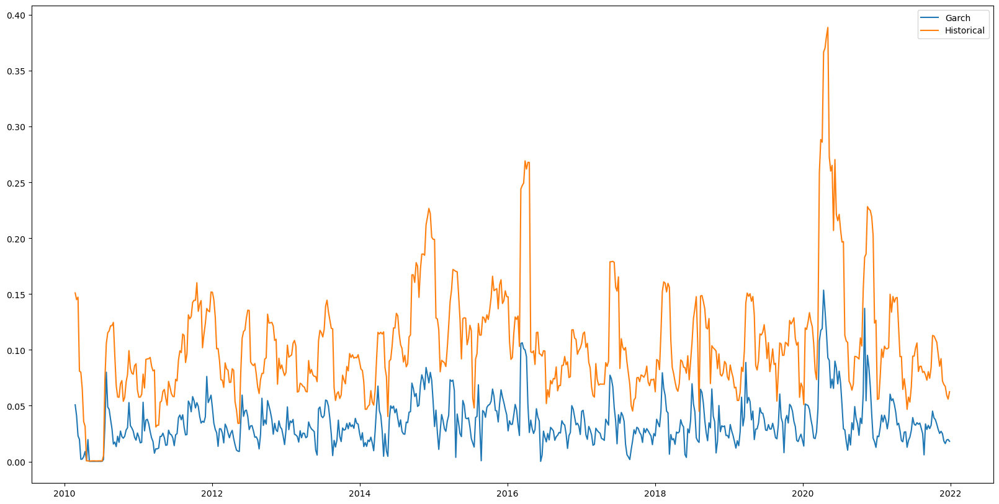

In [32]:
plt.figure(figsize=(20,10))
plt.plot(df_volatility_all_assets.iloc[:,2],label="Garch")
plt.plot(df_historical_volatility.iloc[:,2],label="Historical")
plt.legend()
plt.show()